# Position Reconstruction for XeBRA - MC Prestudies

**Status:** July 2019

Position reconstruction for XeBRA following the position reconstruction algorithm of Mercury (employed in the LUX experiment, originally developed for the ZEPLIN-III dark matter experiment) with light response functions (see https://arxiv.org/abs/1710.02752v2 and https://arxiv.org/abs/1112.1481 ).

In [1]:
## Check Python version:
!python -V
## Check ROOT version:
!which root

Python 3.7.3


In [2]:
## Imports:

import sys
import glob

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
from matplotlib import gridspec            # to arrange the plots nicely
from matplotlib.image import NonUniformImage
from matplotlib.patches import Rectangle
%matplotlib inline

import uproot                              # uproot for easy import of ROOT tree contents
import collections                         # used for named tuples
import pandas as pd
import math
import ast
from scipy import optimize
from scipy.optimize import curve_fit
from scipy.optimize import minimize
from scipy import stats
from numpy import exp
from pylab import meshgrid,cm,imshow,contour,clabel,colorbar,axis,title,show
from scipy.interpolate import spline
from scipy.interpolate import make_interp_spline, BSpline
from scipy.interpolate import griddata
from scipy.stats import chisquare
from scipy.stats import power_divergence
import random

In [3]:
## Function definitions:

def f_polar_R(cartesian_x, cartesian_y):
    return np.sqrt(cartesian_x * cartesian_x + cartesian_y * cartesian_y)

def f_polar_Phi(cartesian_x, cartesian_y):
    return np.arctan2(cartesian_y, cartesian_x)

def f_distance(x_a, y_a, x_b, y_b):
    return np.sqrt((x_b - x_a)**2 + (y_b - y_a)**2)


def flatten_tuples(tup):
    return np.array([element for tupl in tup for element in tupl])

def sum_tuple_subentries(tup):
    return [np.sum(tupl) for tupl in tup]

def nth_tuple_subentries(tup, n):
    return [tupl[n] for tupl in tup]


def from_np_array(array_string):
    array_string = ','.join(array_string.replace('[ ', '[').split())
    return np.array(ast.literal_eval(array_string))

### Properties PMTs

<img src="../../Technical_Drawings_and_Data_Sheets/PMTs/pmts_verbessert.png" alt="pmts_verbessert.png" style="width: 700px;"/>

In [4]:
PMT_ID = np.array([1,2,3,4,5,6,7])

PMT_position_x = np.array([-14.,-28,-14.,14.,28.,14.,0.])      # x-position PMTs in mm in cartesian coordinates
PMT_position_y = np.array([-28.,0.,28.,28.,0.,-28.,0.])        # y-position PMTs in mm in cartesian coordinates
PMT_position_R = f_polar_R(PMT_position_x, PMT_position_y)     # radial position PMTs in mm in polar coordinates
PMT_position_Phi = f_polar_Phi(PMT_position_x, PMT_position_y) # angular position PMTs in rad in polar coordinates

PMT_positions = pd.DataFrame(index=PMT_ID, data={'PMT_ID': PMT_ID, 'PMT_position_x': PMT_position_x, 'PMT_position_y': PMT_position_y, 'PMT_position_R': PMT_position_R, 'PMT_position_Phi': PMT_position_Phi})
PMT_positions

,PMT_ID,PMT_position_x,PMT_position_y,PMT_position_R,PMT_position_Phi
1,1,-14.0,-28.0,31.304952,-2.034444
2,2,-28.0,0.0,28.000000,3.141593
3,3,-14.0,28.0,31.304952,2.034444
4,4,14.0,28.0,31.304952,1.107149
5,5,28.0,0.0,28.000000,0.000000
6,6,14.0,-28.0,31.304952,-1.107149
7,7,0.0,0.0,0.000000,0.000000


In [5]:
R8520_body_width = 25.7
R8520_body_cornerradius = 2.
R8520_photocathode_width = 20.5
R8520_photocathode_cornerradius = 1.

In [6]:
## Photoelectrode coverage top PMTs / total top array
## preliminary rough estimate !!! -> redo
PECoverage_Top = np.array([56628, 69714, 56751, 57049, 70225, 56738, 85238]) / 452343

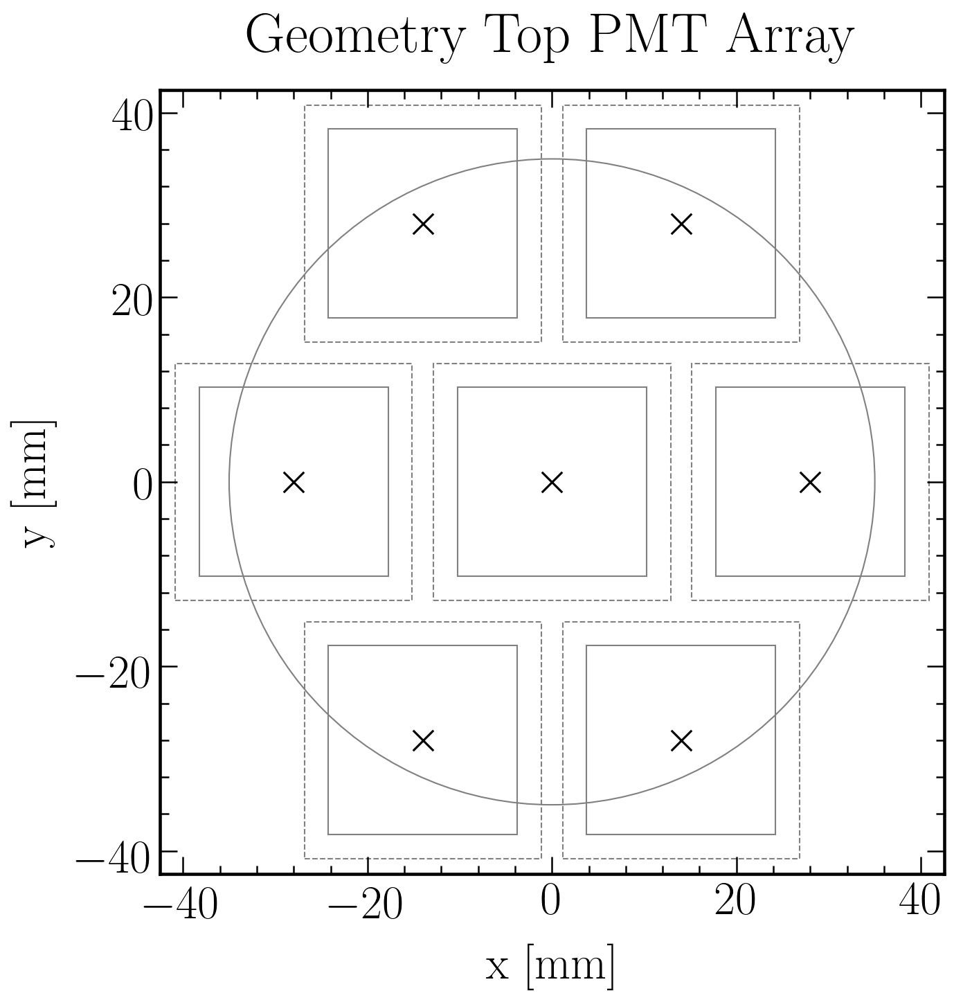

In [7]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Geometry Top PMT Array', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-42.5,42.5)
plt.ylim(-42.5,42.5)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

fig.savefig("Geometry_Top_PMT_Array.png", bbox_inches = "tight")
plt.show()

## MC Driven Studies

### Imports and data porcessing

In [8]:
## Available ROOT files in specified folder:
#! ls ../../Xebra_G4/*.root
#! ls ../../Simulation_Data/LCE/*.root
#! ls ../../Simulation_Data/Modification_Spacer_3/*.root
#! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/Modification_Spacer_3
#! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/Influence_Optical_Parameters
#! ls /media/alex/TOSHIBA\ EXT/Simulation_Data/Modification_Spacer_3
#! ls /media/alex/TOSHIBA\ EXT/Simulation_Data/Influence_Optical_Parameters
! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/LCE
! ls /media/alex/TOSHIBA\ EXT/Simulation_Data/LCE

optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_10.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_1.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_2.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_3.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_4.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_5.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_6.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_7.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_8.root
optPhot_S1_1.0e+05_pmtGap0.0_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_9.root
optPhot_S1_1.0e+05_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+04_10.root
optPhot_S1_1.0e+05_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_nop_1.0e+

ls: cannot access '/media/alex/TOSHIBA EXT/Simulation_Data/LCE': No such file or directory


In [9]:
## Selection of file to be analyzed:
#filename = '/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/optPhot_S2_3.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse.root'
#filename_list = ['/media/alex/TOSHIBA EXT/Simulation_Data/LCE/optPhot_S2_1.0e+05_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_nop_1.0e+04.root']
filename_list = glob.glob("/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/optPhot_S2_1.0e+05_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_nop_1.0e+04_*.root")
#filename_list = ['/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/optPhot_S2_3.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse.root']

if len(filename_list) == 1:    
    filename = filename_list[0]  
else:   
    exec('n_events = '+str(len(filename_list))+'*'+filename_list[0][filename_list[0].find('e+')-3:filename_list[0].find('e+')+4])
    filename       = filename_list[0][:filename_list[0].find('e+')-3]+"{:.1e}".format(n_events)+filename_list[0][filename_list[0].find('e+')+4:-7]+'.root'
 
# filename prefix for automatically naming outputs

if filename[6:14] == 'Xebra_G4':
    filenameprefix = filename[:-5][15:]
    
elif filename[6:25] == 'Simulation_Data/Mod':
    filenameprefix = filename[:-5][44:]
    
elif filename[6:25] == 'Simulation_Data/LCE':
    filenameprefix = filename[:-5][26:]
    
elif filename[:45] == '/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/':
    filenameprefix = filename[:-5][45:]
    
elif filename[:63] == '/media/ab602/TOSHIBA EXT/Simulation_Data/Modification_Spacer_3/':
    filenameprefix = filename[:-5][63:]
    
elif filename[:70] == '/media/ab602/TOSHIBA EXT/Simulation_Data/Influence_Optical_Parameters/':
    filenameprefix = filename[:-5][70:]
    
elif filename[:44] == '/media/alex/TOSHIBA EXT/Simulation_Data/LCE/':
    filenameprefix = filename[:-5][44:]
    
elif filename[:62] == '/media/alex/TOSHIBA EXT/Simulation_Data/Modification_Spacer_3/':
    filenameprefix = filename[:-5][62:]
    
elif filename[:69] == '/media/alex/TOSHIBA EXT/Simulation_Data/Influence_Optical_Parameters/':
    filenameprefix = filename[:-5][69:]

else:
    filenameprefix = 'filenameprefix'
    
print(filenameprefix)

optPhot_S2_1.0e+06_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_nop_1.0e+04


In [10]:
## Import as pandas dataframes

import pandas as pd

branches= ['xp_pri','yp_pri','zp_pri','nbpmthits','ntpmthits','pmthits'] # Be careful that the branches are also initilized in _chunk_collect

import concurrent.futures
executor = concurrent.futures.ThreadPoolExecutor(8)

_chunk_collect = pd.DataFrame({'xp_pri' : [],'yp_pri' : [],'zp_pri' : [],'nbpmthits' : [],'ntpmthits' : [],'pmthits' : []}) # Initialize empty data frame

for _chunk in uproot.iterate(filename_list, "events/events",branches, entrysteps=100000, 
                                       outputtype=pd.DataFrame, executor=executor):
    _chunk.columns=branches
    _chunk_collect = _chunk_collect.append(_chunk)
    print('.', end = '')
print('\n')
    
if filenameprefix.find('nop') > 0:
    nop_string = filenameprefix[(filenameprefix.find('nop')+4) : (filenameprefix.find('+', filenameprefix.find('nop')+4)+3)]
    exec('nop = '+nop_string)
    print('nop = '+str(nop))
    _chunk_collect['nbpmthits'] = _chunk_collect['nbpmthits'] / nop
    _chunk_collect['ntpmthits'] = _chunk_collect['ntpmthits'] / nop
    _chunk_collect['pmthits'] = _chunk_collect['pmthits'] / nop
else:
    print('Error: Number of particles per event = 1!')

/home/ab602/anaconda3/lib/python3.7/site-packages/uproot/tree.py:116: FutureWarning: Int64Index.data is deprecated and will be removed in a future version
  index = awkward.numpy.frombuffer(arrays.index.data, dtype=arrays.index.dtype)


..........

nop = 10000.0


In [11]:
## Separate hits for individual PMTs
## Takes a while to calculate...
for i in range(0,8):
    _chunk_collect['pmthits_'+str(i)] = pd.Series(nth_tuple_subentries(np.asarray(_chunk_collect['pmthits']), i), index=_chunk_collect.index)
    print(i, end=' ')

0 1 2 3 4 5 6 7 

In [12]:
## Total PMT hits
_chunk_collect['napmthits'] = pd.Series(_chunk_collect.nbpmthits+_chunk_collect.ntpmthits, index=_chunk_collect.index)

In [13]:
_chunk_collect.head(6)

,xp_pri,yp_pri,zp_pri,nbpmthits,ntpmthits,pmthits,pmthits_0,pmthits_1,pmthits_2,pmthits_3,pmthits_4,pmthits_5,pmthits_6,pmthits_7,napmthits
0,18.554243,17.374580,3.193820,0.1404,0.1266,"[0.1404, 0.0031, 0.0052, 0.0079, 0.0557, 0.030...",0.1404,0.0031,0.0052,0.0079,0.0557,0.0303,0.0052,0.0192,0.2670
1,33.238873,-3.640600,4.549015,0.1337,0.1234,"[0.1337, 0.0037, 0.0045, 0.0037, 0.0086, 0.081...",0.1337,0.0037,0.0045,0.0037,0.0086,0.0816,0.0109,0.0104,0.2571
2,-22.169487,26.359612,2.899122,0.1478,0.1192,"[0.1478, 0.0043, 0.0195, 0.062, 0.0104, 0.0049...",0.1478,0.0043,0.0195,0.0620,0.0104,0.0049,0.0025,0.0156,0.2670
3,-27.895245,17.686466,4.098360,0.1328,0.1085,"[0.1328, 0.0039, 0.0384, 0.0396, 0.0062, 0.003...",0.1328,0.0039,0.0384,0.0396,0.0062,0.0035,0.0039,0.0130,0.2413
4,18.890539,-9.640432,4.510519,0.1396,0.1326,"[0.1396, 0.0083, 0.0049, 0.0027, 0.0065, 0.051...",0.1396,0.0083,0.0049,0.0027,0.0065,0.0514,0.0343,0.0245,0.2722
5,16.641394,-1.395363,4.960722,0.1381,0.1396,"[0.1381, 0.0061, 0.0064, 0.0046, 0.0108, 0.059...",0.1381,0.0061,0.0064,0.0046,0.0108,0.0594,0.0145,0.0378,0.2777


In [14]:
nphotons = len(_chunk_collect.xp_pri)
nbpmthits_sum = int(_chunk_collect.nbpmthits.sum())
ntpmthits_sum = int(_chunk_collect.ntpmthits.sum())
napmthits_sum = int(_chunk_collect.napmthits.sum())

print('Total Photons:   '+str(nphotons))
print('Bottom PMT Hits:  '+str(nbpmthits_sum))
print('Top PMT Hits:     '+str(ntpmthits_sum))
print('Total PMT Hits:   '+str(napmthits_sum))
print('Total LCE:        '+str(round(100*napmthits_sum/nphotons,2))+' %')

Total Photons:   1000000
Bottom PMT Hits:  138996
Top PMT Hits:     129920
Total PMT Hits:   268917
Total LCE:        26.89 %


In [15]:
'''
if nphotons > 5000000:
    numberbins = 70
else:
    numberbins = 35
'''

numberbins = 70
print(numberbins)

70


### LCE and Hits Fraction Maps

#### LCE Maps

range: (2.5, 5.0) 

LCE_All    = 26.89 %
LCE_Top    = 12.99 %
LCE_Bottom = 13.9 %



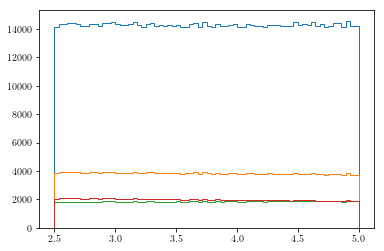

In [16]:
numberbins_z = numberbins
rng = (round(np.min(_chunk_collect.zp_pri),2), round(np.max(_chunk_collect.zp_pri),2))
print('range: '+str(rng)+' \n')

n_z_total, bins_z_total, patches_z_total = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = None, range = rng, histtype = 'step');
n_z_hits_a, bins_z_hits_a, patches_z_hits_a = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.napmthits, range = rng, histtype = 'step');
n_z_hits_t, bins_z_hits_t, patches_z_hits_t = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.ntpmthits, range = rng, histtype = 'step');
n_z_hits_b, bins_z_hits_b, patches_z_hits_b = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.nbpmthits, range = rng, histtype = 'step');

binscenter_z_total = (bins_z_total[:-1]+bins_z_total[1:])/2
binscenter_z_hits_a = (bins_z_hits_a[:-1]+bins_z_hits_a[1:])/2
binscenter_z_hits_t = (bins_z_hits_t[:-1]+bins_z_hits_t[1:])/2
binscenter_z_hits_b = (bins_z_hits_b[:-1]+bins_z_hits_b[1:])/2

n_z_LCE_a = n_z_hits_a / n_z_total
n_z_LCE_t = n_z_hits_t / n_z_total
n_z_LCE_b = n_z_hits_b / n_z_total

# Average values:
print('LCE_All    = '+str(round(100*n_z_LCE_a.mean(),2))+' %')
print('LCE_Top    = '+str(round(100*n_z_LCE_t.mean(),2))+' %')
print('LCE_Bottom = '+str(round(100*n_z_LCE_b.mean(),2))+' %\n')

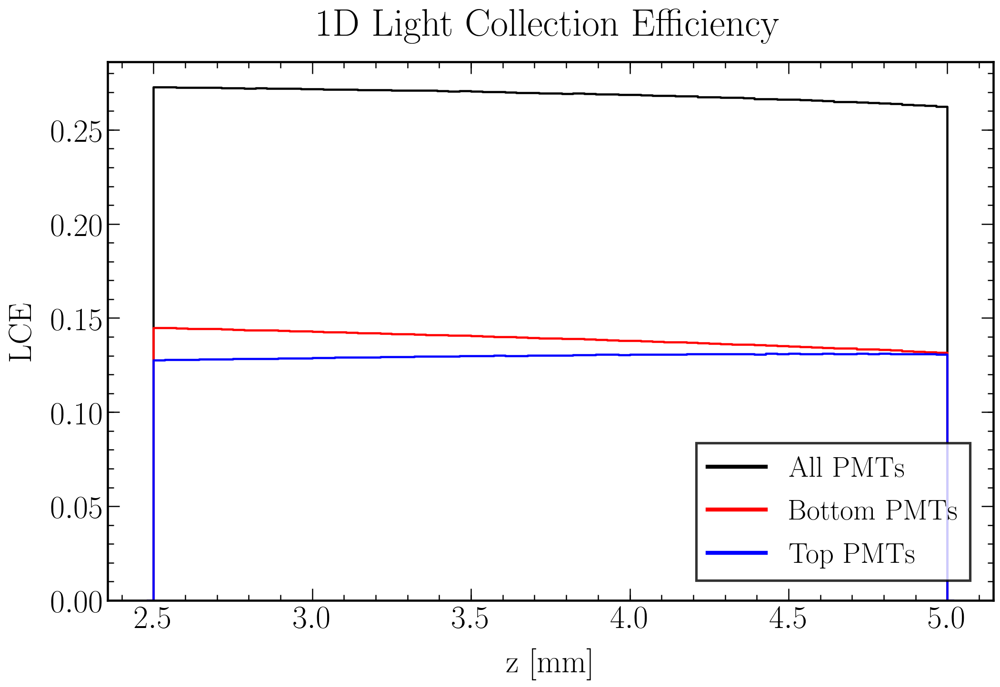

In [17]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot

bns = np.concatenate((np.array([2*binscenter_z_hits_a[0]-binscenter_z_hits_a[1]]), binscenter_z_hits_a, np.array([2*binscenter_z_hits_a[-1]-binscenter_z_hits_a[-2]])))
ns = np.concatenate((np.array([0]), n_z_LCE_a, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'All PMTs', color = 'k')
ns = np.concatenate((np.array([0]), n_z_LCE_b, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'Bottom PMTs', color = 'r')
ns = np.concatenate((np.array([0]), n_z_LCE_t, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'Top PMTs', color = 'b')

#numberbins = 70
#n, bins, patches = plt.hist(zp_pri, numberbins, weights = [1/(len(zp_pri)/numberbins)]*len(zp_pri), histtype = 'step', linewidth = 2.2, color = 'k')
'''
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.napmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'k')
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.nbpmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'Bottom PMT', color = 'r')
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.ntpmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'Top PMTs', color = 'b')
'''

plt.ylim(bottom = 0)

plt.xlabel('z [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('LCE', fontsize = label_size, labelpad = label_pad)
plt.title('1D Light Collection Efficiency', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=4, bbox_to_anchor=(0.99,0.01), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
#leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_LCE_z_comparison.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


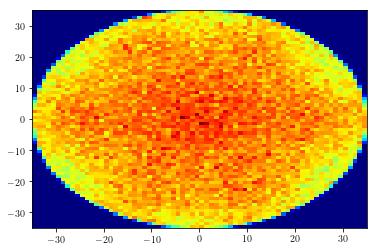

In [18]:
hist_xy_total, xedges_xy_total, yedges_xy_total, kwargs_xy_total = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = None, range = [[-35, 35], [-35, 35]], cmap = 'jet')
xedgescenter_xy_total = (xedges_xy_total[:-1]+xedges_xy_total[1:])/2
yedgescenter_xy_total = (yedges_xy_total[:-1]+yedges_xy_total[1:])/2
histT_xy_total = hist_xy_total.T  # Let each row list bins with common y range.

hist_xy_hits_t, xedges_xy_hits_t, yedges_xy_hits_t, kwargs_xy_hits_t = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect.ntpmthits, range = [[-35, 35], [-35, 35]], cmap = 'jet')
xedgescenter_xy_hits_t = (xedges_xy_hits_t[:-1]+xedges_xy_hits_t[1:])/2
yedgescenter_xy_hits_t = (yedges_xy_hits_t[:-1]+yedges_xy_hits_t[1:])/2
histT_xy_hits_t = hist_xy_hits_t.T  # Let each row list bins with common y range.

hist_xy_LCE = hist_xy_hits_t / hist_xy_total
histT_xy_LCE = histT_xy_hits_t / histT_xy_total

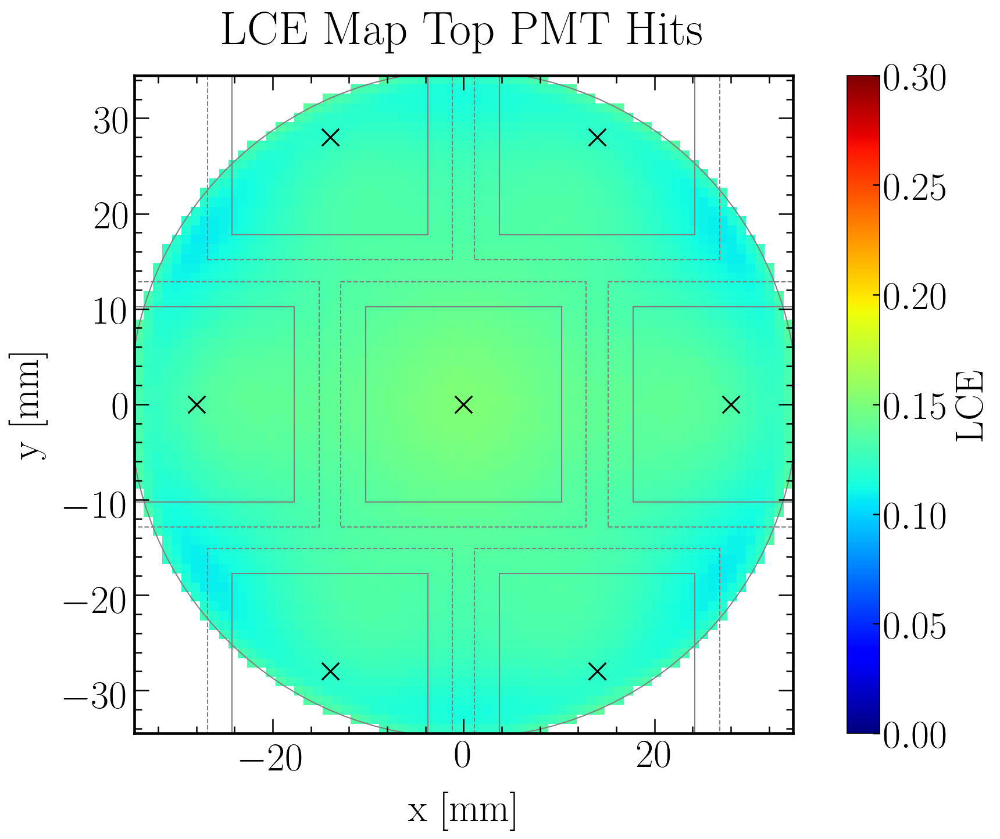

In [19]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect.ntpmthits/nphotons*numberbins*numberbins*math.pi/4, range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()
plt.imshow(histT_xy_LCE, interpolation='nearest', origin='low', extent=[xedgescenter_xy_hits_t[0], xedgescenter_xy_hits_t[-1], yedgescenter_xy_hits_t[0], yedgescenter_xy_hits_t[-1]], cmap = 'jet')

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map Top PMT Hits', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
plt.clim(0.0, 0.3)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
    
fig.savefig(filenameprefix+"_LCE_x_y_Top.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: invalid value encountered in true_divide


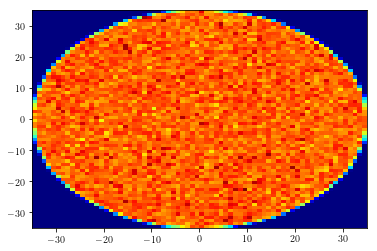

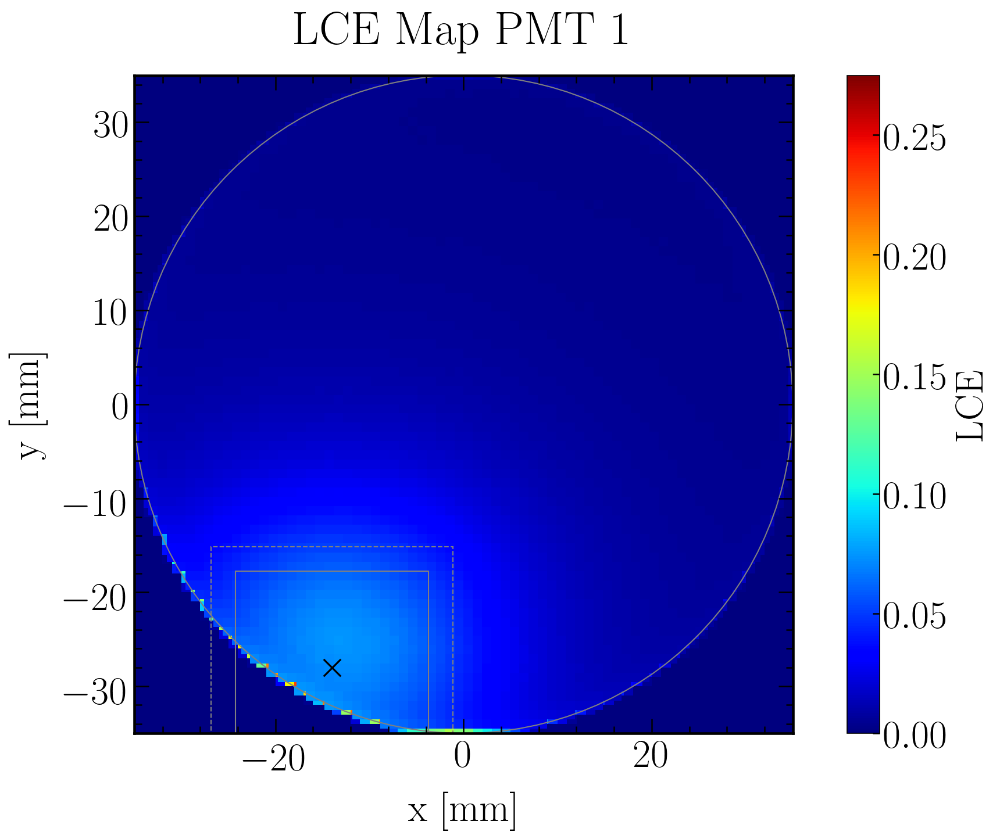

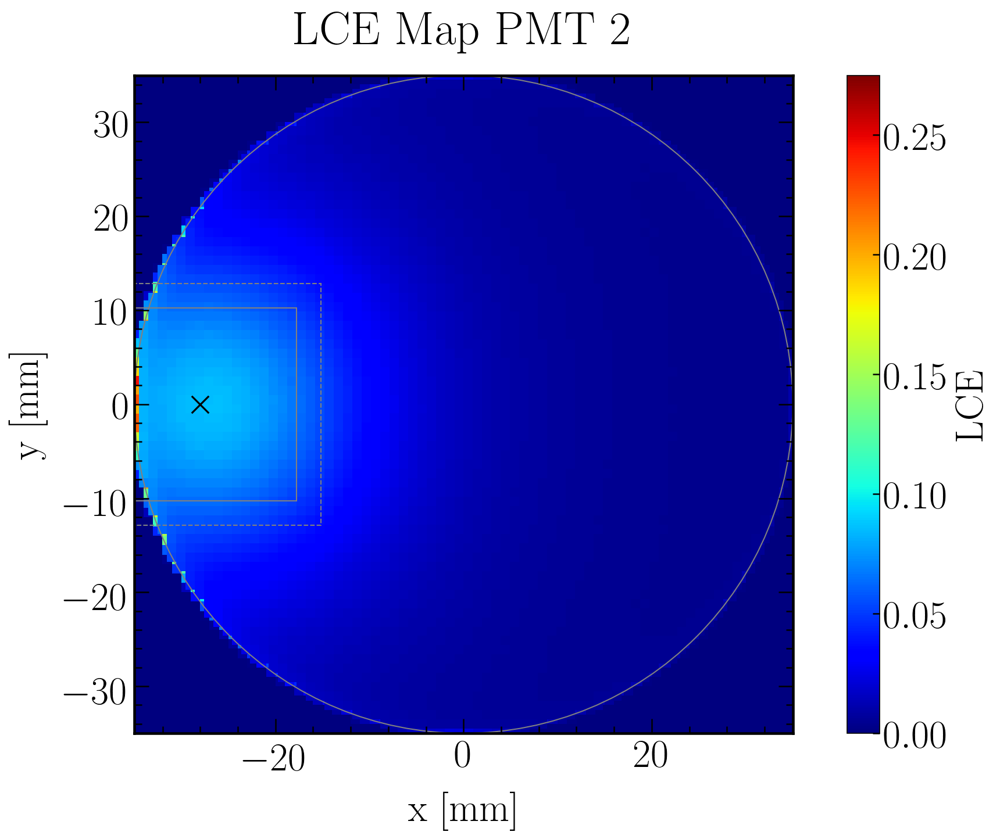

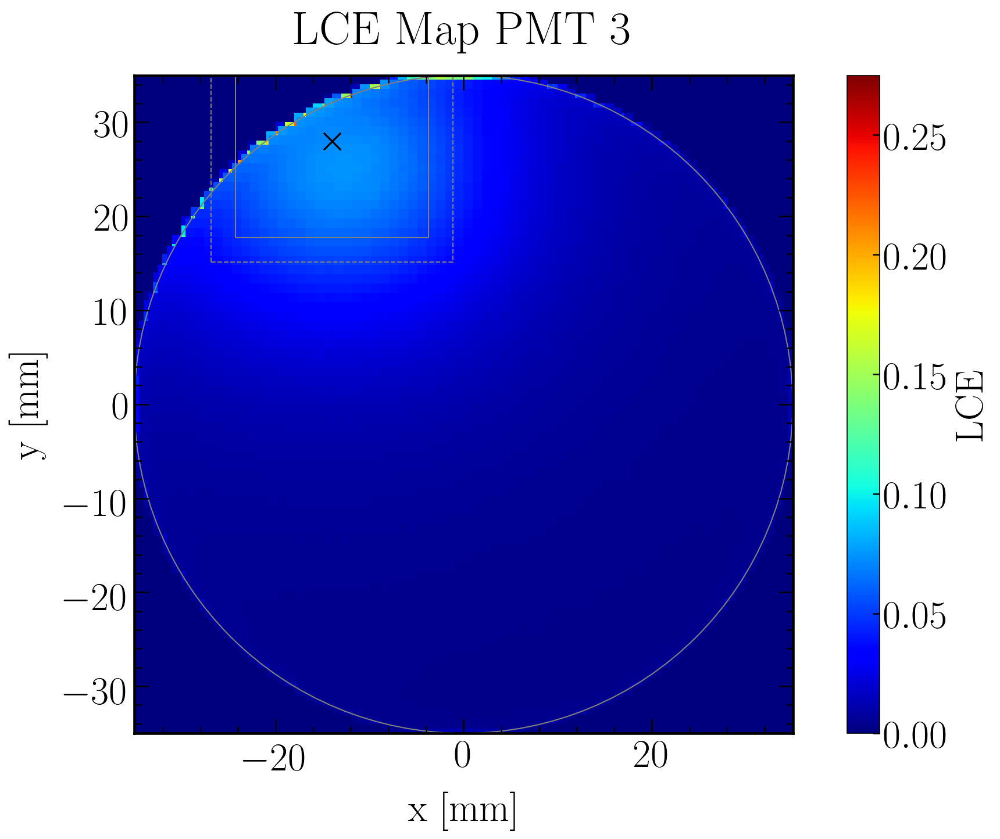

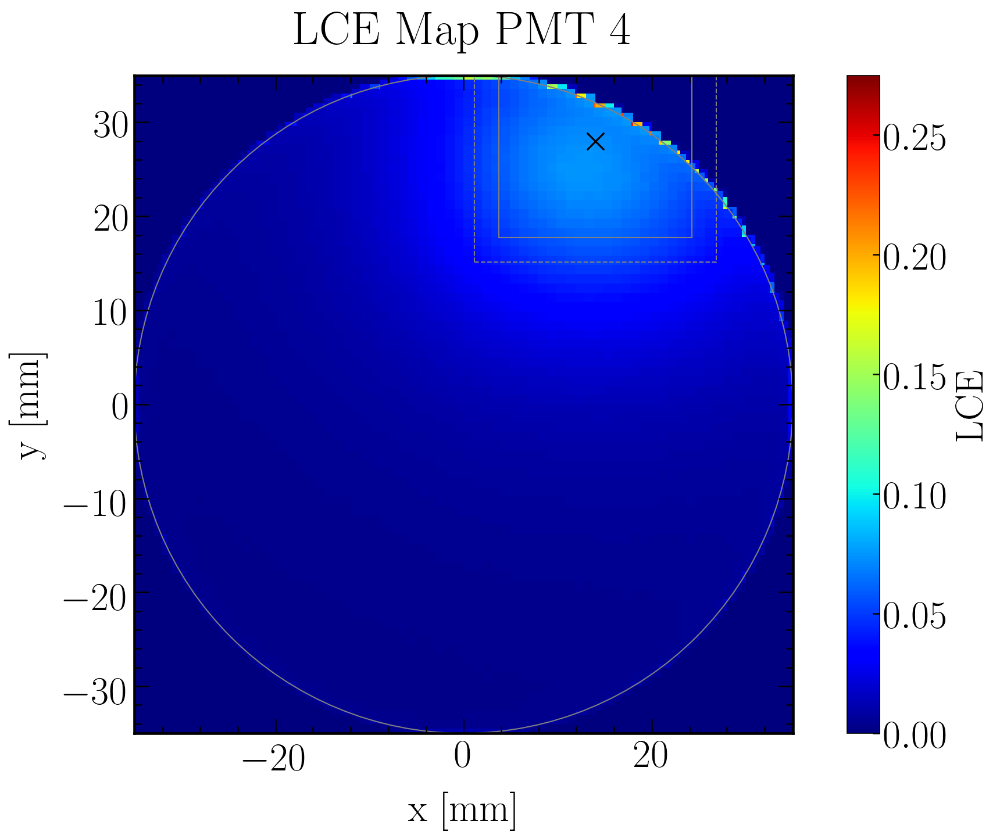

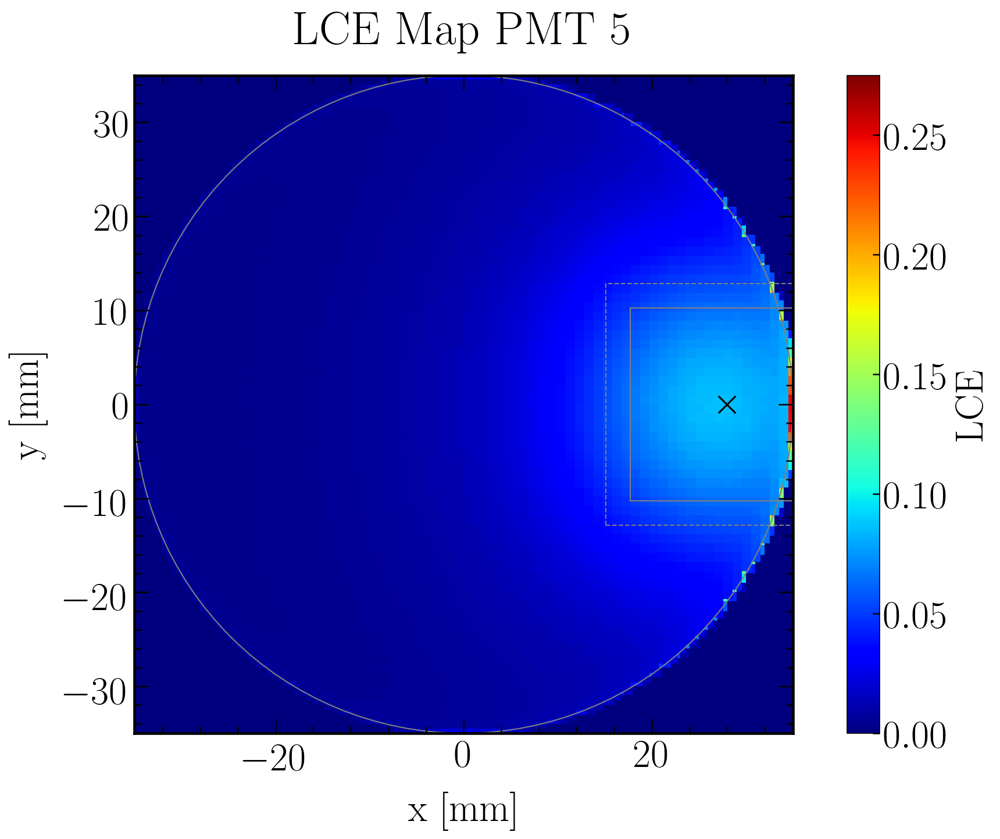

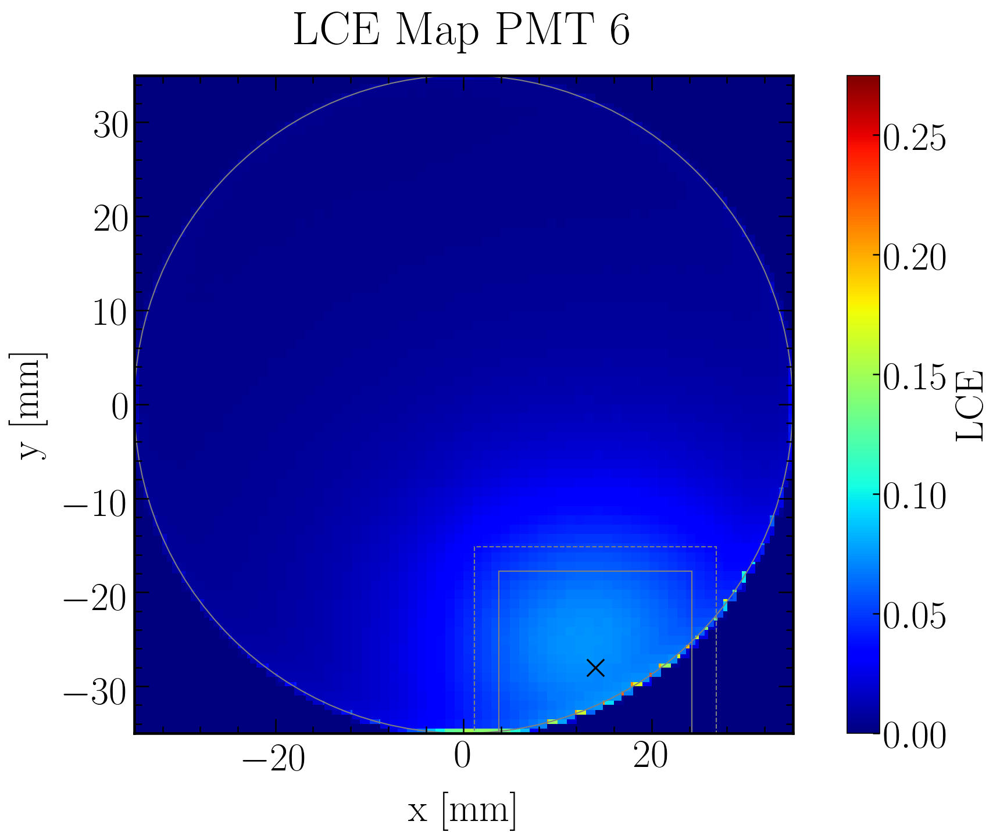

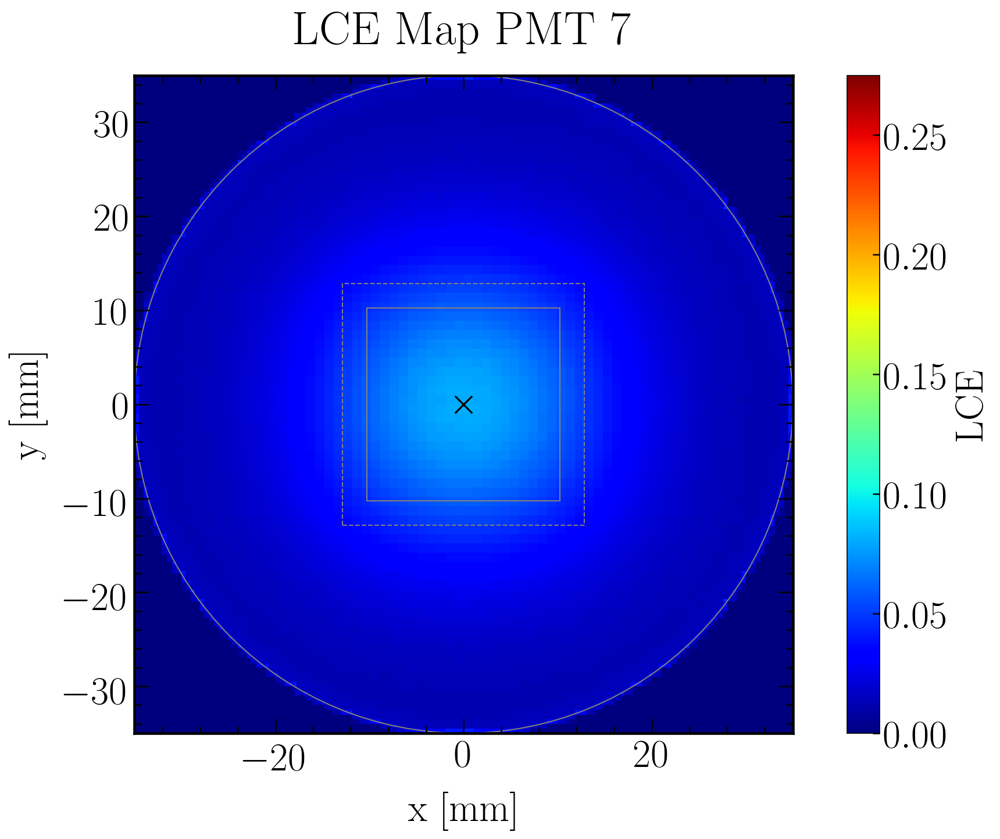

In [20]:
hits_list = [_chunk_collect.pmthits_1, _chunk_collect.pmthits_2, _chunk_collect.pmthits_3, _chunk_collect.pmthits_4, _chunk_collect.pmthits_5, _chunk_collect.pmthits_6, _chunk_collect.pmthits_7]
LCE_x_y_hist2d_perPMT = pd.DataFrame({'hist' : [], 'histT' : [], 'xedges' : [], 'xedges_center' : [], 'yedges' : [], 'yedges_center' : []})
columns = ['hist', 'histT', 'xedges', 'xedges_center', 'yedges', 'yedges_center']

hist_xy_total, xedges_xy_total, yedges_xy_total, kwargs_xy_total = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = None, range = [[-35, 35], [-35, 35]], cmap = 'jet')
histT_xy_total = hist_xy_total.T  # Let each row list bins with common y range.

for i in range(1,8):

    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    hist_xy_hits_i, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = hits_list[i-1], range = [[-35, 35], [-35, 35]], cmap = 'jet')
    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT_xy_hits_i = hist_xy_hits_i.T  # Let each row list bins with common y range.

    hist = hist_xy_hits_i / hist_xy_total
    histT = histT_xy_hits_i / histT_xy_total
    
    plt.imshow(histT, interpolation='nearest', origin='low', extent=[xedges_center[0], xedges_center[-1], yedges_center[0], yedges_center[-1]], cmap = 'jet')
   
    '''    
    hist, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = (hits_list[i-1])/nphotons*numberbins*numberbins*math.pi/4, range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()

    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT = hist.T  # Let each row list bins with common y range.
    '''
    
    values = [hist, histT, xedges, xedges_center, yedges, yedges_center]
    LCE_x_y_hist2d_perPMT = LCE_x_y_hist2d_perPMT.append(pd.DataFrame([np.array(values)], columns=columns)) #, ignore_index=True
    
    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('LCE Map PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='LCE', fontsize=label_size)
    plt.clim(0.0, 0.275)
    
    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)
    plt.show()
    fig.savefig(filenameprefix+"_LCE_x_y_PMT"+str(i)+".png")
    
LCE_x_y_hist2d_perPMT = LCE_x_y_hist2d_perPMT.set_index(PMT_ID);
LCE_x_y_hist2d_perPMT_hist_sum = LCE_x_y_hist2d_perPMT['hist'].sum()
LCE_x_y_hist2d_perPMT_histT_sum = LCE_x_y_hist2d_perPMT['histT'].sum()

In [21]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(LCE_x_y_hist2d_perPMT['histT'].loc[i], interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map PMT '+str(i), fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
plt.clim(0.0, 0.275)

plt.show()''';

In [22]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(LCE_x_y_hist2d_perPMT_histT_sum, interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
#plt.clim(0.0, 0.275)

plt.show()''';

In [23]:
LCE_x_y_hist2d_perPMT.to_pickle(filenameprefix+"_LCE_x_y_hist2d_perPMT.pkl")
LCE_x_y_hist2d_perPMT

,hist,histT,xedges,xedges_center,yedges,yedges_center
1,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
2,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
3,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
4,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
5,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
6,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
7,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."


#### Hits Fraction Maps

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: invalid value encountered in true_divide


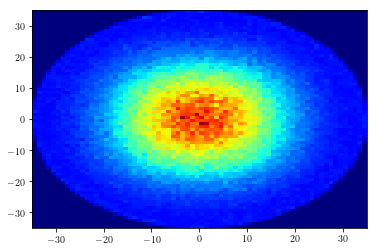

In [24]:
pmthits_list = ["pmthits_1", "pmthits_2", "pmthits_3", "pmthits_4", "pmthits_5", "pmthits_6", "pmthits_7"]
hits_list = [_chunk_collect.pmthits_1, _chunk_collect.pmthits_2, _chunk_collect.pmthits_3, _chunk_collect.pmthits_4, _chunk_collect.pmthits_5, _chunk_collect.pmthits_6, _chunk_collect.pmthits_7]
HF_x_y_hist2d_perPMT = pd.DataFrame({'PMT_ID' : [], 'hist' : [], 'histT' : [], 'xedges' : [], 'xedges_center' : [], 'yedges' : [], 'yedges_center' : []})
columns = ['PMT_ID', 'hist', 'histT', 'xedges', 'xedges_center', 'yedges', 'yedges_center']

for i in range(1,8):
    hist, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect[pmthits_list[i-1]], range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()

    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT = hist.T  # Let each row list bins with common y range.
    
    values = [np.array([i]), hist, histT, xedges, xedges_center, yedges, yedges_center]
    HF_x_y_hist2d_perPMT = HF_x_y_hist2d_perPMT.append(pd.DataFrame([np.array(values)], columns=columns)) #, ignore_index=True

# set indices
HF_x_y_hist2d_perPMT = HF_x_y_hist2d_perPMT.set_index(PMT_ID);
for i in range(1,8):
    HF_x_y_hist2d_perPMT['PMT_ID'][i] = int(HF_x_y_hist2d_perPMT['PMT_ID'][i])

# calculate correct hit fractions as hits per PMT / hits total top for each bin
'''
HF_x_y_hist2d_perPMT['hist'] = HF_x_y_hist2d_perPMT['hist']/HF_x_y_hist2d_perPMT['hist'].sum()
HF_x_y_hist2d_perPMT['histT'] = HF_x_y_hist2d_perPMT['histT']/HF_x_y_hist2d_perPMT['histT'].sum()
'''

HF_x_y_hist2d_perPMT_hist_sum  = HF_x_y_hist2d_perPMT['hist'].sum()
HF_x_y_hist2d_perPMT_histT_sum = HF_x_y_hist2d_perPMT['histT'].sum()
for p in range(1,8):
    HF_x_y_hist2d_perPMT.at[p,'hist'] = (HF_x_y_hist2d_perPMT.at[p,'hist']/HF_x_y_hist2d_perPMT_hist_sum)
    HF_x_y_hist2d_perPMT.at[p,'histT'] = (HF_x_y_hist2d_perPMT.at[p,'histT']/HF_x_y_hist2d_perPMT_histT_sum)

'''for i in range(0,8):
    try:
        HF_x_y_hist2d_perPMT['hist'][i] = np.where(np.isnan(HF_x_y_hist2d_perPMT['hist'][i]), None, HF_x_y_hist2d_perPMT['hist'][i])
    except:
        pass
    try:
        HF_x_y_hist2d_perPMT['histT'][i] = np.where(np.isnan(HF_x_y_hist2d_perPMT['histT'][i]), None, HF_x_y_hist2d_perPMT['histT'][i])
    except:
        pass

# save as csv
pd.set_option('display.max_colwidth', -1)
HF_x_y_hist2d_perPMT.to_csv(filenameprefix+'_HF_x_y_hist2d_perPMT.csv', index=False)'''

# save as pkl
HF_x_y_hist2d_perPMT.to_pickle(filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

In [25]:
## Read file for HF_x_y_hist2d_perPMT dataframe
## Not working yet
'''pd.read_csv('optPhot_S2_1e6_HF_x_y_hist2d_perPMT.csv', index_col = 'PMT_ID', converters={'xedges': from_np_array, 'xedges_center': from_np_array, 'yedges': from_np_array, 'yedges_center': from_np_array})''';
## Working
# HF_x_y_hist2d_perPMT = pd.read_pickle("output/"+filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

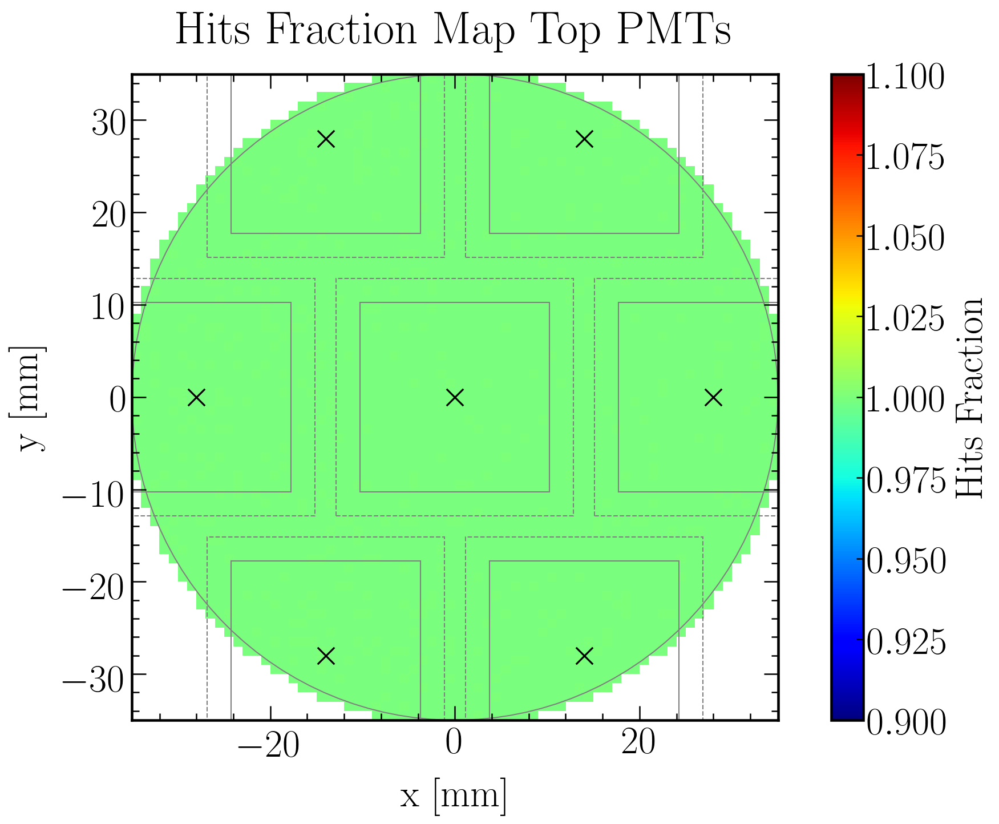

In [26]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(HF_x_y_hist2d_perPMT['histT'].sum(), interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
#plt.clim(0.0, 0.275)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_x_y_Top.png")

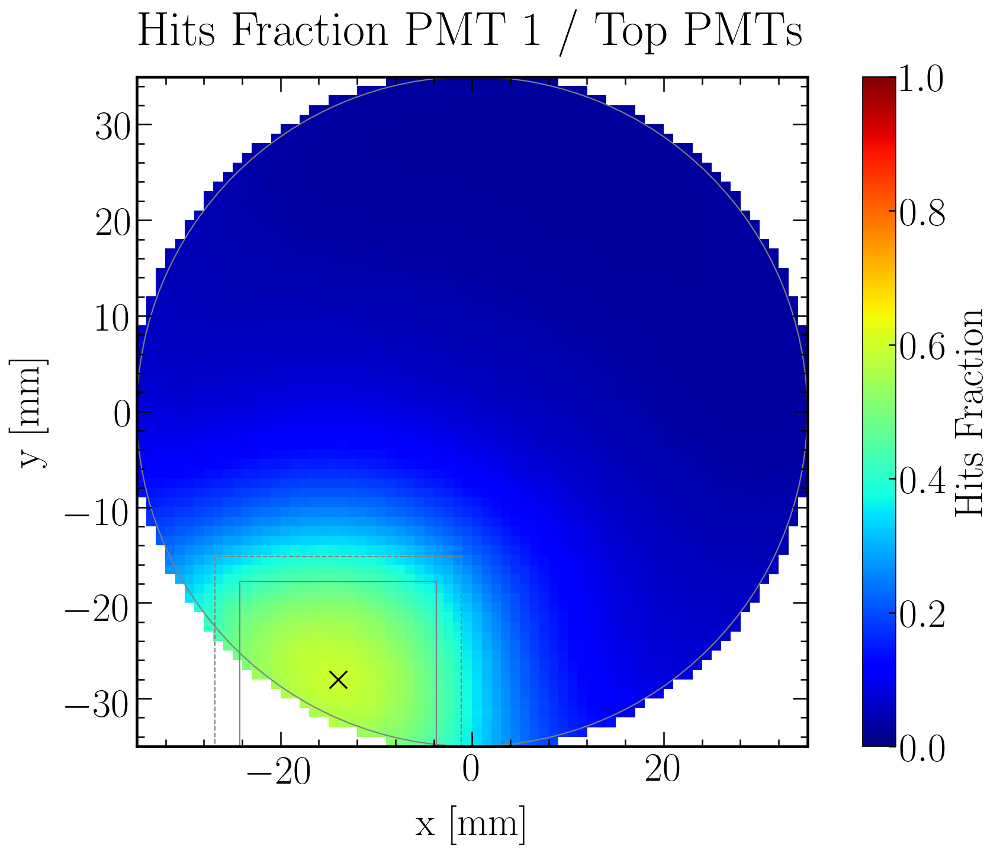

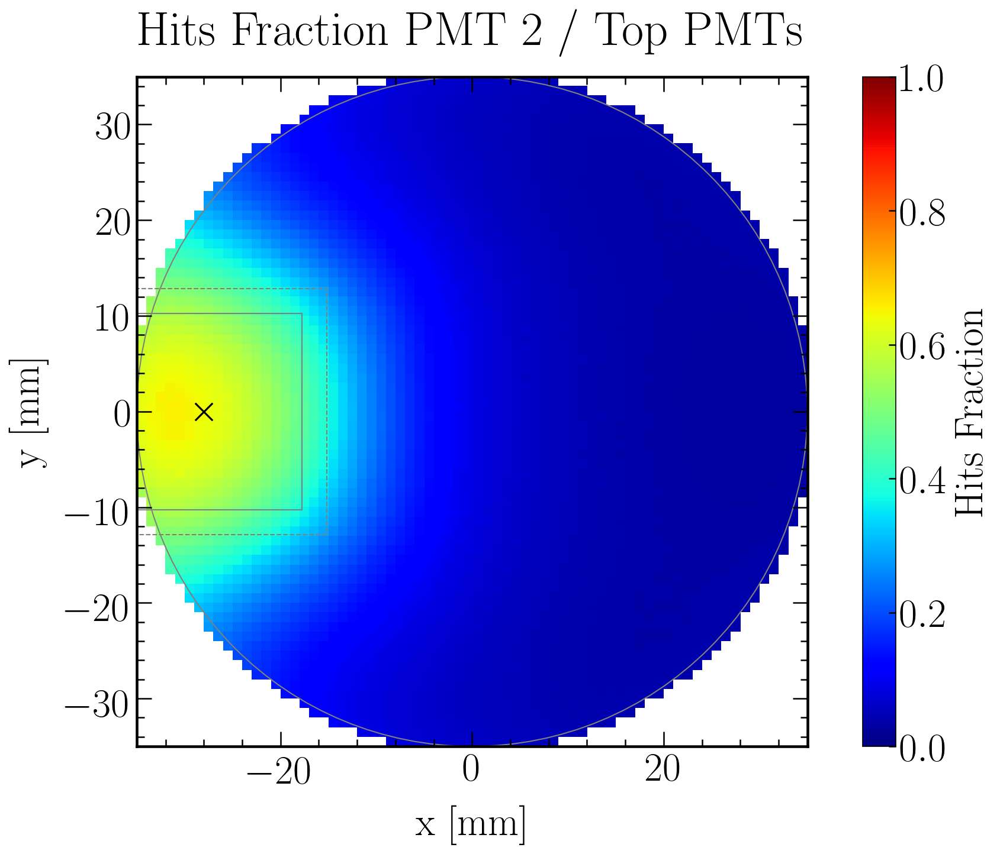

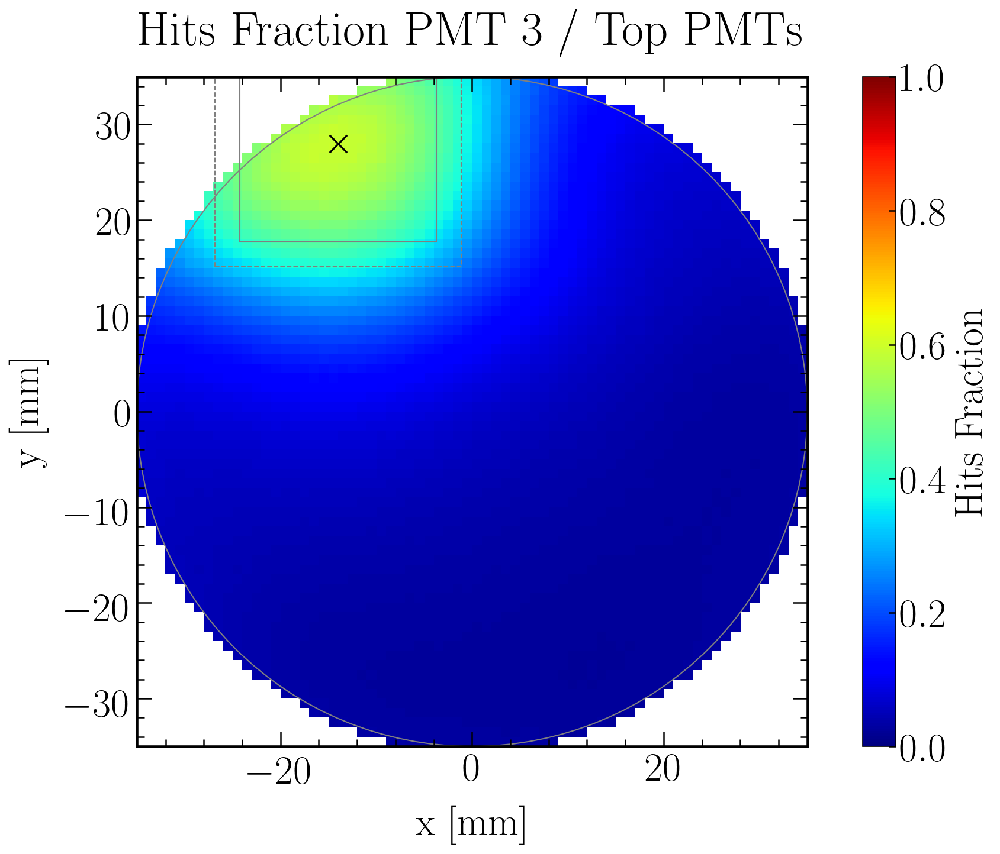

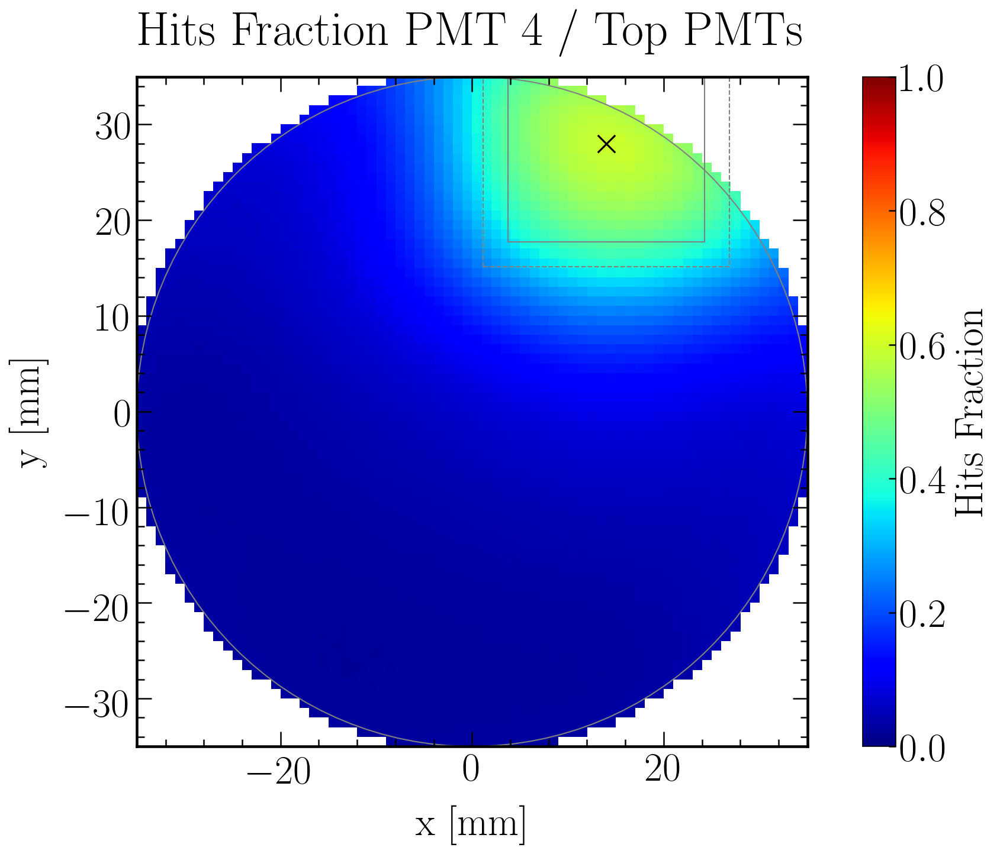

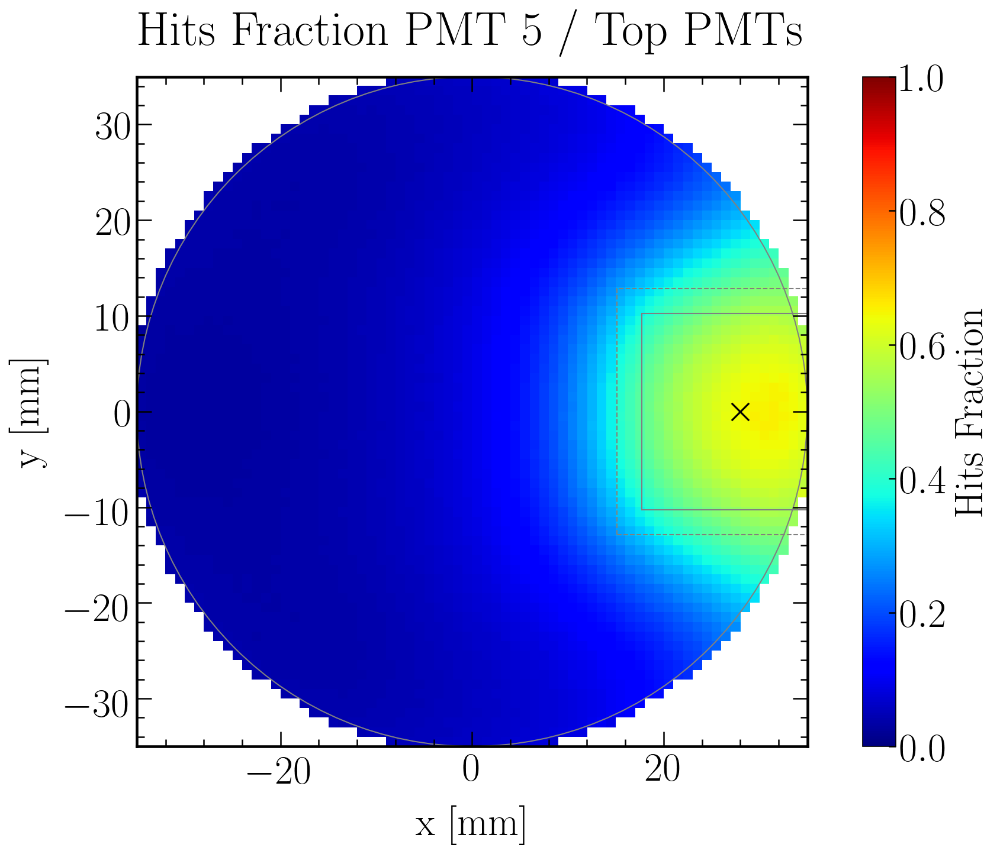

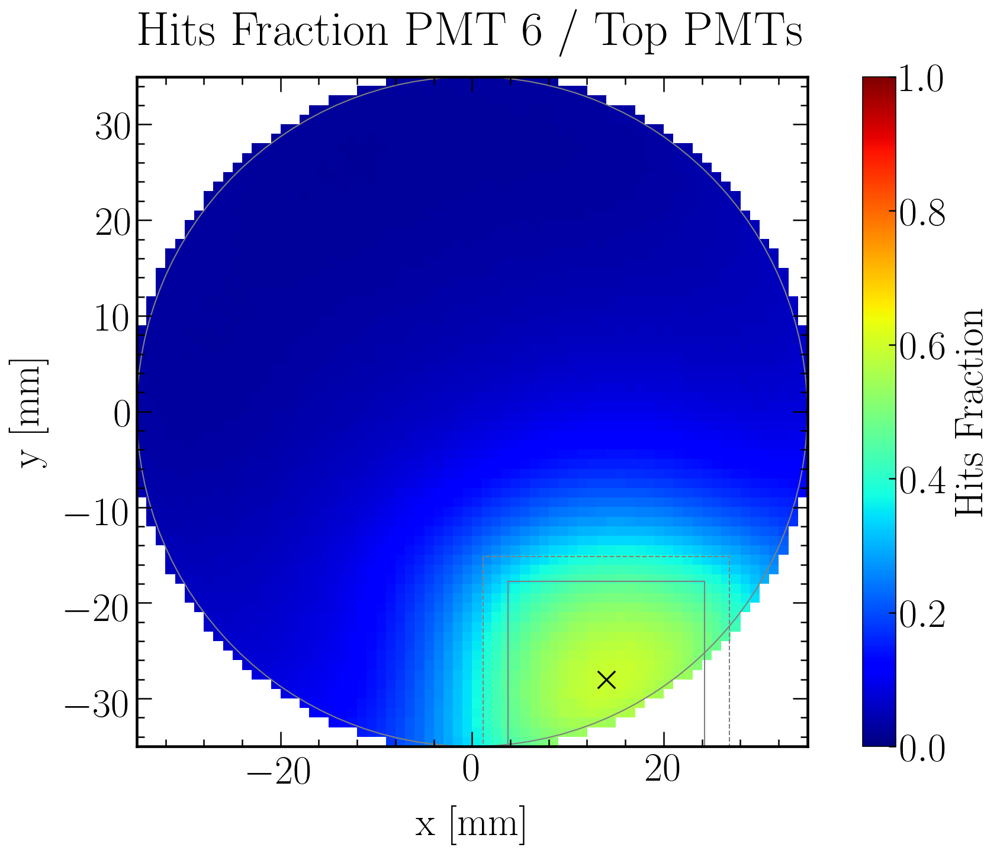

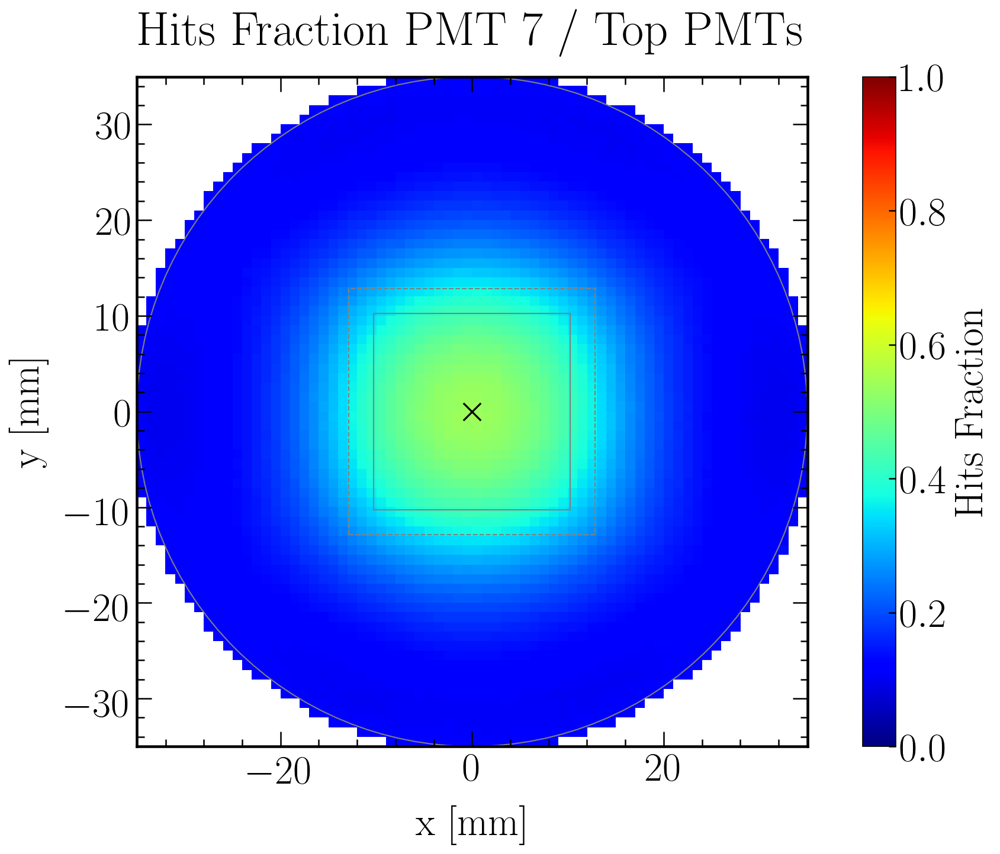

In [27]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    plt.imshow(HF_x_y_hist2d_perPMT['histT'].loc[i], interpolation='nearest', origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(0.0, 1.0)
        
    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs.png")

### Centroid and Corrected Centroid

In [28]:
## Grid of true positions
grid_true = np.meshgrid(HF_x_y_hist2d_perPMT['xedges_center'][7], HF_x_y_hist2d_perPMT['yedges_center'][7])

In [29]:
## Centroids
centroids_x_intermediate = (PMT_positions['PMT_position_x'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]+PMT_positions['PMT_position_x'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]+PMT_positions['PMT_position_x'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]+PMT_positions['PMT_position_x'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]+PMT_positions['PMT_position_x'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]+PMT_positions['PMT_position_x'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]+PMT_positions['PMT_position_x'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7])/(HF_x_y_hist2d_perPMT['histT'].sum())
centroids_y_intermediate = (PMT_positions['PMT_position_y'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]+PMT_positions['PMT_position_y'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]+PMT_positions['PMT_position_y'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]+PMT_positions['PMT_position_y'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]+PMT_positions['PMT_position_y'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]+PMT_positions['PMT_position_y'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]+PMT_positions['PMT_position_y'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7])/(HF_x_y_hist2d_perPMT['histT'].sum())

In [30]:
mask_inside = (f_polar_R(flatten_tuples(grid_true[0]),flatten_tuples(grid_true[1]))<=35)

x_true = flatten_tuples(grid_true[0])[mask_inside]
y_true = flatten_tuples(grid_true[1])[mask_inside]
centroids_x = flatten_tuples(centroids_x_intermediate)[mask_inside]
centroids_y = flatten_tuples(centroids_y_intermediate)[mask_inside]

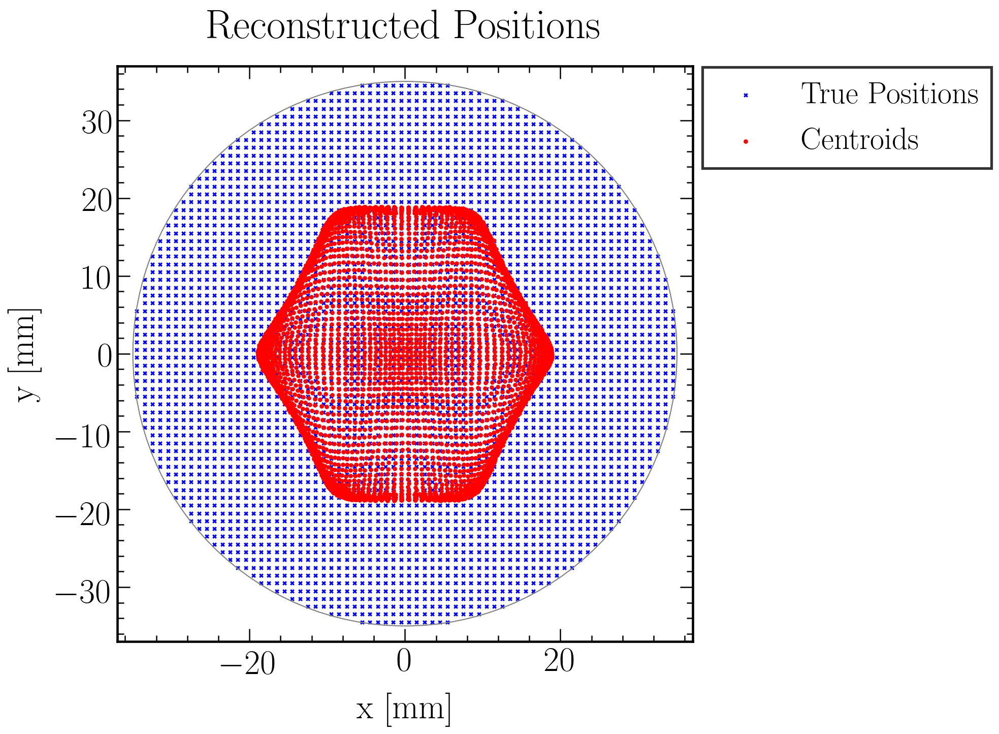

In [31]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
# plt.scatter(grid_true[0][f_polar_R(grid_true[0], grid_true[1]) < 35], grid_true[1][f_polar_R(grid_true[0], grid_true[1]) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'k', s = HF_x_y_hist2d_perPMT['histT'].loc[7]*10000/numberbins)
plt.scatter(x_true, y_true, color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(centroids_x, centroids_y, color = 'red', s = 10, label = 'Centroids')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids.png", bbox_inches = "tight")

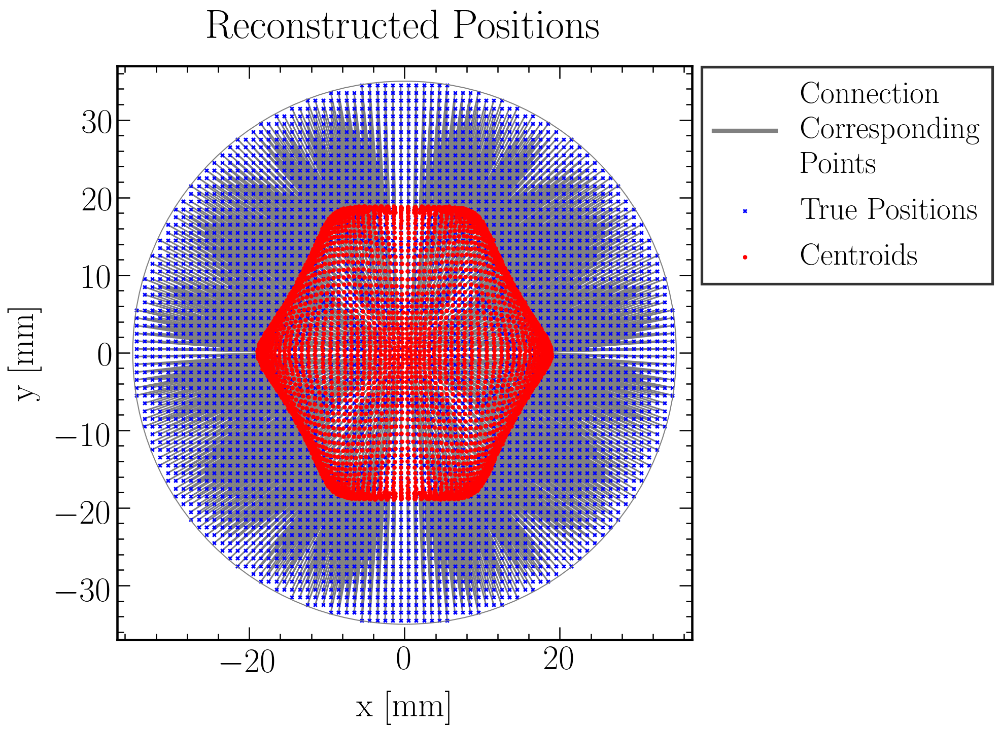

In [32]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Connect real and reconstructed position
plt.plot([x_true[0], centroids_x[0]],[y_true[0], centroids_y[0]], 'grey', label = 'Connection\nCorresponding\nPoints', zorder=0)
for i in range(1, len(x_true)):
    plt.plot([x_true[i], centroids_x[i]],[y_true[i], centroids_y[i]], 'grey', zorder=0)

# Data plot
plt.scatter(x_true, y_true, color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(centroids_x, centroids_y, color = 'red', s = 10, label = 'Centroids')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids_Connected.png", bbox_inches = "tight")

In [33]:
## Corrected Centroids
## Corrected by weight with inverse Photoelectrode coverage
centroids_x_corrected_PEC_intermediate = (PMT_positions['PMT_position_x'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+PMT_positions['PMT_position_x'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+PMT_positions['PMT_position_x'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+PMT_positions['PMT_position_x'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+PMT_positions['PMT_position_x'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+PMT_positions['PMT_position_x'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+PMT_positions['PMT_position_x'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1]) / (HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1])
centroids_y_corrected_PEC_intermediate = (PMT_positions['PMT_position_y'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+PMT_positions['PMT_position_y'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+PMT_positions['PMT_position_y'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+PMT_positions['PMT_position_y'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+PMT_positions['PMT_position_y'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+PMT_positions['PMT_position_y'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+PMT_positions['PMT_position_y'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1]) / (HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1])

centroids_x_corrected_PEC = flatten_tuples(centroids_x_corrected_PEC_intermediate)[mask_inside]
centroids_y_corrected_PEC = flatten_tuples(centroids_y_corrected_PEC_intermediate)[mask_inside]

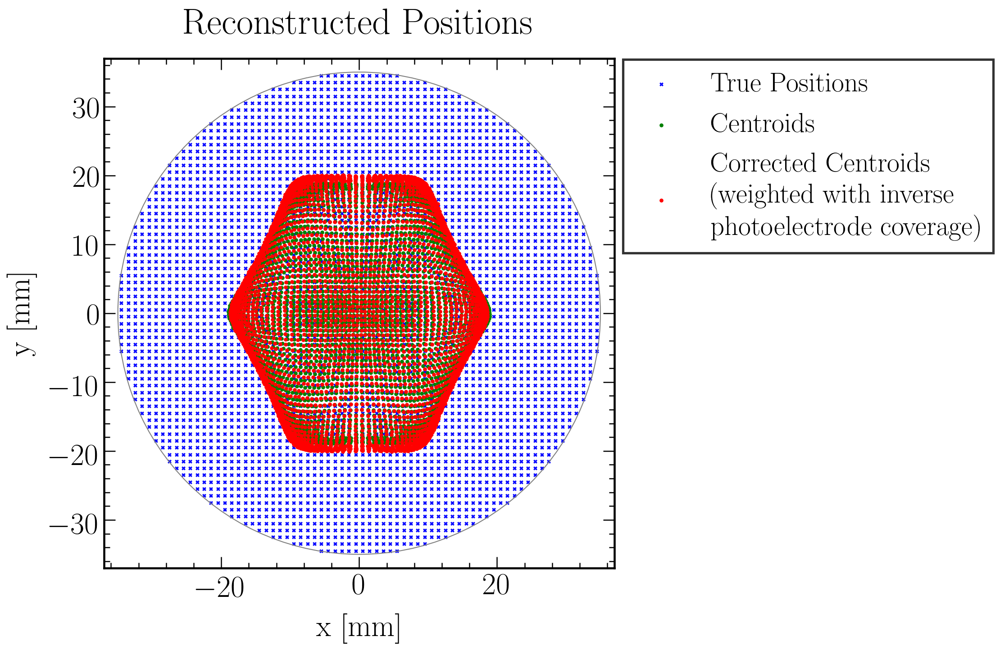

In [34]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
# plt.scatter(grid_true[0][f_polar_R(grid_true[0], grid_true[1]) < 35], grid_true[1][f_polar_R(grid_true[0], grid_true[1]) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'k', s = HF_x_y_hist2d_perPMT['histT'].loc[7]*10000/numberbins)
plt.scatter(x_true, y_true, color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(centroids_x, centroids_y, color = 'green', s = 10, label = 'Centroids')
plt.scatter(centroids_x_corrected_PEC, centroids_y_corrected_PEC, color = 'red', s = 10, label = 'Corrected Centroids\n(weighted with inverse\nphotoelectrode coverage)')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids_CorrectedPEC.png", bbox_inches = "tight")

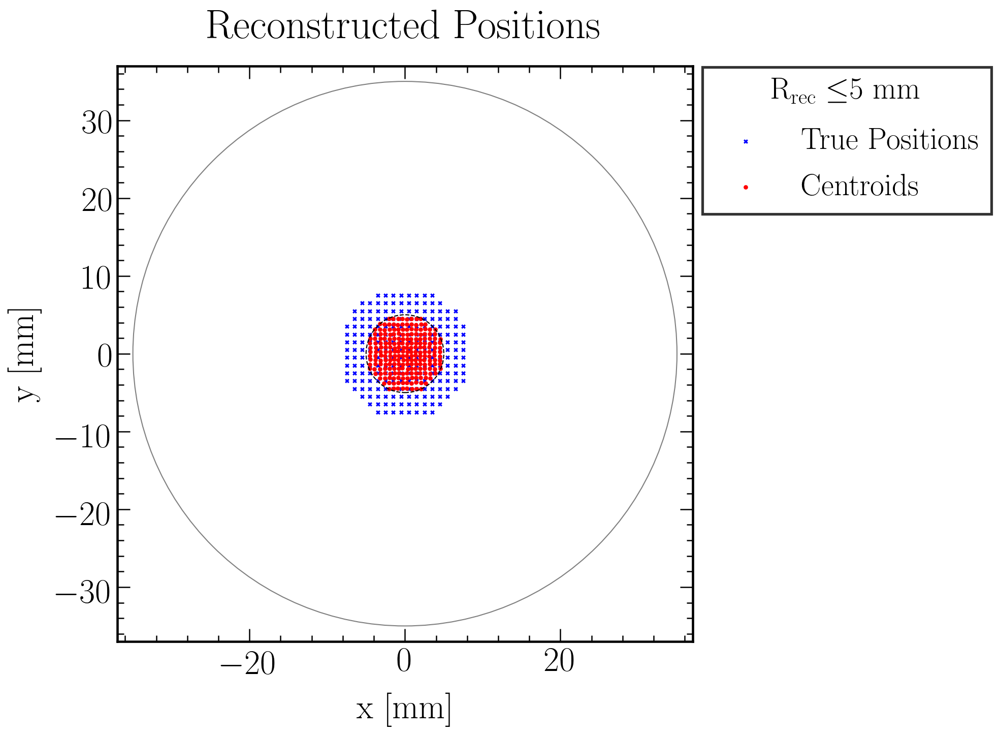

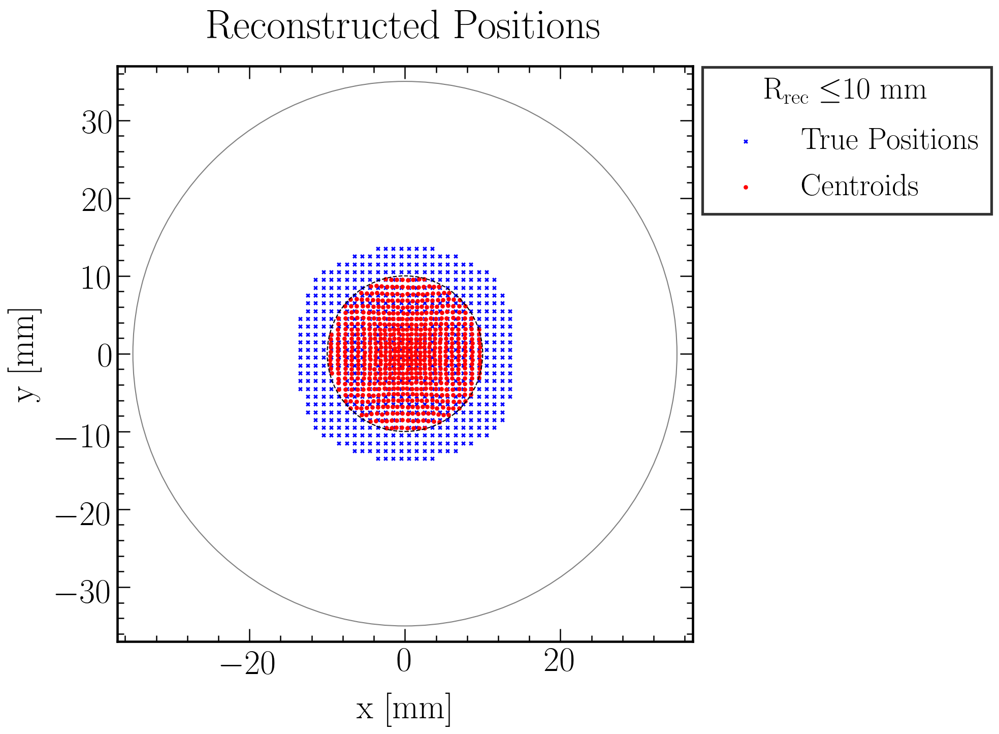

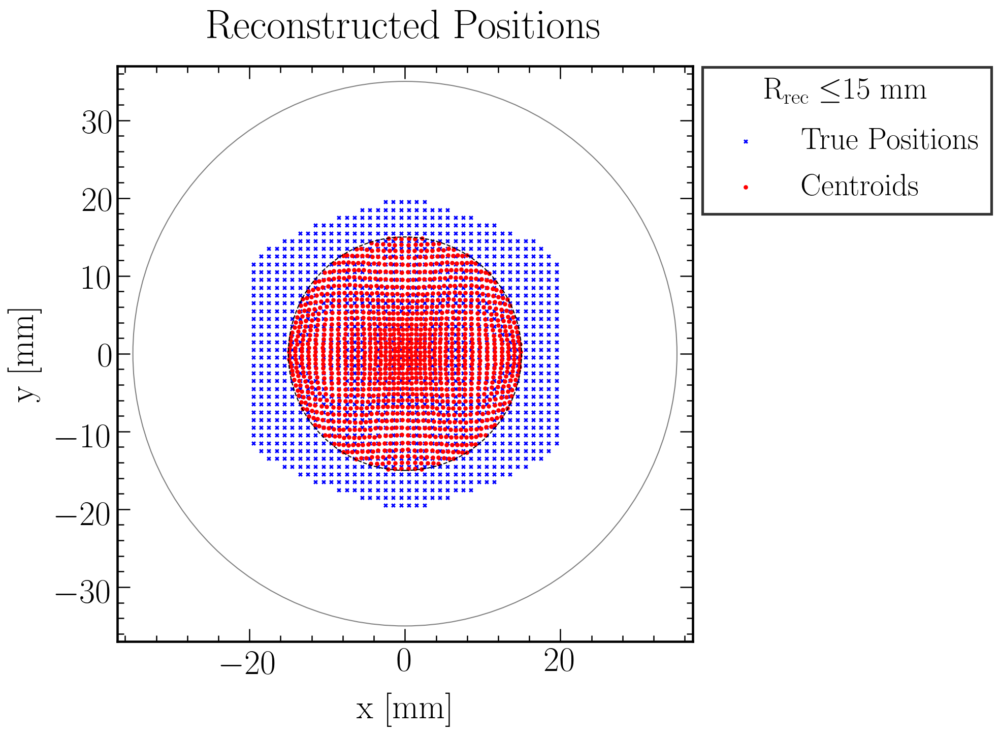

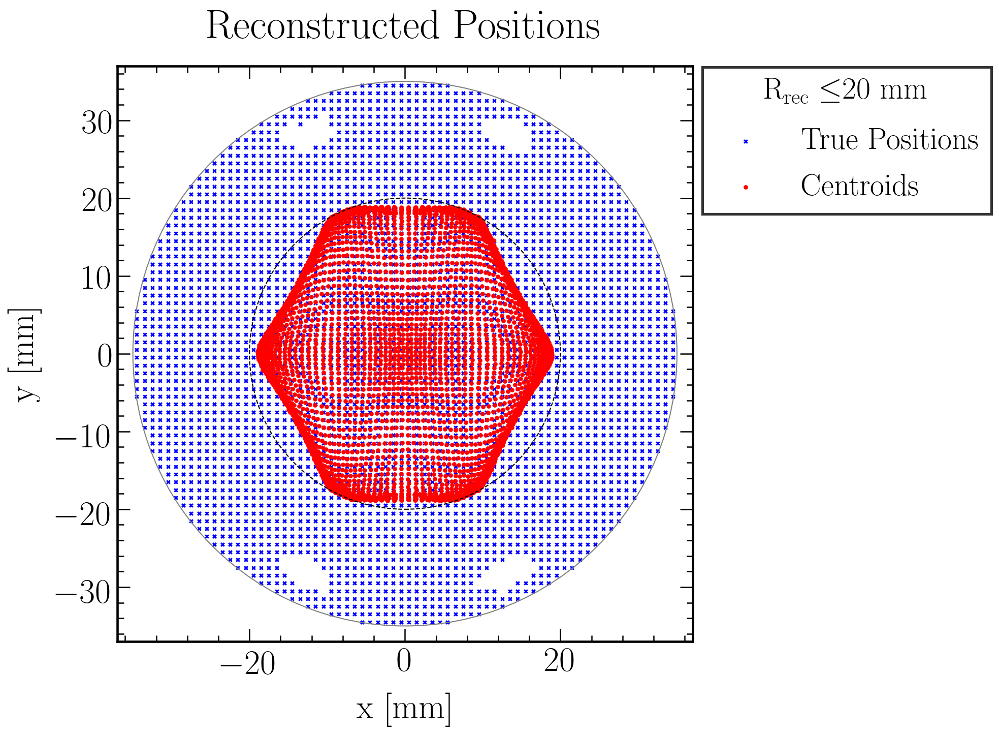

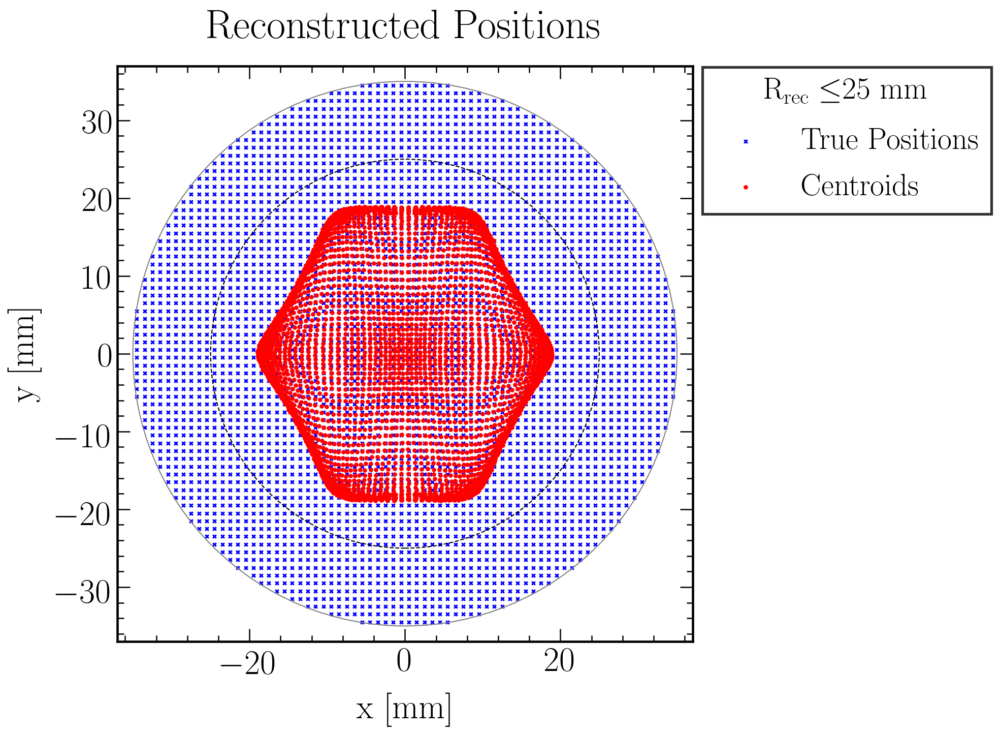

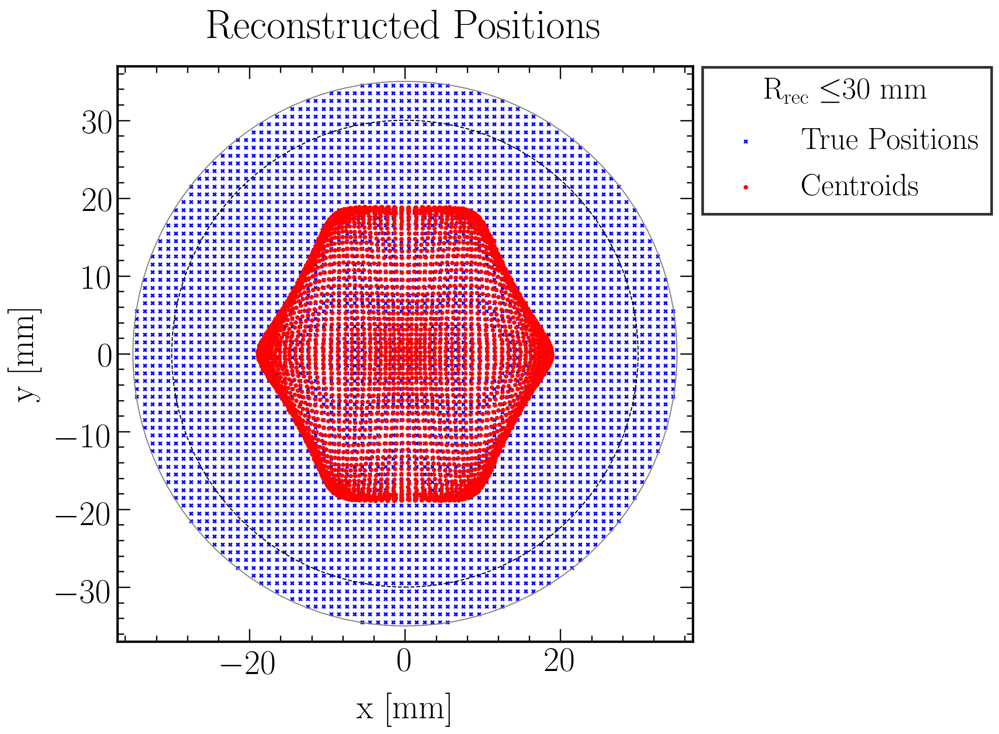

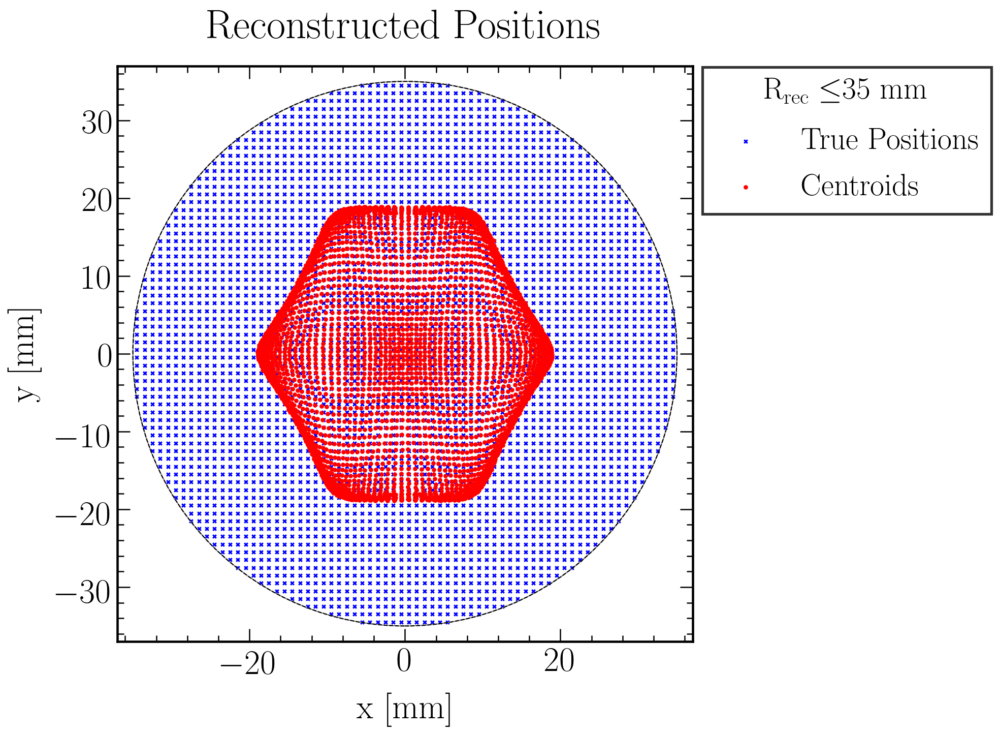

In [35]:
cutlist = [5, 10, 15, 20, 25, 30, 35]
for cut in cutlist:
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    #numberbins = 70

    # Data plot
    plt.scatter(x_true[f_polar_R(centroids_x, centroids_y) < cut], y_true[f_polar_R(centroids_x, centroids_y) < cut], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
    plt.scatter(centroids_x[f_polar_R(centroids_x, centroids_y) < cut], centroids_y[f_polar_R(centroids_x, centroids_y) < cut], color = 'red', s = 10, label = 'Centroids')

    currentAxis = plt.gca()
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    circle2 = plt.Circle((0., 0.), cut, color='k', linestyle = '--', fill=False)
    currentAxis.add_artist(circle2)

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
    plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')
    plt.xlim(-37.,37.)
    plt.ylim(-37.,37.)

    # Legend
    leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, 
                     frameon=True, shadow=False, edgecolor='black', fancybox=False,
                     title = '$\mathrm{R}_{\mathrm{rec}} \leq $'+str(cut)+' mm')
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)
    leg.get_title().set_fontsize(0.9*label_size)
    #leg._legend_box.align = "left"

    plt.show()
    fig.savefig(filenameprefix+"_Centroids_Confined"+str(cut)+".png", bbox_inches = "tight")

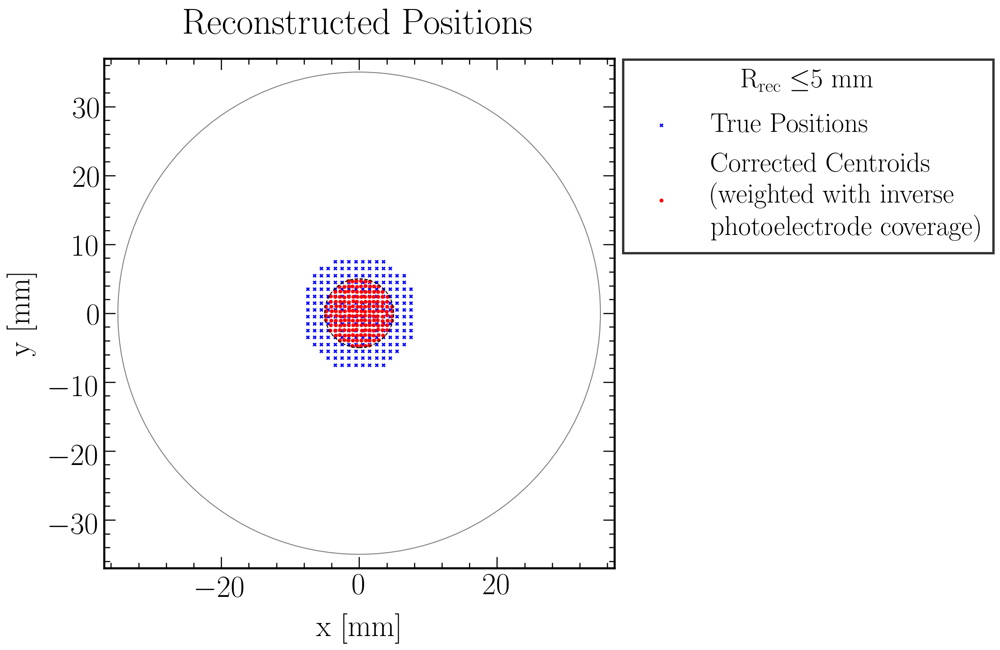

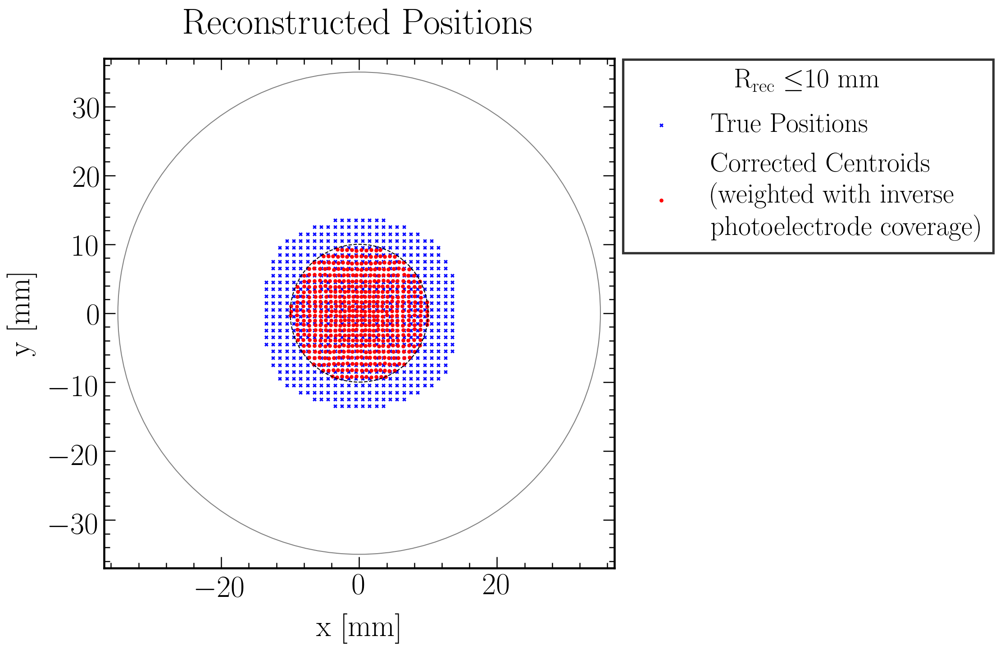

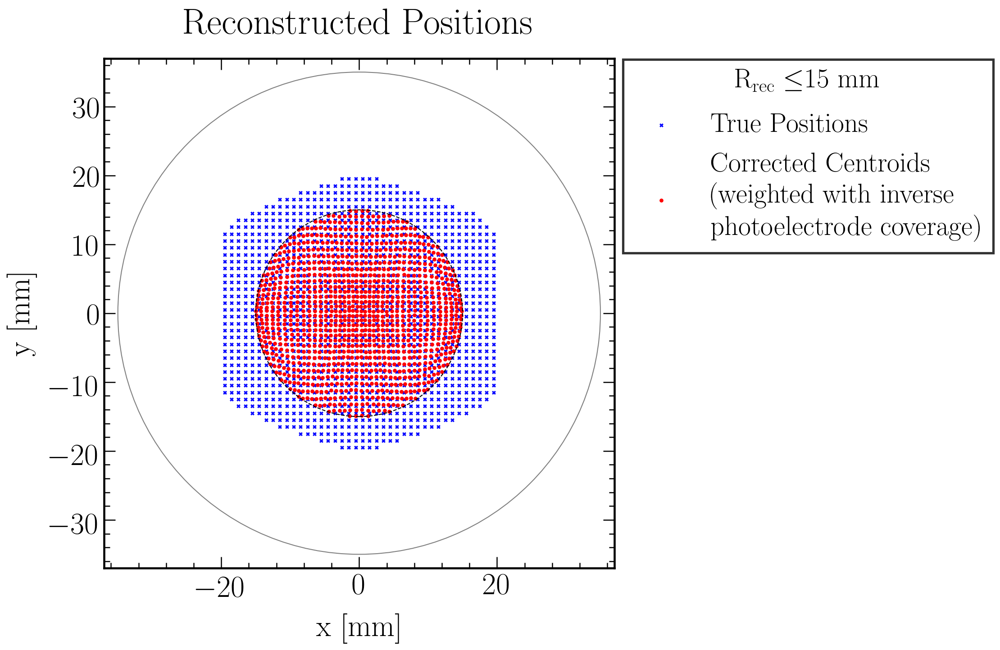

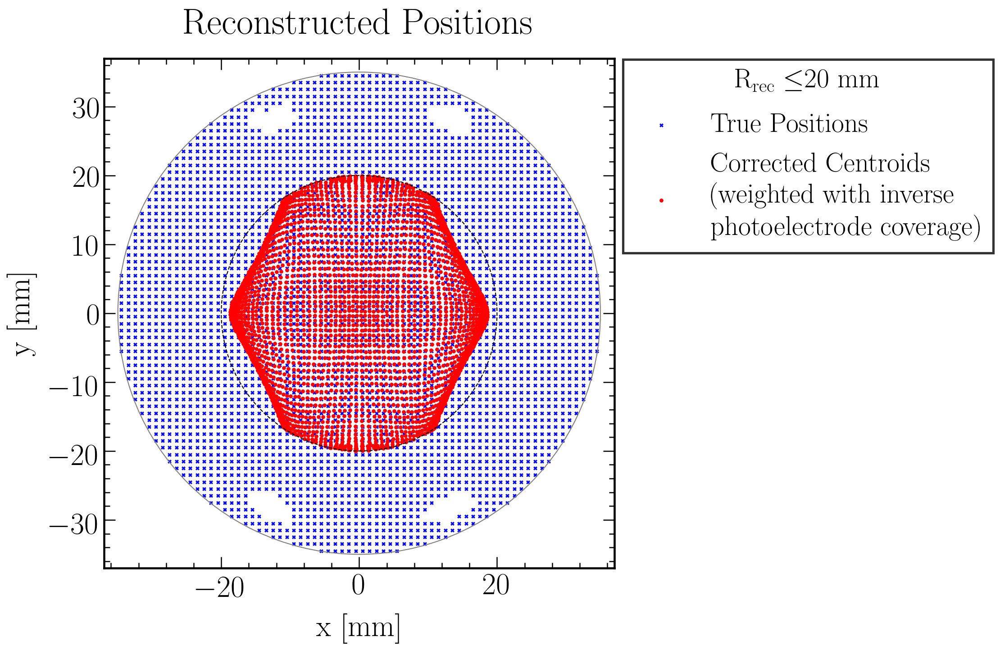

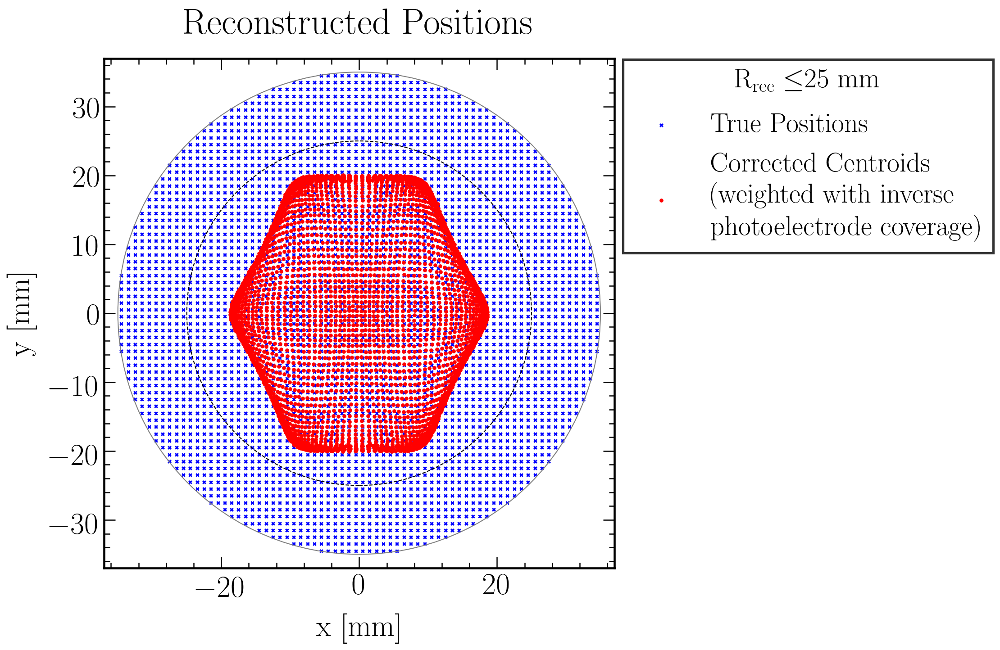

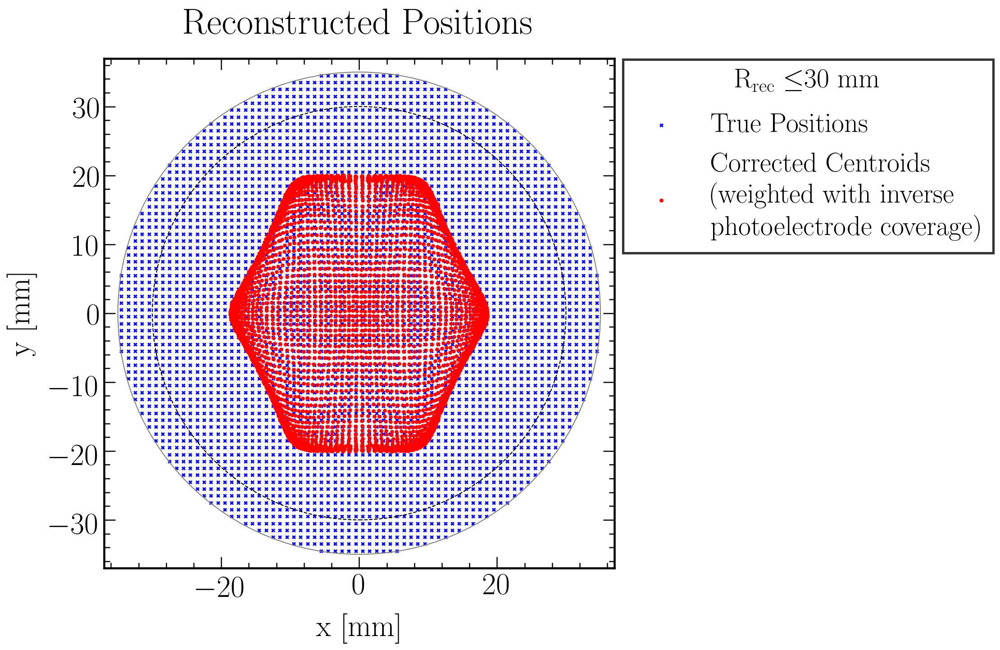

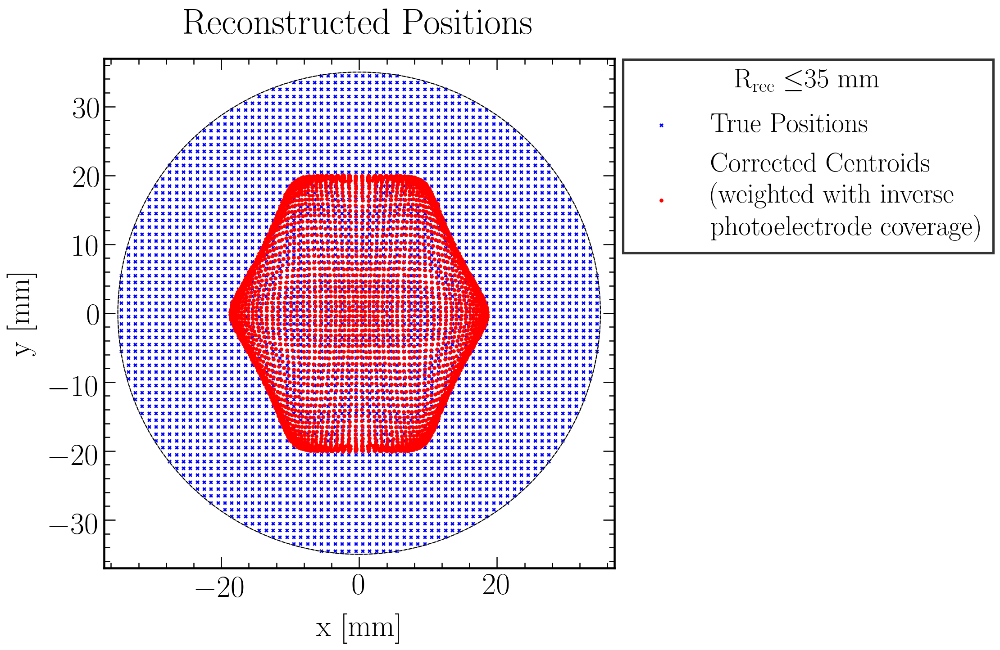

In [36]:
cutlist = [5, 10, 15, 20, 25, 30, 35]
for cut in cutlist:
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    #numberbins = 70

    # Data plot
    plt.scatter(x_true[f_polar_R(centroids_x, centroids_y) < cut], y_true[f_polar_R(centroids_x, centroids_y) < cut], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
    plt.scatter(centroids_x_corrected_PEC[f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], centroids_y_corrected_PEC[f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], color = 'red', s = 10, label = 'Corrected Centroids\n(weighted with inverse\nphotoelectrode coverage)')

    currentAxis = plt.gca()
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    circle2 = plt.Circle((0., 0.), cut, color='k', linestyle = '--', fill=False)
    currentAxis.add_artist(circle2)

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
    plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')
    plt.xlim(-37.,37.)
    plt.ylim(-37.,37.)

    # Legend
    leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, 
                     frameon=True, shadow=False, edgecolor='black', fancybox=False,
                     title = '$\mathrm{R}_{\mathrm{rec}} \leq $'+str(cut)+' mm')
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)
    leg.get_title().set_fontsize(0.9*label_size)
    #leg._legend_box.align = "left"

    plt.show()
    fig.savefig(filenameprefix+"_Centroids_CorrectedPEC_Confined"+str(cut)+".png", bbox_inches = "tight")

5
sigma_x = 1.7514947220998802 mm
sigma_y = 1.7874528713944149 mm


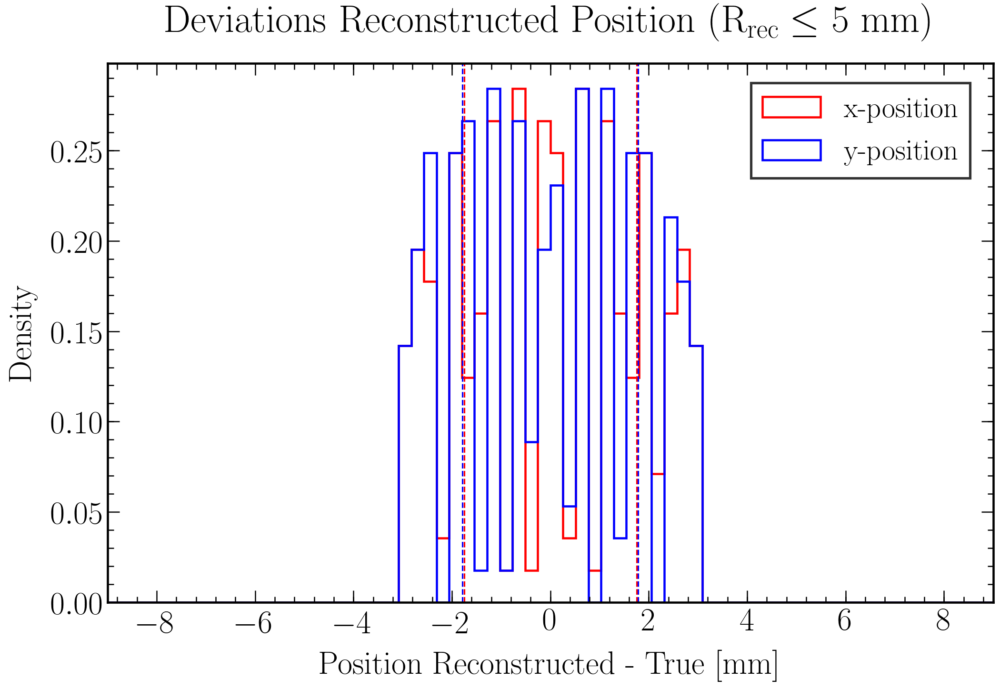

10
sigma_x = 2.5548299832865067 mm
sigma_y = 2.593365422743073 mm


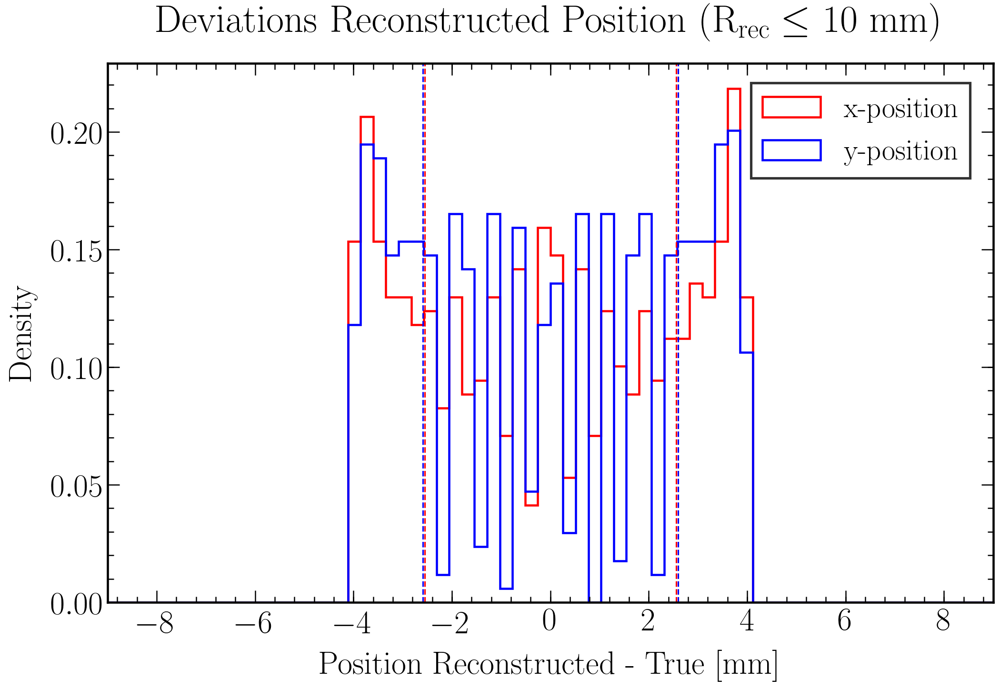

15
sigma_x = 3.263586888804282 mm
sigma_y = 3.094432365288716 mm


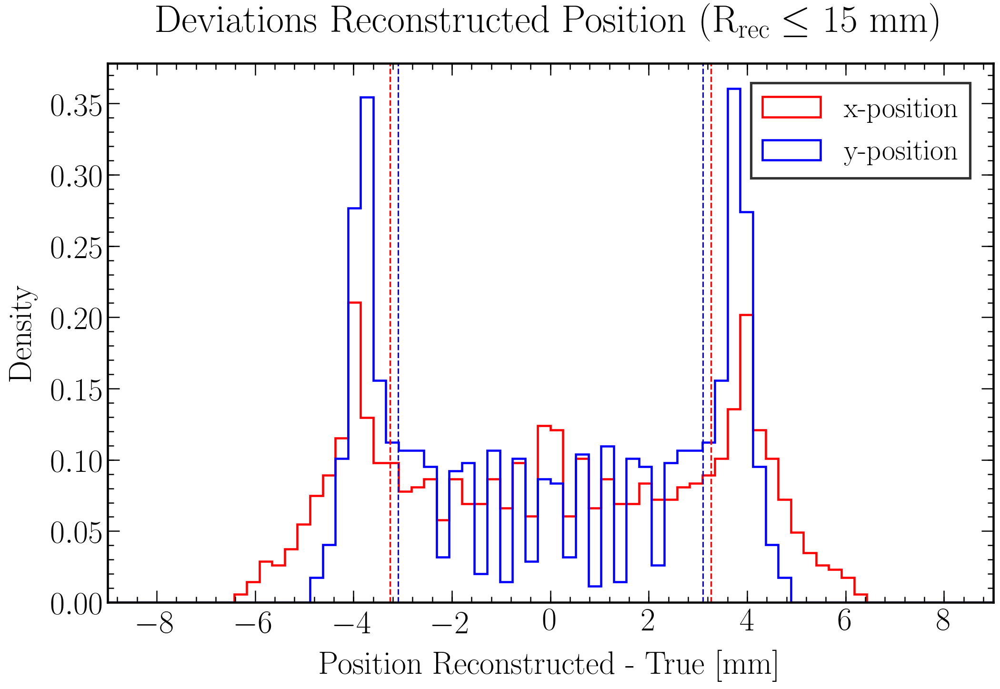

20
sigma_x = 7.113105004418516 mm
sigma_y = 6.2890495834048545 mm


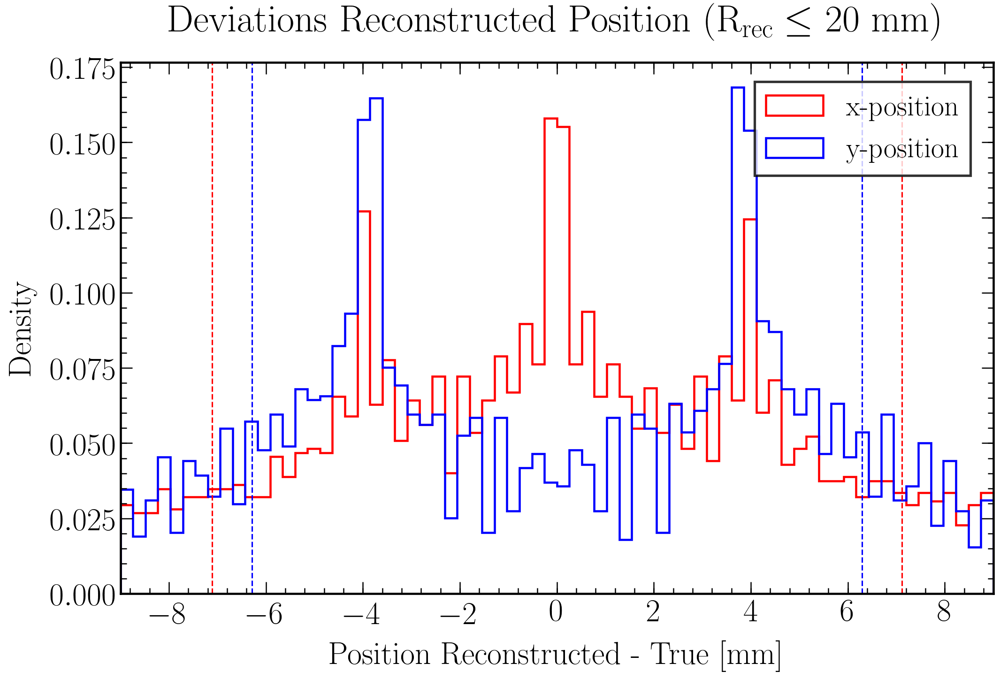

25
sigma_x = 7.073148806170933 mm
sigma_y = 6.386083598012095 mm


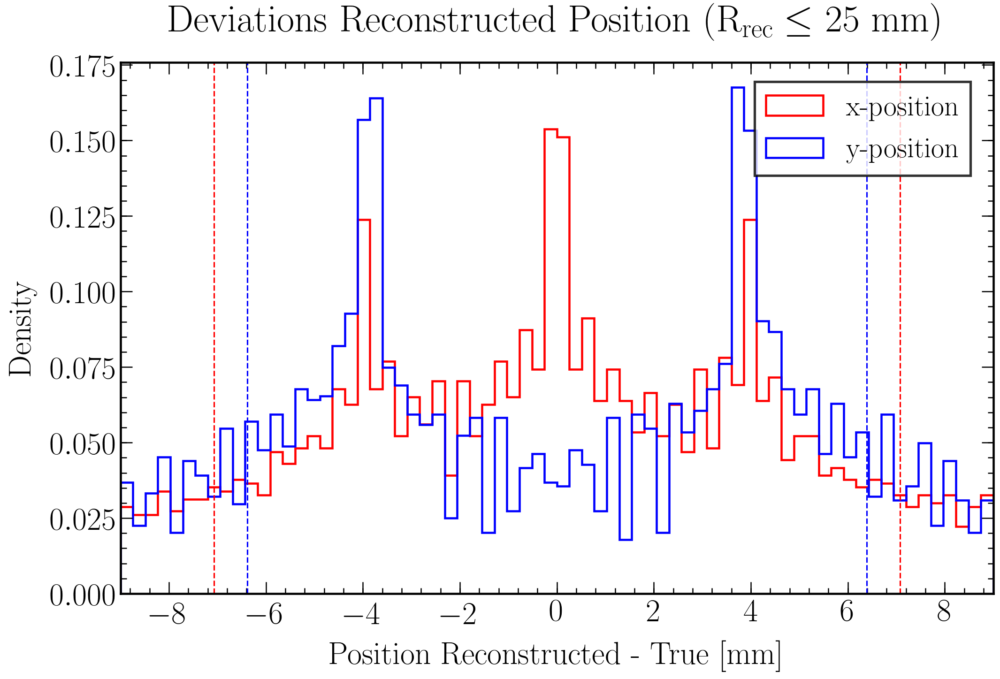

30
sigma_x = 7.073148806170933 mm
sigma_y = 6.386083598012095 mm


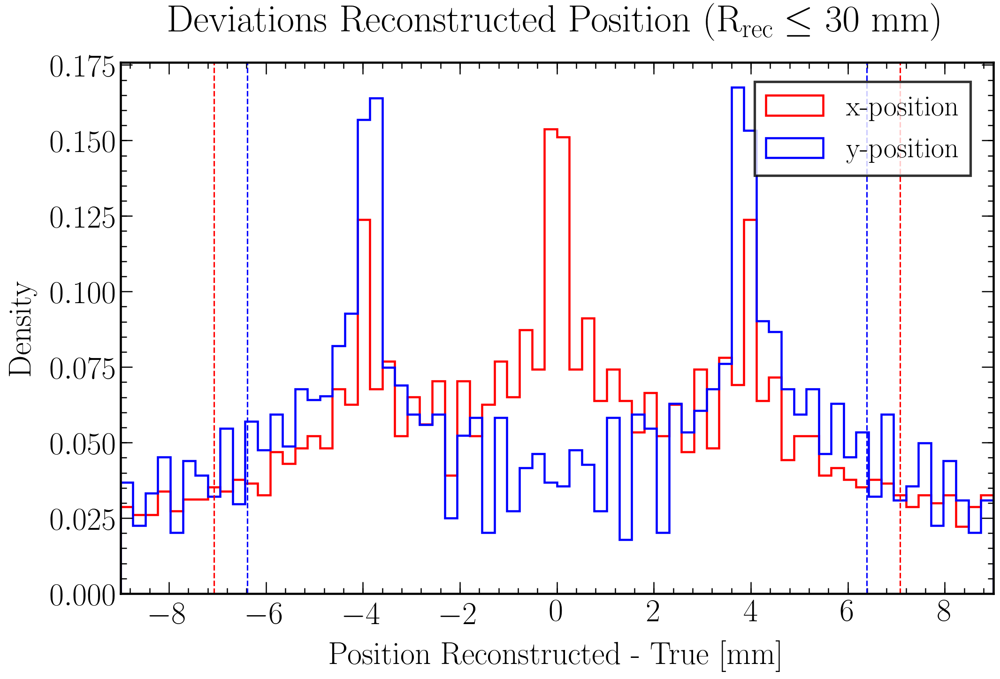

35
sigma_x = 7.073148806170933 mm
sigma_y = 6.386083598012095 mm


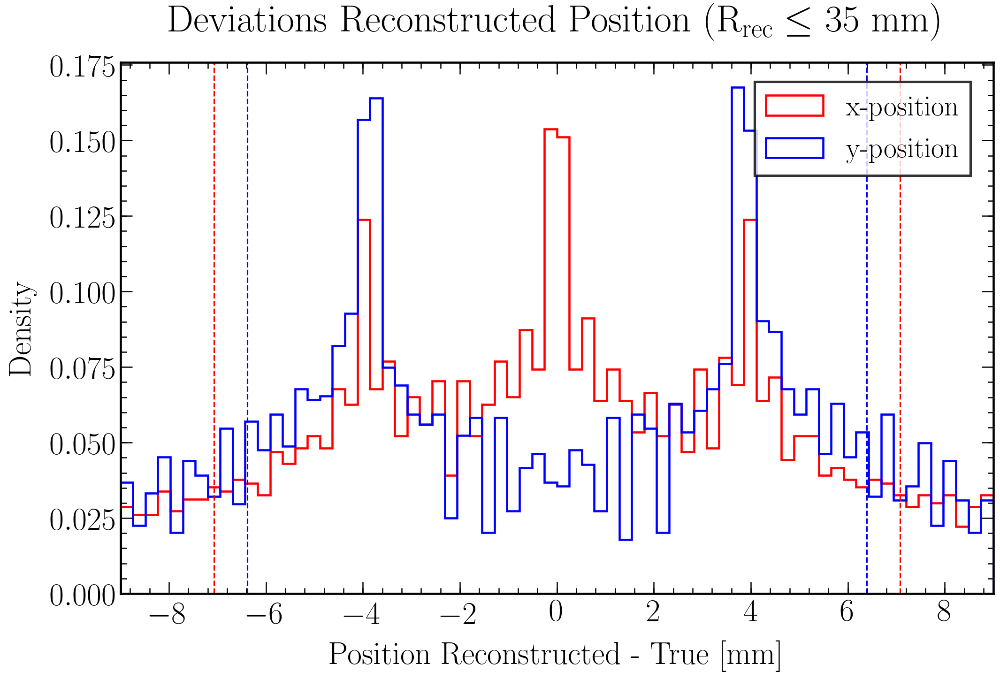

In [37]:
cutlist = [5, 10, 15, 20, 25, 30, 35]
for fid in cutlist:
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    # Grid
    #plt.grid(True)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    fid = fid
    print(fid)

    rng = (-9, 9)
    fid_mask = np.sqrt(centroids_x**2 + centroids_y**2) <= fid
    delta_x_list = (centroids_x - x_true)[fid_mask]
    delta_y_list = (centroids_y - y_true)[fid_mask]
    plt.hist(delta_x_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
    plt.hist(delta_y_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

    plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
    if fid > 35:
        plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)
    else:
        plt.title('Deviations Reconstructed Position ($\mathrm{R}_{\mathrm{rec}} \leq$ '+str(fid)+' mm)', fontsize = title_size, pad = title_pad)

    plt.xlim(-9,9)

    sigma_x = np.sqrt(np.var(delta_x_list))
    sigma_y = np.sqrt(np.var(delta_y_list))
    plt.axvline(x=sigma_x, color='red', linestyle='dashed')
    plt.axvline(x=-sigma_x, color='red', linestyle='dashed')
    print('sigma_x = '+str(sigma_x)+' mm')
    plt.axvline(x=sigma_y, color='blue', linestyle='dashed')
    plt.axvline(x=-sigma_y, color='blue', linestyle='dashed')
    print('sigma_y = '+str(sigma_y)+' mm')

    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Centroids_DeviationsHistConfined"+str(fid)+".png", bbox_inches = "tight")
    plt.show()

In [38]:
fid_list_more = [5, 7.5, 10, 12.5, 15, 17.5, 20, 22.5, 25, 27.5, 30, 32.5, 35]
Goodness_fiducialisation = pd.DataFrame(data={'fid': [], 'true_negative': [], 'false_negative': [], 'true_positive': [], 'false_positive': [], 'total': [], 'true_inside': [], 'true_outside': []})

r_reco = f_polar_R(centroids_x, centroids_y)
r_real = f_polar_R(x_true, y_true)

for fid in fid_list_more:
    true_negative = r_reco[(r_reco > fid) & (r_real > fid)].shape[0]
    false_negative = r_reco[(r_reco > fid) & (r_real <= fid)].shape[0]
    true_positive = r_reco[(r_reco <= fid) & (r_real <= fid)].shape[0]
    false_positive = r_reco[(r_reco <= fid) & (r_real > fid)].shape[0]
    total = r_reco.shape[0]
    true_inside = r_reco[(r_real <= fid)].shape[0]
    true_outside = r_reco[(r_real > fid)].shape[0]
    Goodness_fiducialisation = Goodness_fiducialisation.append(pd.DataFrame(data={
        'fid': [fid], 'true_negative': [true_negative], 'false_negative': [false_negative], 
        'true_positive': [true_positive], 'false_positive': [false_positive], 
        'total': [total], 'true_inside': [true_inside], 'true_outside': [true_outside]}), ignore_index=True)

Goodness_fiducialisation

,fid,true_negative,false_negative,true_positive,false_positive,total,true_inside,true_outside
0,5.0,3633.0,0.0,80.0,139.0,3852.0,80.0,3772.0
1,7.5,3436.0,0.0,172.0,244.0,3852.0,172.0,3680.0
2,10.0,3193.0,0.0,316.0,343.0,3852.0,316.0,3536.0
3,12.5,2916.0,0.0,484.0,452.0,3852.0,484.0,3368.0
4,15.0,2503.0,0.0,716.0,633.0,3852.0,716.0,3136.0
5,17.5,1447.0,0.0,952.0,1453.0,3852.0,952.0,2900.0
6,20.0,79.0,0.0,1264.0,2509.0,3852.0,1264.0,2588.0
7,22.5,0.0,0.0,1576.0,2276.0,3852.0,1576.0,2276.0
8,25.0,0.0,0.0,1976.0,1876.0,3852.0,1976.0,1876.0
9,27.5,0.0,0.0,2348.0,1504.0,3852.0,2348.0,1504.0


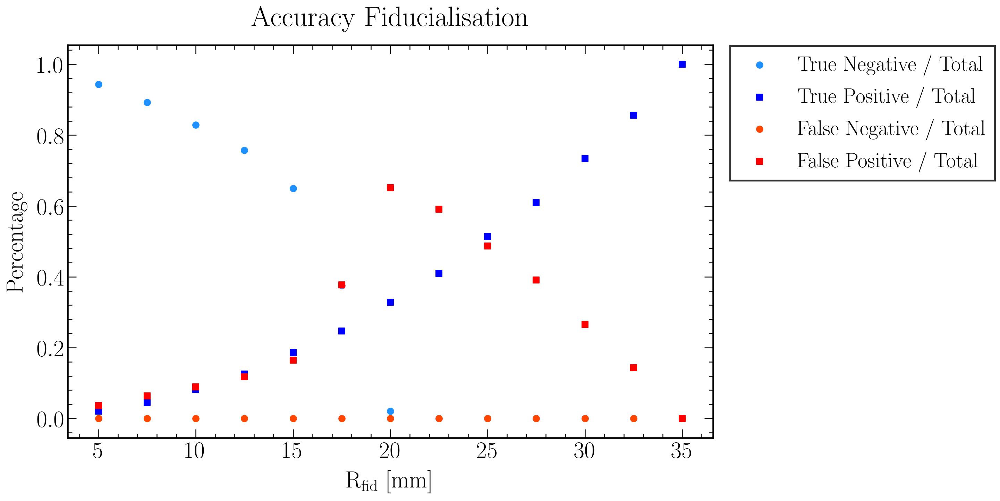

In [39]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
x = Goodness_fiducialisation['fid']

y = Goodness_fiducialisation['true_negative']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'True Negative / Total', color = 'dodgerblue', marker = 'o', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'dodgerblue')'''

y = Goodness_fiducialisation['true_positive']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'True Positive / Total', color = 'blue', marker = 's', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'blue')'''

y = Goodness_fiducialisation['false_negative']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'False Negative / Total', color = 'orangered', marker = 'o', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'orangered')'''

y = Goodness_fiducialisation['false_positive']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'False Positive / Total', color = 'red', marker = 's', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'red')'''

plt.ylabel('Percentage', fontsize = label_size, labelpad = label_pad)
plt.xlabel('$\mathrm{R}_{\mathrm{fid}}$ [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Accuracy Fiducialisation', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Centroids_Goodness_fiducialisation.png", bbox_inches = "tight")
plt.show()

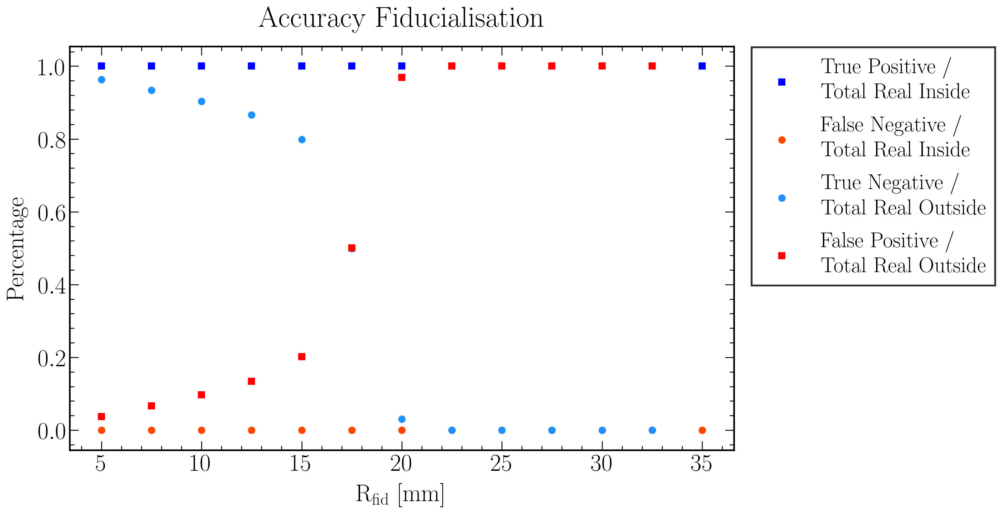

In [40]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
x = Goodness_fiducialisation['fid']
plt.scatter(x, Goodness_fiducialisation['true_positive']/Goodness_fiducialisation['true_inside'], label = 'True Positive /\nTotal Real Inside', color = 'blue', marker = 's', s = 80)
plt.scatter(x, Goodness_fiducialisation['false_negative']/Goodness_fiducialisation['true_inside'], label = 'False Negative /\nTotal Real Inside', color = 'orangered', marker = 'o', s = 80)
plt.scatter(x, Goodness_fiducialisation['true_negative']/Goodness_fiducialisation['true_outside'], label = 'True Negative /\nTotal Real Outside', color = 'dodgerblue', marker = 'o', s = 80)
plt.scatter(x, Goodness_fiducialisation['false_positive']/Goodness_fiducialisation['true_outside'], label = 'False Positive /\nTotal Real Outside', color = 'red', marker = 's', s = 80)

plt.ylabel('Percentage', fontsize = label_size, labelpad = label_pad)
plt.xlabel('$\mathrm{R}_{\mathrm{fid}}$ [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Accuracy Fiducialisation', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Centroids_Goodness_fiducialisation_normed.png", bbox_inches = "tight")
plt.show()

### Radial Dependence

In [41]:
# Fraction of arc length of radius r at radial position d inside circle of radius R
def arc_fraction(r, R, d):
    return np.piecewise(r, [r <= (R - d), r >= (R + d)], [lambda r: 1., lambda r: 0., lambda r: (1 / np.pi * np.arccos( (r**2 - R**2 + d**2) / (2 * d * r) ))])

# Fraction of arc length of radius r at radial position d inside circle of radius R
def arc_length(r, R, d):
    return 2 * np.pi * r * arc_fraction(r, R, d)

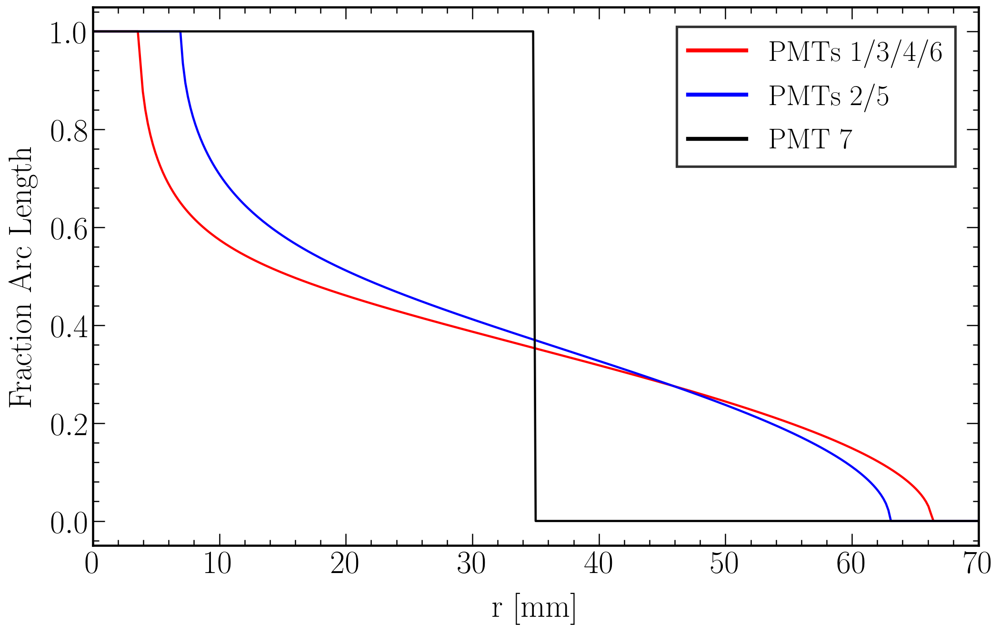

In [42]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
r = np.linspace(0.0, 70.0, num=71*5)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][1]), 'r', label = r"PMTs 1/3/4/6", linewidth = 2.2)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][2]), 'b', label = r"PMTs 2/5", linewidth = 2.2)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][7]), 'k', label = r"PMT  7", linewidth = 2.2)
    
plt.xlim(0,70)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Fraction Arc Length', fontsize = label_size, labelpad = label_pad)
#plt.title('Fraction Arc Length', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig("Fraction_ArcLengths.png")
plt.show()

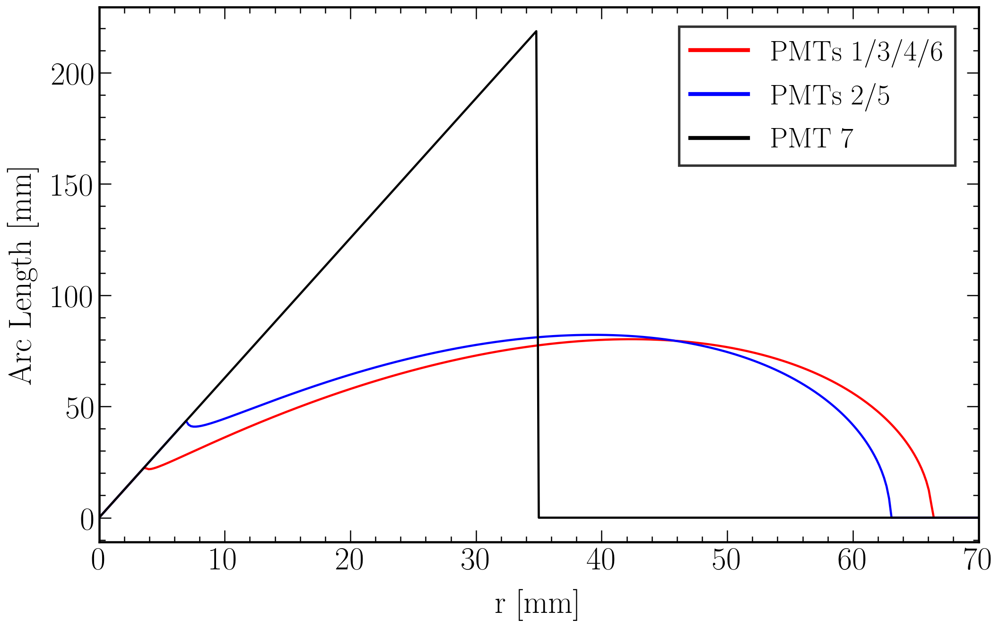

In [43]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
r = np.linspace(0.0, 70.0, num=71*5)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][1]), 'r', label = r"PMTs 1/3/4/6", linewidth = 2.2)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][2]), 'b', label = r"PMTs 2/5", linewidth = 2.2)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][7]), 'k', label = r"PMT  7", linewidth = 2.2)
    
plt.xlim(0,70)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Arc Length [mm]', fontsize = label_size, labelpad = label_pad)
#plt.title('Fraction Arc Length', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig("ArcLengths.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.


,PMT_ID,n,bins,bins_center
1,[1],"[0.0726592039800995, 0.0730659937888199, 0.073...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
2,[2],"[0.08632788461538463, 0.08573162118780095, 0.0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
3,[3],"[0.0730525, 0.07290825852782765, 0.07283280159...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
4,[4],"[0.07274646464646464, 0.07336060606060606, 0.0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
5,[5],"[0.08626777251184836, 0.08634838187702265, 0.0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
6,[6],"[0.07333926701570681, 0.07311782820097247, 0.0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
7,[7],"[0.08159799999999999, 0.08155073891625615, 0.0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."


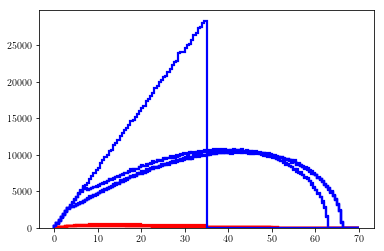

In [44]:
numberbins = 70*2

LCE_R_hist = pd.DataFrame({'PMT_ID': [],'n': [], 'bins': [], 'bins_center': []})
columns = ['PMT_ID', 'n', 'bins', 'bins_center']

for i in range(1,8):
    n_pmti, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["pmthits_"+str(i)], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'red')
    n_top, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = None, range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'blue')

    LCE_R_hist_PMTi_n = n_pmti / n_top
    LCE_R_hist_PMTi_bins = bins
    LCE_R_hist_PMTi_bins_center = (bins[:-1]+bins[1:])/2

    values = [np.array([i]), LCE_R_hist_PMTi_n, LCE_R_hist_PMTi_bins, LCE_R_hist_PMTi_bins_center]
    LCE_R_hist = LCE_R_hist.append(pd.DataFrame(index = [i], data = [np.array(values)], columns=columns)) #, ignore_index=True

#LCE_R_hist = pd.DataFrame(index = [7], data={'PMT_ID': [7],'n': [LCE_R_hist_PMT7_n], 'bins': [LCE_R_hist_PMT7_bins], 'bins_center': [LCE_R_hist_PMT7_bins_center]})

LCE_R_hist.to_pickle(filenameprefix+"_LCE_R_hist.pkl")
LCE_R_hist

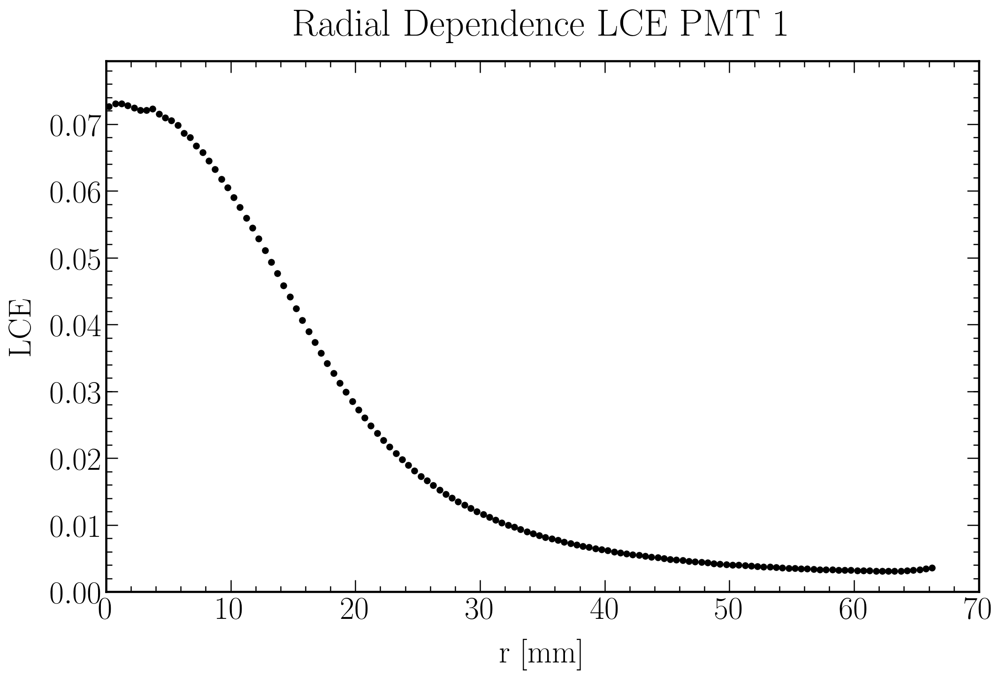

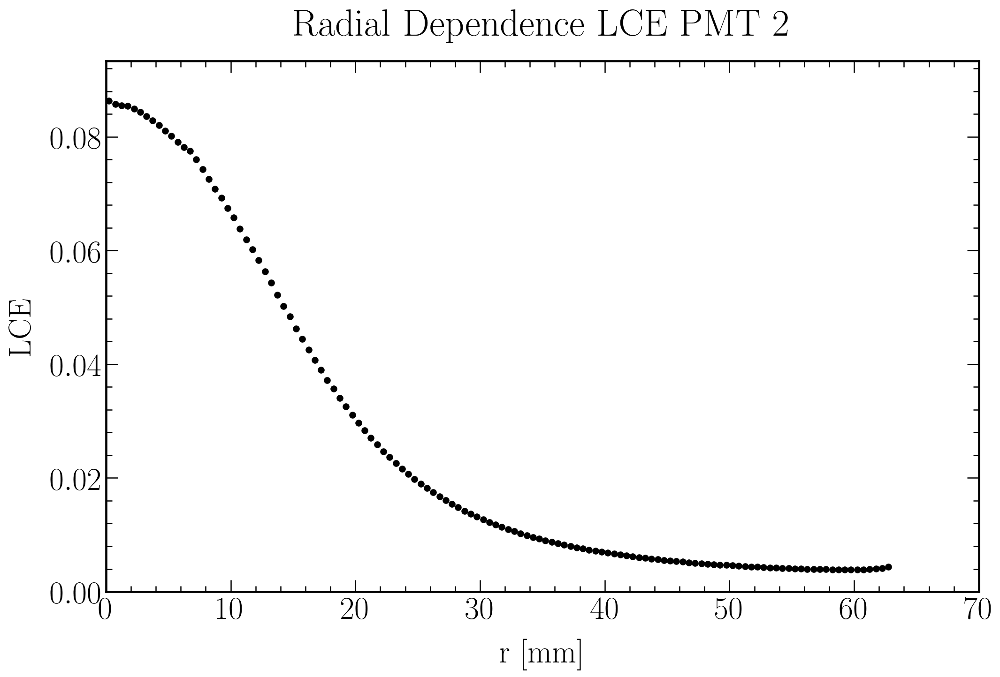

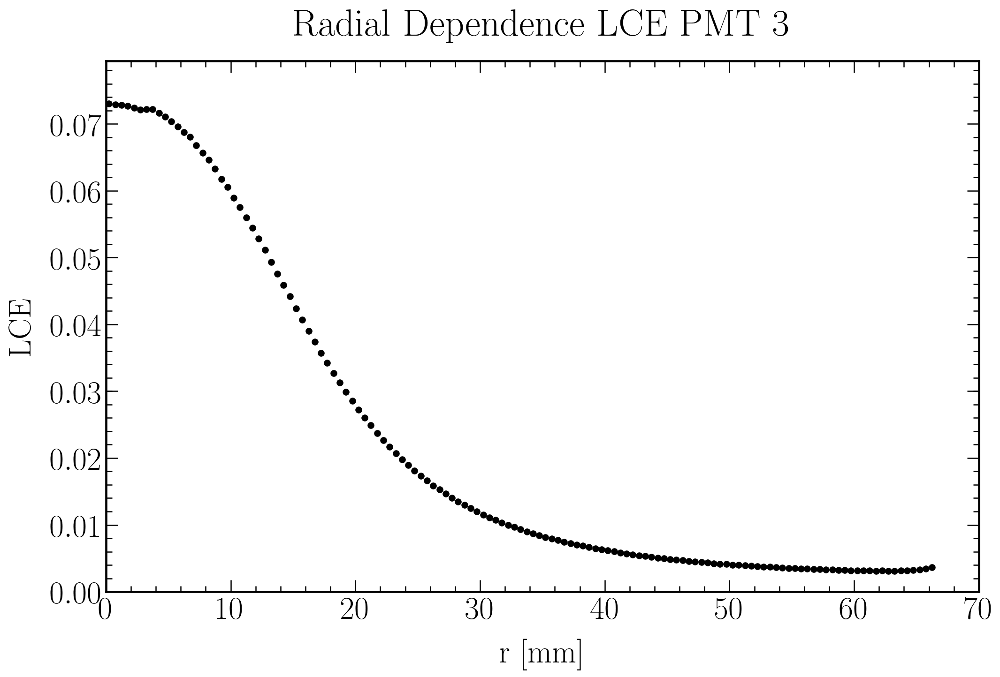

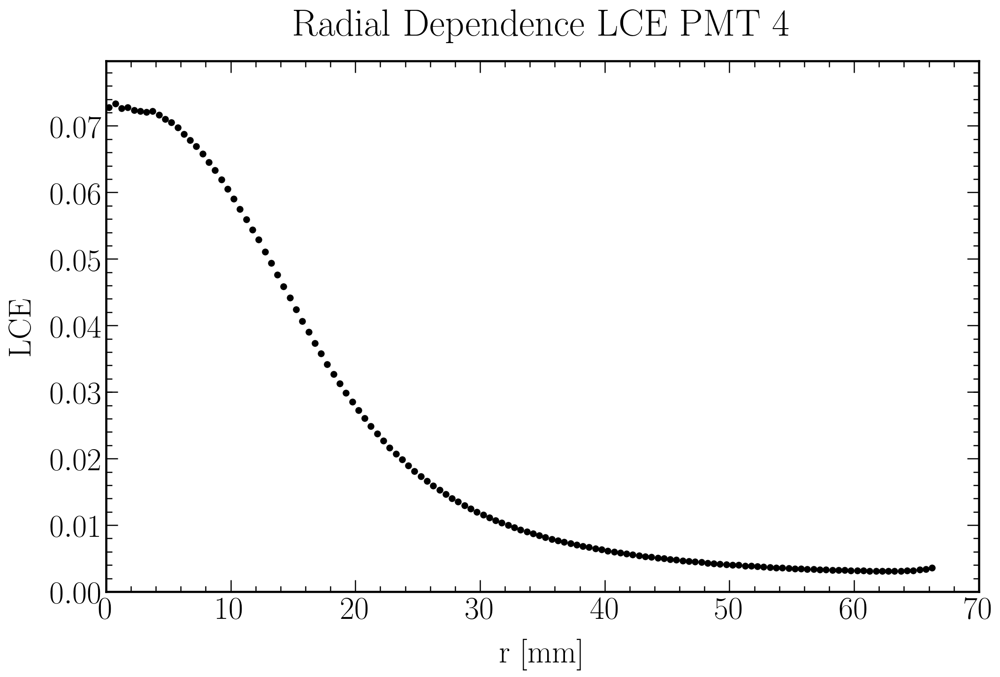

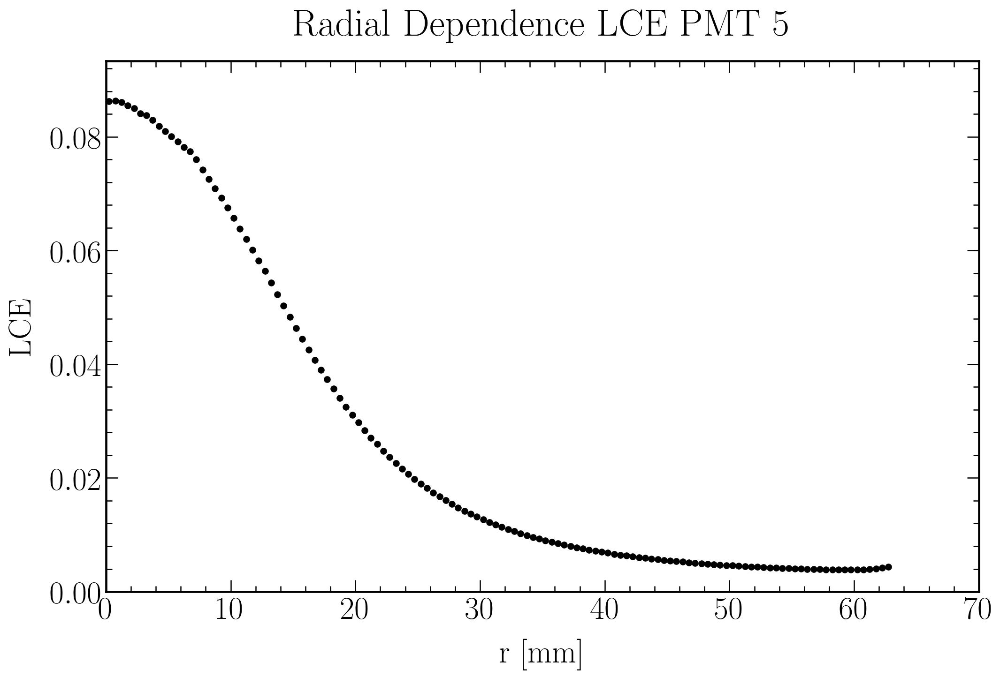

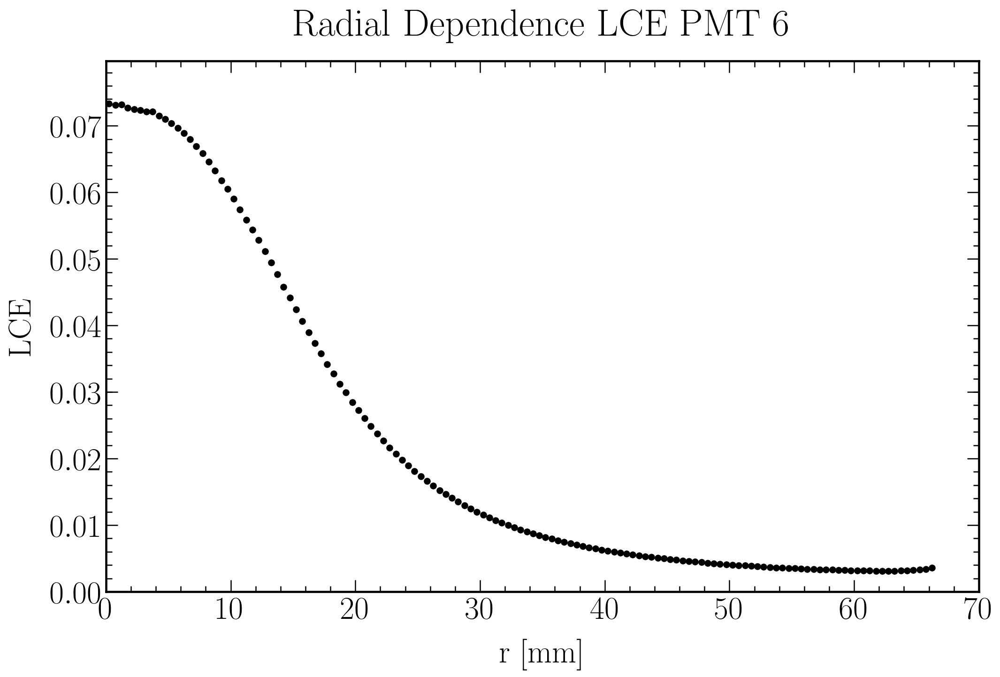

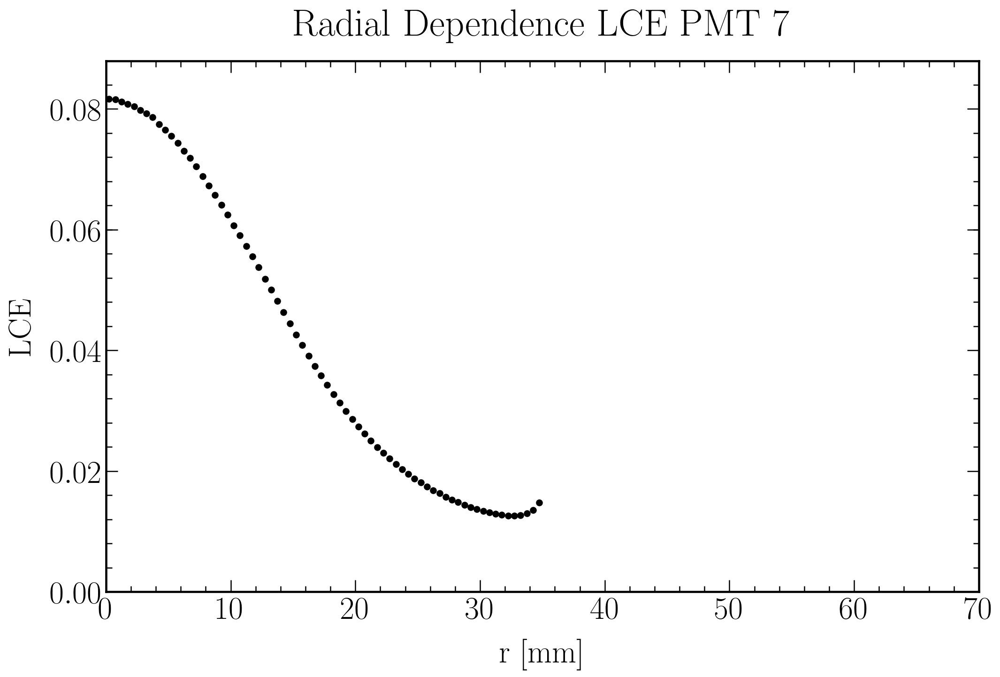

In [45]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70*2

    # Data plot
    plt.scatter(LCE_R_hist['bins_center'][i], LCE_R_hist['n'][i], color = 'k')

    plt.ylim(bottom=0)
    plt.xlim(0.,35.*2)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('LCE', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence LCE PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_LCE_R_PMT"+str(i)+".png")

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.
/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]


,PMT_ID,n,std_red,bins,bins_center
1,[1],"[0.590037896233809, 0.5929463148224924, 0.5922...","[0.0030581434463681882, 0.0017716522016286117,...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
2,[2],"[0.6430658816451073, 0.639918528724615, 0.6394...","[0.0030643385568719043, 0.001813357046008253, ...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
3,[3],"[0.593421009877827, 0.5924690160263192, 0.5906...","[0.0029980093427766272, 0.00186577576130425, 0...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
4,[4],"[0.5908572553716905, 0.5942309456231485, 0.590...","[0.0031411768662053573, 0.0017647093593498038,...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
5,[5],"[0.641660615204563, 0.6424715324213757, 0.6413...","[0.0030029144566121593, 0.0018815476851770157,...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
6,[6],"[0.5931411779152533, 0.5924833931765591, 0.592...","[0.003090589346065818, 0.0017426187414142852, ...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
7,[7],"[0.5384958044473188, 0.5388768570399336, 0.537...","[0.0026924405119455584, 0.0015818183141764377,...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."


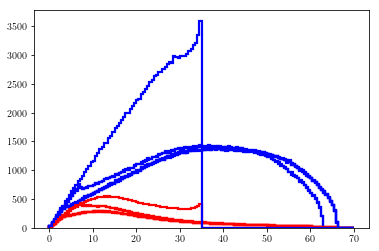

In [46]:
numberbins = 70*2

HF_R_hist = pd.DataFrame({'PMT_ID': [],'n': [],'std_red': [], 'bins': [], 'bins_center': []})
columns = ['PMT_ID', 'n', 'std_red', 'bins', 'bins_center']

for i in range(1,8):
    n_pmti, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["pmthits_"+str(i)], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'red')
    n_top, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["ntpmthits"], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'blue')

    HF_R_hist_PMTi_n = n_pmti / n_top
    HF_R_hist_PMTi_bins = bins
    HF_R_hist_PMTi_bins_center = (bins[:-1]+bins[1:])/2
    
    statistic_i, _, _ = stats.binned_statistic(
        f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],
                  _chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), 
        np.array(_chunk_collect["pmthits_"+str(i)]), 
        statistic='mean', bins=(numberbins), range=(0,70))
    statistic_top, _, _ = stats.binned_statistic(
        f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],
                  _chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), 
        _chunk_collect["ntpmthits"], 
        statistic='mean', bins=(numberbins), range=(0,70))
    std_i, _, _ = stats.binned_statistic(
        f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],
                  _chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), 
        np.array(_chunk_collect["pmthits_"+str(i)]), 
        statistic='std', bins=(numberbins), range=(0,70))
    std_top, _, _ = stats.binned_statistic(
        f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],
                  _chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), 
        _chunk_collect["ntpmthits"], 
        statistic='std', bins=(numberbins), range=(0,70))
    HF_R_hist_PMTi_std = (statistic_i/statistic_top) * np.sqrt((std_i/statistic_i)**2 + (std_top/statistic_top)**2)
    count_top, _, _ = stats.binned_statistic(
        f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],
                  _chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), 
        _chunk_collect["ntpmthits"], 
        statistic='count', bins=(numberbins), range=(0,70))
    HF_R_hist_PMTi_std_red = HF_R_hist_PMTi_std / np.sqrt(count_top)
    HF_R_hist_PMTi_std_red = HF_R_hist_PMTi_std_red[~np.isnan(HF_R_hist_PMTi_std_red)]

    values = [np.array([i]), HF_R_hist_PMTi_n, HF_R_hist_PMTi_std_red, HF_R_hist_PMTi_bins, HF_R_hist_PMTi_bins_center]
    HF_R_hist = HF_R_hist.append(pd.DataFrame(index = [i], data = [np.array(values)], columns=columns)) #, ignore_index=True

#HF_R_hist = pd.DataFrame(index = [7], data={'PMT_ID': [7],'n': [HF_R_hist_PMT7_n], 'bins': [HF_R_hist_PMT7_bins], 'bins_center': [HF_R_hist_PMT7_bins_center]})

# remove nan
for i in range(1,8):
    HF_R_hist['bins_center'][i] = HF_R_hist['bins_center'][i][:len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])]
    HF_R_hist['bins'][i] = HF_R_hist['bins'][i][:(len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])+1)]
    HF_R_hist['n'][i] = HF_R_hist['n'][i][:len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])]

'''HF_R_hist.to_csv(filenameprefix+'_HF_R_hist.csv', index=False) # , sep='\t', encoding='utf-8''';
HF_R_hist.to_pickle(filenameprefix+"_HF_R_hist.pkl")
HF_R_hist

In [47]:
## import from csv
# HF_R_hist = pd.read_csv('optPhot_S2_1e6_HF_R_hist.csv', index_col = 'PMT_ID', converters={'n': from_np_array, 'bins': from_np_array, 'bins_center': from_np_array})
## import from pkl
# HF_R_hist = pd.read_pickle("output/"+filenameprefix+"_HF_R_hist.pkl")
# LCE_R_hist = pd.read_pickle("output/"+filenameprefix+"_LCE_R_hist.pkl")

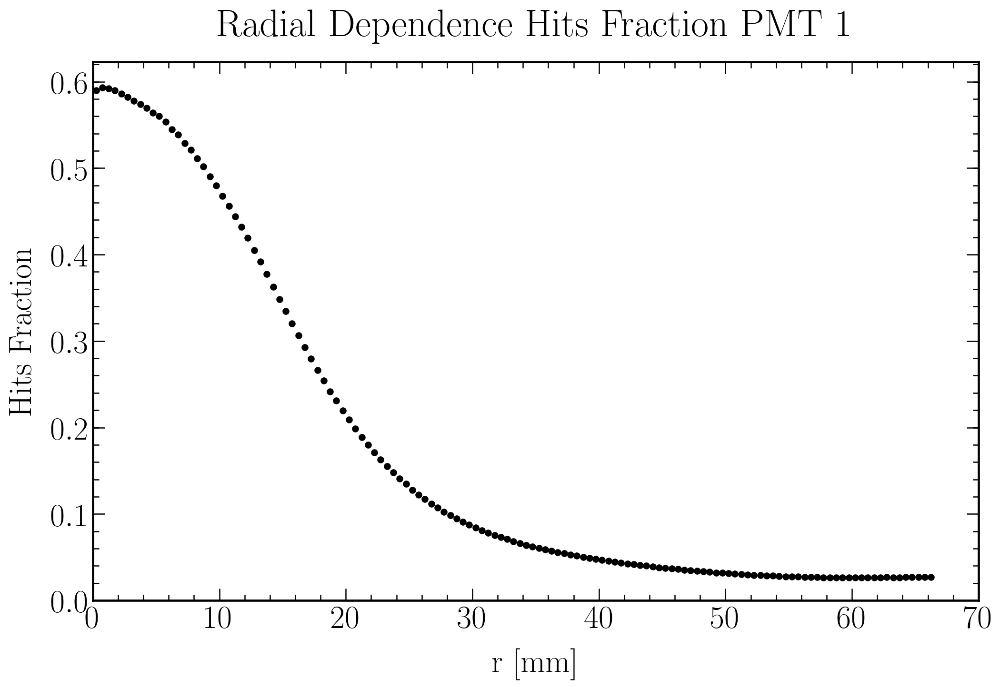

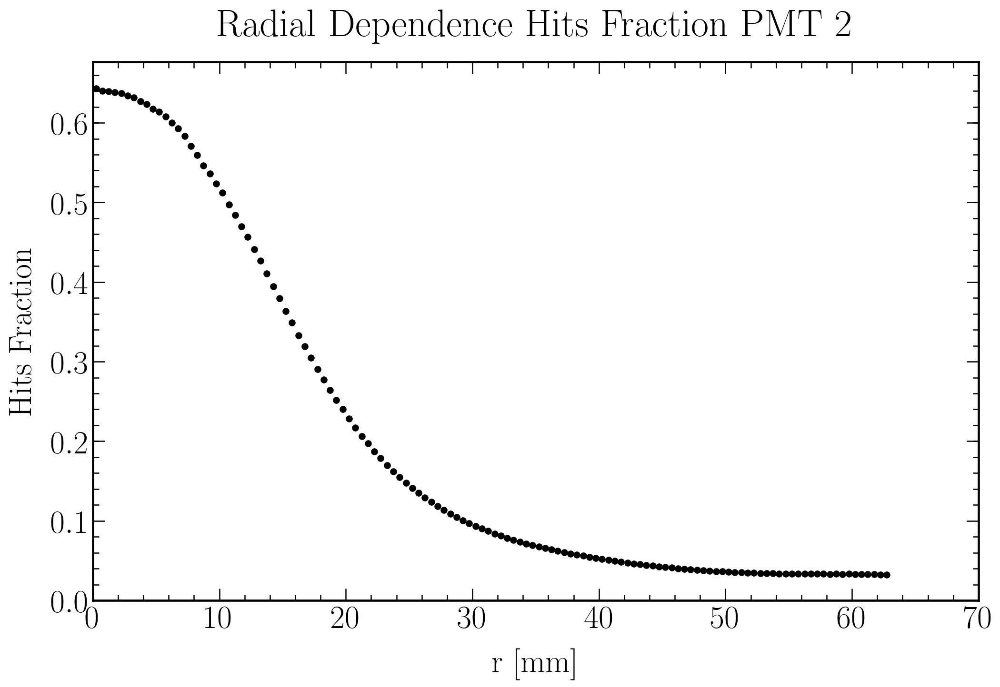

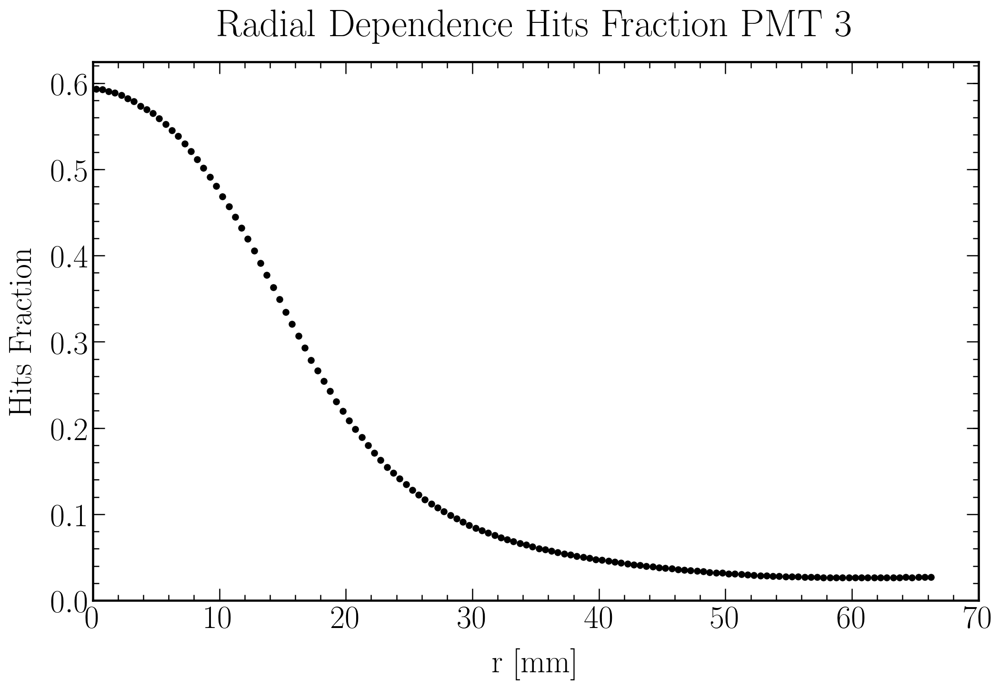

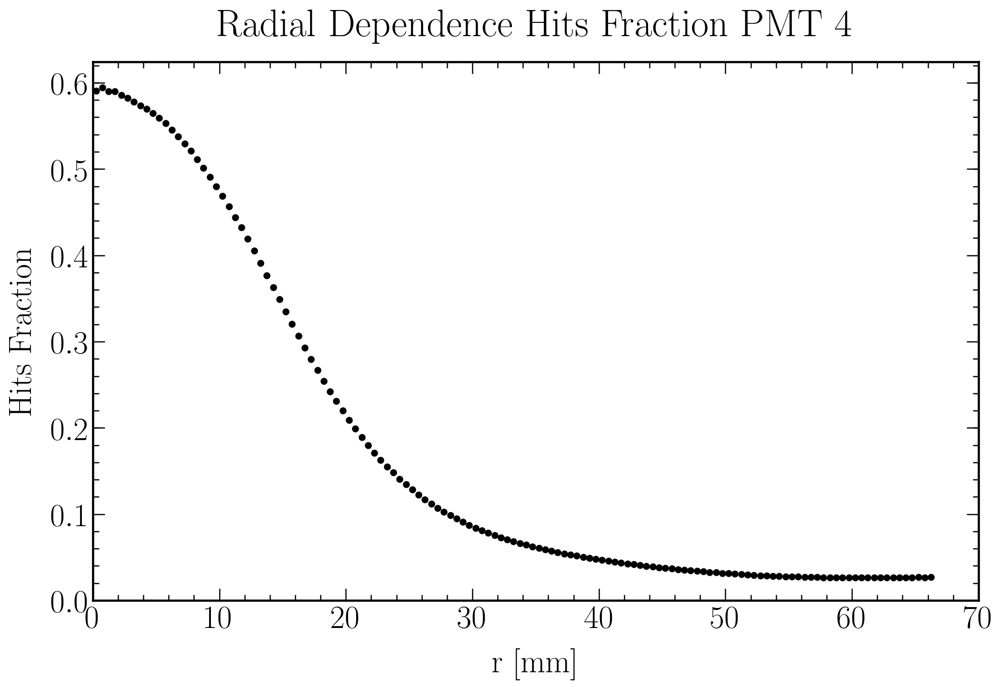

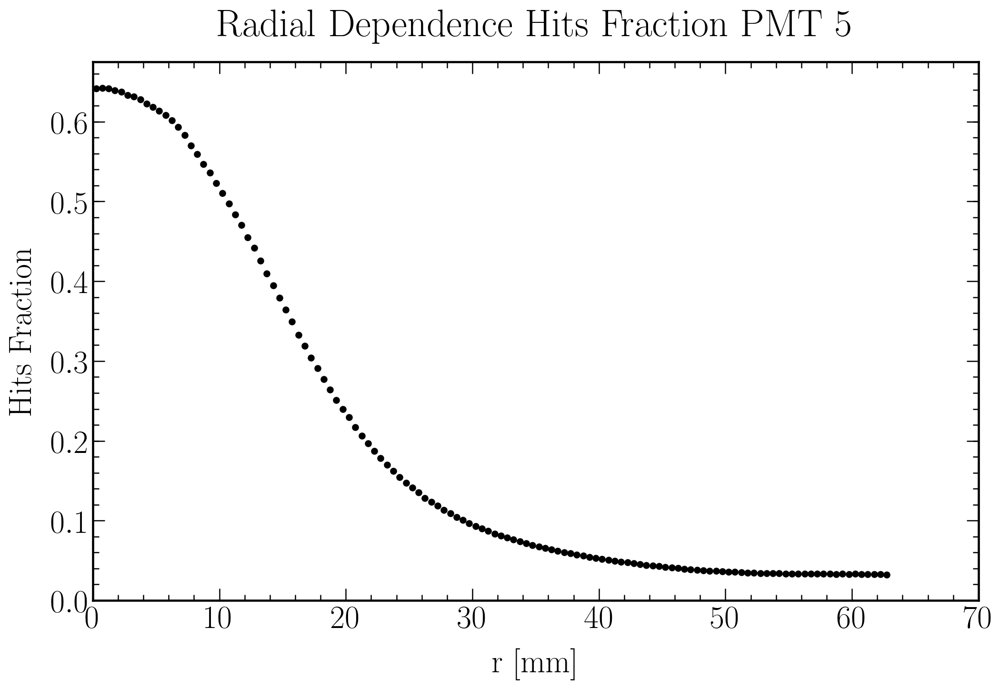

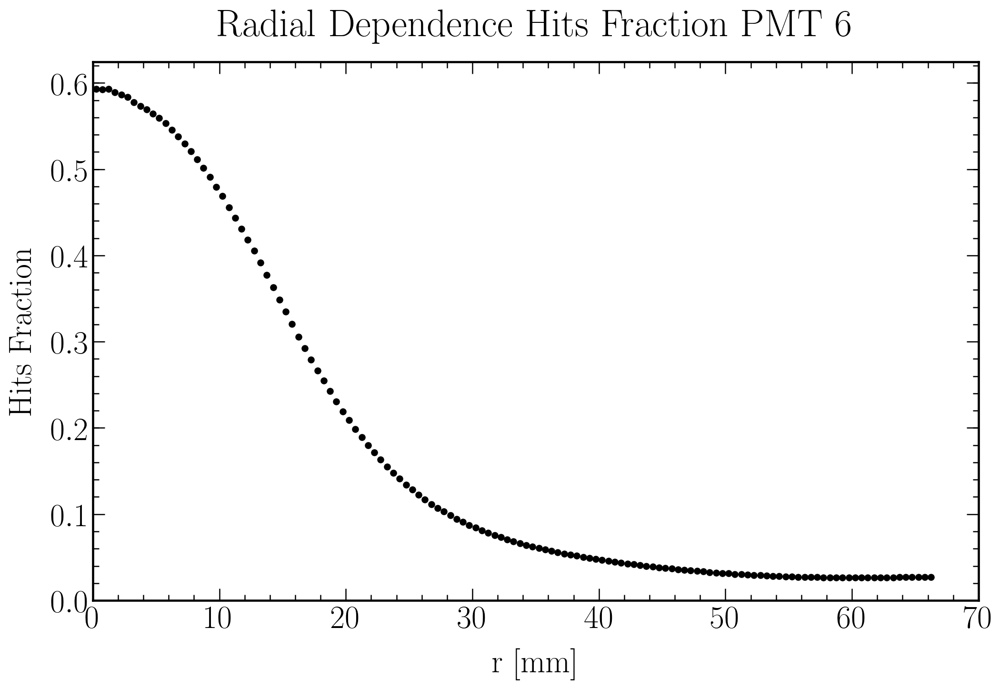

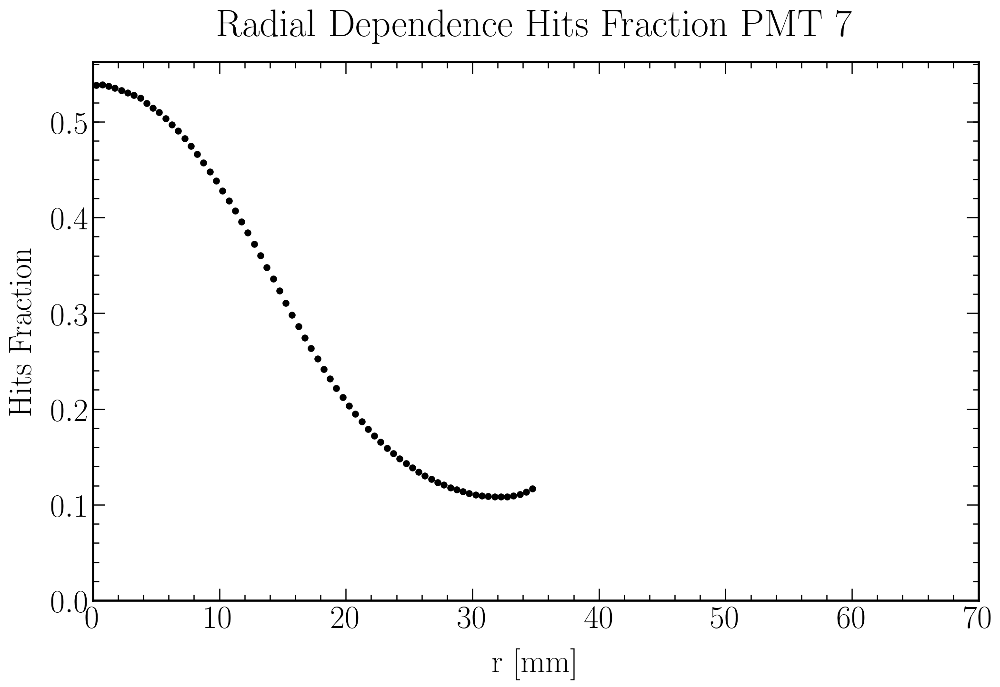

In [48]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70*2

    # Data plot
    #plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k')
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o', color = 'k') 

    plt.ylim(bottom=0)
    plt.xlim(0.,35.*2)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+".png")

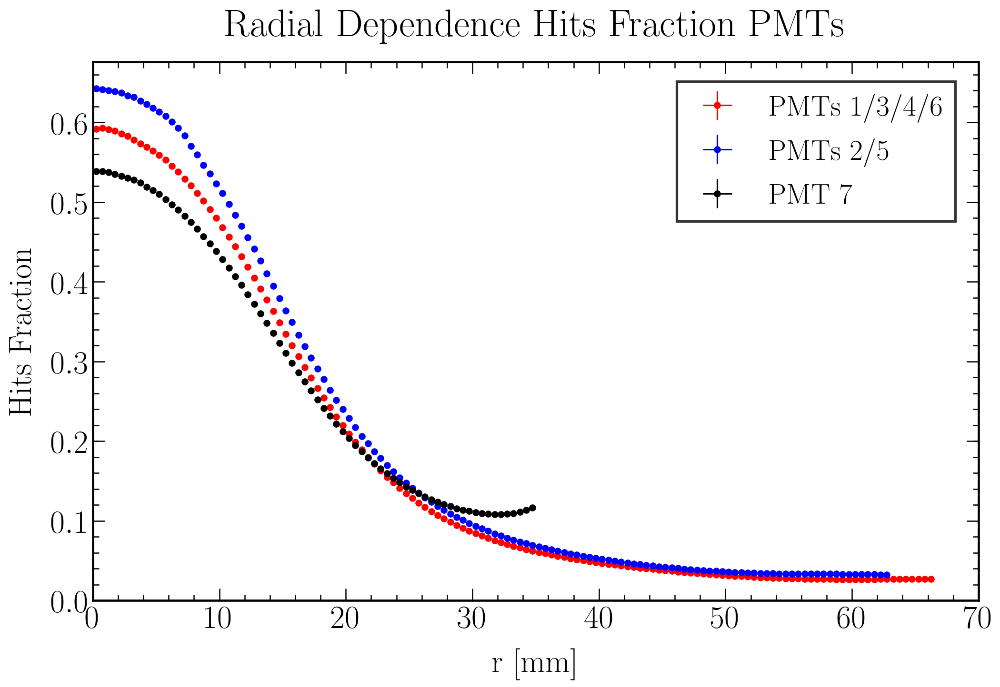

In [49]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70*2

# Data plot
#plt.scatter(HF_R_hist['bins_center'][1], (HF_R_hist['n'][1]+HF_R_hist['n'][3]+HF_R_hist['n'][4]+HF_R_hist['n'][6])/4, color = 'r', label = "PMTs 1/3/4/6")
plt.errorbar(HF_R_hist['bins_center'][1], (HF_R_hist['n'][1]+HF_R_hist['n'][3]+HF_R_hist['n'][4]+HF_R_hist['n'][6])/4, color = 'r', label = "PMTs 1/3/4/6", yerr=HF_R_hist['std_red'][1], xerr = (70/numberbins)/np.sqrt(12), fmt='o') 
#plt.scatter(HF_R_hist['bins_center'][2], (HF_R_hist['n'][2]+HF_R_hist['n'][5])/2, color = 'b', label = "PMTs 2/5")
plt.errorbar(HF_R_hist['bins_center'][2], (HF_R_hist['n'][2]+HF_R_hist['n'][5])/2, color = 'b', label = "PMTs 2/5", yerr=HF_R_hist['std_red'][2], xerr = (70/numberbins)/np.sqrt(12), fmt='o') 
'''
plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r')
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b')
plt.scatter(HF_R_hist['bins_center'][3], HF_R_hist['n'][3], color = 'r')
plt.scatter(HF_R_hist['bins_center'][4], HF_R_hist['n'][4], color = 'r')
plt.scatter(HF_R_hist['bins_center'][5], HF_R_hist['n'][5], color = 'b')
plt.scatter(HF_R_hist['bins_center'][6], HF_R_hist['n'][6], color = 'r')
'''
#plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")
plt.errorbar(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7", yerr=HF_R_hist['std_red'][7], xerr = (70/numberbins)/np.sqrt(12), fmt='o') 

plt.ylim(bottom=0)
plt.xlim(0.,35.*2)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs.png")

In [50]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(HF_R_hist_PMT7_bins_center, HF_R_hist_PMT7_n / HF_R_hist_PMT7_n.mean(), color = 'Blue', label = 'Relative Hit Fraction')
plt.scatter(LCE_R_hist_PMT7_bins_center, LCE_R_hist_PMT7_n / LCE_R_hist_PMT7_n.mean(), color = 'Red', label = 'Relative LCE')

plt.ylim(bottom=0)
plt.xlim(0.,35.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Relative Light Response', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Light Response PMT 7', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_LCEvsHF_R_PMT7.png")''';

### Radial LRF

In [51]:
#filenameprefix = "optPhot_S2_3e7"
#HF_R_hist = pd.read_pickle('output/optPhot_S2_3e7_HF_R_hist.pkl')

In [52]:
## General additional function definitions

def exponetial(x, a, b, c):
    return a * np.exp(-b * x) + c

def gaussian(x, amp, cen, wid):
    return amp * exp(-(x-cen)**2 / wid)

def WoodsSaxonPotential(r, R, a, V0):
    return - V0 / (1 + exp((r - R) / a))

In [53]:
## Radial fit functions for LRF

## Position Reconstruction in LUX, https://arxiv.org/abs/1710.02752v2
def eta_v1(r, A, gamma, m, b):
    return A / (1 + gamma ** 2 * r ** 2) ** (3/2) + m * r + b

## Position Reconstruction in a Dual Phase Xenon Scintillation Detector, https://arxiv.org/abs/1112.1481
def eta_v2(r, A, r0, a, b, alpha):
    return A * exp( - a * (r/r0) / (1 + (r/r0) ** (1 - alpha)) - b / (1 + (r/r0) ** (- alpha)))   

## Modified Woods Saxon Potential
def eta_v3(r, R, a, V0, d):
    return V0 / (1 + np.exp((r - R) / a)) + d

## Modified Woods Saxon Potential + Linear
def eta_v4(r, R, a, V0, d, m):
    return V0 / (1 + np.exp((r - R) / a)) + d + m * r

#####################################################
## CHOICE FOR LRF MODEL
model = eta_v2
modelstring = 'eta_v2'

In [54]:
## Fits

fit_parameters_eta_v1 = np.array([None]*7)
pcov_eta_v1 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v1, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v1[i-1] = popt
    pcov_eta_v1[i-1] = pcov
    
fit_parameters_eta_v2 = np.array([None]*7)
pcov_eta_v2 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v2, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v2[i-1] = popt
    pcov_eta_v2[i-1] = pcov
#print('popt_eta_v2 = \n'+str(fit_parameters_eta_v2))

fit_parameters_eta_v3 = np.array([None]*7)
pcov_eta_v3 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v3, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v3[i-1] = popt
    pcov_eta_v3[i-1] = pcov
    
fit_parameters_eta_v4 = np.array([None]*7)
pcov_eta_v4 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v4, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v4[i-1] = popt
    pcov_eta_v4[i-1] = pcov

    
## Goodness of fit

r_squared_eta_v1_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
r_squared_eta_v2_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
r_squared_eta_v3_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
r_squared_eta_v4_list = np.full_like(np.ones(7), np.nan, dtype=np.double)

chi_squared_eta_v1_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_eta_v2_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_eta_v3_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_eta_v4_list = np.full_like(np.ones(7), np.nan, dtype=np.double)

chi_squared_pvalue_eta_v1_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_pvalue_eta_v2_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_pvalue_eta_v3_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
chi_squared_pvalue_eta_v4_list = np.full_like(np.ones(7), np.nan, dtype=np.double)

g_test_eta_v1_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
g_test_eta_v2_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
g_test_eta_v3_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
g_test_eta_v4_list = np.full_like(np.ones(7), np.nan, dtype=np.double)

red_chi_squared_eta_v1_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
red_chi_squared_eta_v2_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
red_chi_squared_eta_v3_list = np.full_like(np.ones(7), np.nan, dtype=np.double)
red_chi_squared_eta_v4_list = np.full_like(np.ones(7), np.nan, dtype=np.double)

dof_eta_v1_list = np.array([(len(HF_R_hist['bins_center'][k]) 
                             - len(fit_parameters_eta_v1[k-1])) for k in range(1,8)])
dof_eta_v2_list = np.array([(len(HF_R_hist['bins_center'][k]) 
                             - len(fit_parameters_eta_v2[k-1])) for k in range(1,8)])
dof_eta_v3_list = np.array([(len(HF_R_hist['bins_center'][k]) 
                             - len(fit_parameters_eta_v3[k-1])) for k in range(1,8)])
dof_eta_v4_list = np.array([(len(HF_R_hist['bins_center'][k]) 
                             - len(fit_parameters_eta_v4[k-1])) for k in range(1,8)])

for i in range(1,8):
    
    ## R squared (Coefficient of determination)
    
    yi = HF_R_hist['n'][i]
    
    f_eta_v1 = eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1])
    f_eta_v2 = eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1])
    f_eta_v3 = eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1])
    f_eta_v4 = eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1])

    ss_res_eta_v1 = np.sum((yi - f_eta_v1)**2)
    ss_res_eta_v2 = np.sum((yi - f_eta_v2)**2)
    ss_res_eta_v3 = np.sum((yi - f_eta_v3)**2)
    ss_res_eta_v4 = np.sum((yi - f_eta_v4)**2)

    ss_tot = np.sum((yi-np.mean(yi))**2)

    r_squared_eta_v1 = 1 - (ss_res_eta_v1 / ss_tot)
    r_squared_eta_v1_list[i-1] = r_squared_eta_v1
    r_squared_eta_v2 = 1 - (ss_res_eta_v2 / ss_tot)
    r_squared_eta_v2_list[i-1] = r_squared_eta_v2
    r_squared_eta_v3 = 1 - (ss_res_eta_v3 / ss_tot)
    r_squared_eta_v3_list[i-1] = r_squared_eta_v3
    r_squared_eta_v4 = 1 - (ss_res_eta_v4 / ss_tot)
    r_squared_eta_v4_list[i-1] = r_squared_eta_v4
    
    ## Adjusted R squared
    
    explanatory_variables_eta_v1 = len(fit_parameters_eta_v1[0])
    explanatory_variables_eta_v2 = len(fit_parameters_eta_v2[0])
    explanatory_variables_eta_v3 = len(fit_parameters_eta_v3[0])
    explanatory_variables_eta_v4 = len(fit_parameters_eta_v4[0])

    sample_size_i = flatten_tuples(np.array([HF_R_hist['bins_center'][i].shape for i in range(1,8)]))

    r_squared_adj_eta_v1_list = 1 - (1 - r_squared_eta_v1_list) * ((sample_size_i - 1) / 
                                                     (sample_size_i - explanatory_variables_eta_v1 - 1))
    r_squared_adj_eta_v2_list = 1 - (1 - r_squared_eta_v2_list) * ((sample_size_i - 1) / 
                                                     (sample_size_i - explanatory_variables_eta_v2 - 1))
    r_squared_adj_eta_v3_list = 1 - (1 - r_squared_eta_v3_list) * ((sample_size_i - 1) / 
                                                     (sample_size_i - explanatory_variables_eta_v3 - 1))
    r_squared_adj_eta_v4_list = 1 - (1 - r_squared_eta_v4_list) * ((sample_size_i - 1) / 
                                                     (sample_size_i - explanatory_variables_eta_v4 - 1))
    
    # Pearson's chi-squared test

    chi_squared_eta_v1_list[i-1] = np.sum((yi - f_eta_v1)**2 / f_eta_v1) # = chisquare(yi, f_eta_v1).statistic
    chi_squared_eta_v2_list[i-1] = np.sum((yi - f_eta_v2)**2 / f_eta_v2) # = chisquare(yi, f_eta_v2).statistic
    chi_squared_eta_v3_list[i-1] = np.sum((yi - f_eta_v3)**2 / f_eta_v3) # = chisquare(yi, f_eta_v3).statistic
    chi_squared_eta_v4_list[i-1] = np.sum((yi - f_eta_v4)**2 / f_eta_v4) # = chisquare(yi, f_eta_v4).statistic
    
    chi_squared_pvalue_eta_v1_list[i-1] = chisquare(yi, f_eta_v1).pvalue
    chi_squared_pvalue_eta_v2_list[i-1] = chisquare(yi, f_eta_v2).pvalue
    chi_squared_pvalue_eta_v3_list[i-1] = chisquare(yi, f_eta_v3).pvalue
    chi_squared_pvalue_eta_v4_list[i-1] = chisquare(yi, f_eta_v4).pvalue
    
    # G-Test
    
    g_test_eta_v1_list[i-1] = 2 * np.sum(yi * np.log(yi / f_eta_v1)) # = power_divergence(yi, f_exp=f_eta_v1, lambda_="log-likelihood").statistic
    g_test_eta_v2_list[i-1] = 2 * np.sum(yi * np.log(yi / f_eta_v2)) # = power_divergence(yi, f_exp=f_eta_v2, lambda_="log-likelihood").statistic
    g_test_eta_v3_list[i-1] = 2 * np.sum(yi * np.log(yi / f_eta_v3)) # = power_divergence(yi, f_exp=f_eta_v3, lambda_="log-likelihood").statistic
    g_test_eta_v4_list[i-1] = 2 * np.sum(yi * np.log(yi / f_eta_v4)) # = power_divergence(yi, f_exp=f_eta_v4, lambda_="log-likelihood").statistic

    # Reduced chi-squared statistic
    
    red_chi_squared_eta_v1_list[i-1] = np.sum((yi - f_eta_v1)**2 / ((HF_R_hist['std_red'][i])**2)) / dof_eta_v1_list[i-1]
    red_chi_squared_eta_v2_list[i-1] = np.sum((yi - f_eta_v2)**2 / ((HF_R_hist['std_red'][i])**2)) / dof_eta_v2_list[i-1]
    red_chi_squared_eta_v3_list[i-1] = np.sum((yi - f_eta_v3)**2 / ((HF_R_hist['std_red'][i])**2)) / dof_eta_v3_list[i-1]
    red_chi_squared_eta_v4_list[i-1] = np.sum((yi - f_eta_v4)**2 / ((HF_R_hist['std_red'][i])**2)) / dof_eta_v4_list[i-1]
    
## Save to pandas dataframe
HF_R_hist_fit_parameters = pd.DataFrame({'eta_v1' : [fit_parameters_eta_v1, pcov_eta_v1, r_squared_eta_v1_list, 
                                                     r_squared_adj_eta_v1_list, chi_squared_eta_v1_list, 
                                                     chi_squared_pvalue_eta_v1_list, g_test_eta_v1_list,
                                                     red_chi_squared_eta_v1_list, dof_eta_v1_list], 
                                         'eta_v2' : [fit_parameters_eta_v2, pcov_eta_v2, r_squared_eta_v2_list, 
                                                     r_squared_adj_eta_v2_list, chi_squared_eta_v2_list, 
                                                     chi_squared_pvalue_eta_v2_list, g_test_eta_v2_list,
                                                     red_chi_squared_eta_v2_list, dof_eta_v2_list], 
                                         'eta_v3' : [fit_parameters_eta_v3, pcov_eta_v3, r_squared_eta_v3_list, 
                                                     r_squared_adj_eta_v3_list, chi_squared_eta_v3_list, 
                                                     chi_squared_pvalue_eta_v3_list, g_test_eta_v3_list,
                                                     red_chi_squared_eta_v3_list, dof_eta_v3_list], 
                                         'eta_v4' : [fit_parameters_eta_v4, pcov_eta_v4, r_squared_eta_v4_list, 
                                                     r_squared_adj_eta_v4_list, chi_squared_eta_v4_list, 
                                                     chi_squared_pvalue_eta_v4_list, g_test_eta_v4_list,
                                                     red_chi_squared_eta_v4_list, dof_eta_v4_list]}, 
                                        index = ['fit_values', 'pcov', 'r_squared', 'r_squared_adj', 
                                                 'chi_squared', 'chi_squared_pvalue', 'g_test', 'red_chi_squared', 'dof'])
HF_R_hist_fit_parameters.to_pickle(filenameprefix+"_HF_R_hist_fit_parameters.pkl")
HF_R_hist_fit_parameters

,eta_v1,eta_v2,eta_v3,eta_v4
fit_values,"[[0.7678431391949577, 0.04281433957130818, 0.0...","[[0.5862074953208277, 30.037530419743295, -0.3...","[[14.989069708841326, 6.014025165428049, 0.626...","[[15.045821776535709, 5.245360090782592, 0.556..."
pcov,"[[[0.000125403774746197, -4.294015374052105e-0...","[[[4.800973010244004e-07, 0.000125725789687892...","[[[0.011449753001544846, -0.005583925763894692...","[[[0.0027194708544085403, -0.00126600594838028..."
r_squared,"[0.9977889150939512, 0.9979449712988334, 0.997...","[0.9998898151456445, 0.9999630211904783, 0.999...","[0.9991736023147151, 0.9990760875598426, 0.999...","[0.9997460968109413, 0.9996132746918476, 0.999..."
r_squared_adj,"[0.9977198186906372, 0.997877036465737, 0.9977...","[0.9998854771592525, 0.9999614804067483, 0.999...","[0.99914777738705, 0.9990455449998373, 0.99915...","[0.9997361006223957, 0.9995971611373412, 0.999..."
chi_squared,"[0.11812519099406349, 0.10459276390733006, 0.1...","[0.003444911184979701, 0.0016411582776950707, ...","[0.056396864067895056, 0.04956420274341672, 0....","[0.0220405150501198, 0.02219542240703526, 0.02..."
chi_squared_pvalue,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]","[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]"
g_test,"[0.1163908609081763, 0.10395054137217294, 0.11...","[0.008318678575054951, 0.0028902492106641945, ...","[0.05678923578568179, 0.04978071469851658, 0.0...","[0.021556843772858235, 0.021951729901366915, 0..."
red_chi_squared,"[4851.571217343422, 4115.111919242866, 4861.78...","[149.13960404615028, 75.41569563028474, 150.73...","[2796.053088615733, 2125.518616807806, 2823.24...","[909.2304859650967, 931.3182860363625, 918.099..."
dof,"[129, 122, 129, 129, 122, 129, 66]","[128, 121, 128, 128, 121, 128, 65]","[129, 122, 129, 129, 122, 129, 66]","[128, 121, 128, 128, 121, 128, 65]"


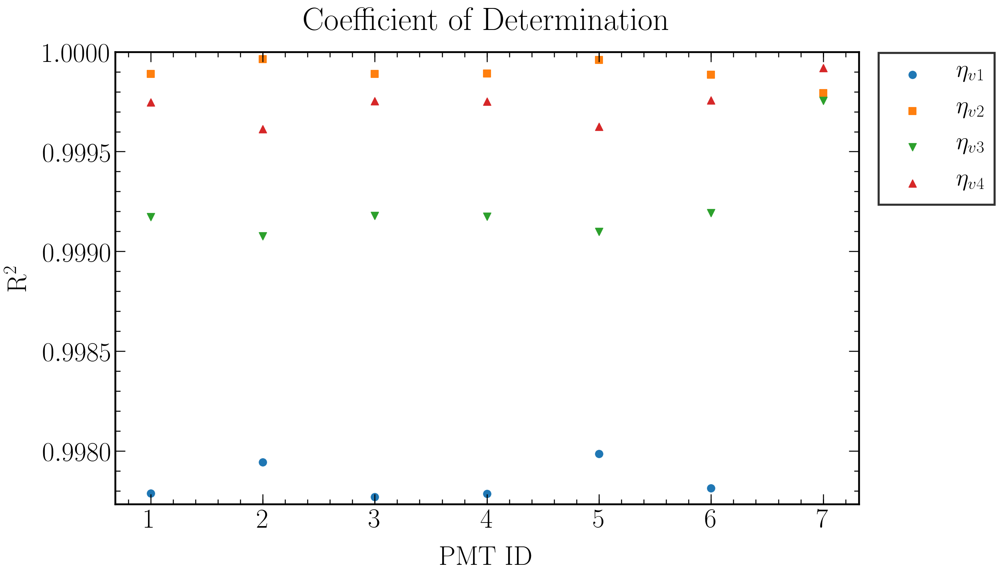

In [55]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), r_squared_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), r_squared_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), r_squared_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), r_squared_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)

plt.ylim(min(r_squared_eta_v1_list[:-1])-(1-max(r_squared_eta_v2_list[:-1])), 1)

plt.ylabel('$\mathrm{R}^2$', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title('Coefficient of Determination', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Coefficient_of_determination.png", bbox_inches = "tight")
plt.show()

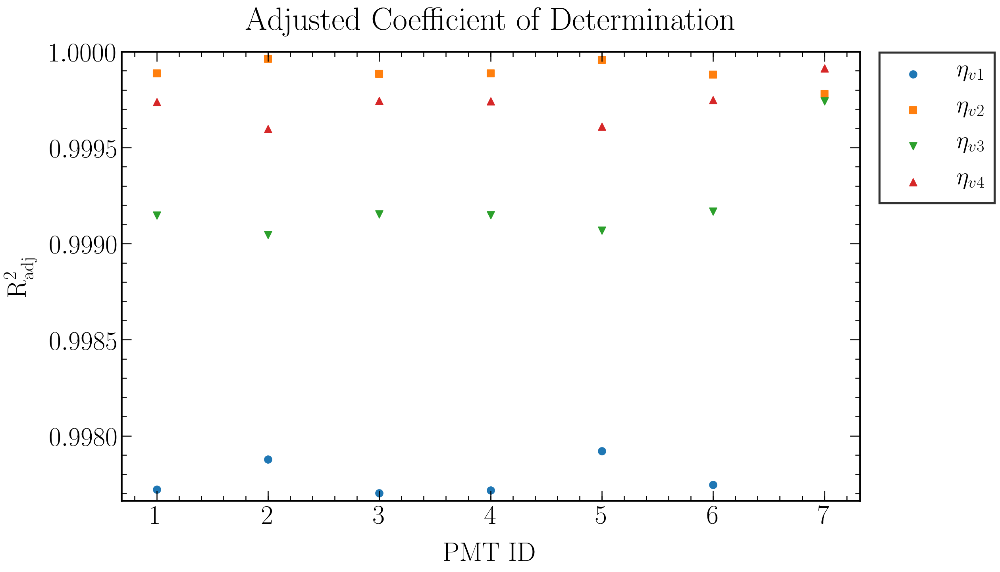

In [56]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), r_squared_adj_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), r_squared_adj_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), r_squared_adj_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), r_squared_adj_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)

plt.ylim(min(r_squared_adj_eta_v1_list[:-1])-(1-max(r_squared_adj_eta_v2_list[:-1])), 1)

plt.ylabel('$\mathrm{R}_{\mathrm{adj}}^2$', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title('Adjusted Coefficient of Determination', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Coefficient_of_determination_Adjusted.png", bbox_inches = "tight")
plt.show()

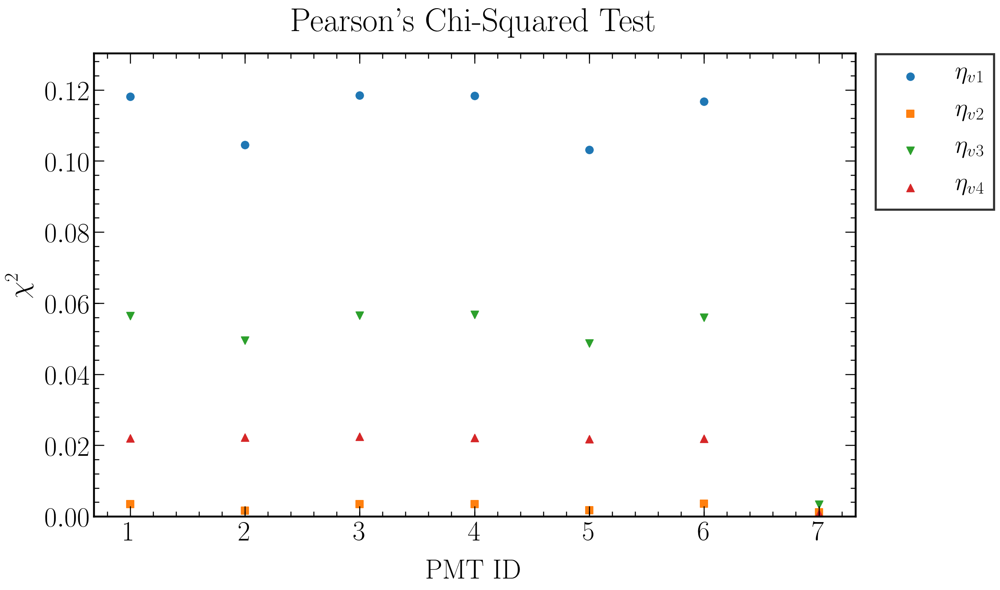

In [57]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#axes.yaxis.get_major_ticks()[0].label1.set_visible(False)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), chi_squared_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), chi_squared_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), chi_squared_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), chi_squared_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)

plt.ylim(0, 1.1*max(chi_squared_eta_v1_list[:-1]))

plt.ylabel('$\chi^{2}$', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title("Pearson's Chi-Squared Test", fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Pearsons_chi-squared_test.png", bbox_inches = "tight")
plt.show()

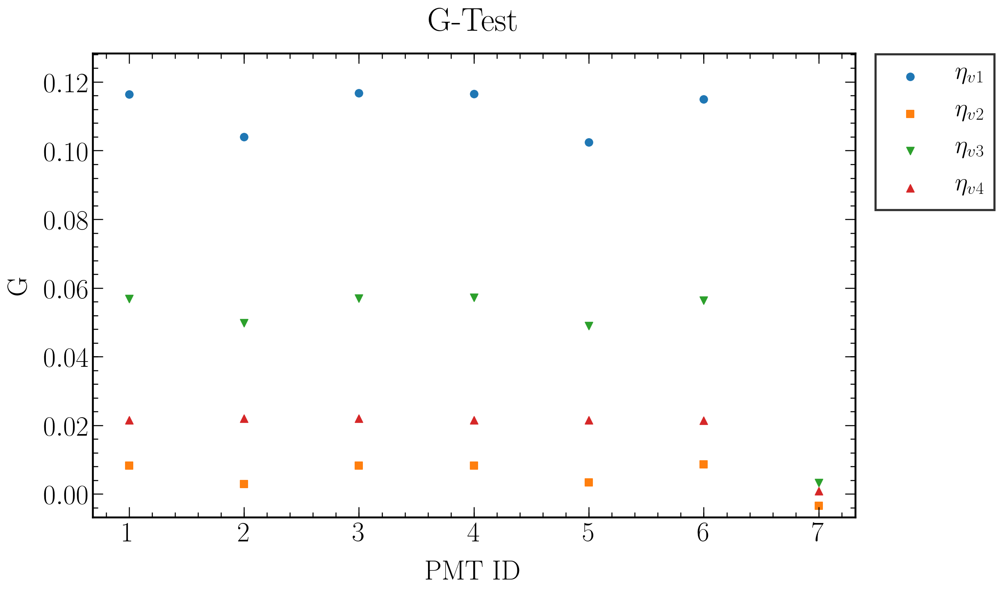

In [58]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#axes.yaxis.get_major_ticks()[0].label1.set_visible(False)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), g_test_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), g_test_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), g_test_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), g_test_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)
'''plt.bar(np.arange(1,8), g_test_eta_v1_list, label = '$\eta_{v1}$')
plt.bar(np.arange(1,8), g_test_eta_v2_list, label = '$\eta_{v2}$')
plt.bar(np.arange(1,8), g_test_eta_v3_list, label = '$\eta_{v3}$')
plt.bar(np.arange(1,8), g_test_eta_v4_list, label = '$\eta_{v4}$')'''

plt.ylim(2*min(g_test_eta_v2_list), 1.1*max(g_test_eta_v1_list[:-1]))

plt.ylabel('G', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title("G-Test", fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_G_test.png", bbox_inches = "tight")
plt.show()

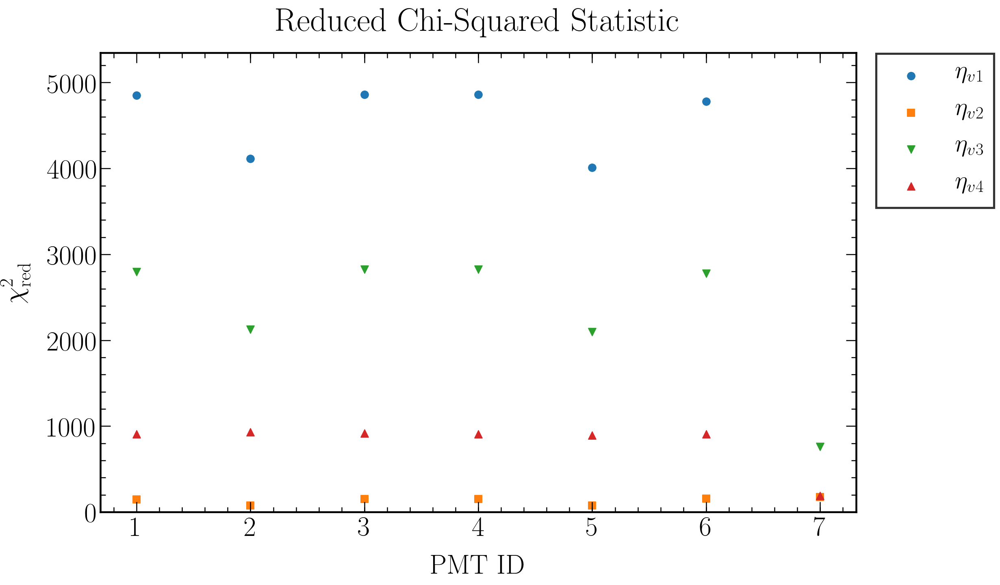

In [59]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#axes.yaxis.get_major_ticks()[0].label1.set_visible(False)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), red_chi_squared_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)

plt.ylim(0, 1.1*max(red_chi_squared_eta_v1_list[:-1]))

plt.ylabel('$\chi^{2}_{\mathrm{red}}$', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title("Reduced Chi-Squared Statistic", fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Reduced_chi-squared_statistic.png", bbox_inches = "tight")
plt.show()

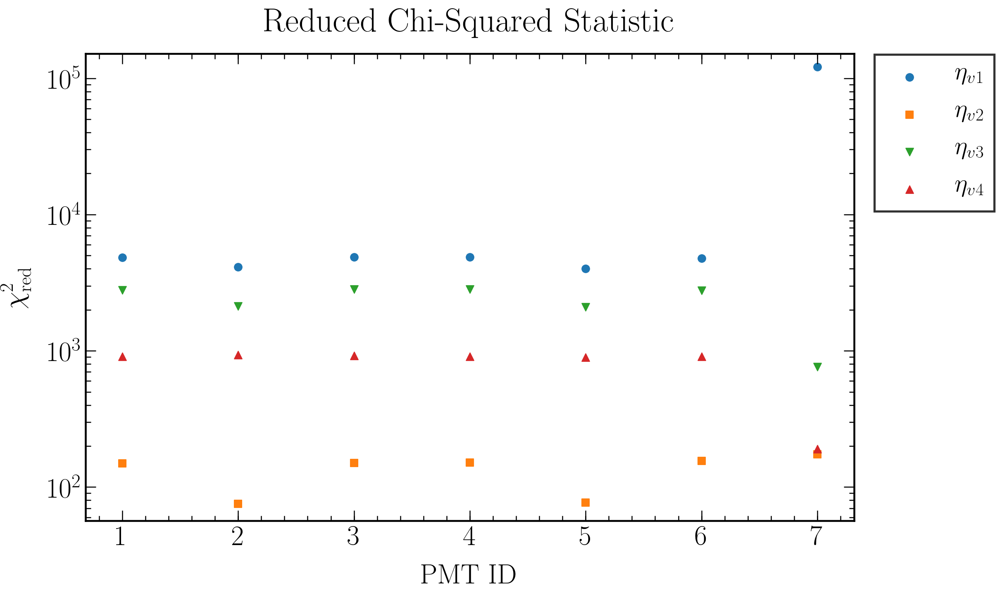

In [60]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#axes.yaxis.get_major_ticks()[0].label1.set_visible(False)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(np.arange(1,8), red_chi_squared_eta_v1_list, 
            label = '$\eta_{v1}$', marker = 'o', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v2_list, 
            label = '$\eta_{v2}$', marker = 's', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v3_list, 
            label = '$\eta_{v3}$', marker = 'v', s = 80)
plt.scatter(np.arange(1,8), red_chi_squared_eta_v4_list, 
            label = '$\eta_{v4}$', marker = '^', s = 80)

#plt.ylim(0, 1.1*max(red_chi_squared_eta_v1_list[:-1]))
plt.ylim(bottom = 0.75*np.amin(red_chi_squared_eta_v2_list))
plt.ylim(top = 1.25*np.amax(red_chi_squared_eta_v1_list))
plt.yscale('log')

plt.ylabel('$\chi^{2}_{\mathrm{red}}$', fontsize = label_size, labelpad = label_pad)
plt.xlabel('PMT ID', fontsize = label_size, labelpad = label_pad)
plt.title("Reduced Chi-Squared Statistic", fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Reduced_chi-squared_statistic_log.png", bbox_inches = "tight")
plt.show()

In [61]:
# Fits to optPhot_S2_3e7HF_R_hist

'''
fit_parameters_eta_v1 = np.array([None]*7)
fit_parameters_eta_v1[1-1] = np.array([ 1.10377187, -0.0460542 ,  0.00464143, -0.2966093 ])
fit_parameters_eta_v1[2-1] = np.array([ 1.20315191, -0.04475881,  0.00597389, -0.36907416])
fit_parameters_eta_v1[3-1] = np.array([ 1.10678085,  0.04590501,  0.00467322, -0.29908366])
fit_parameters_eta_v1[4-1] = np.array([ 1.09835901,  0.04615678,  0.00455232, -0.29139586])
fit_parameters_eta_v1[5-1] = np.array([ 1.20291803, -0.04481004,  0.00594797, -0.36757778])
fit_parameters_eta_v1[6-1] = np.array([ 1.09727781, -0.04648625,  0.00446665, -0.28559688])
fit_parameters_eta_v1[7-1] = np.array([-0.04668917,  1.15148658, -0.02417197,  0.76087121]) # A<0 unphysical

fit_parameters_eta_v2 = np.array([None]*7)
fit_parameters_eta_v2[1-1] = np.array([ 0.76071124, 24.51920777,  0.04781411,  3.91039384,  3.33590724])
fit_parameters_eta_v2[2-1] = np.array([ 7.90330372e-01,  2.43696354e+01, -6.14346548e-03,  3.88180849e+00,  3.37589626e+00])
fit_parameters_eta_v2[3-1] = np.array([ 0.7585608 , 11.96660385,  1.36661462, -0.70839809,  4.29652843])
fit_parameters_eta_v2[4-1] = np.array([ 7.61422782e-01, 2.48999723e+01, 1.36940894e-02, 4.02672057e+00, 3.27551942e+00])
fit_parameters_eta_v2[5-1] = np.array([ 0.79084969, 24.15763481,  0.03622108,  3.78674729,  3.40122954])
fit_parameters_eta_v2[6-1] = np.array([ 0.76683103, 25.61206058, -0.12662088,  4.3604931 ,  3.18587848])
fit_parameters_eta_v2[7-1] = np.array([ 0.70283237, 11.14511295,  1.21901842, -0.64460577,  4.06701116])

fit_parameters_eta_v3 = np.array([None]*7)
fit_parameters_eta_v3[1-1] = np.array([14.86884767,  4.23850994,  0.78550059,  0.02321258])
fit_parameters_eta_v3[2-1] = np.array([14.97585311,  4.17971612,  0.8098008 ,  0.02727296])
fit_parameters_eta_v3[3-1] = np.array([14.89115241,  4.27682224,  0.78775419,  0.02291284])
fit_parameters_eta_v3[4-1] = np.array([14.82309717,  4.30549047,  0.7886976 ,  0.0227965 ])
fit_parameters_eta_v3[5-1] = np.array([14.96982672,  4.17573843,  0.81084532,  0.02729785])
fit_parameters_eta_v3[6-1] = np.array([14.72090045,  4.36471849,  0.79680284,  0.02249345])
fit_parameters_eta_v3[7-1] = np.array([14.34069052,  3.78135907,  0.67628825,  0.05828686])

fit_parameters_eta_v4 = np.array([None]*7)
fit_parameters_eta_v4[1-1] = np.array([ 1.47923840e+01,  3.84494141e+00,  7.31431002e-01,  6.49149185e-02,  -8.47742000e-04])
fit_parameters_eta_v4[2-1] = np.array([ 1.48879499e+01,  3.79219972e+00,  7.52197533e-01,  7.30906120e-02, -9.67850594e-04])
fit_parameters_eta_v4[3-1] = np.array([ 1.48217750e+01,  3.89801575e+00,  7.35693357e-01,  6.28819969e-02, -8.10874585e-04])
fit_parameters_eta_v4[4-1] = np.array([ 1.47531424e+01,  3.90894760e+00,  7.34415454e-01,  6.42430411e-02, -8.40522373e-04])
fit_parameters_eta_v4[5-1] = np.array([ 1.48814219e+01,  3.77753724e+00,  7.51784280e-01,  7.42013064e-02, -9.90907188e-04])
fit_parameters_eta_v4[6-1] = np.array([ 1.46651086e+01,  3.98415557e+00,  7.44454390e-01,  6.18625060e-02, -7.97090338e-04])
fit_parameters_eta_v4[7-1] = np.array([1.43708386e+01, 3.98460637e+00, 7.26031501e-01, 1.23895054e-02, 1.39780744e-03])
''';

# Fits to optPhot_S2_3e7_pmtGap4.5_R_hist
'''
fit_parameters_eta_v1 = np.array([([ 0.76290105,  0.04344929,  0.00248232, -0.15434863]), ([ 0.86272291, -0.04255819,  0.00338426, -0.20391268]), ([ 0.76984138, -0.04286636,  0.00266551, -0.16613209]), ([ 0.76353724,  0.04318917,  0.00252671, -0.1577167 ]), ([ 0.86495158,  0.0421119 ,  0.00346901, -0.21034172]), ([ 0.76758982,  0.04284109,  0.00261129, -0.16327785]), ([-0.01817689,  0.99755564, -0.01552208,  0.56448168])])
fit_parameters_eta_v2 = np.array([([ 0.59339294, 31.71313298, -0.62812991,  4.75377235,  2.49069989]), ([ 0.64436173, 31.02458692, -0.66016939,  4.64814136,  2.53282185]), ([ 0.58691683, 29.78205518, -0.31920734,  4.13121462,  2.61059341]), ([ 0.59028187, 31.24143425, -0.52290662,  4.56655217,  2.52187459]),  ([ 0.63833798, 29.2593943 , -0.29746941,  3.98329621,  2.64042527]), ([ 0.58764027, 30.34811075, -0.38433703,  4.27325159,  2.58477671]), ([  0.53312936,  39.69216298, -18.0121644 ,  20.66779081, 2.24383675])])
fit_parameters_eta_v3 = np.array([([14.66183729,  6.16854687,  0.64160589,  0.03097435]), ([14.84959974,  5.98585513,  0.68430229,  0.03767824]), ([14.97937218,  5.98632032,  0.62622703,  0.03184648]), ([14.79570054,  6.12402734,  0.6355573 ,  0.03096437]), ([15.06510861,  5.9105561 ,  0.67449495,  0.03796868]), ([14.96563288,  6.05084183,  0.62925845,  0.03153747]), ([14.40498132,  4.64526841,  0.46540264,  0.09878945])])
fit_parameters_eta_v4 = np.array([([ 1.47657045e+01,  5.42829852e+00,  5.73672677e-01,  7.43719742e-02, -8.12911106e-04]), ([ 1.48885273e+01,  5.28408173e+00,  6.11313795e-01,  8.71547117e-02, -9.65597243e-04]), ([ 1.50318517e+01,  5.21692218e+00,  5.56453138e-01,  7.82558842e-02, -8.74692271e-04]), ([ 1.48821319e+01,  5.36831470e+00,  5.66523353e-01,  7.57500945e-02, -8.40329027e-04]), ([ 1.50827985e+01,  5.12932179e+00,  5.94413264e-01,  9.33397167e-02, -1.08356440e-03]), ([ 1.50385097e+01,  5.26912655e+00,  5.58415764e-01,  7.81576958e-02, -8.76464236e-04]), ([ 1.45093652e+01,  5.63220570e+00,  6.42920998e-01, -5.36407561e-02, 4.25960663e-03])])
''';

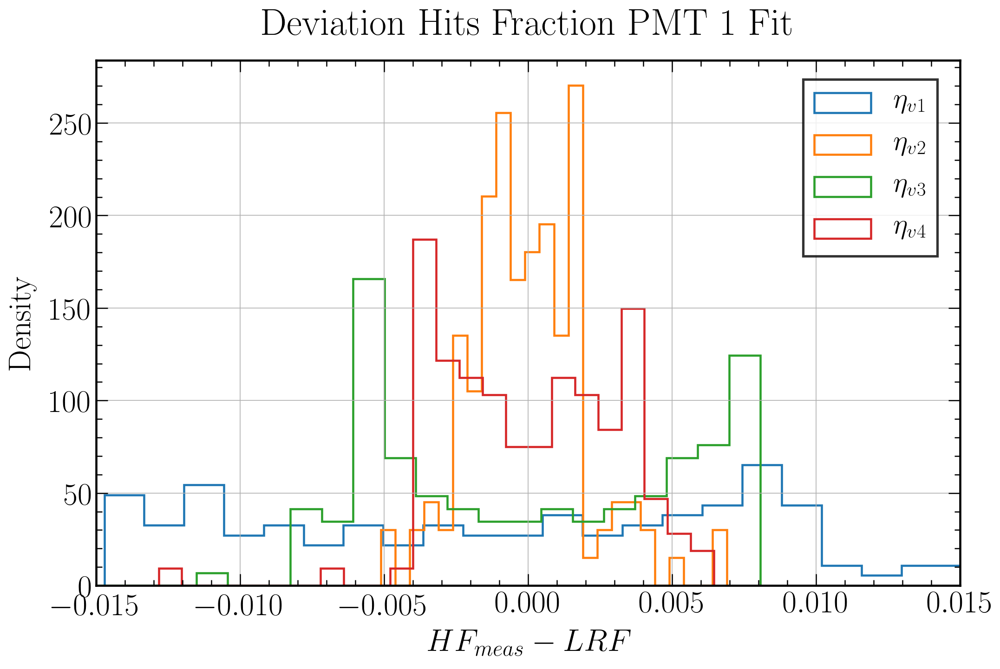

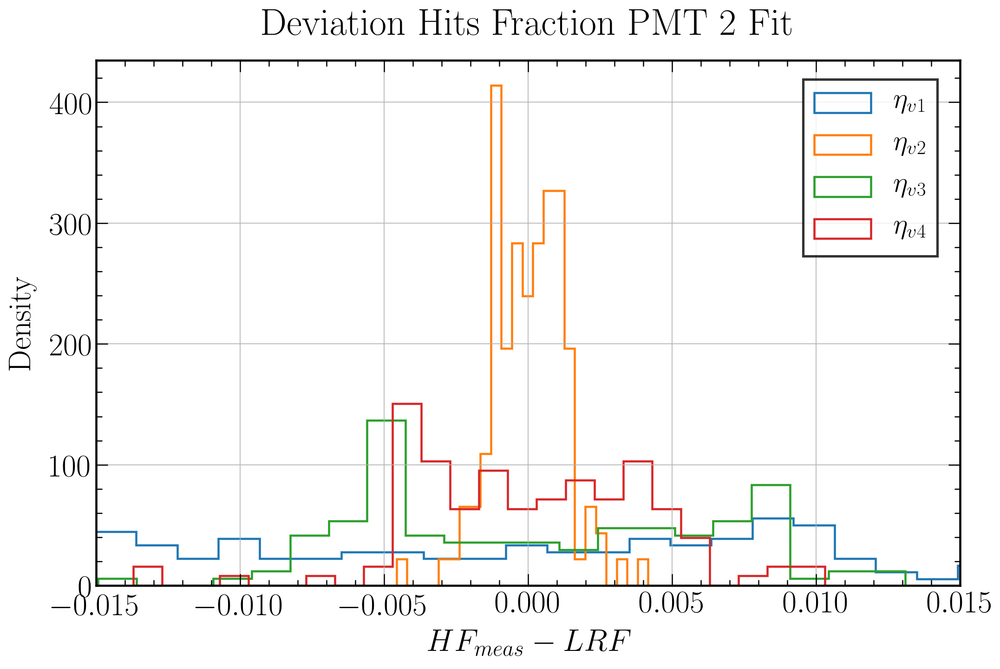

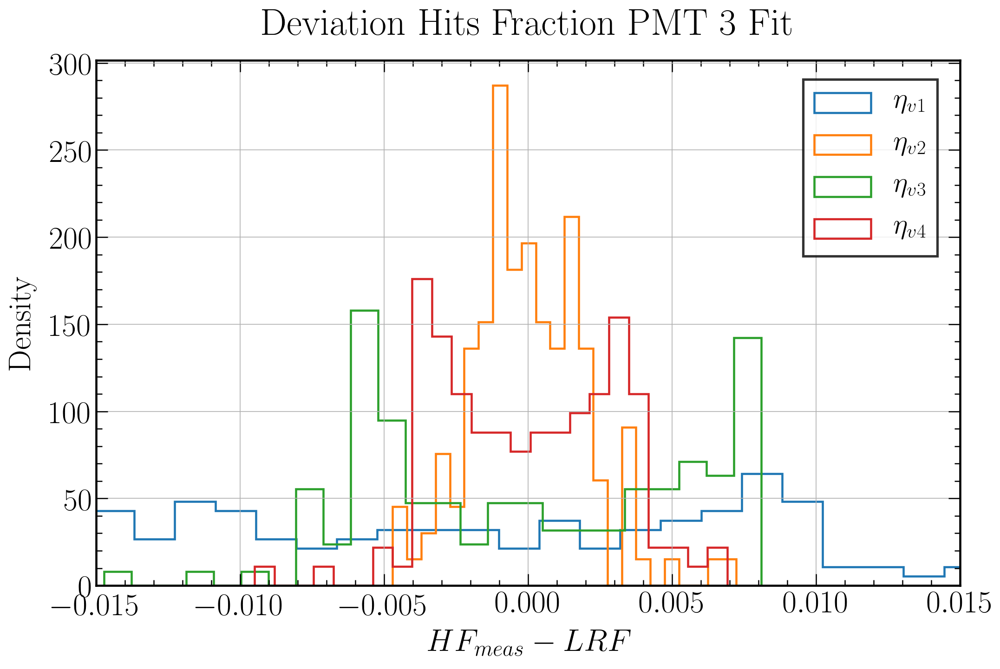

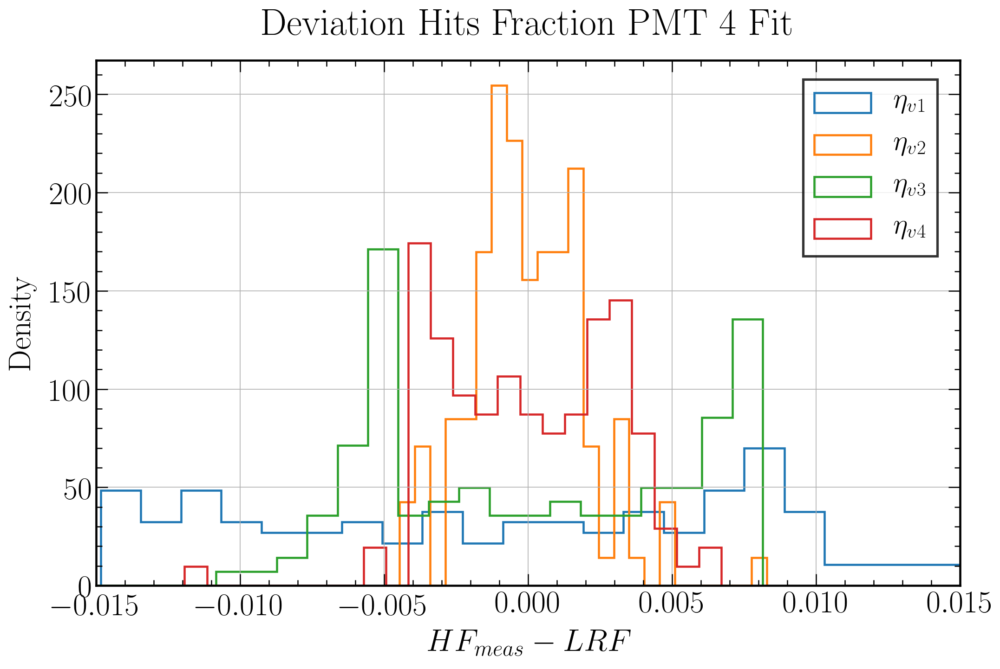

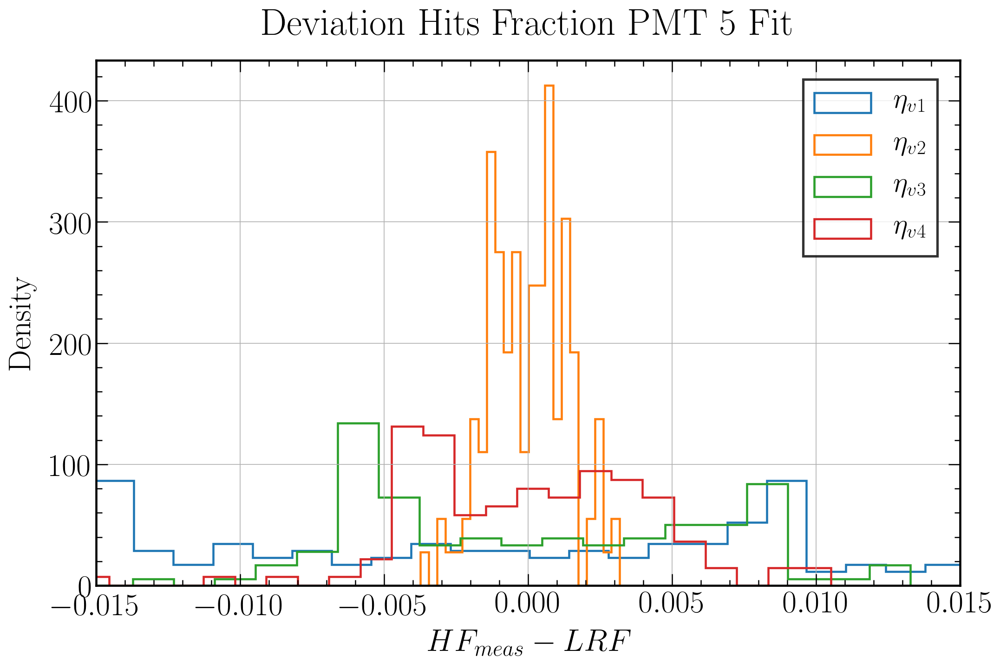

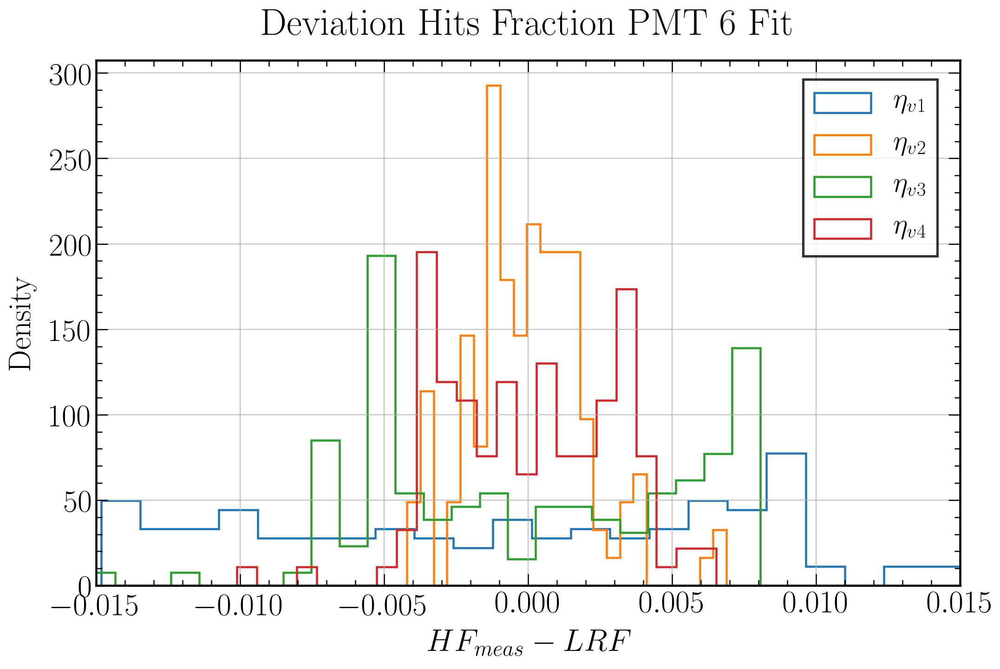

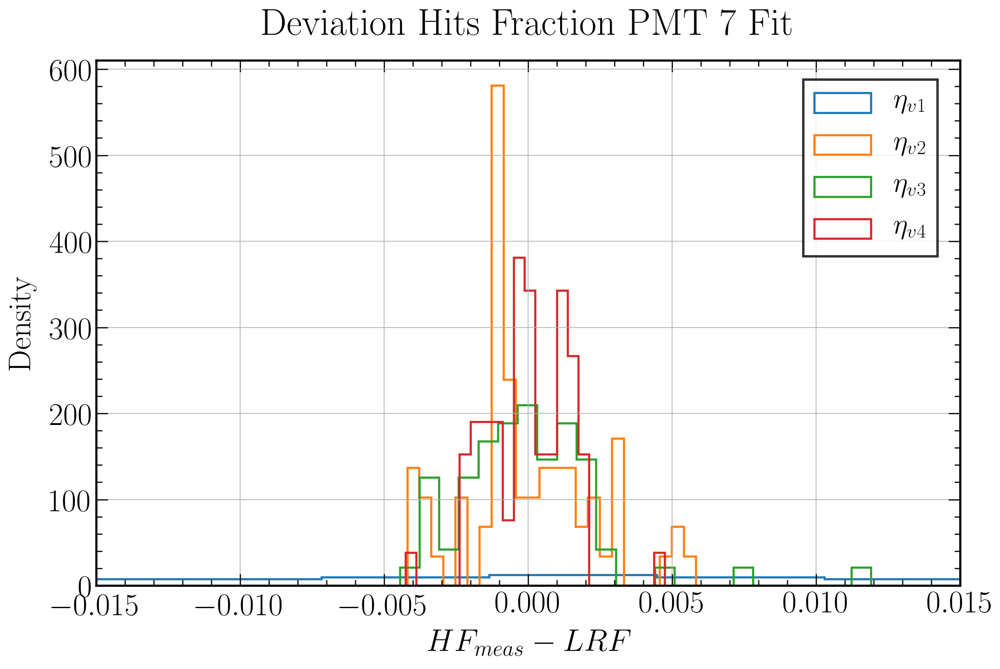

In [62]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    numberbins = 24
    data = HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v1}$', density=True, color = 'C0')
    data = HF_R_hist['n'][i] - eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v2}$', density=True, color = 'C1')
    data = HF_R_hist['n'][i] - eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v3}$', density=True, color = 'C2')
    data = HF_R_hist['n'][i] - eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v4}$', density=True, color = 'C3')

    plt.xlim(-0.015, 0.015)
    
    plt.xlabel('$HF_{meas} - LRF$', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
    plt.title('Deviation Hits Fraction PMT '+str(i)+' Fit', fontsize = title_size, pad = title_pad)

    plt.grid()

    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+"_DeviationHist.png")

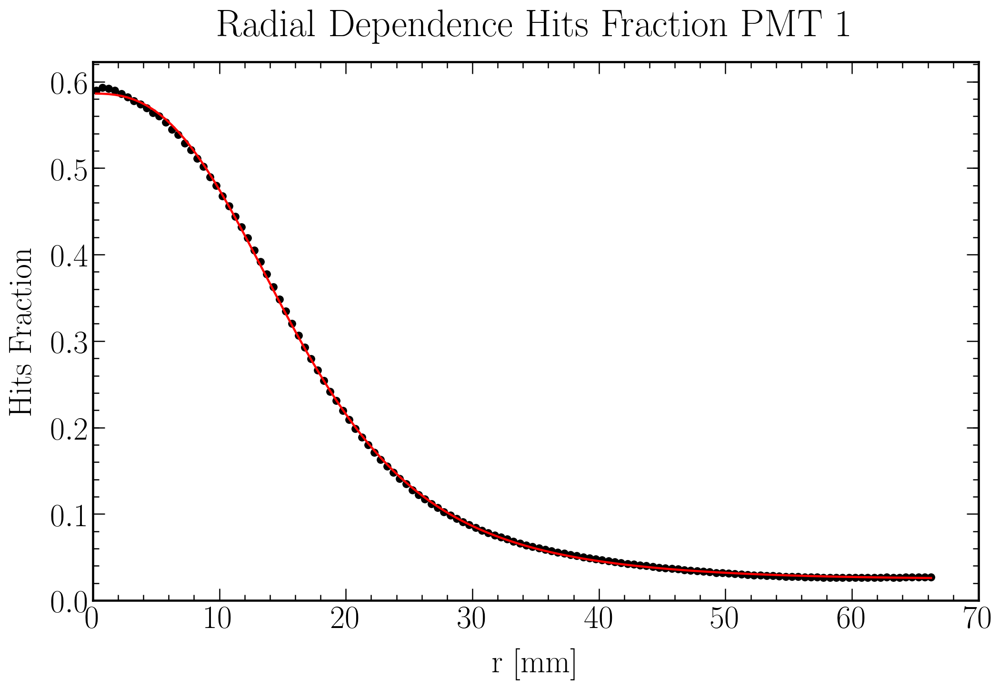

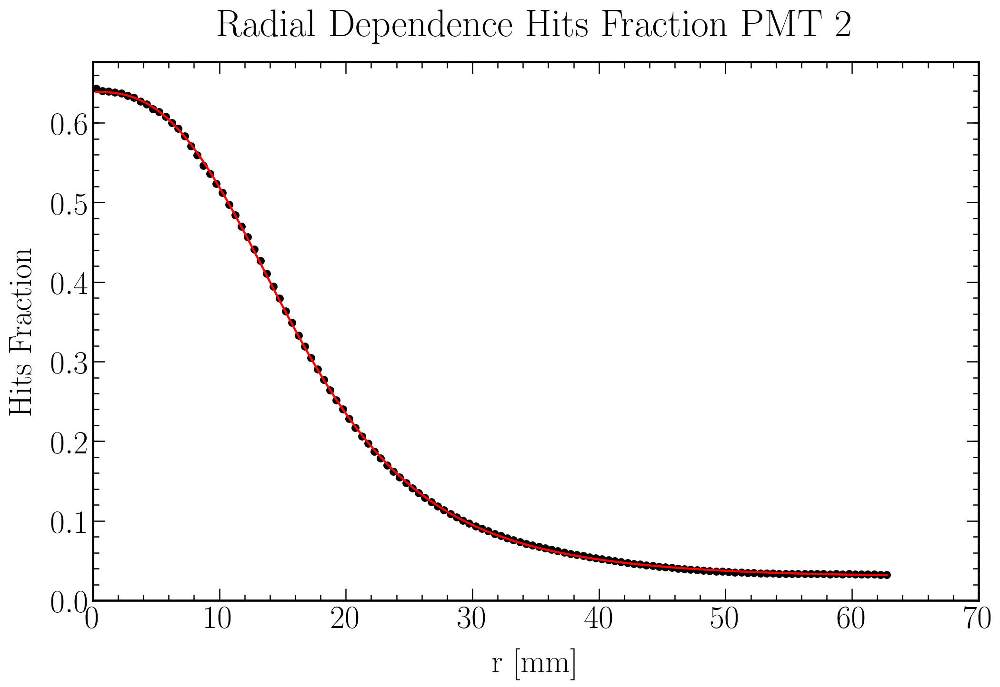

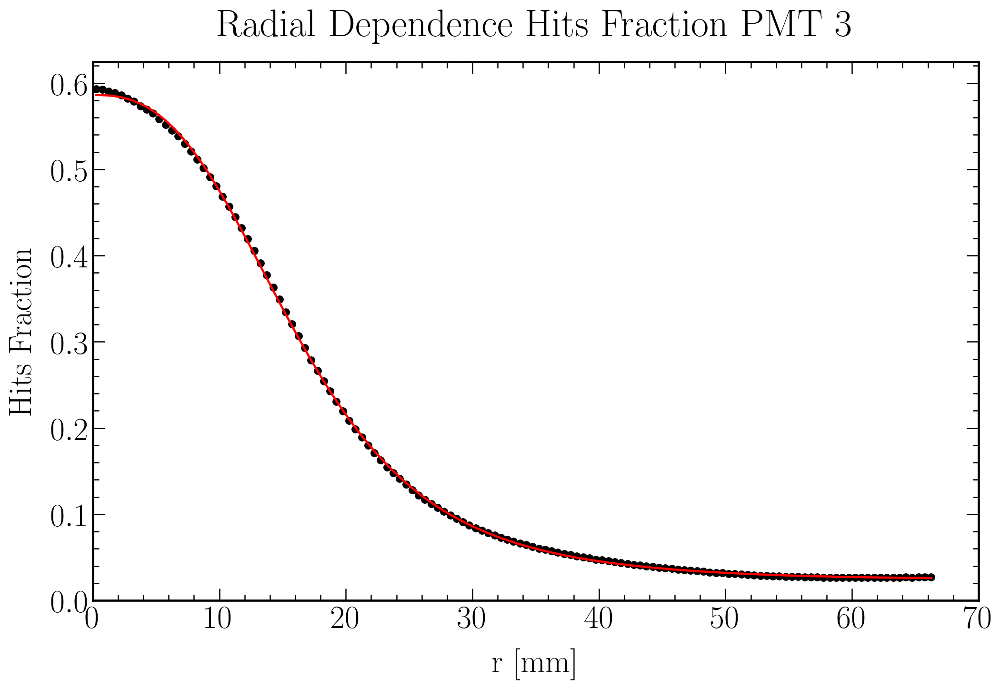

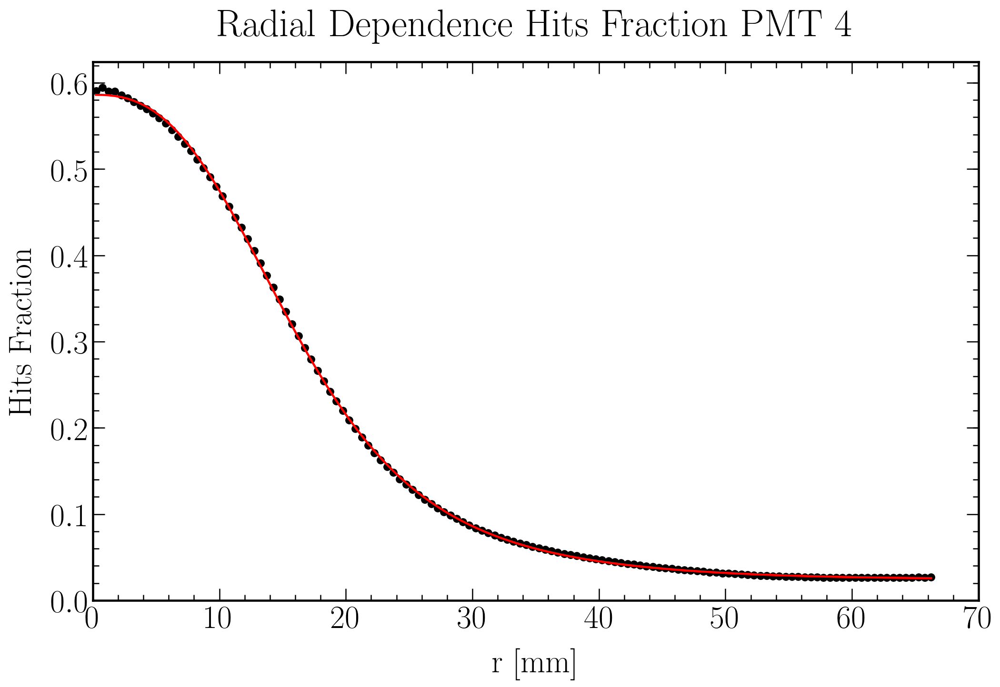

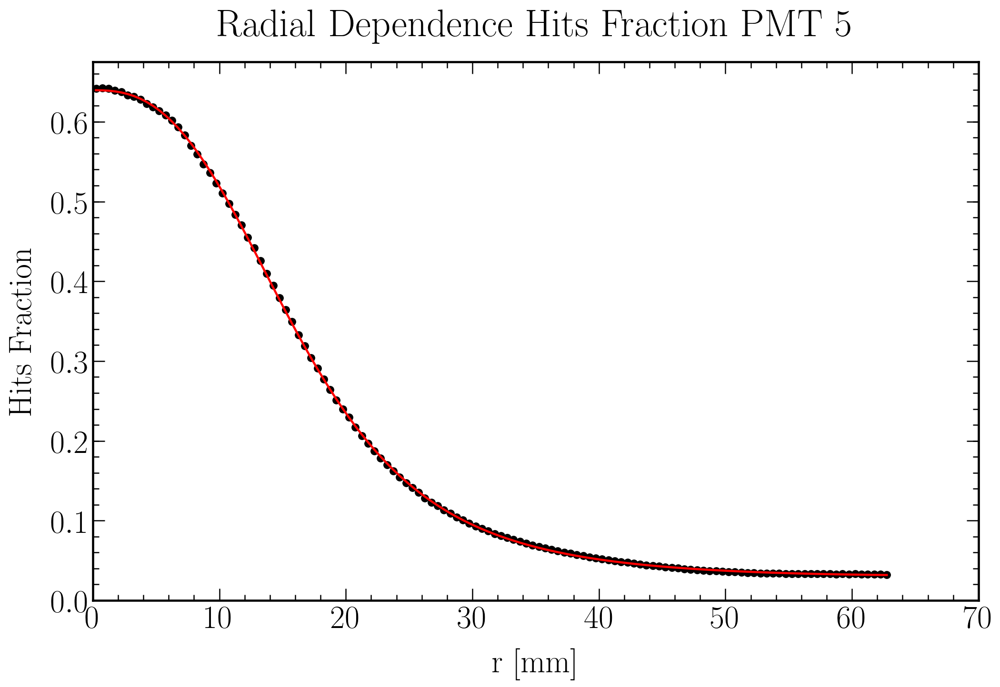

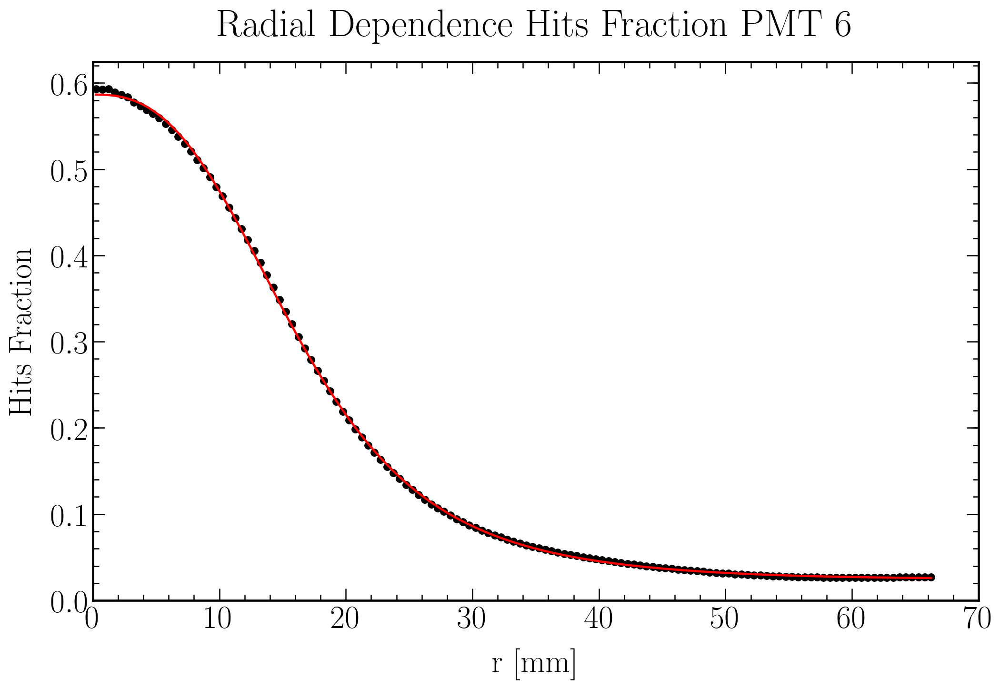

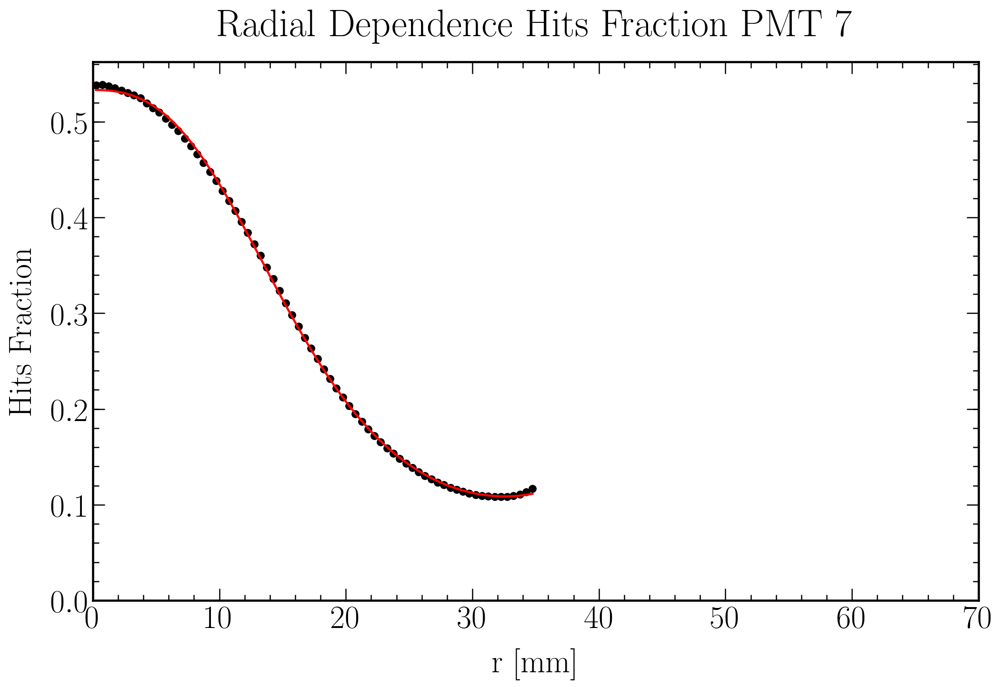

In [63]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    #plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
    plt.plot(HF_R_hist['bins_center'][i], model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'r', linewidth = 2.2)

    plt.ylim(bottom=0)
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+".png")

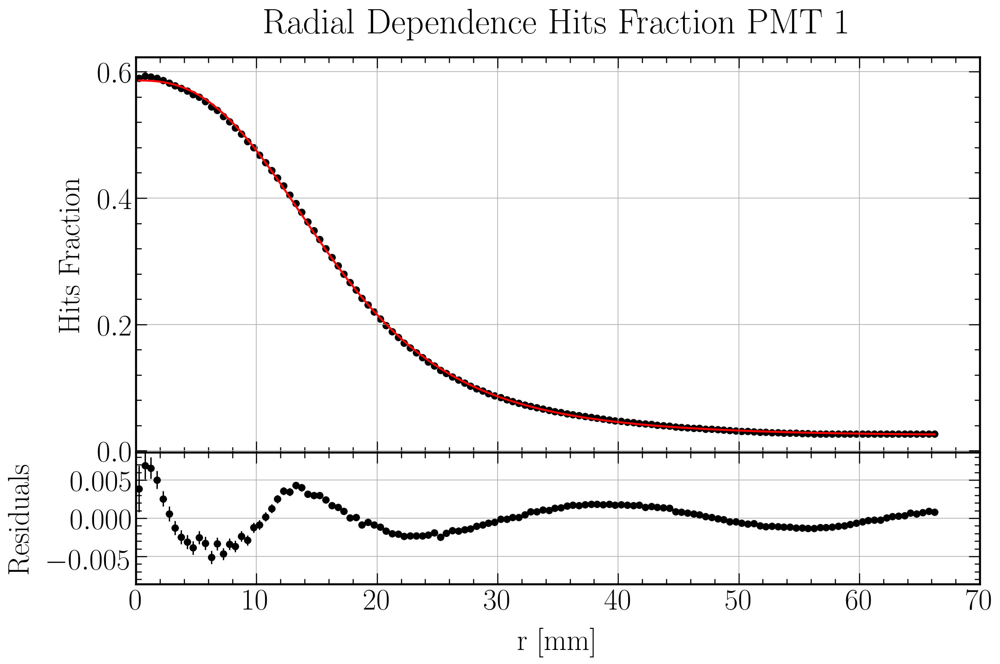

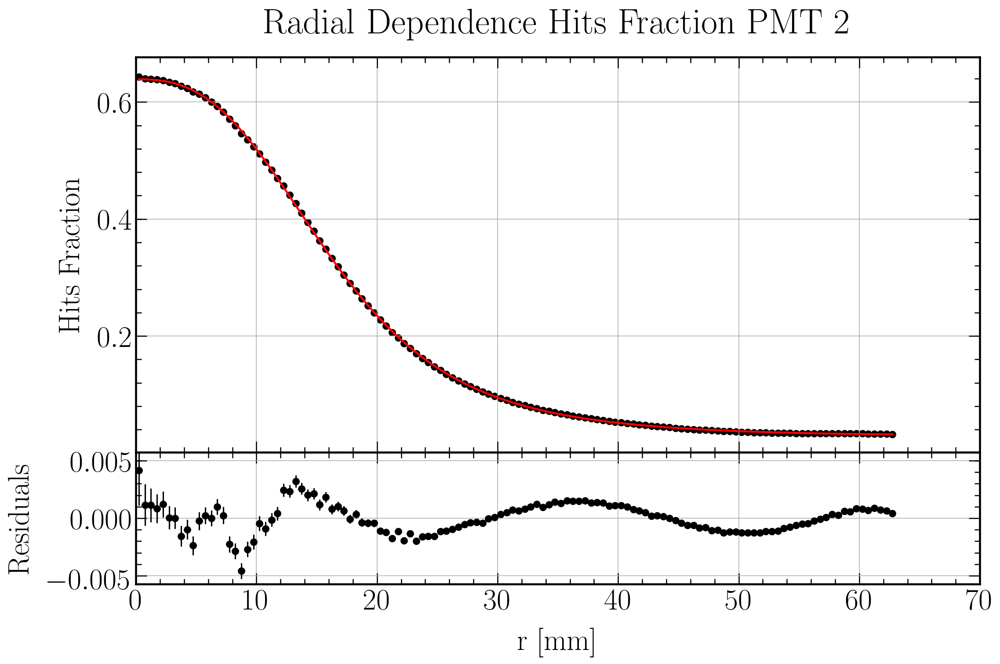

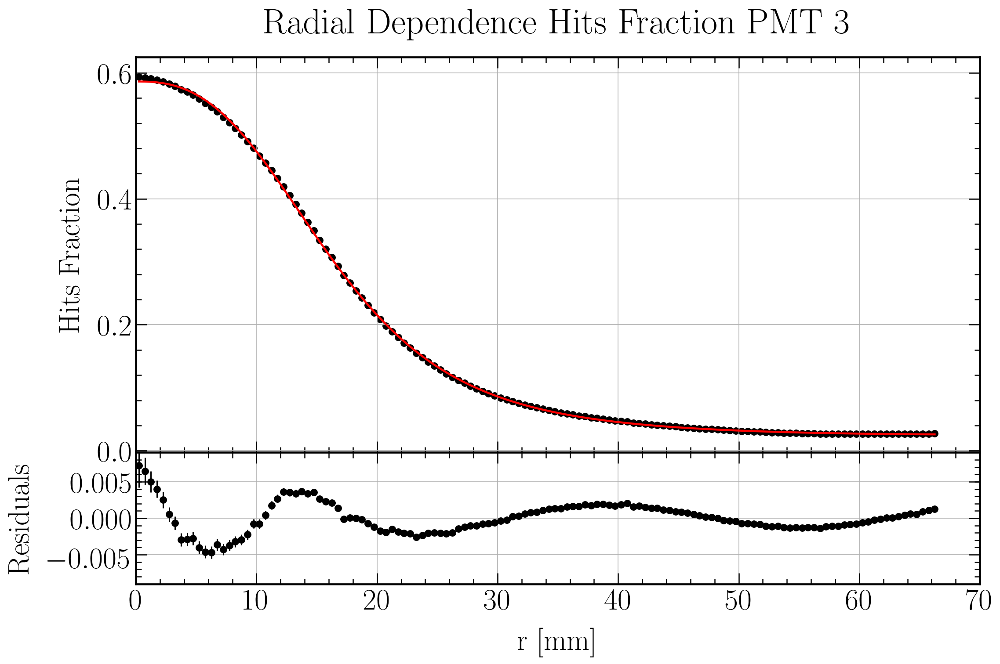

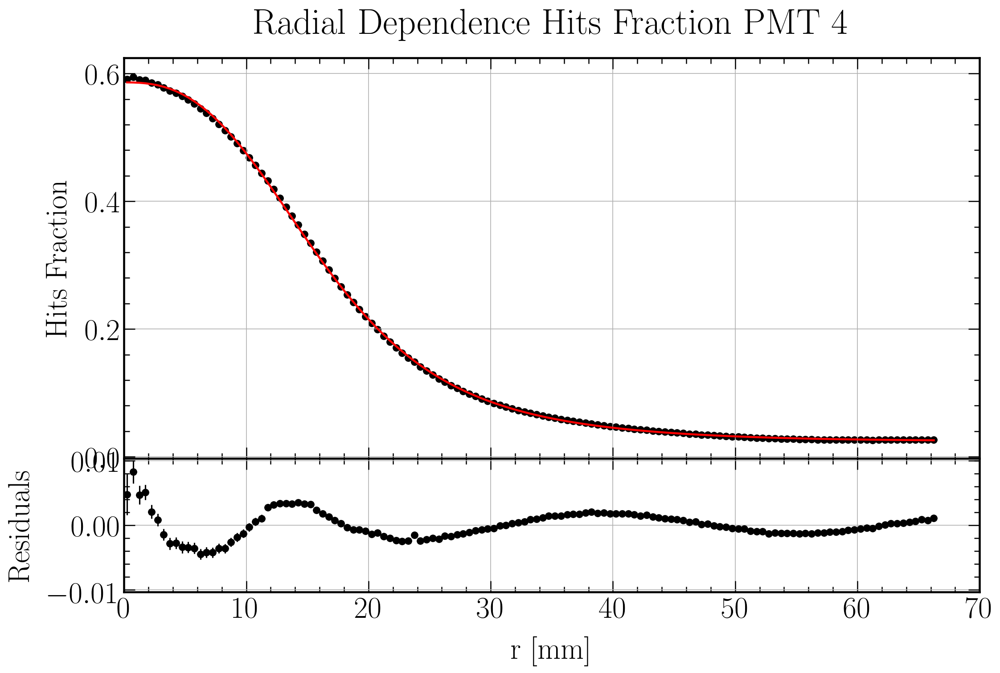

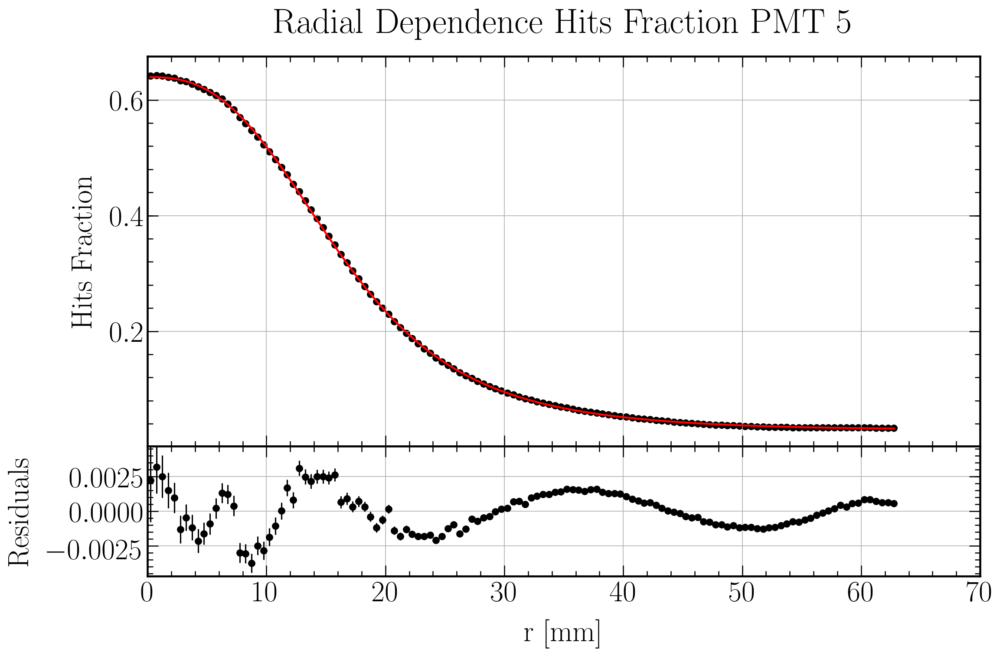

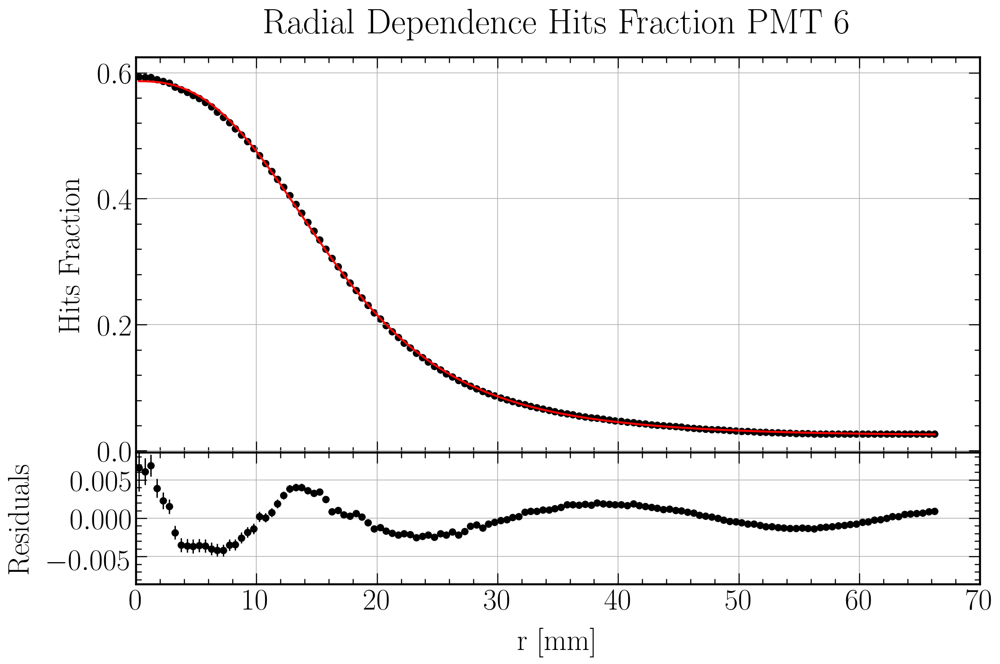

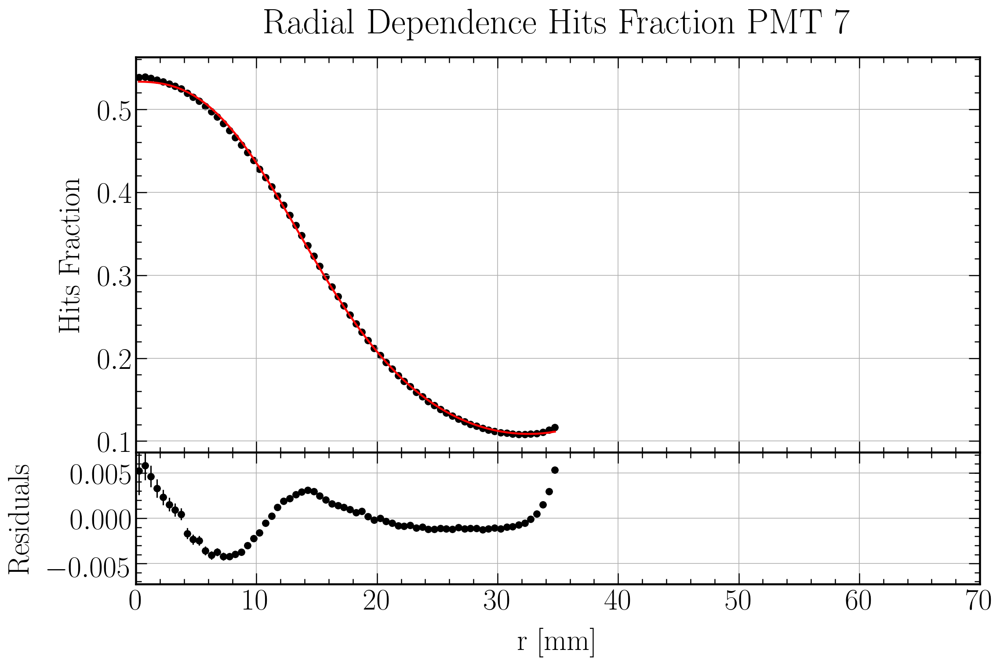

In [64]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)
    frame1=fig.add_axes((.1,.3,.8,.6))

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    #plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
    plt.plot(HF_R_hist['bins_center'][i], model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'r', linewidth = 2.2)

    plt.xlim(0.,70.)
    frame1.set_xticklabels([])
    
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.grid()
    #############################################
    frame2=fig.add_axes((.1,.1,.8,.2)) 
    
    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  
    
    #plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'k', s = 50)
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'k', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o')
    plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)
       
    plt.ylim(-1.25 * max(abs(HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]))), 1.25 * max(abs(HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]))))
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

    plt.grid()
    
    plt.show()
    
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+"_Residuals.png", bbox_inches = "tight")

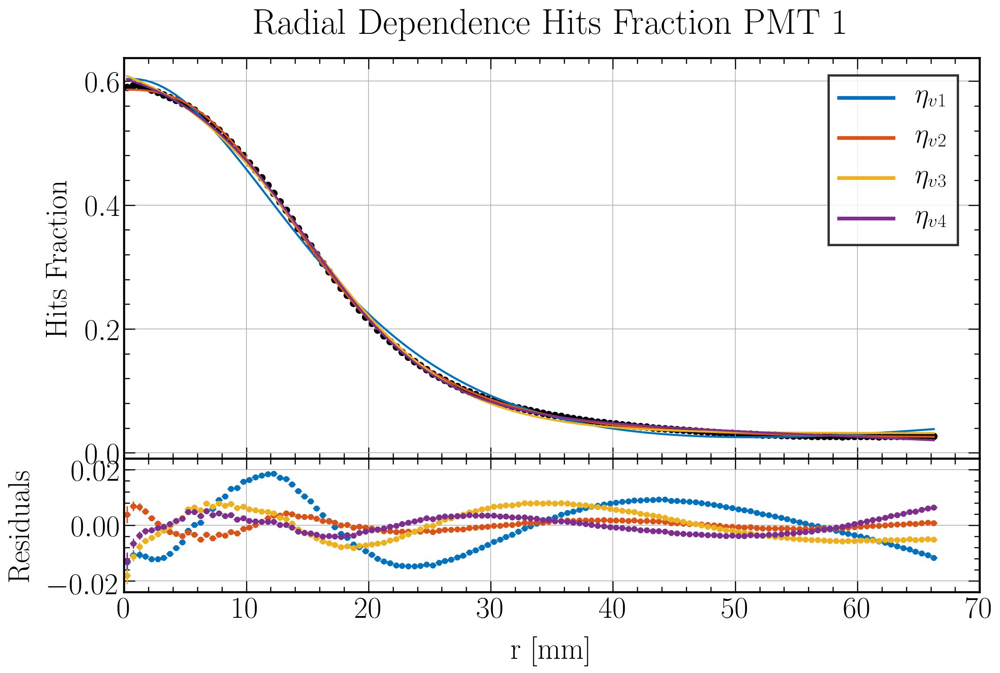

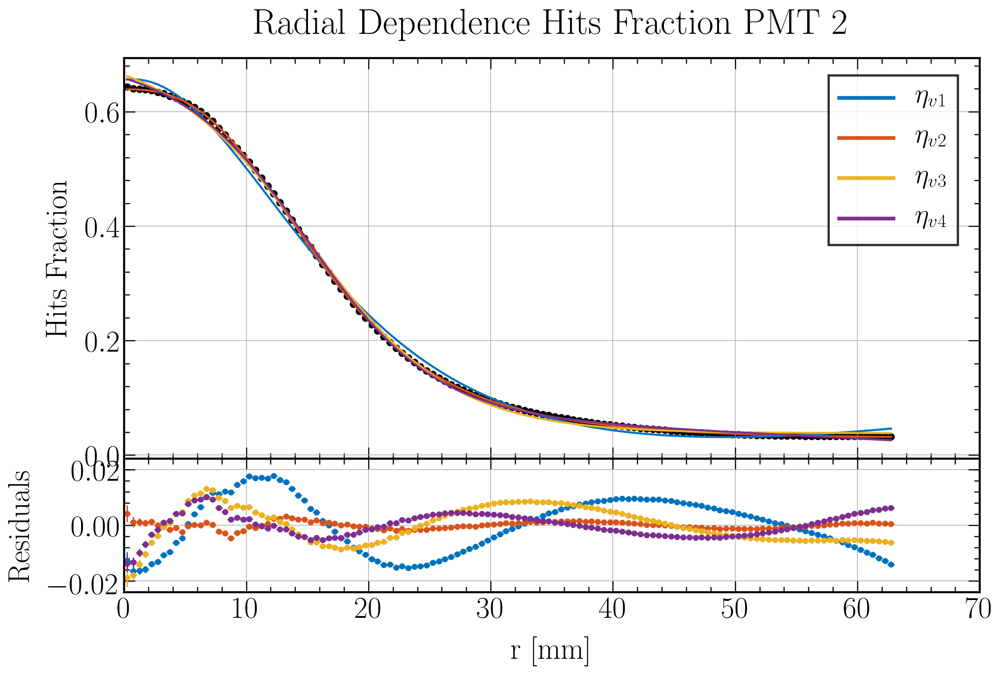

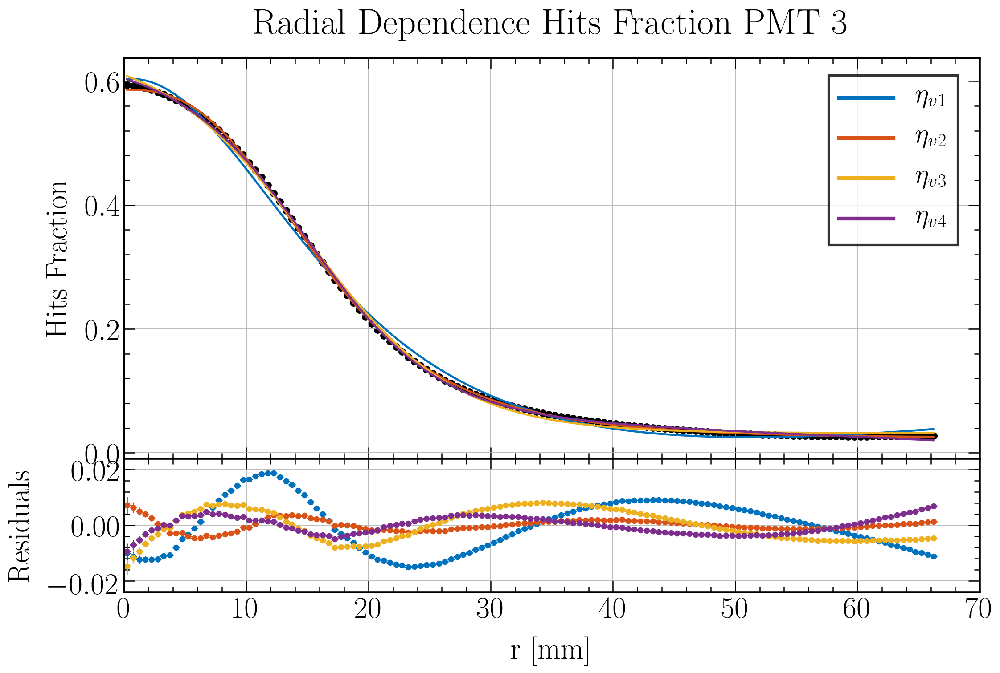

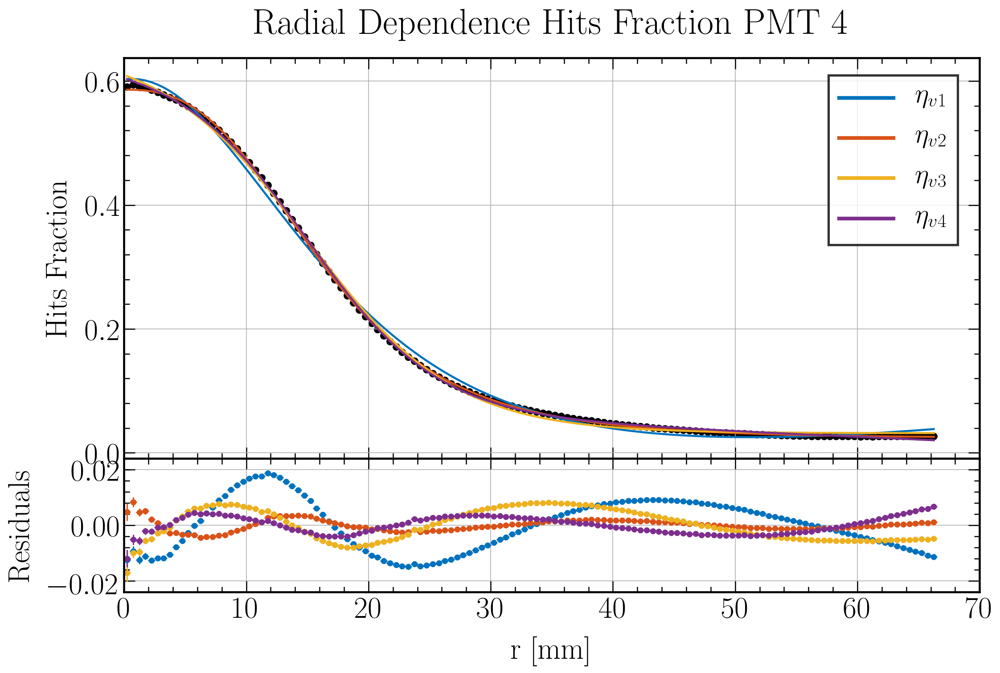

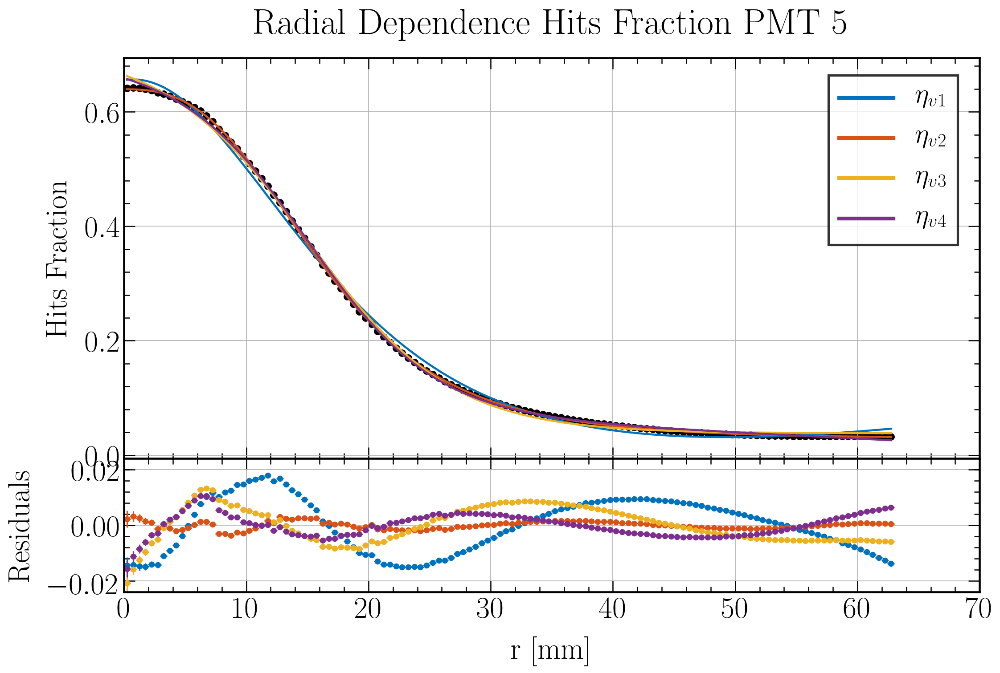

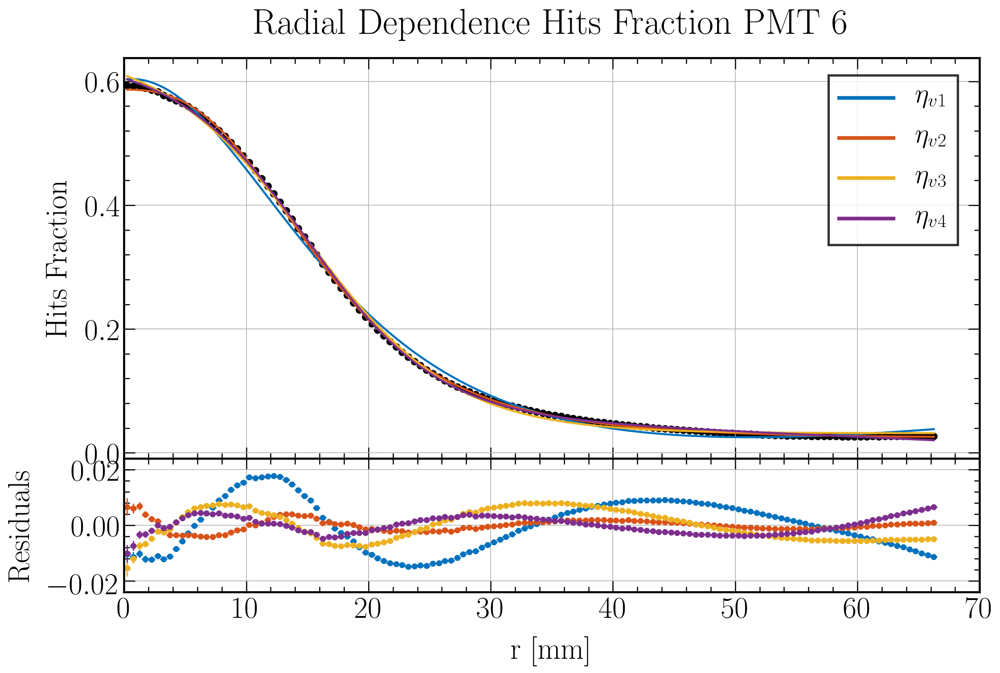

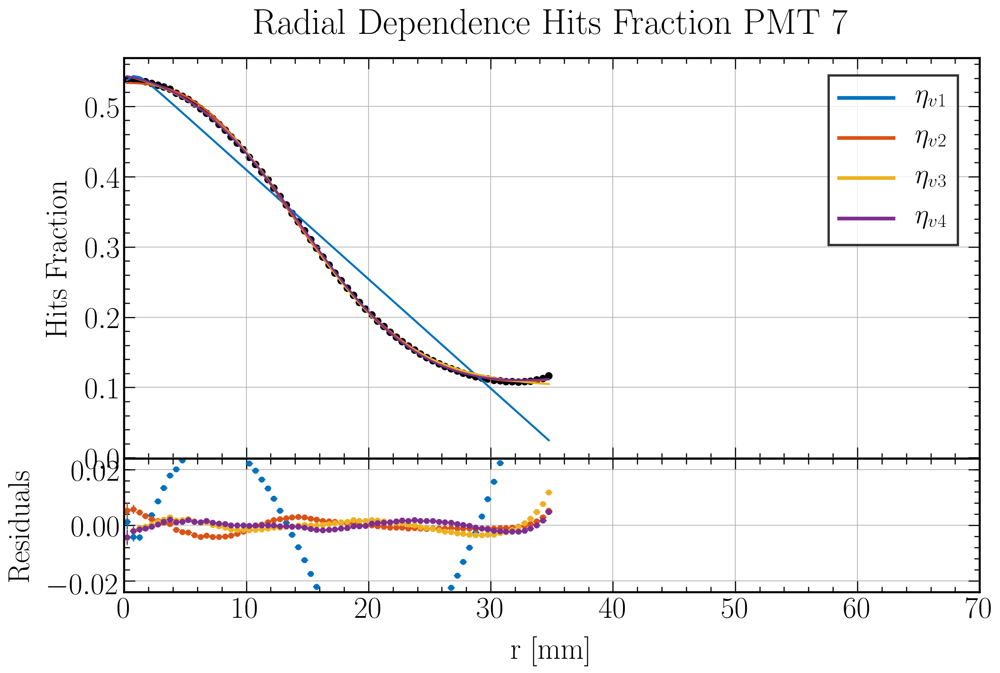

In [65]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)
    frame1=fig.add_axes((.1,.3,.8,.6))

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    #plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
    plt.plot(HF_R_hist['bins_center'][i], eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]), color = [0, 0.4470, 0.7410], linewidth = 2.2, label = '$\eta_{v1}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1]), color = [0.8500, 0.3250, 0.0980], linewidth = 2.2, label = '$\eta_{v2}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1]), color = [0.9290, 0.6940, 0.1250], linewidth = 2.2, label = '$\eta_{v3}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1]), color = [0.4940, 0.1840, 0.5560], linewidth = 2.2, label = '$\eta_{v4}$')

    plt.xlim(0.,70.)
    frame1.set_xticklabels([])
    
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.grid()
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)
    
    #############################################
    frame2=fig.add_axes((.1,.1,.8,.2)) 
    
    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  
    
    '''plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]), s = 30, color = [0, 0.4470, 0.7410], label = '$\eta_{v1}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1]), s = 30, color = [0.8500, 0.3250, 0.0980], label = '$\eta_{v2}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1]), s = 30, color = [0.9290, 0.6940, 0.1250], label = '$\eta_{v3}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1]), s = 30, color = [0.4940, 0.1840, 0.5560], label = '$\eta_{v4}$')'''
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]), ms = np.sqrt(30), color = [0, 0.4470, 0.7410], label = '$\eta_{v1}$', yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o')
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1]), ms = np.sqrt(30), color = [0.8500, 0.3250, 0.0980], label = '$\eta_{v2}$', yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o')
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1]), ms = np.sqrt(30), color = [0.9290, 0.6940, 0.1250], label = '$\eta_{v3}$', yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o')
    plt.errorbar(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1]), ms = np.sqrt(30), color = [0.4940, 0.1840, 0.5560], label = '$\eta_{v4}$', yerr=HF_R_hist['std_red'][i], xerr = (70/numberbins)/np.sqrt(12), fmt='o')
    plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)
       
    #plt.ylim(-1.25 * max(abs(HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]))), 1.25 * max(abs(HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]))))
    plt.ylim(-0.024,0.024)
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

    plt.grid()
    
    plt.show()
    
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fits_Residuals.png", bbox_inches = "tight")

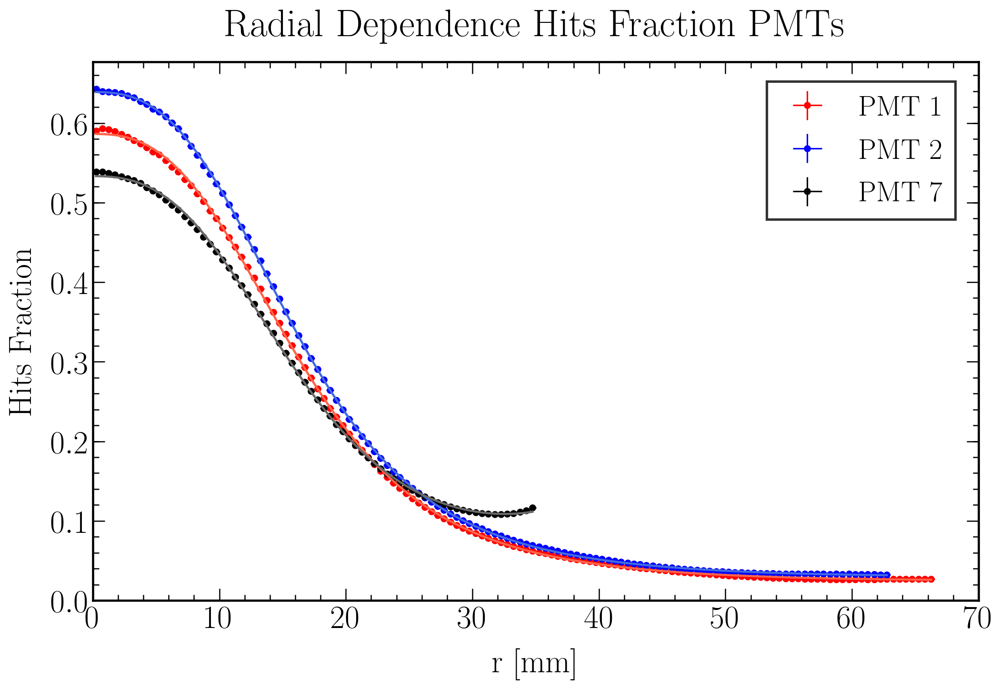

In [66]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
'''plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1")
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2")
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")'''
plt.errorbar(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1", yerr=HF_R_hist['std_red'][1], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2", yerr=HF_R_hist['std_red'][2], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7", yerr=HF_R_hist['std_red'][7], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)

plt.plot(HF_R_hist['bins_center'][1], model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'tomato', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][2], model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'royalblue', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][7], model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'dimgrey', linewidth = 2.2)

plt.ylim(bottom=0)
plt.xlim(0.,70.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs_Fit_"+str(modelstring)+".png")

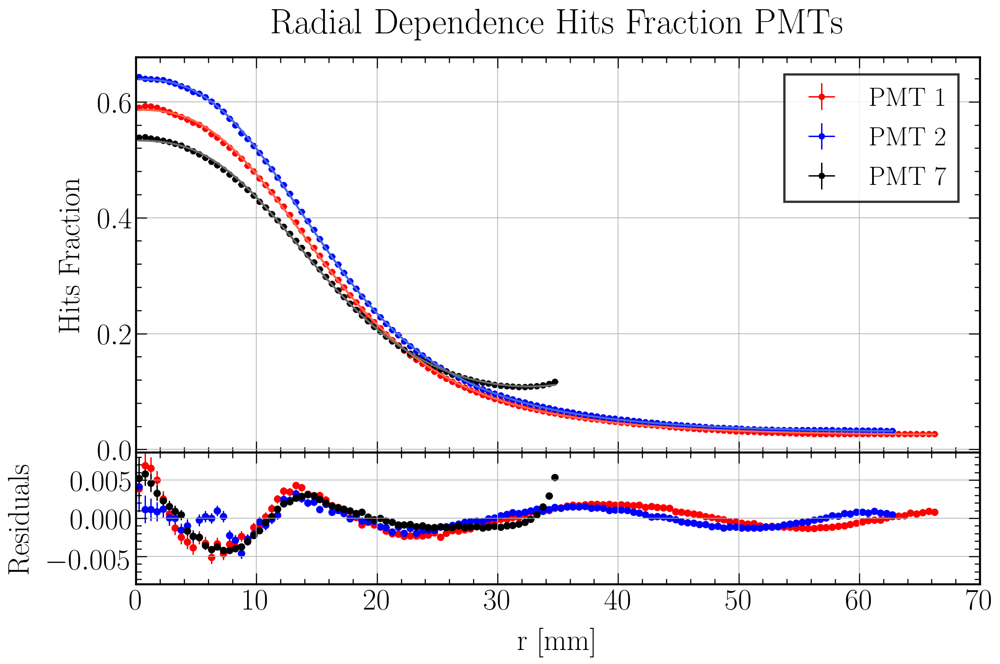

In [67]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)
frame1=fig.add_axes((.1,.3,.8,.6))

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
'''plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1")
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2")
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")'''
plt.errorbar(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1", yerr=HF_R_hist['std_red'][1], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2", yerr=HF_R_hist['std_red'][2], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7", yerr=HF_R_hist['std_red'][7], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)

plt.plot(HF_R_hist['bins_center'][1], model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'tomato', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][2], model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'royalblue', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][7], model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'dimgrey', linewidth = 2.2)

plt.xlim(0.,70.)
frame1.set_xticklabels([])

plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

plt.grid()

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

#############################################
frame2=fig.add_axes((.1,.1,.8,.2)) 

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  

'''plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1] - model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'r', s = 50)
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2] - model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'b', s = 50)
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7] - model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'k', s = 50)'''
plt.errorbar(HF_R_hist['bins_center'][1], HF_R_hist['n'][1] - model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'r', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][1], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][2], HF_R_hist['n'][2] - model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'b', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][2], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)
plt.errorbar(HF_R_hist['bins_center'][7], HF_R_hist['n'][7] - model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'k', ms = np.sqrt(50), yerr=HF_R_hist['std_red'][7], xerr = (70/numberbins)/np.sqrt(12), fmt='o', zorder = 0)

plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)

limit = max(max(abs(HF_R_hist['n'][1] - model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]))), max(abs(HF_R_hist['n'][2] - model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]))), max(abs(HF_R_hist['n'][7] - model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]))))
plt.ylim(-1.25 * limit, 1.25 * limit)
plt.xlim(0.,70.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

plt.grid()

plt.show()

fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs_Fit_"+modelstring+"_Residuals.png", bbox_inches = "tight")

In [68]:
#filenameprefix = "optPhot_S2_3e7"
#HF_x_y_hist2d_perPMT = pd.read_pickle("output/"+filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

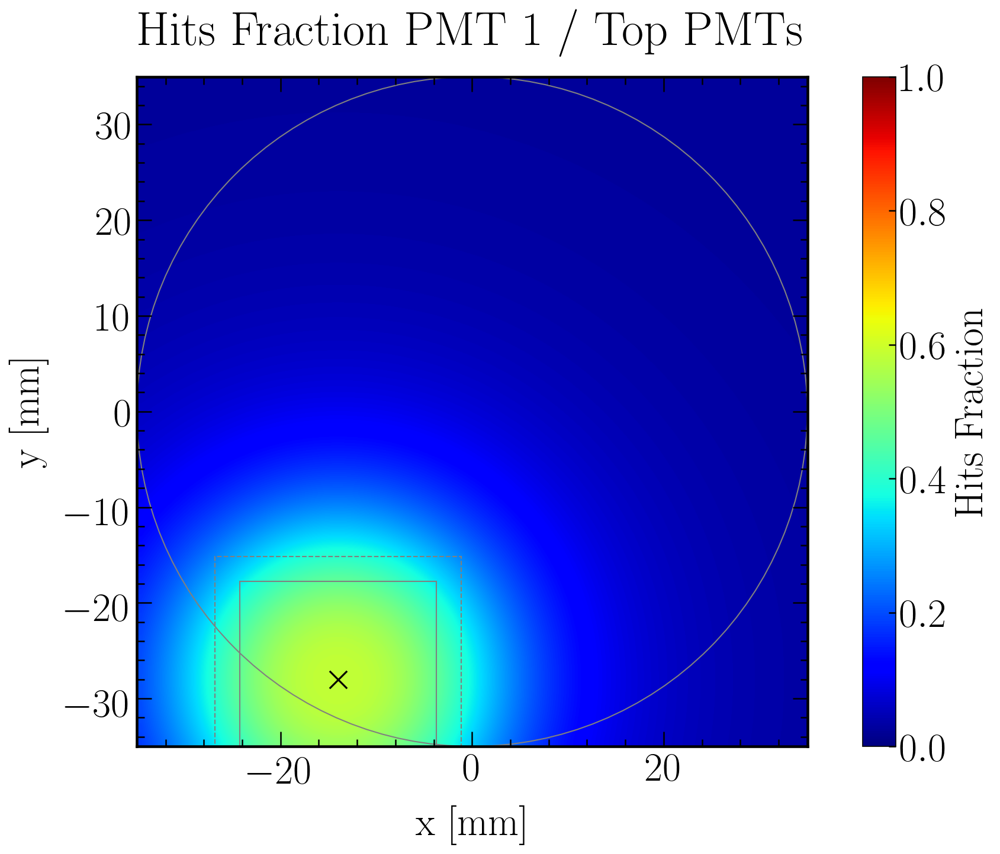

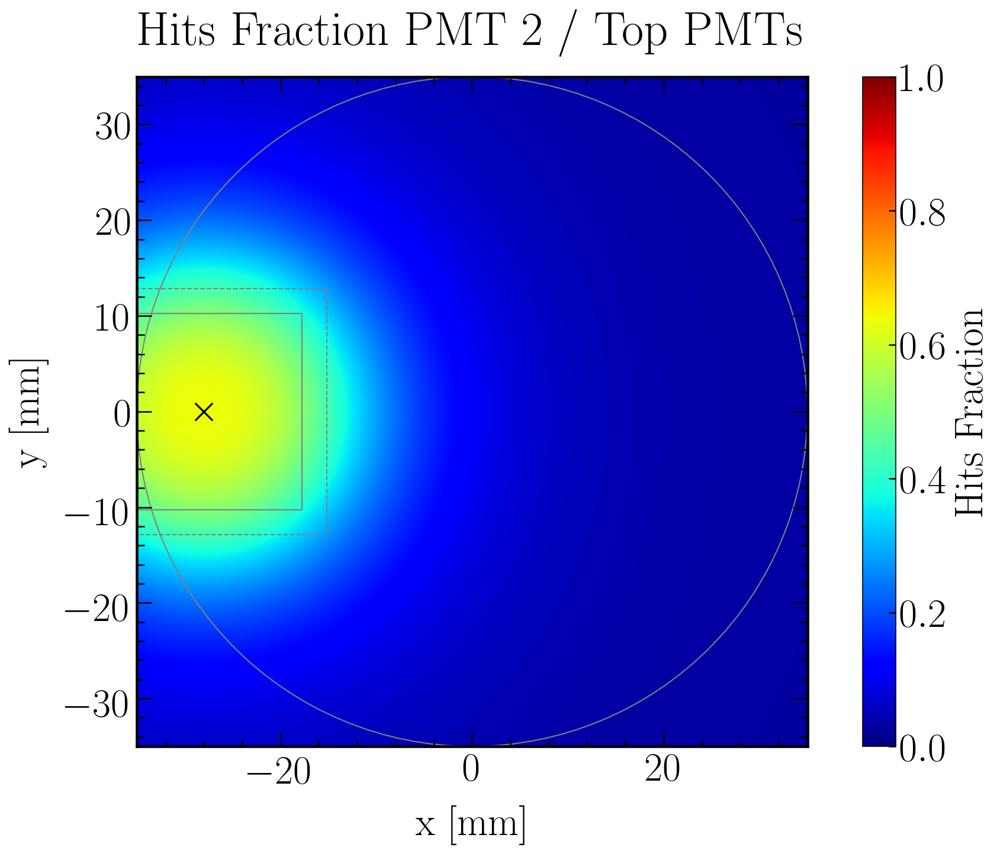

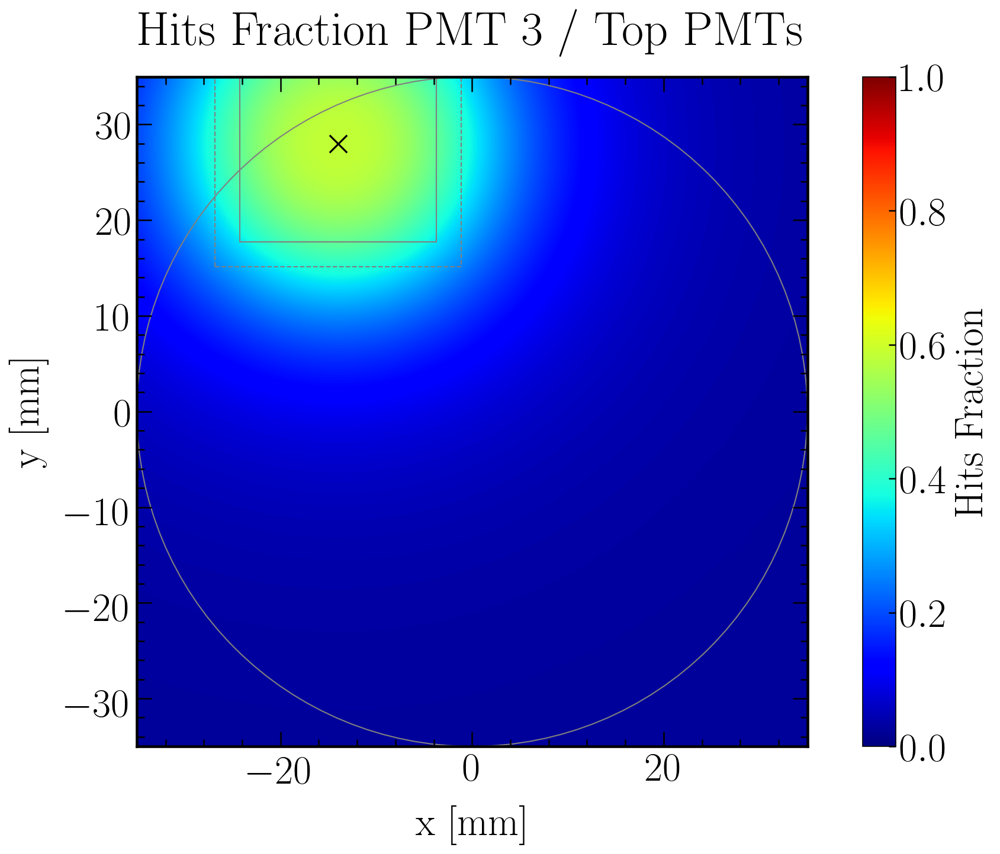

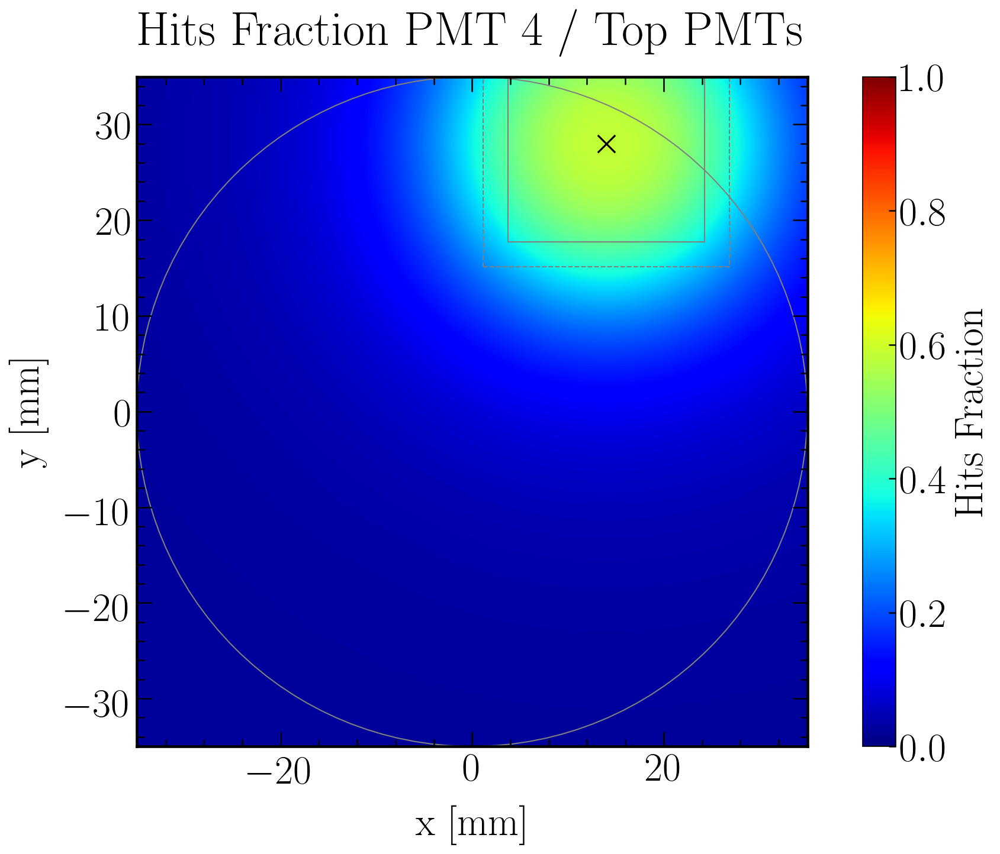

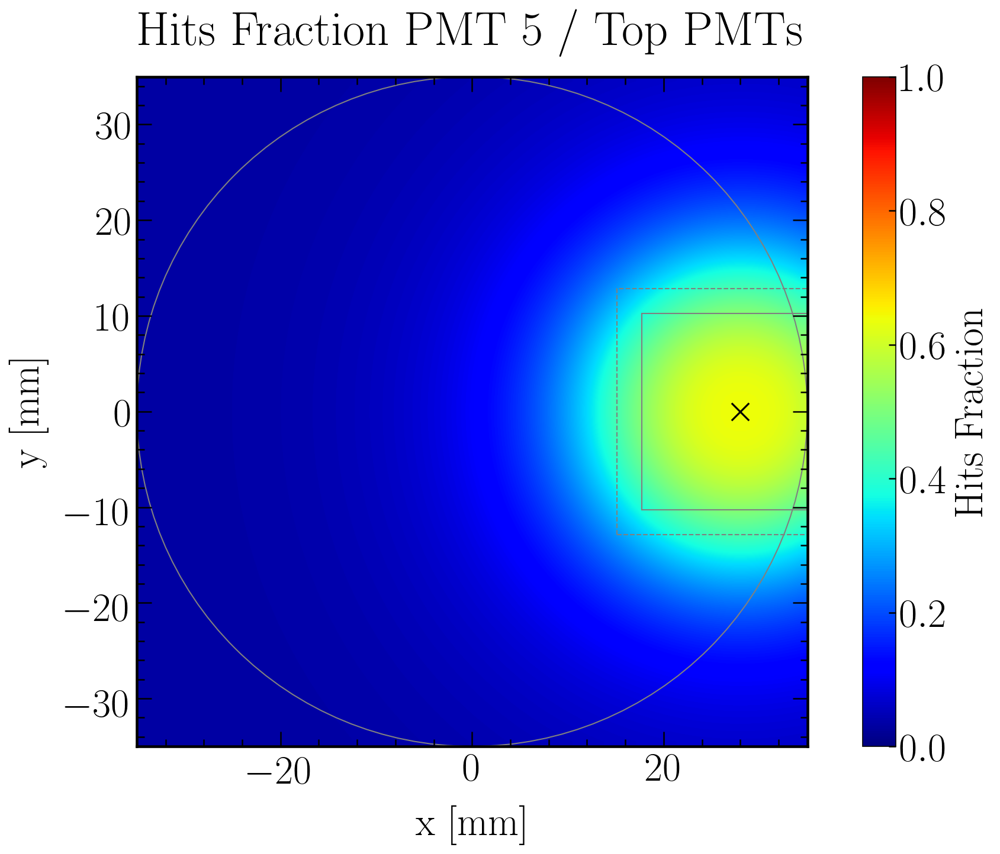

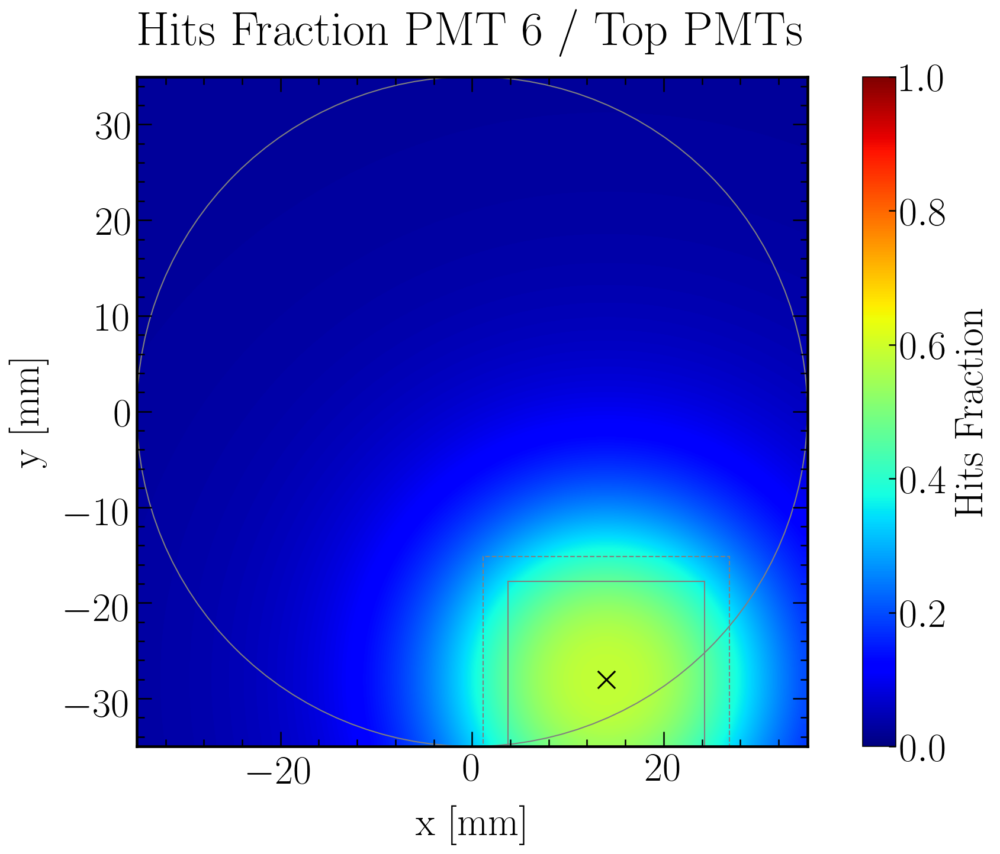

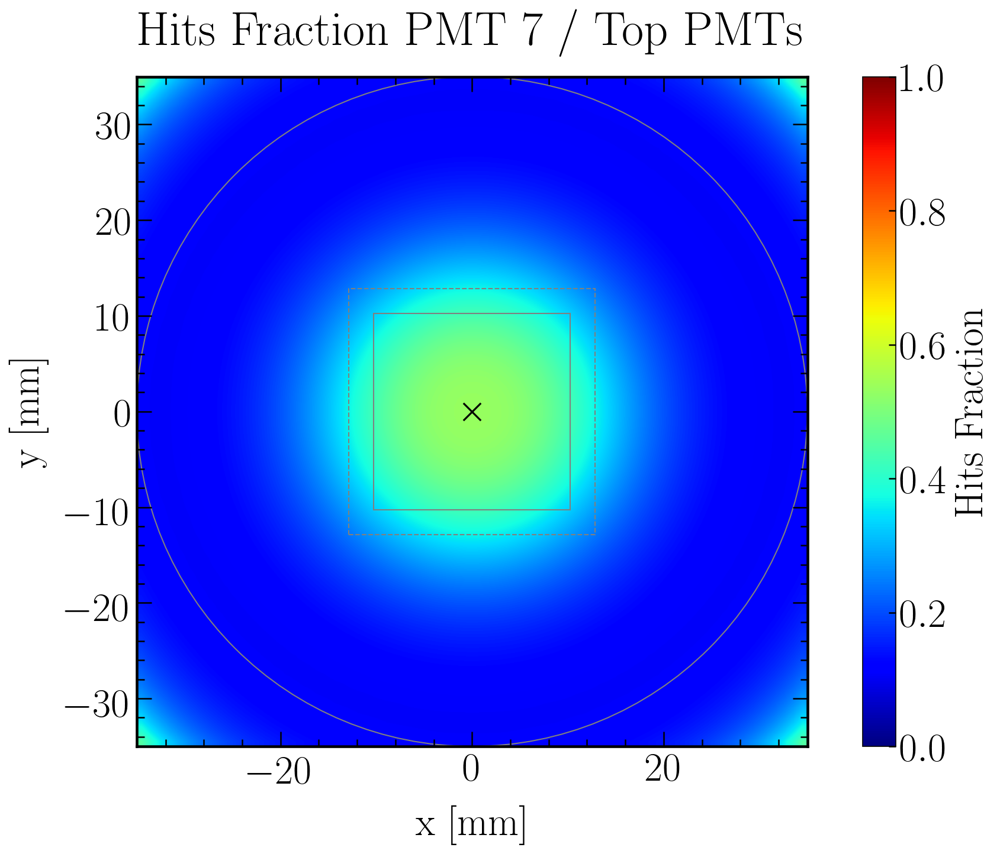

In [69]:
for i in range(1,8):

    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid

    im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
    im.set_interpolation('bilinear')    
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(0.0, 1.0)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+".png")

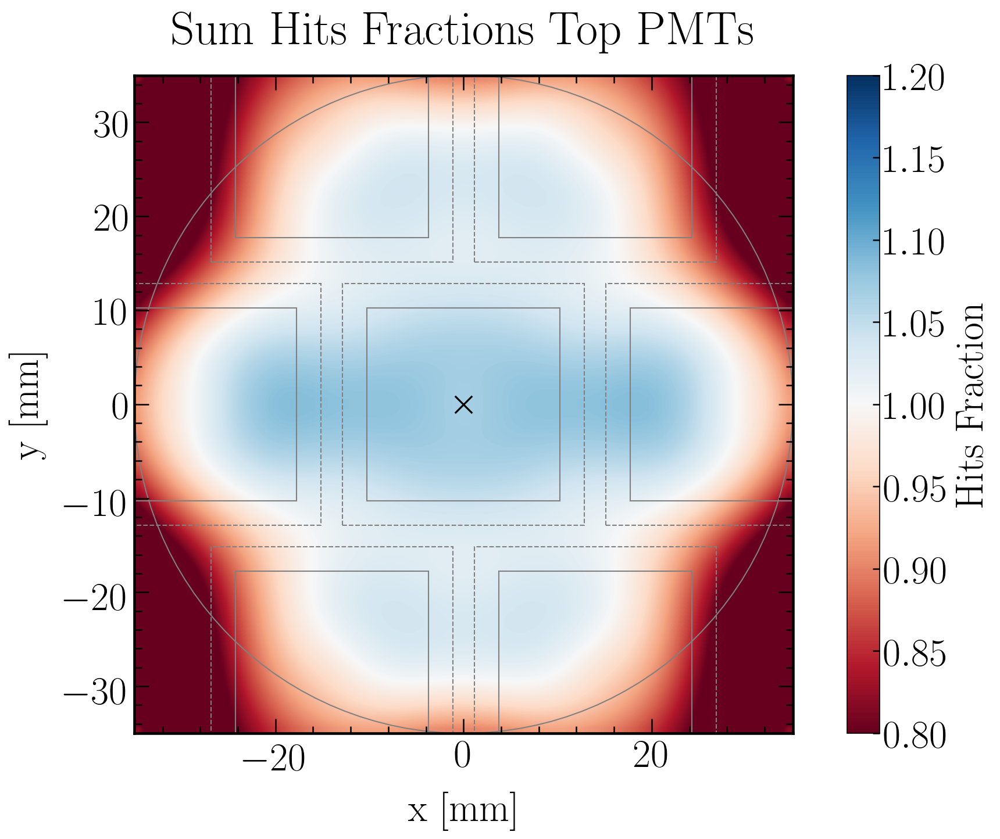

In [70]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
def z_func(x,y):
    return model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1])

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = cm.RdBu)
im.set_interpolation('bilinear')    
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Sum Hits Fractions Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
plt.clim(0.8, 1.2)

plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMTs_of_TopPMTs_"+modelstring+".png")

In [71]:
# Calculate HF map from LRF analogous to hist2D from "real" values

HF_x_y_LRF_perPMT = pd.DataFrame({'X' : [], 'Y' : [], 'Z' : []})
columns = ['X', 'Y', 'Z']

for i in range(1,8):
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])
    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    HF_x_y_LRF_perPMT = HF_x_y_LRF_perPMT.append({'X': X, 'Y' : Y, 'Z' : Z}, ignore_index=True)

HF_x_y_LRF_perPMT = HF_x_y_LRF_perPMT.set_index(PMT_ID)
HF_x_y_LRF_perPMT.to_pickle(filenameprefix+"_HF_x_y_LRF_perPMT_"+modelstring+".pkl")

# sum of PMTs
HF_x_y_LRF_perPMT_Z_sum = HF_x_y_LRF_perPMT['Z'].sum()

HF_x_y_LRF_perPMT

,X,Y,Z
1,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.1862501464969277, 0.20419448095360004, 0.2..."
2,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.06655770017374604, 0.06725489245354893, 0...."
3,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.026012816454051464, 0.026051858173839648, ..."
4,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.02566271432159927, 0.025626421594148328, 0..."
5,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.0313845158157504, 0.03136279421496492, 0.0..."
6,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.032820917216179954, 0.03371817384563523, 0..."
7,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.45075250911951215, 0.4003453211783617, 0.3..."


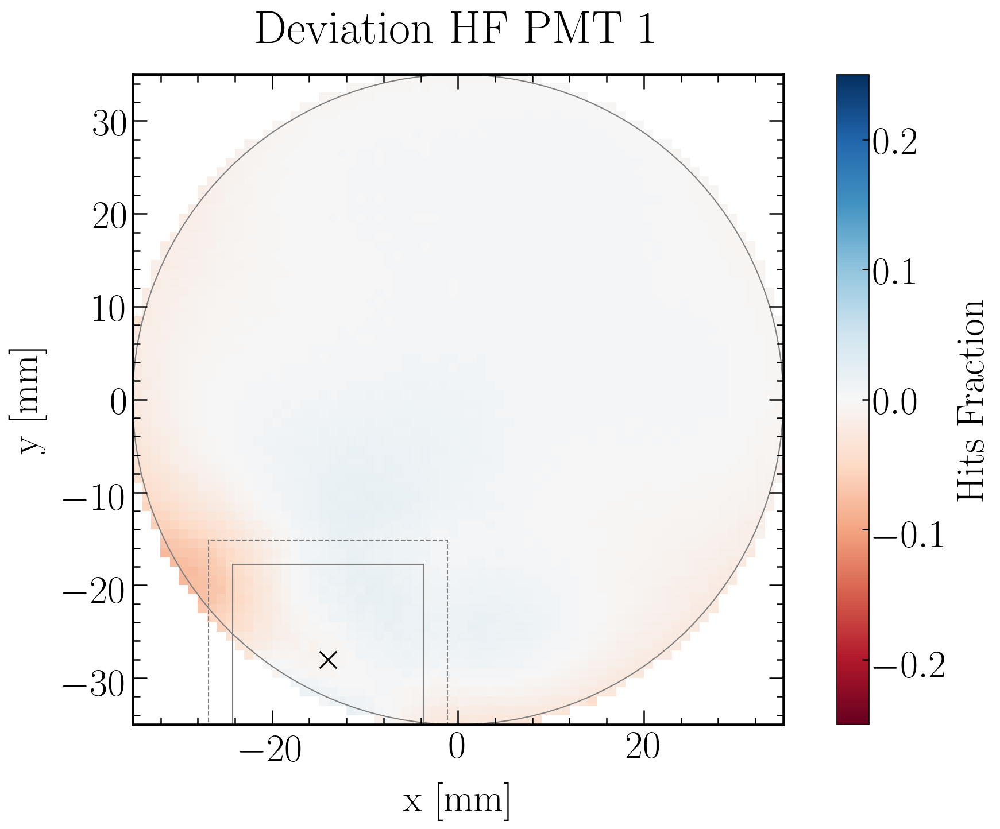

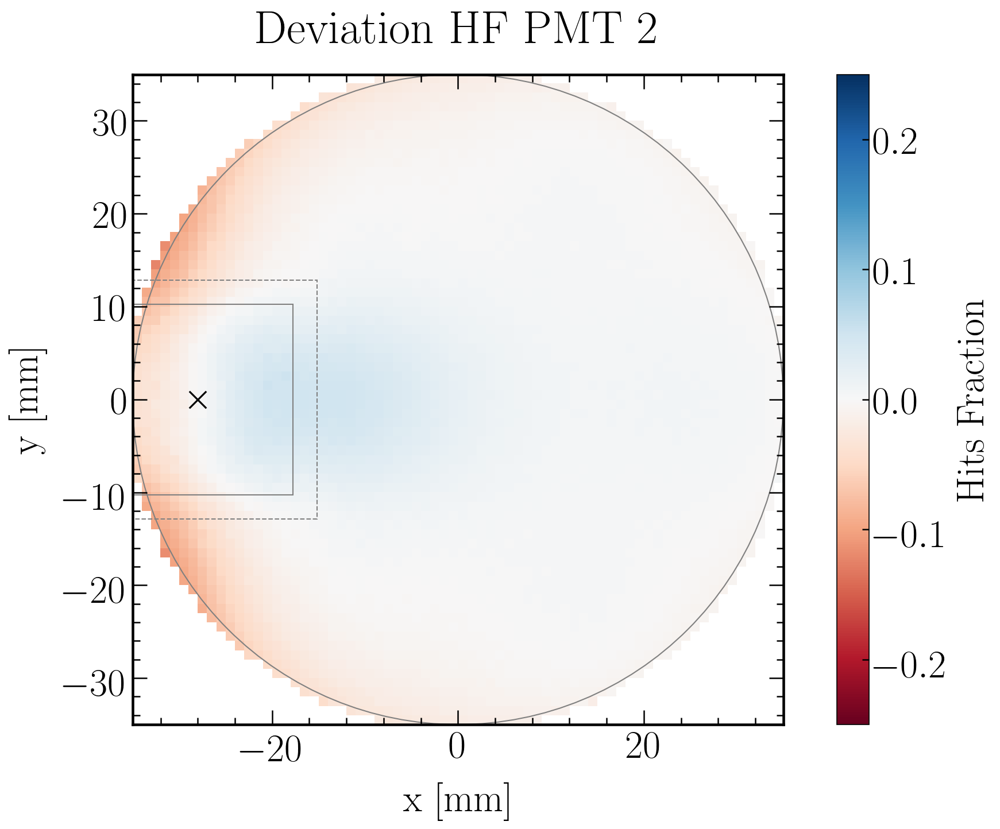

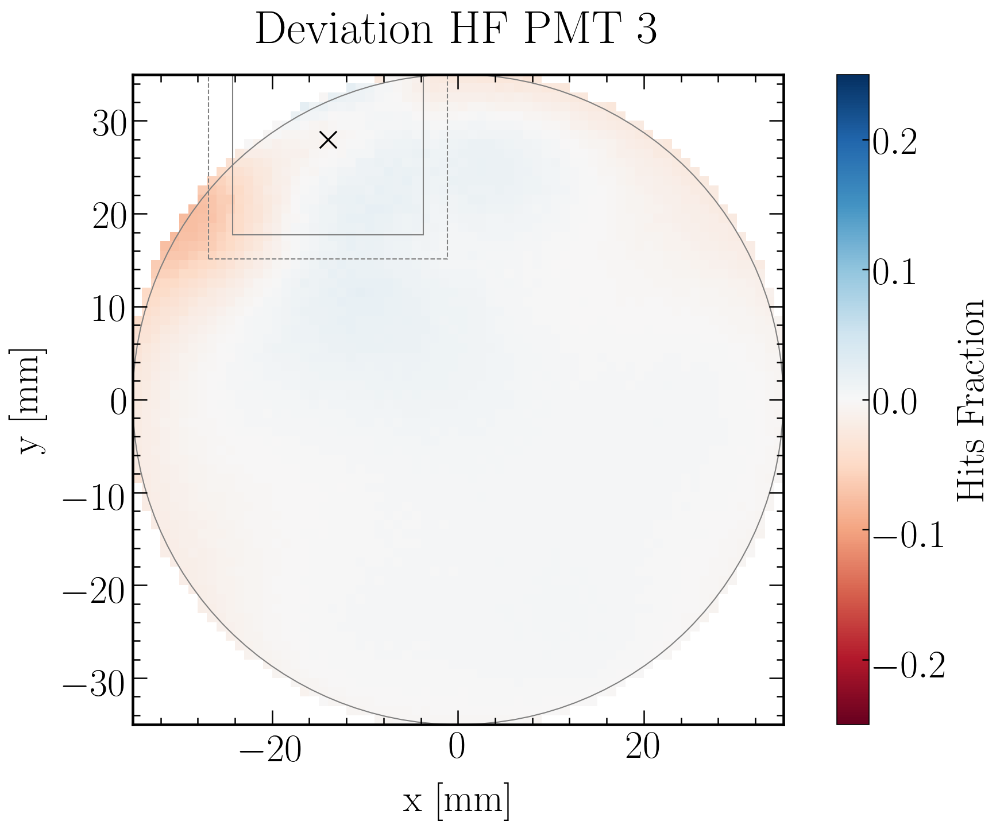

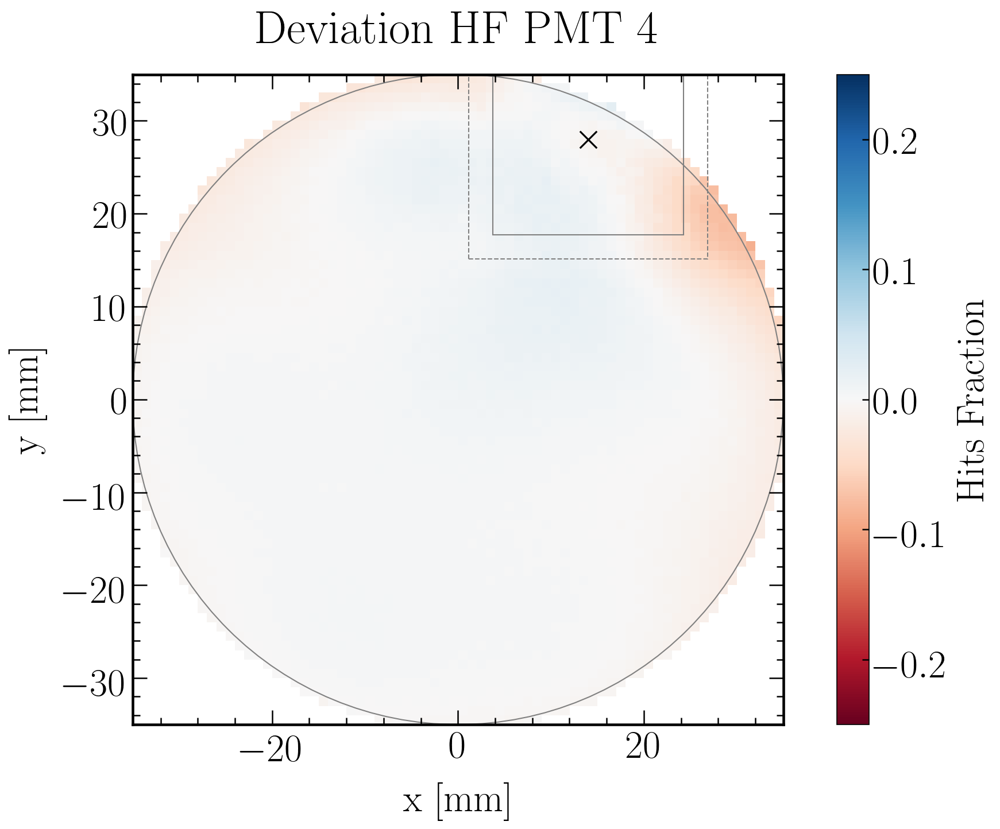

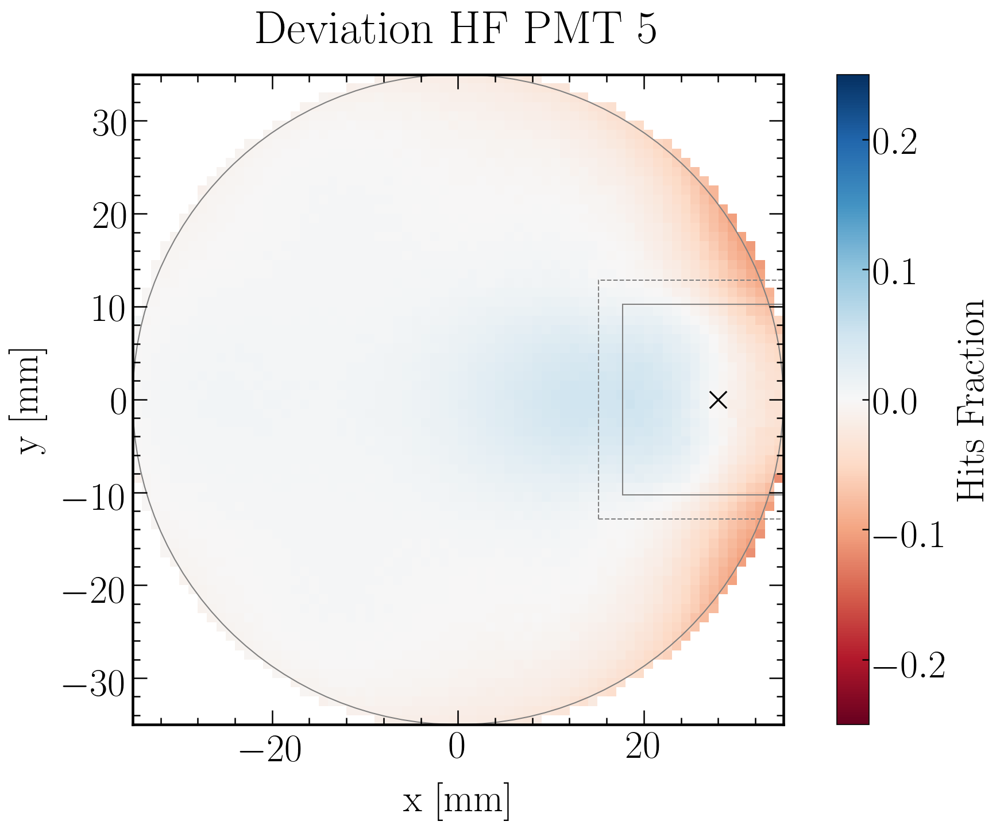

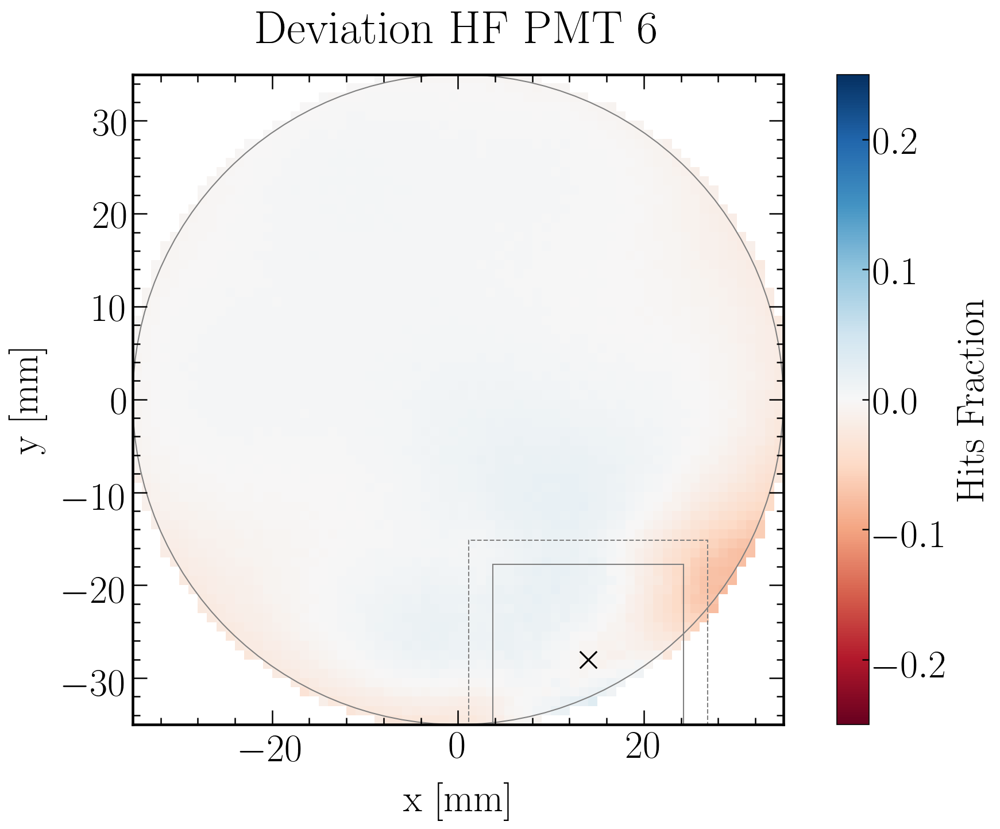

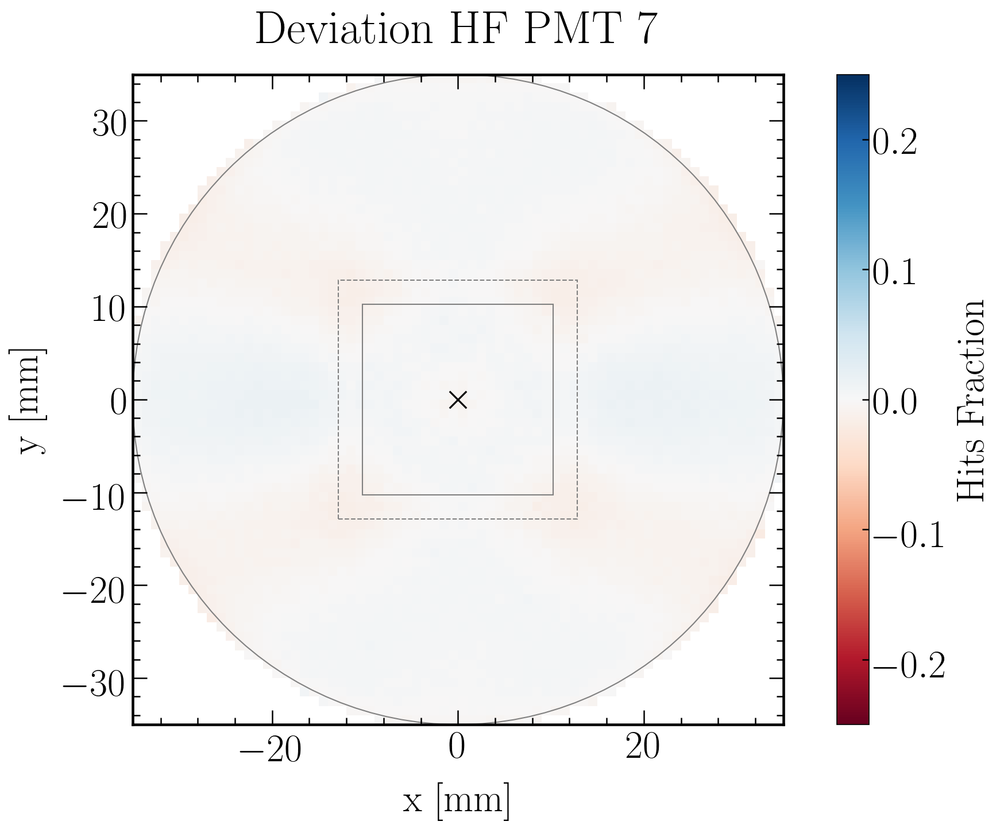

In [72]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    Z = HF_x_y_LRF_perPMT['Z'].loc[i]

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = (Z - HF_x_y_hist2d_perPMT['histT'].loc[i])
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-0.25, 0.25)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_Deviation.png")

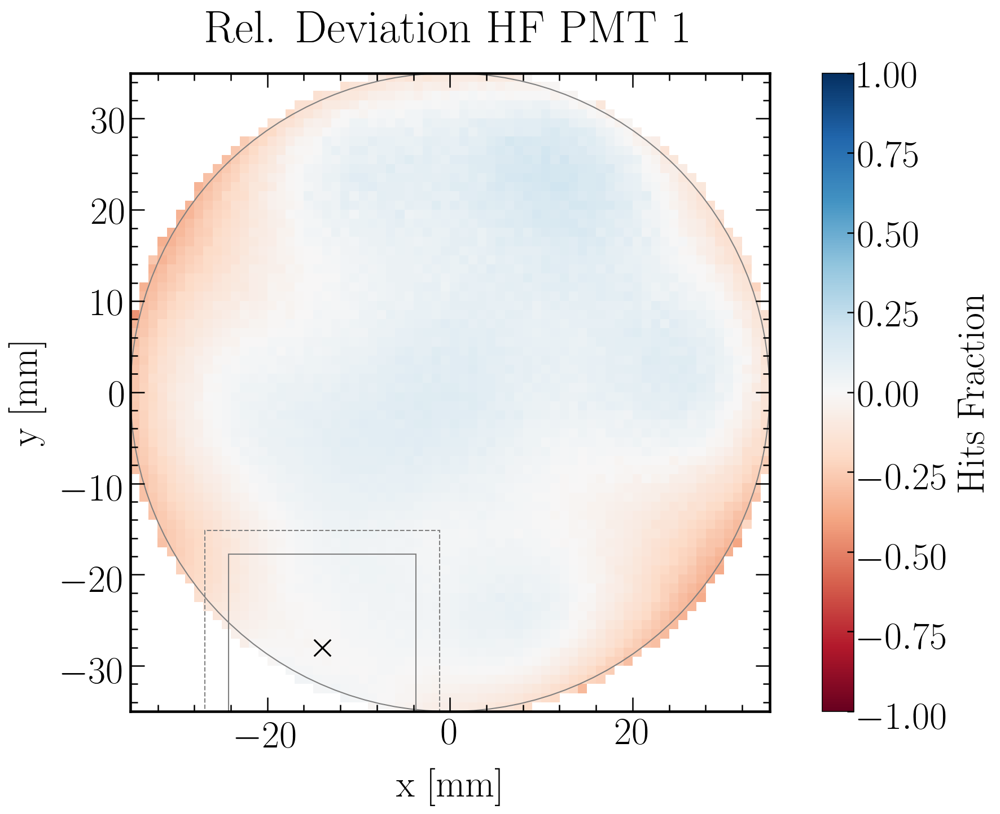

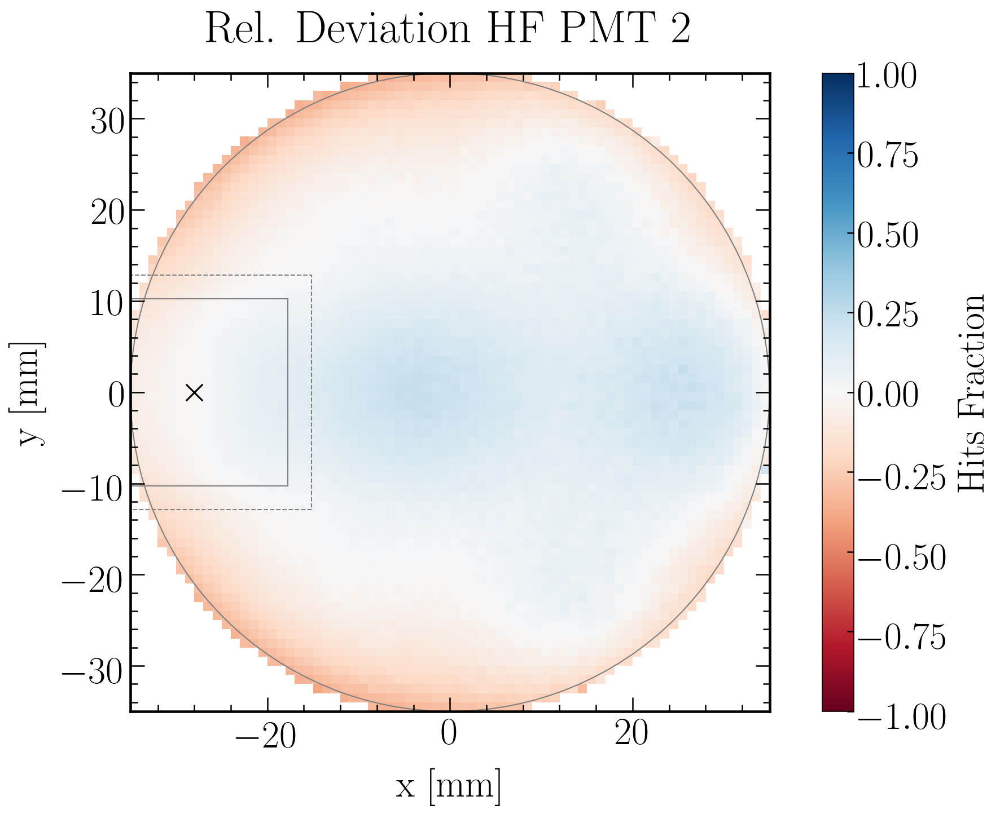

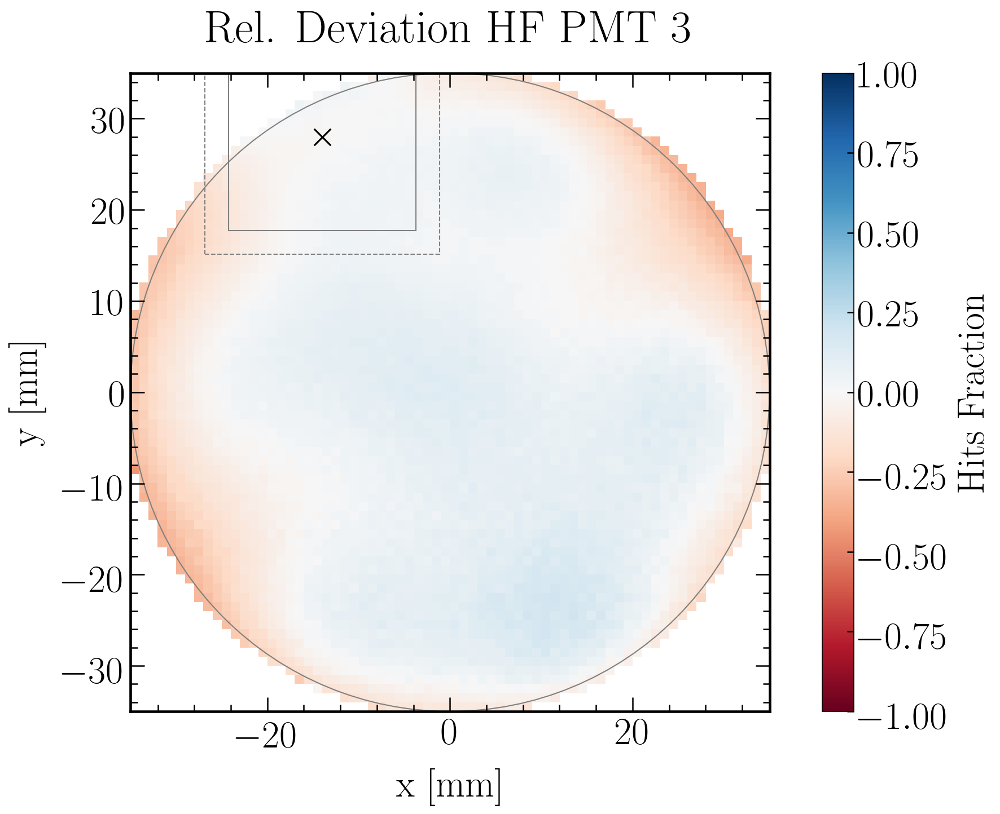

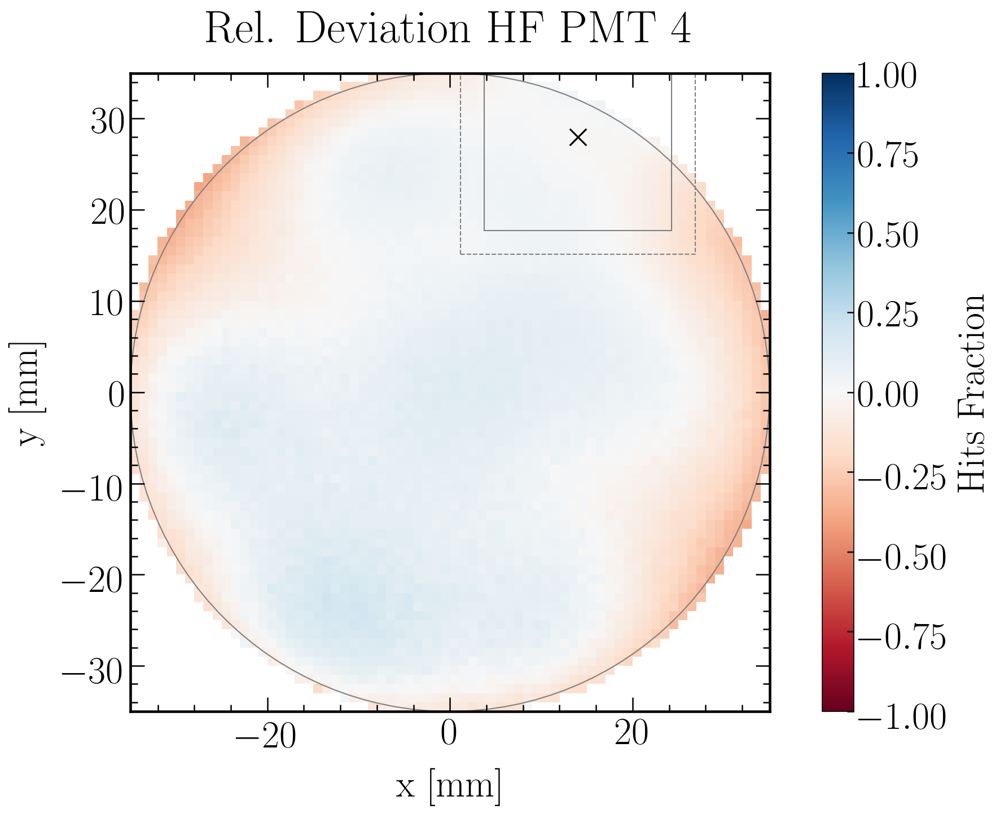

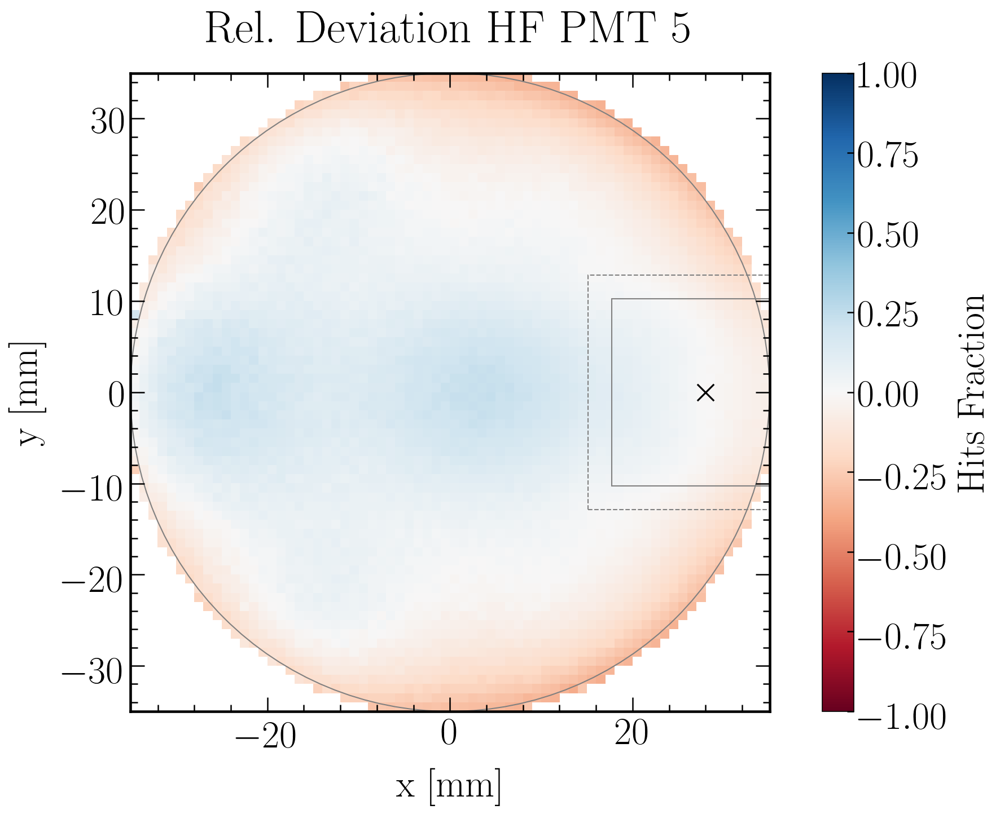

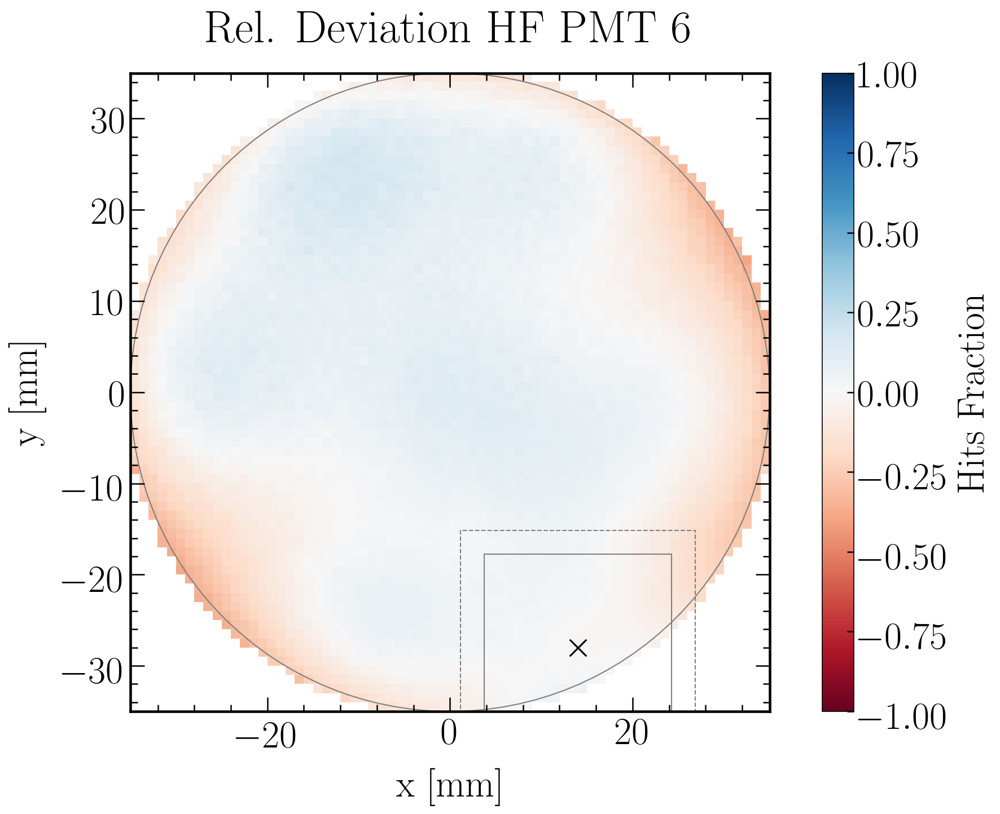

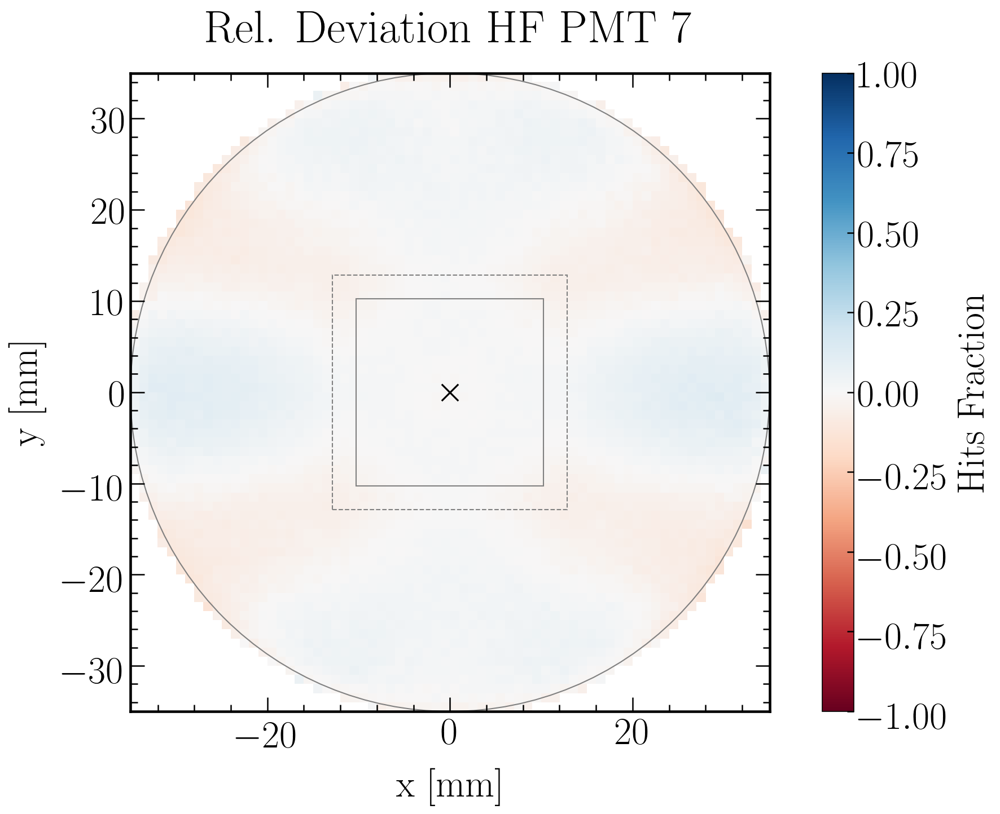

In [73]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    Z = HF_x_y_LRF_perPMT['Z'].loc[i]

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = ((Z - HF_x_y_hist2d_perPMT['histT'].loc[i]) / (HF_x_y_hist2d_perPMT['histT'].loc[i]))
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-1, 1)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_RelDeviation.png")

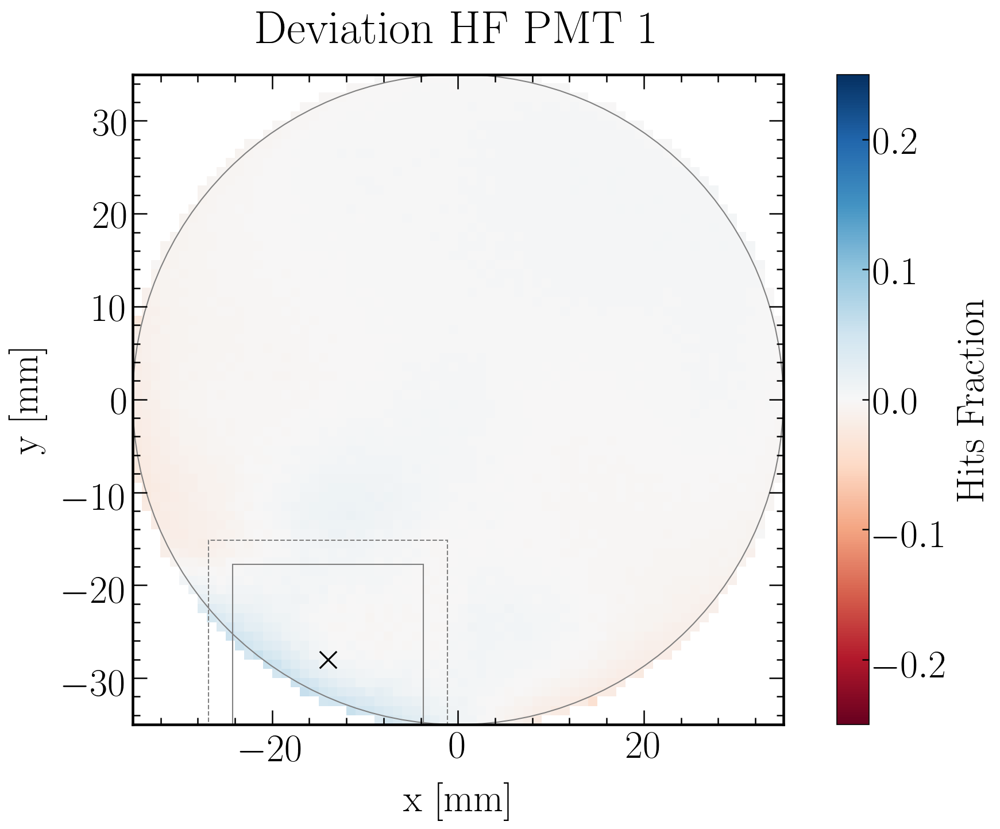

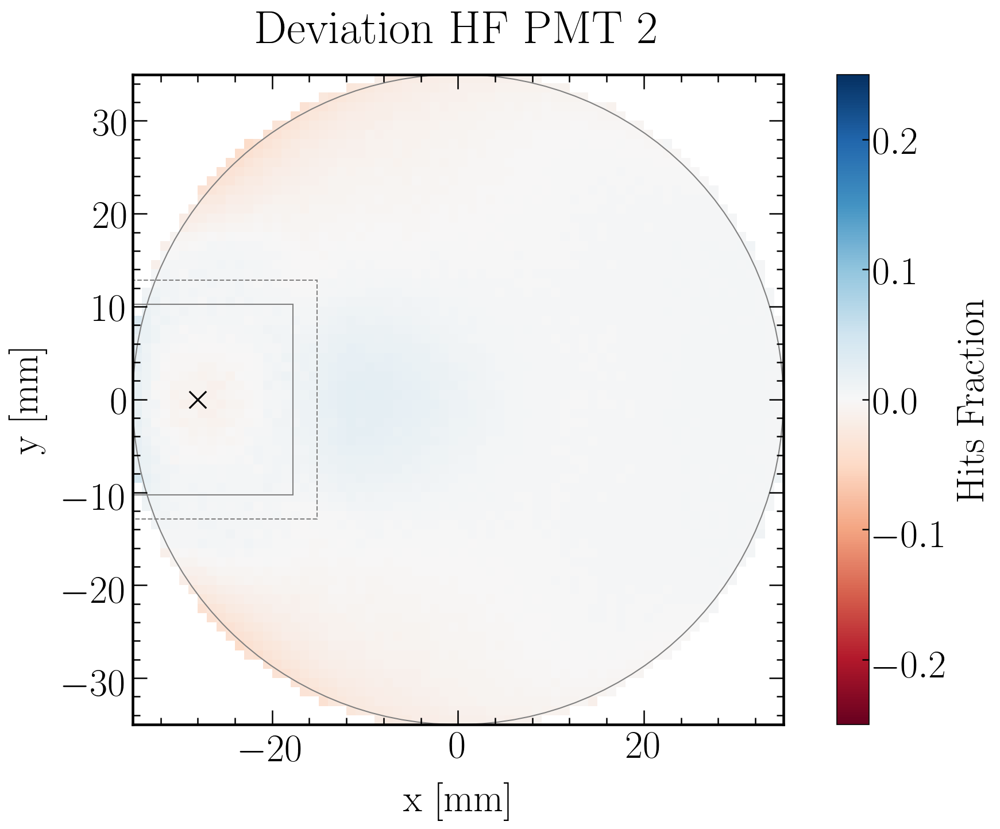

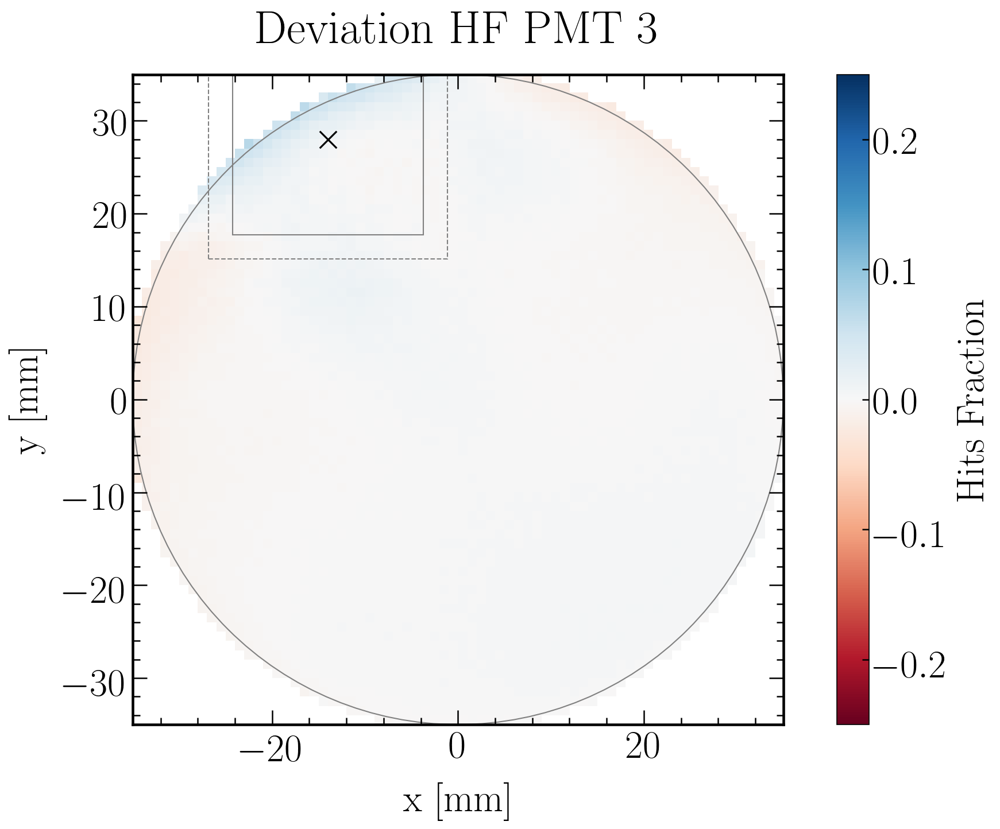

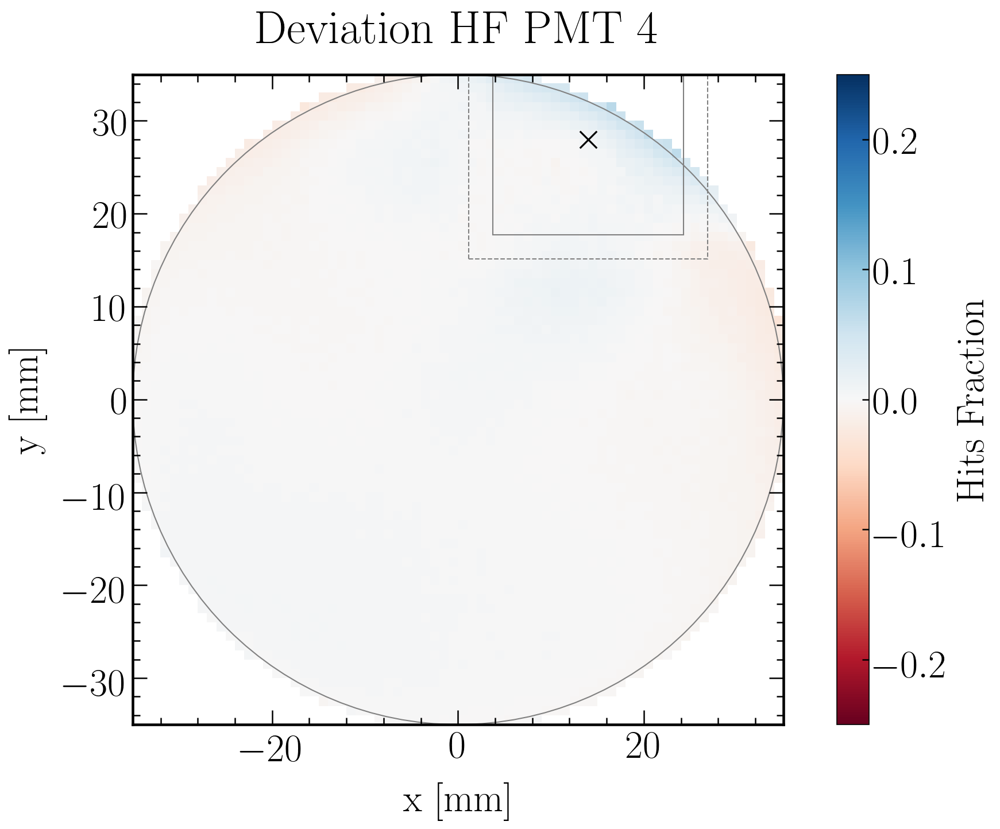

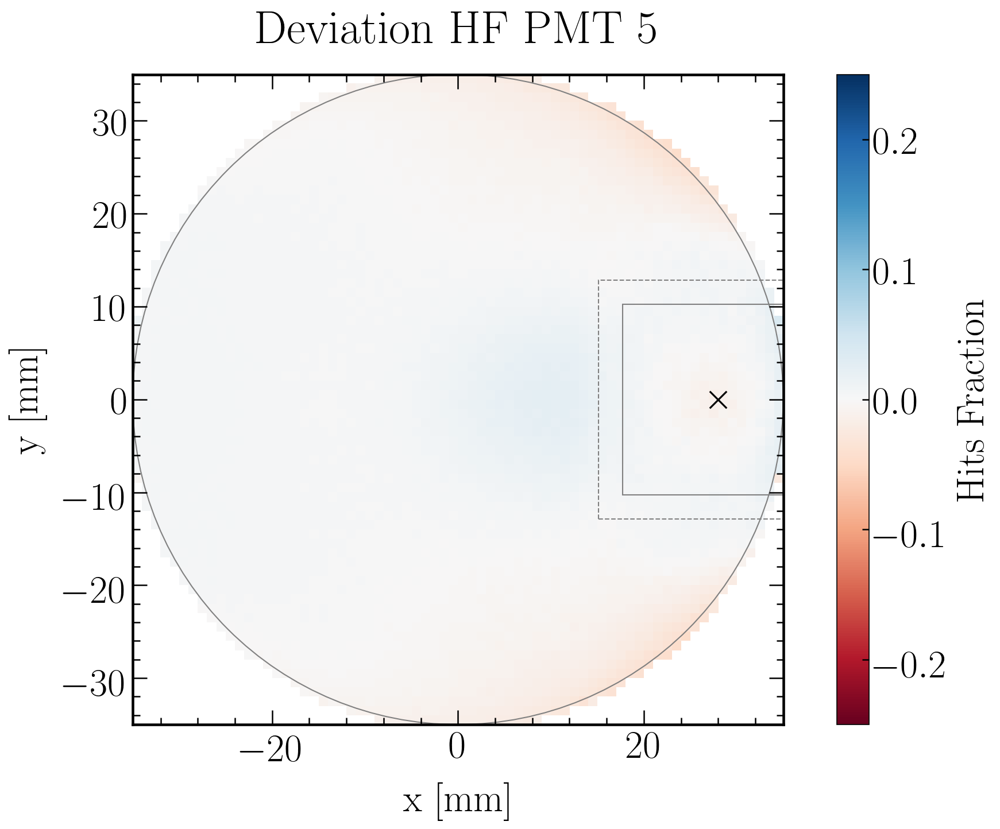

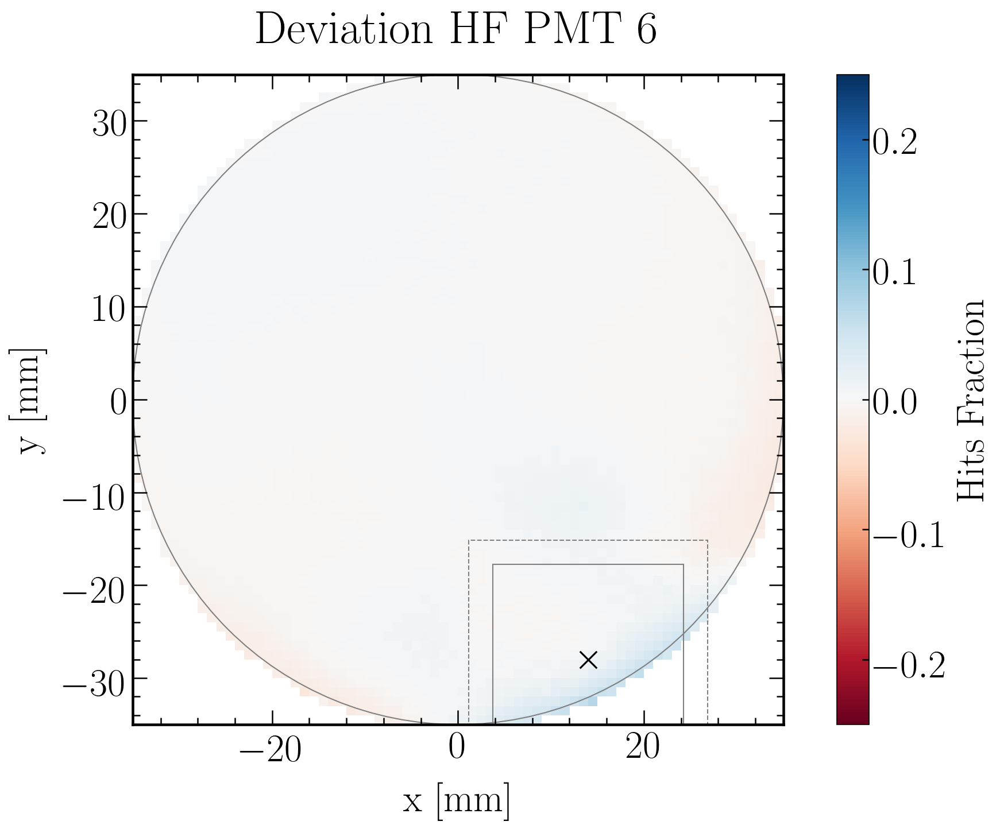

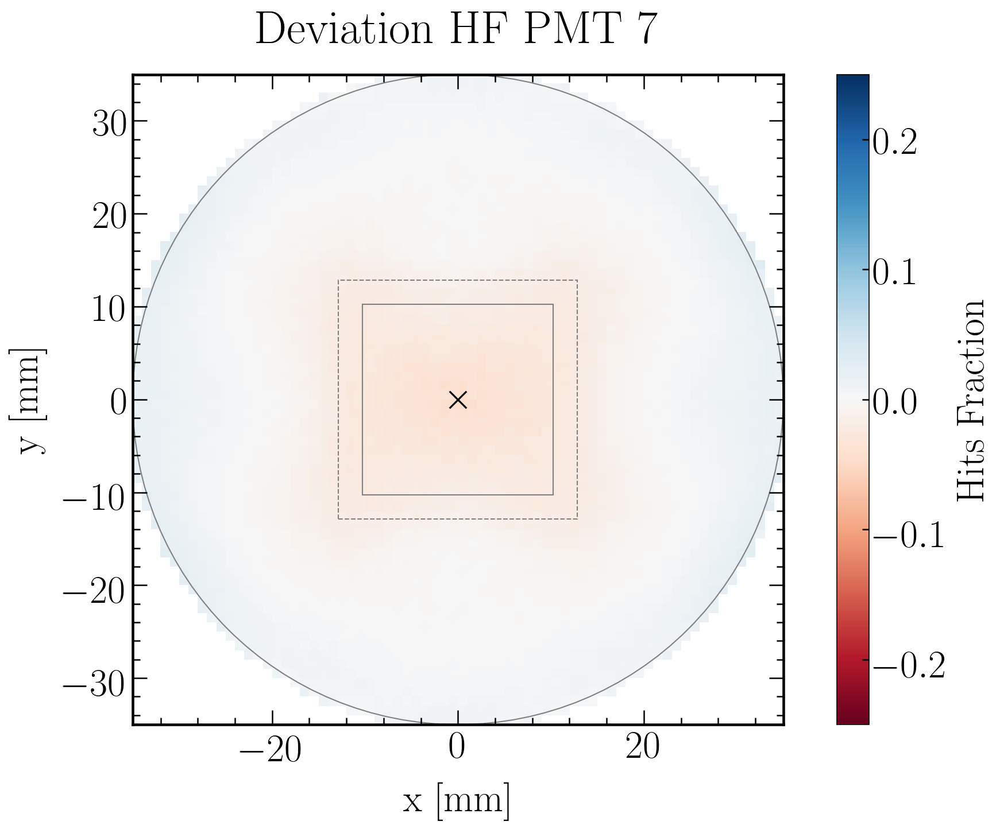

In [74]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    
    Z = HF_x_y_LRF_perPMT['Z'].loc[i] / HF_x_y_LRF_perPMT_Z_sum

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = (Z - HF_x_y_hist2d_perPMT['histT'].loc[i])
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-0.25, 0.25)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_Deviation_overSumLRFs.png")

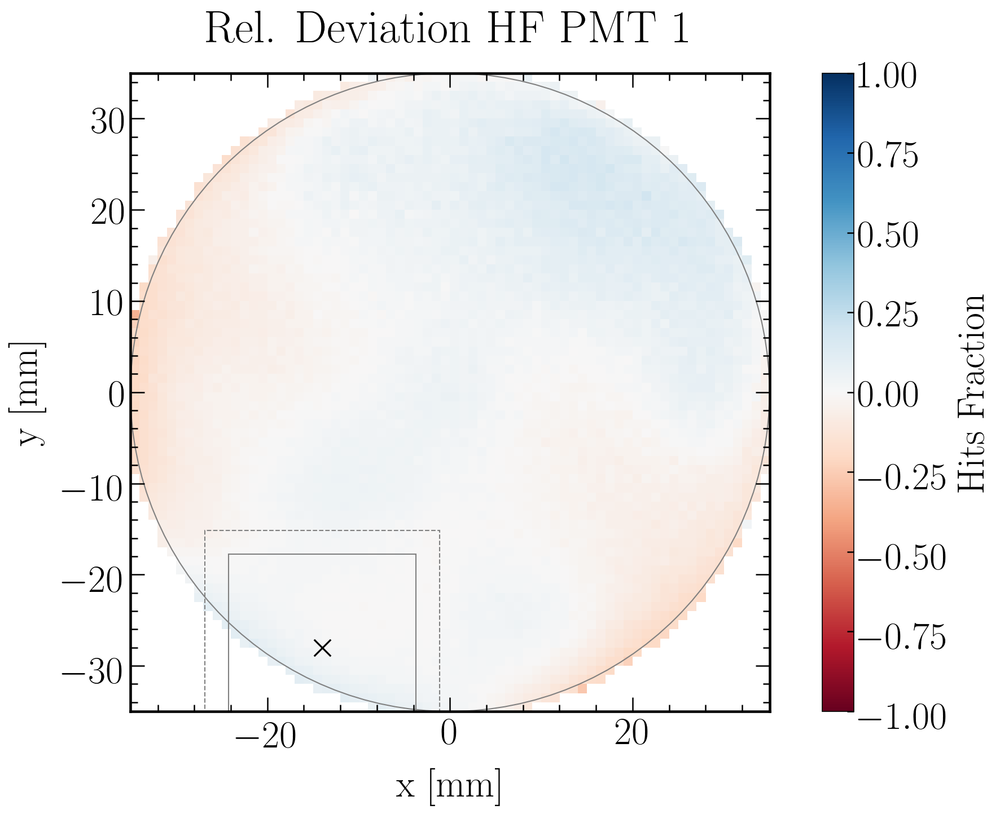

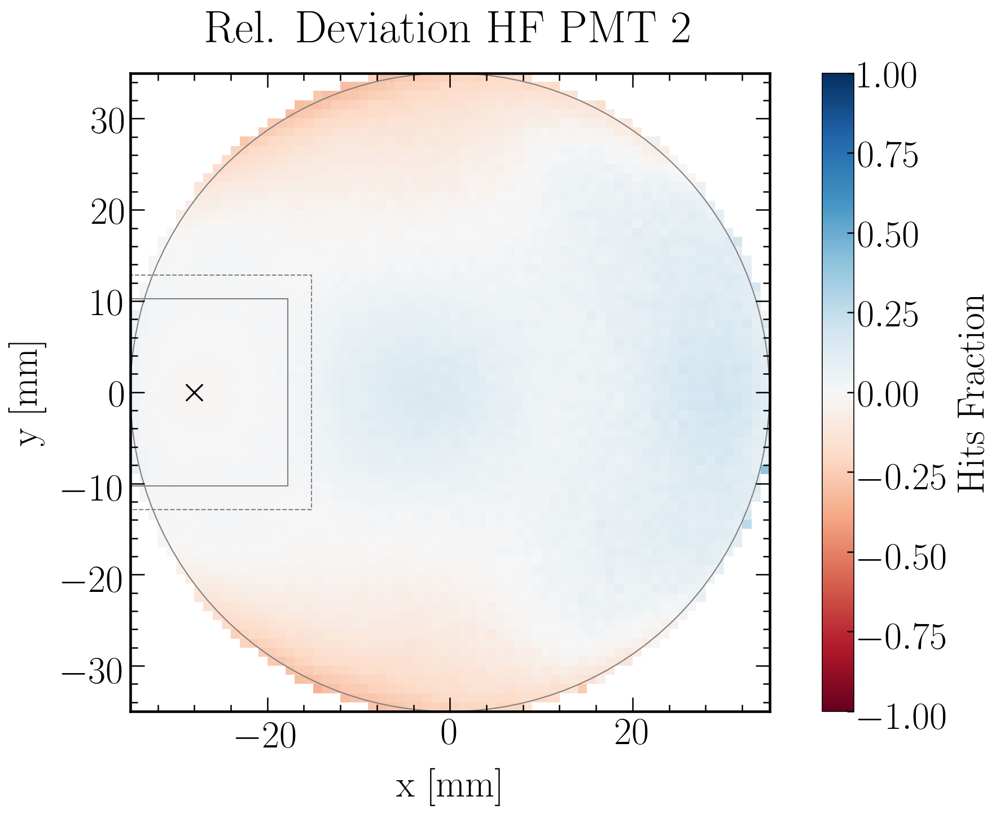

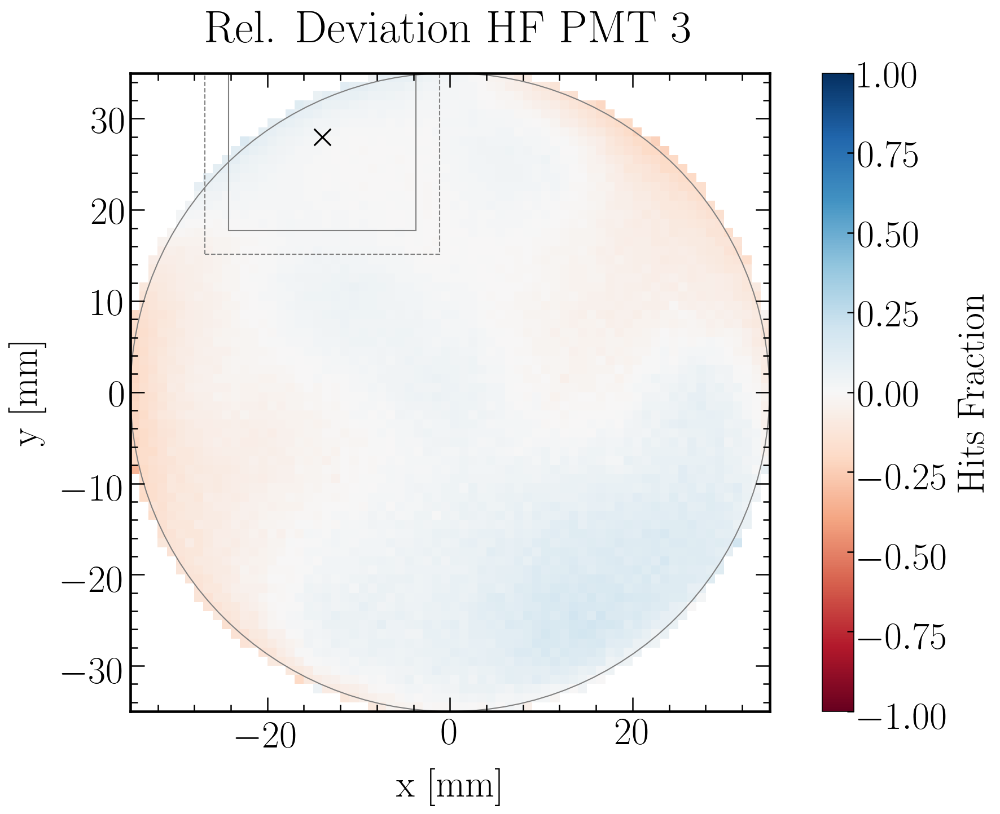

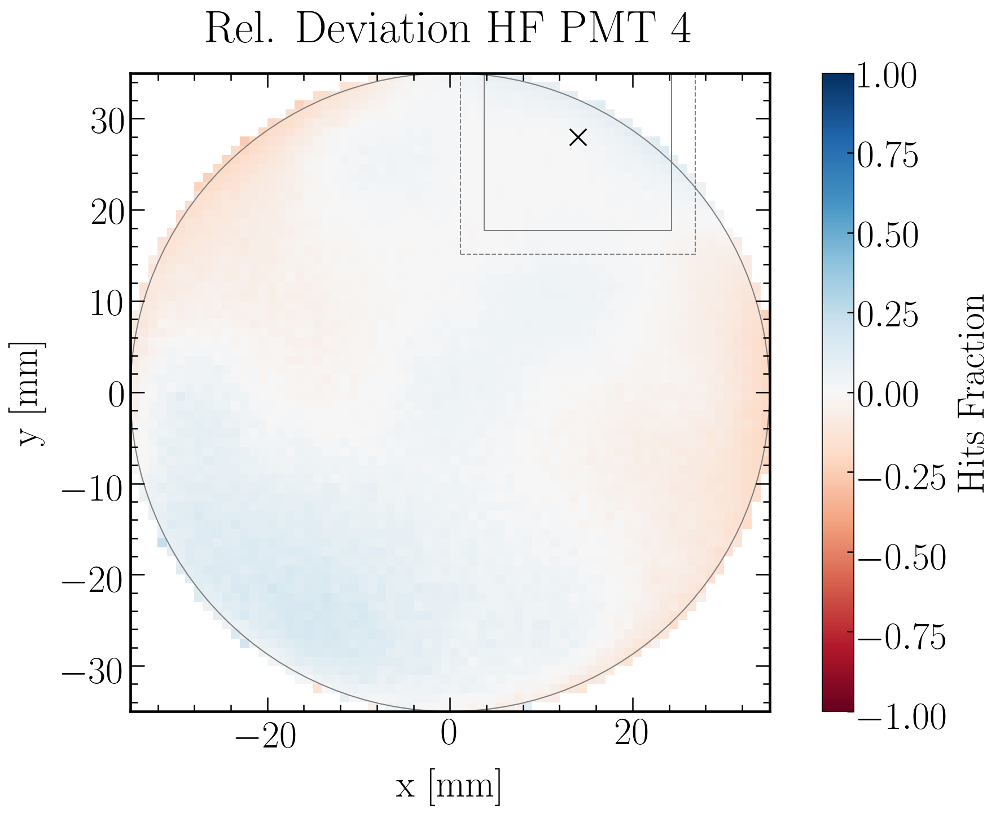

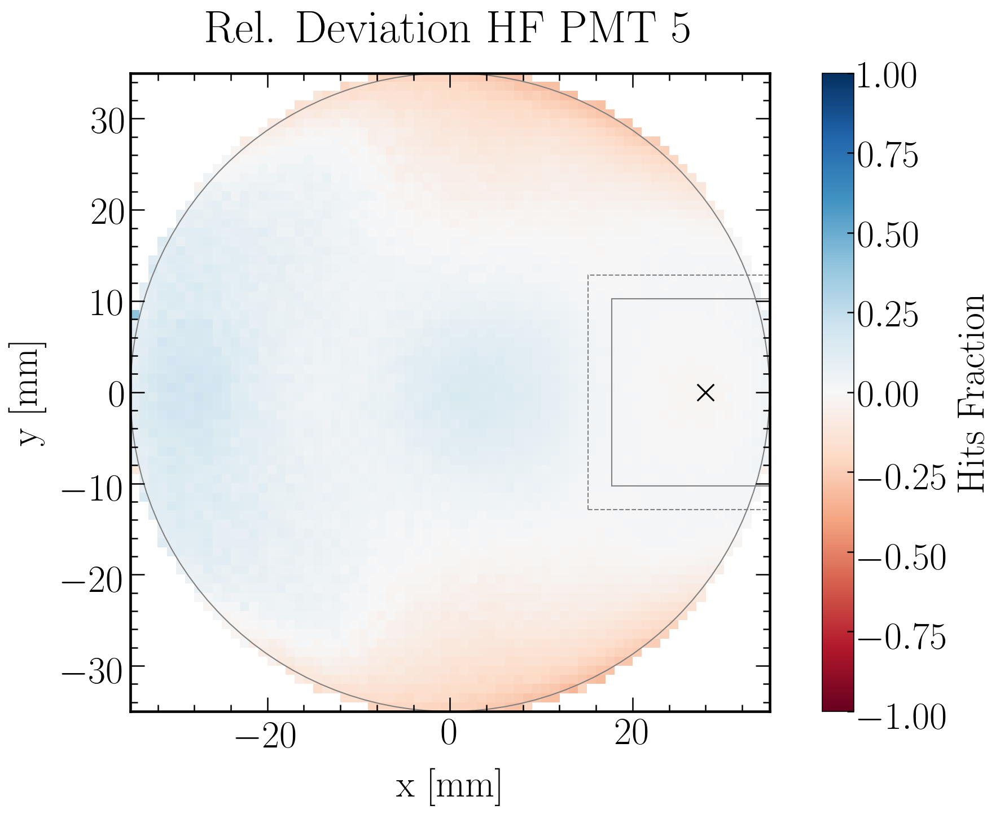

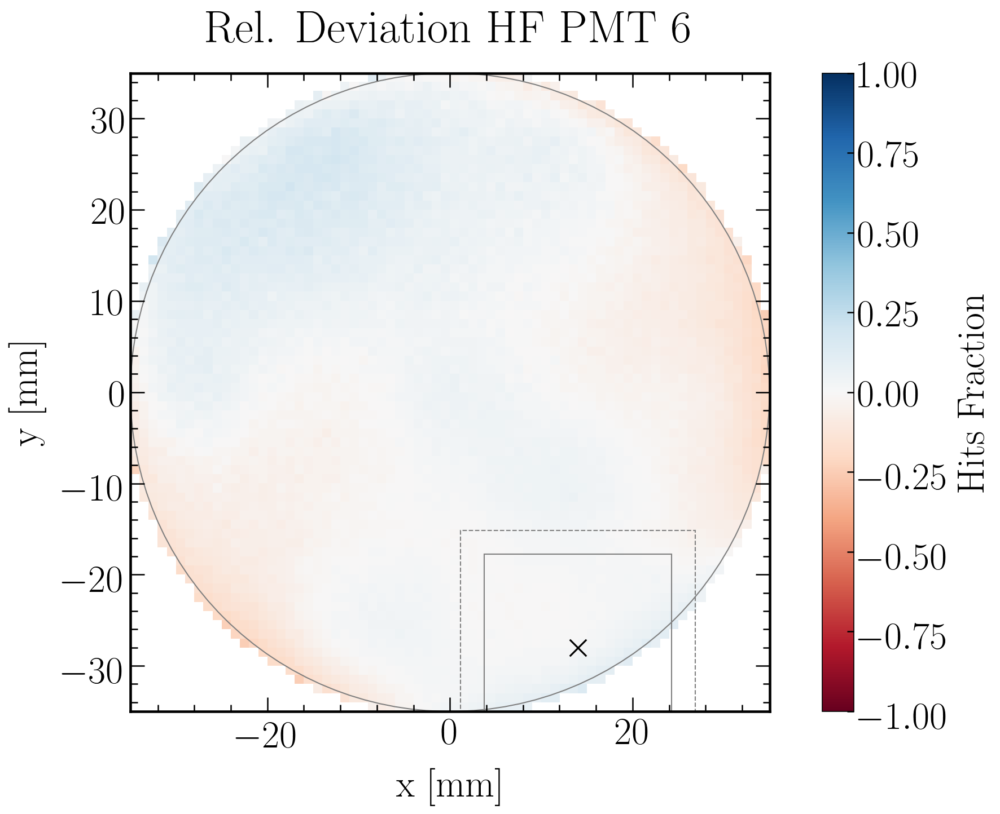

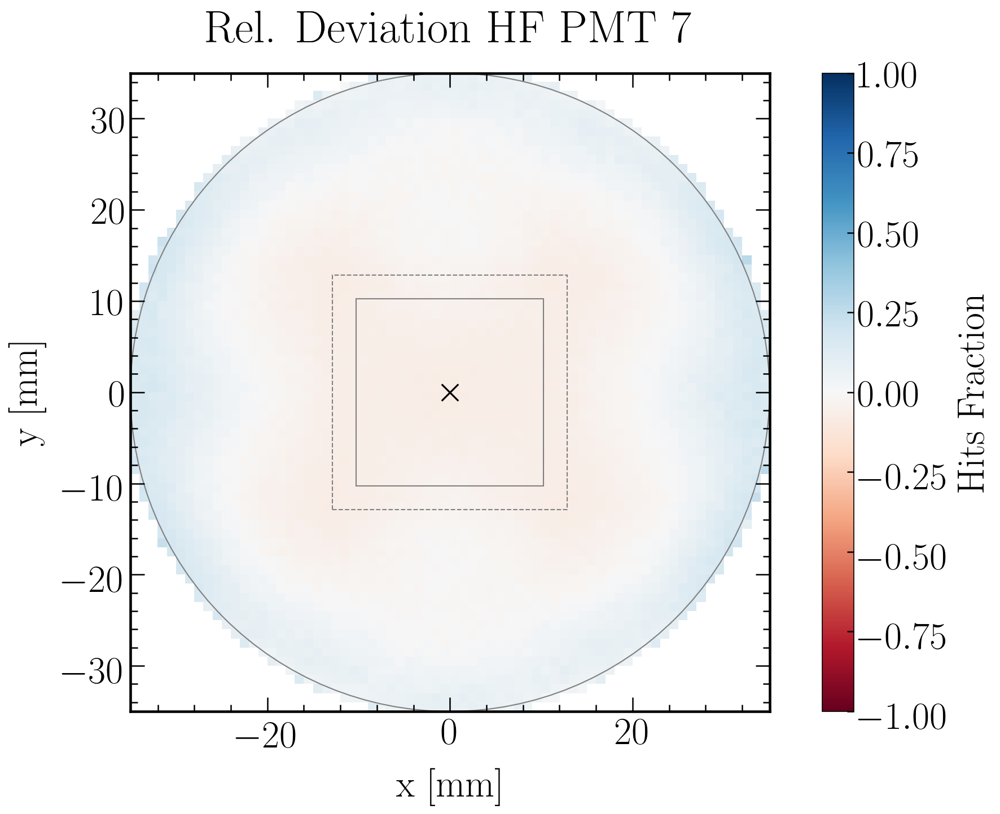

In [75]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    
    Z = HF_x_y_LRF_perPMT['Z'].loc[i] / HF_x_y_LRF_perPMT_Z_sum

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = ((Z - HF_x_y_hist2d_perPMT['histT'].loc[i]) / (HF_x_y_hist2d_perPMT['histT'].loc[i]))
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-1, 1)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_RelDeviation_overSumLRFs.png")

### Polar LRF

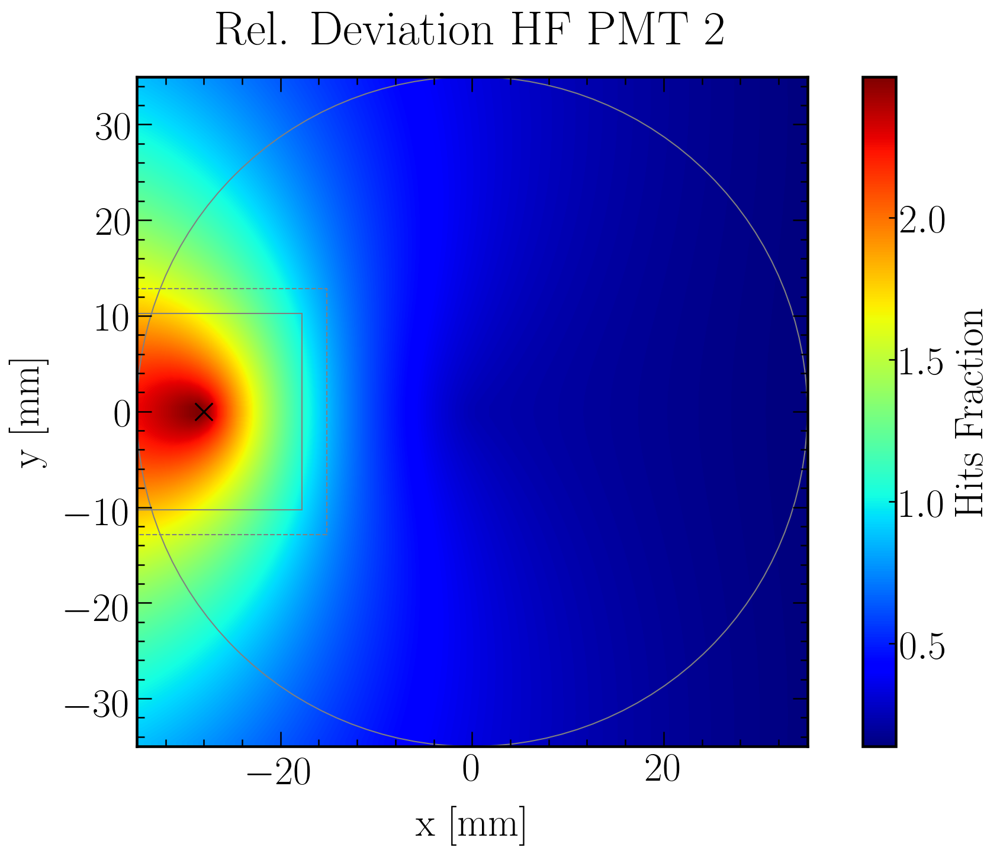

In [76]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
def z_func(x,y):
    return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

#####################
i = 2

def z_func(x,y):
    r = np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2)
    r_int = np.sqrt((x)**2 + (y)**2)
    return np.exp(- r/ 20)*np.exp(r_int /30)

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
im.set_interpolation('bilinear') 
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
#plt.clim(-0.25, 0.25)

plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
currentAxis = plt.gca()
currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

#cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

plt.show()

-> Postponed

### Directly reconstructed positions with Radial LRF

In [77]:
##############################################################
### Simulated 'measured' HF to be reconstructed

## Grid real positions
x = HF_x_y_hist2d_perPMT['xedges_center'].loc[6] # xedges_center hist2d
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[6] # yedges_center hist2d
X, Y = meshgrid(x, y)
del(x)
del(y)
# selection in meshgrid(x, y): [y from low to high][x from low to high]
# same order in X, Y = meshgrid(x, y) and HF_x_y_hist2d_perPMT['histT'].loc[i]

## Index for selection array position
i_y = 23  # 20, issue 23
i_x = 12  # 7, issue 12
position_x_real = X[i_y][i_x]
position_y_real = Y[i_y][i_x]
position_real = np.array([position_x_real, position_y_real])
print('x_real = '+str(position_x_real)+' mm\ny_real = '+str(position_y_real)+' mm')

## Simulated measured hits fractions for input real position
HFs_measured = np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][i_y][i_x] for j in range(1,8)])
print('HFs_measured = '+str(HFs_measured))

x_real = -22.5 mm
y_real = -11.5 mm
HFs_measured = [0.25578954 0.4407676  0.04878234 0.02764124 0.03280106 0.04851824
 0.14569998]


In [78]:
averagephotonsseen = 30
print(1/(averagephotonsseen-np.sqrt(averagephotonsseen)))

0.04077842020120881


In [79]:
##############################################################

## Function q to minimize for position reconstruction 
## Choose from: 'ChiSquared' 'LogLikelihoodRatio' 'WeightedChiSquared'
minimizer = 'ChiSquared'      # 'ChiSquared'

## Choice for LRF model
model = eta_v2                # eta_v2
modelstring = 'eta_v2'        # 'eta_v2'

## Normalize LRFs to sum LRFs for all PMTs
normalization_to_sum = True   # True

## Ignore PMTs (i.e. set HF and LRF to 0) with light share below a specific threshold
cut_LS_PMT = False             # False

if cut_LS_PMT == True:
    cut_LS_PMT_threshold = 0.04 # start playing around with 0.04 - 0.05

##############################################################

## Mask to exclude PMTs not passing cut_LS_PMT_threshold
def pass_cut_LS_PMT_threshold(HFs_input):
    if cut_LS_PMT == True:
        return (HFs_input >= cut_LS_PMT_threshold).astype(int)
    if cut_LS_PMT == False:
        return (np.array([1]*7))

'''
## LRF values for above conditions
if normalization_to_sum == False: ## radial LRFs only
    modelstring_save = modelstring
    def LRF_PMTi(x, y, PMT):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1])
        
if normalization_to_sum == True: ## radial LRFs normalized to sum radial LRFs
    modelstring_save = modelstring+'_overSum'
    def LRF_PMTi(x, y, PMT):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

## LRF values for all PMTs
def LRF_PMTs(x, y):
    return np.array([LRF_PMTi(x, y, j) for j in range(1,8)])
'''

## LRF values for above conditions
if normalization_to_sum == False: ## radial LRFs only
    modelstring_save = modelstring
    def LRF_PMTi(x, y, PMT, fitparameters):
        fp = fitparameters[PMT-1]
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *fp)
    def LRF_PMTs(x, y, HFs_input, fitparameters):
        return np.array([LRF_PMTi(x, y, j, fitparameters) for j in range(1,8)])*pass_cut_LS_PMT_threshold(HFs_input)
    
if normalization_to_sum == True: ## radial LRFs normalized to sum radial LRFs
    modelstring_save = modelstring+'_overSum'
    def LRF_PMTi(x, y, PMT, fitparameters):
        fp = fitparameters[PMT-1]
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *fp)
    def LRF_PMTs(x, y, HFs_input, fitparameters):
        LRF_PMTs_array = np.array([LRF_PMTi(x, y, j, fitparameters) for j in range(1,8)])*pass_cut_LS_PMT_threshold(HFs_input)
        LRF_PMTs_array_uncut = np.array([LRF_PMTi(x, y, j, fitparameters) for j in range(1,8)])
        return LRF_PMTs_array / (np.sum(LRF_PMTs_array_uncut))
    
print('HFs_measured         '+str(HFs_measured*pass_cut_LS_PMT_threshold(HFs_measured)))
print('HFs_measured_uncut = '+str(HFs_measured))    
print('HFs_LRFs =           '+str(LRF_PMTs(position_x_real, position_y_real, HFs_measured, eval("fit_parameters_"+modelstring))))
print('HFs_LRFs_uncut =     '+str(LRF_PMTs(position_x_real, position_y_real, np.array([1]*7), eval("fit_parameters_"+modelstring))))


##############################################################
## Unweighted Chi squared from LRFs:

if minimizer == 'ChiSquared':
    modelstring_save = modelstring_save+'_Chi2'
    
    ## numerator [top of the fraction]
    def numerator(x, y, HFs_input, fitparameters):
        return (LRF_PMTs(x, y, HFs_input, fitparameters) - HFs_input*pass_cut_LS_PMT_threshold(HFs_input))**2
    
    ## denominator [bottom of a fraction]
    def denominator(x, y, fitparameters):
        return LRF_PMTs(x, y, (np.array([1]*7)), fitparameters)
    
    ## Chi²
    def q(x, y, HFs_input, fitparameters):
        return np.sum(numerator(x, y, HFs_input, fitparameters) / denominator(x, y, fitparameters))

## Weighted Chi squared from LRFs:
    
if minimizer == 'WeightedChiSquared':
    modelstring_save = modelstring_save+'_WChi2'
    sigma = 1./3. # excess noise factor for each PMT
    
    ## numerator [top of the fraction]
    def numerator(x, y, HFs_input, fitparameters):
        return (LRF_PMTs(x, y, HFs_input, fitparameters) - HFs_input*pass_cut_LS_PMT_threshold(HFs_input))**2
    
    ## denominator [bottom of a fraction]
    def denominator(x, y, fitparameters):
        return LRF_PMTs(x, y, (np.array([1]*7)), fitparameters) * (1 + sigma**2)
    
    ## Chi²
    def q(x, y, HFs_input, fitparameters):
        return np.sum(numerator(x, y, HFs_input, fitparameters) / denominator(x, y, fitparameters))

## Log Likelihood Ratio from LRFs:    

if minimizer == 'LogLikelihoodRatio':
    modelstring_save = modelstring_save+'_LLR'
    
    def q(x, y, HFs_input, fitparameters):
        summed = 0
        for i in range(0,7):
            if pass_cut_LS_PMT_threshold(HFs_input)[i] > 0:
                summed += 2 * (LRF_PMTs(x, y, HFs_input, fitparameters)[i] - HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i] + HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i] * np.log( (HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i]) / (LRF_PMTs(x, y, HFs_input, fitparameters)[i]) ))
        return summed

if cut_LS_PMT == True:
    modelstring_save = modelstring_save+'_normalization_to_sum_'+str(normalization_to_sum)+'_cut_LS_PMT_'+str(cut_LS_PMT_threshold)
else:
    modelstring_save = modelstring_save+'_normalization_to_sum_'+str(normalization_to_sum)
print(modelstring_save)
print('q = '+str(q(position_x_real, position_y_real, HFs_measured, eval("fit_parameters_"+modelstring))))

HFs_measured         [0.25578954 0.4407676  0.04878234 0.02764124 0.03280106 0.04851824
 0.14569998]
HFs_measured_uncut = [0.25578954 0.4407676  0.04878234 0.02764124 0.03280106 0.04851824
 0.14569998]
HFs_LRFs =           [0.25184373 0.44760529 0.04547905 0.03009839 0.03663717 0.04620603
 0.14213033]
HFs_LRFs_uncut =     [0.25184373 0.44760529 0.04547905 0.03009839 0.03663717 0.04620603
 0.14213033]
eta_v2_overSum_Chi2_normalization_to_sum_True
q = 0.0012138200755551737


In [80]:
# Function to return non-negative value corresponding to (radial position - radius TPC) if inside TPC
# used for constraints

def insidevolume(inputs):
    return (35 - np.sqrt(inputs[0]**2 + inputs[1]**2))

## Reconstruct position by minimizing q

def reconstructed(HFs_input, fitparameters):
    reconstruct = lambda x: q(x[0], x[1], HFs_input, fitparameters) # The objective function to be minimized.
    x0 = [0.001,0.001] # Initial guess.
    bnds = ((-35, 35), (-35, 35)) # Bounds on variables for L-BFGS-B, TNC, SLSQP and trust-constr methods.
    meth = 'SLSQP' # Type of solver. 'BFGS' / 'L-BFGS-B' / 'SLSQP' / ...
    cons = ({'type': 'ineq', "fun": insidevolume}) # Constraints definition (only for COBYLA, SLSQP and trust-constr).
    ################################
    # The optimization result represented as a OptimizeResult object:
    #res = minimize(reconstruct, x0, method = meth)
    #res = minimize(reconstruct, x0, bounds = bnds)
    res = minimize(reconstruct, x0, method=meth, constraints=cons)
    return res

reconstructed(HFs_measured, eval("fit_parameters_"+modelstring))
#reconstructed(HFs_measured, eval("fit_parameters_"+modelstring)).x

     fun: 0.003596932705103196
     jac: array([-4.63789911e-06, -1.67361868e-05])
 message: 'Optimization terminated successfully.'
    nfev: 72
     nit: 18
    njev: 18
  status: 0
 success: True
       x: array([-30.60691674, -15.57735954])

In [81]:
## 2D plot of q

q_2dArray = np.zeros_like(X)
for j_y in range(0, q_2dArray.shape[1]):
    for j_x in range(0, q_2dArray.shape[0]):
        #q_2dArray[j_y][j_x] = X[j_y][j_x]
        #q_2dArray[j_y][j_x] = Y[j_y][j_x]
        q_2dArray[j_y][j_x] = q(X[j_y][j_x], Y[j_y][j_x], HFs_measured, eval("fit_parameters_"+modelstring))

q_2dArray_log = np.log10(q_2dArray)

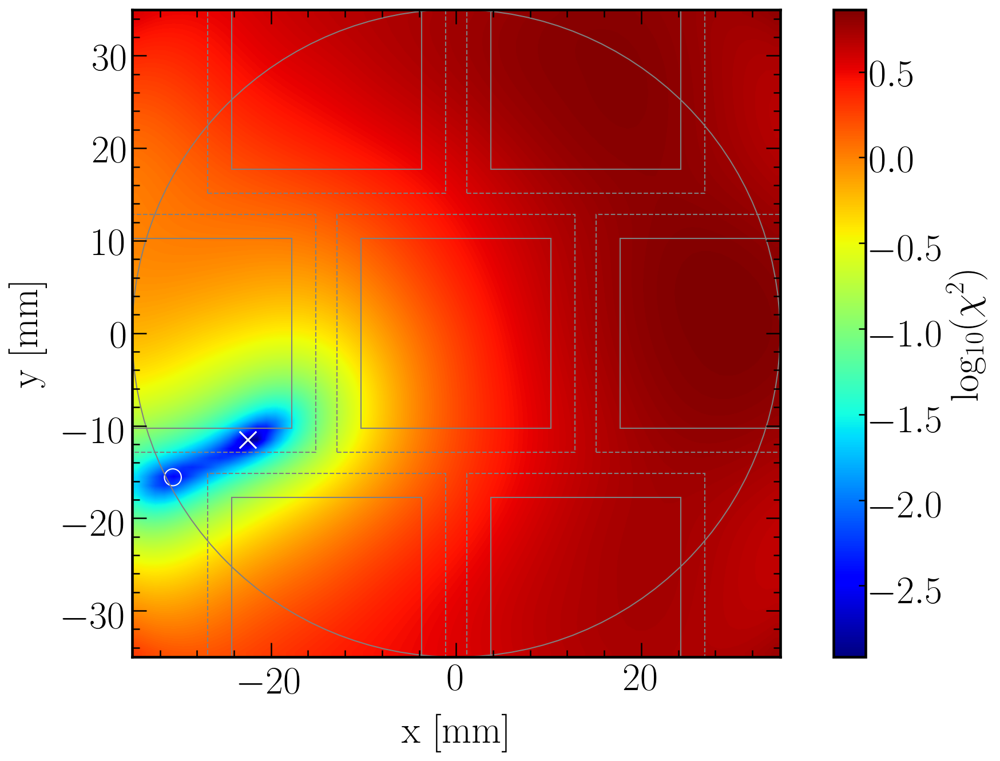

In [82]:
i = 1

#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
if minimizer == 'ChiSquared':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
elif minimizer == 'LogLikelihoodRatio':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
elif minimizer == 'WeightedChiSquared':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
else:
    im = plt.imshow(q_2dArray, origin='low', extent=extent, cmap = 'jet')
im.set_interpolation('bilinear')    
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
if minimizer == 'ChiSquared':
    cbar.set_label(label = 'log$_{10}(\chi^{2})$', fontsize=label_size)
elif minimizer == 'LogLikelihoodRatio':
    cbar.set_label(label = 'log$_{10}(-2[\ln \mathcal{L} - \ln \mathcal{L}_0])$', fontsize=label_size)
elif minimizer == 'WeightedChiSquared':
    cbar.set_label(label = 'log$_{10}(\chi^{2}_{weighted})$', fontsize=label_size)
else:
    cbar.set_label(label = 'q', fontsize=label_size)
#plt.clim(0.0, 1.0)

plt.scatter(position_x_real, position_y_real, marker = "x", color = 'white', s = 200, label = 'Real position')  
plt.scatter(reconstructed(HFs_measured, eval("fit_parameters_"+modelstring)).x[0], reconstructed(HFs_measured, eval("fit_parameters_"+modelstring)).x[1], marker = "o", color = 'white', s = 200, facecolors='none', label = 'Reconstructed position') 
currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
currentAxis.add_artist(circle)

# Legend
'''leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)'''

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_"+str(position_x_real)+'_'+str(position_y_real)+'_'+modelstring_save+".png", bbox_inches = "tight")

In [83]:
X_reconstructed = np.zeros_like(X)
Y_reconstructed = np.zeros_like(Y)

for j_y in range(0, q_2dArray.shape[1]):
    print(str(round(j_y/q_2dArray.shape[1]*100, 1))+'%', end=' ')
    for j_x in range(0, q_2dArray.shape[0]):
        if f_polar_R(X[j_y][j_x], Y[j_y][j_x]) < 35:
            X_reconstructed[j_y][j_x] = reconstructed(np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][j_y][j_x] for j in range(1,8)]), eval("fit_parameters_"+modelstring)).x[0]
            Y_reconstructed[j_y][j_x] = reconstructed(np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][j_y][j_x] for j in range(1,8)]), eval("fit_parameters_"+modelstring)).x[1]
        else:
            X_reconstructed[j_y][j_x] = None
            Y_reconstructed[j_y][j_x] = None
            
print('100.0%', end=' ')

#np.savetxt(filenameprefix+"_Xreconstructed_"+modelstring_save+".csv", X_reconstructed, delimiter=",")
#np.savetxt(filenameprefix+"_Yreconstructed_"+modelstring_save+".csv", Y_reconstructed, delimiter=",")
Reconstructed_Positions = pd.DataFrame({'X_position' : [X, X_reconstructed], 'Y_position' : [Y, Y_reconstructed]}, index=['true', 'reconstructed'])
Reconstructed_Positions.to_pickle(filenameprefix+"_Reconstructed_Positions_"+modelstring_save+".pkl")
print('\n')
print(filenameprefix+"_Reconstructed_Positions_"+modelstring_save+".pkl")

0.0% 1.4% 2.9% 4.3% 5.7% 7.1% 8.6% 10.0% 11.4% 12.9% 14.3% 15.7% 17.1% 18.6% 20.0% 21.4% 22.9% 24.3% 25.7% 27.1% 28.6% 30.0% 

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: divide by zero encountered in true_divide


31.4% 32.9% 34.3% 35.7% 37.1% 38.6% 40.0% 41.4% 42.9% 44.3% 45.7% 47.1% 48.6% 50.0% 51.4% 52.9% 54.3% 55.7% 57.1% 58.6% 60.0% 61.4% 62.9% 64.3% 65.7% 67.1% 68.6% 70.0% 71.4% 72.9% 74.3% 75.7% 77.1% 78.6% 80.0% 81.4% 82.9% 84.3% 85.7% 87.1% 88.6% 90.0% 91.4% 92.9% 94.3% 95.7% 97.1% 98.6% 100.0% 

optPhot_S2_1.0e+06_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_nop_1.0e+04_Reconstructed_Positions_eta_v2_overSum_Chi2_normalization_to_sum_True.pkl


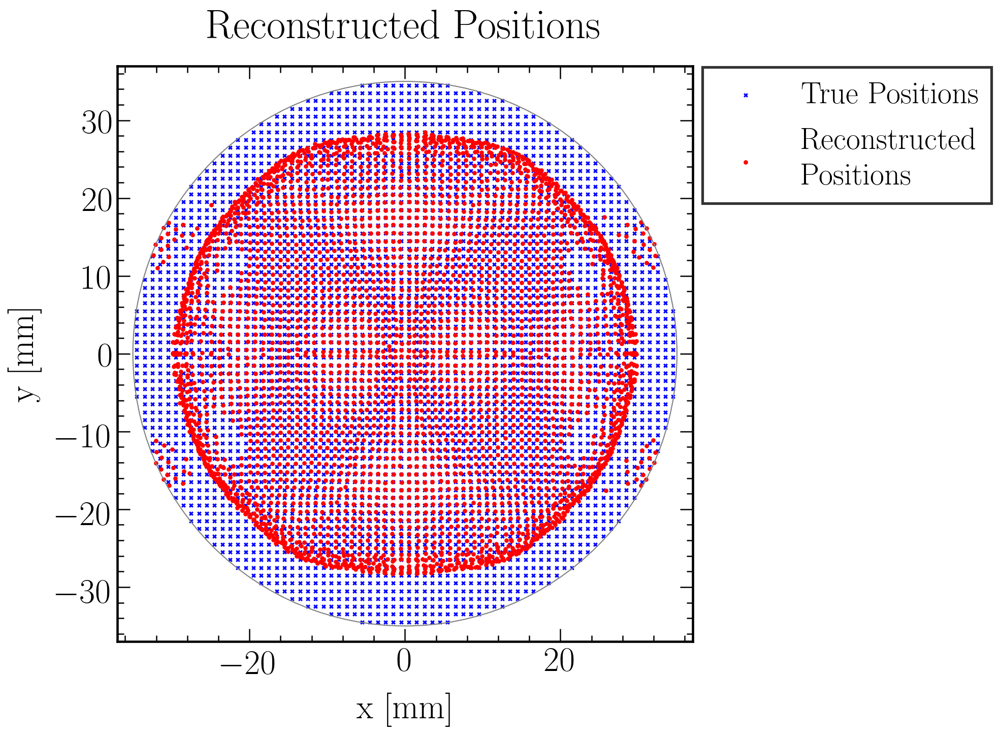

In [84]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(X[f_polar_R(X, Y) < 35], Y[f_polar_R(X, Y) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_"+modelstring_save+".png", bbox_inches = "tight")

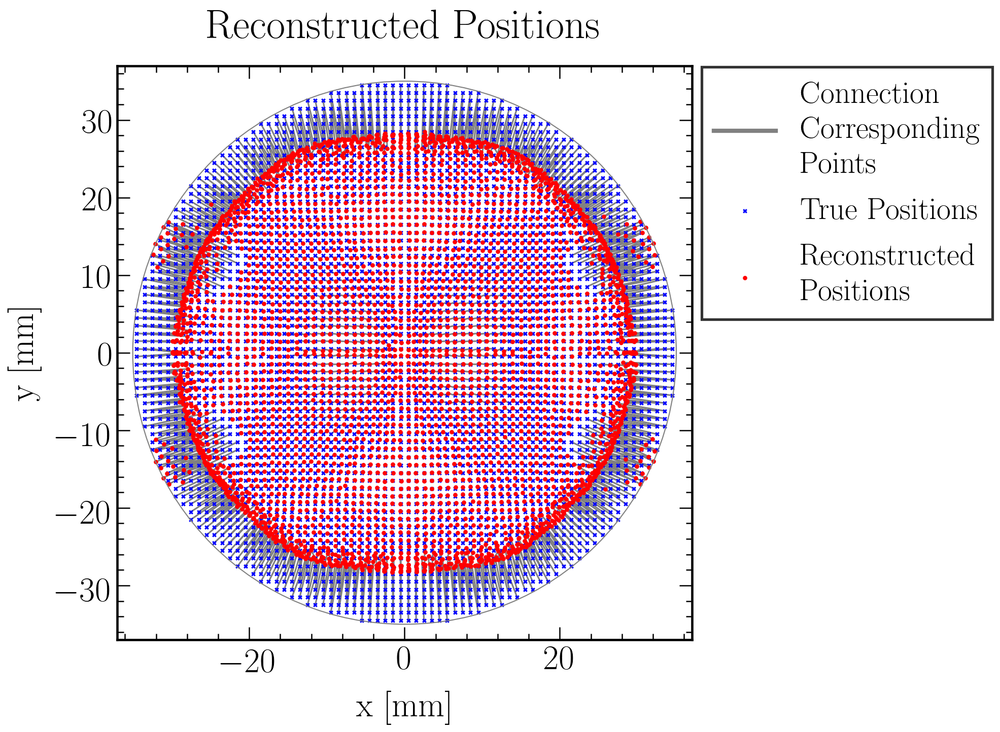

In [85]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][0], X_reconstructed[f_polar_R(X, Y) < 35][0]],[Y[f_polar_R(X, Y) < 35][0], Y_reconstructed[f_polar_R(X, Y) < 35][0]], 'grey', label = 'Connection\nCorresponding\nPoints', zorder=0)
for i in range(1, len(X[f_polar_R(X, Y) < 35])):
    plt.plot([X[f_polar_R(X, Y) < 35][i], X_reconstructed[f_polar_R(X, Y) < 35][i]],[Y[f_polar_R(X, Y) < 35][i], Y_reconstructed[f_polar_R(X, Y) < 35][i]], 'grey', zorder=0)

# Data plot
plt.scatter(X[f_polar_R(X, Y) < 35], Y[f_polar_R(X, Y) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnected_"+modelstring_save+".png", bbox_inches = "tight")

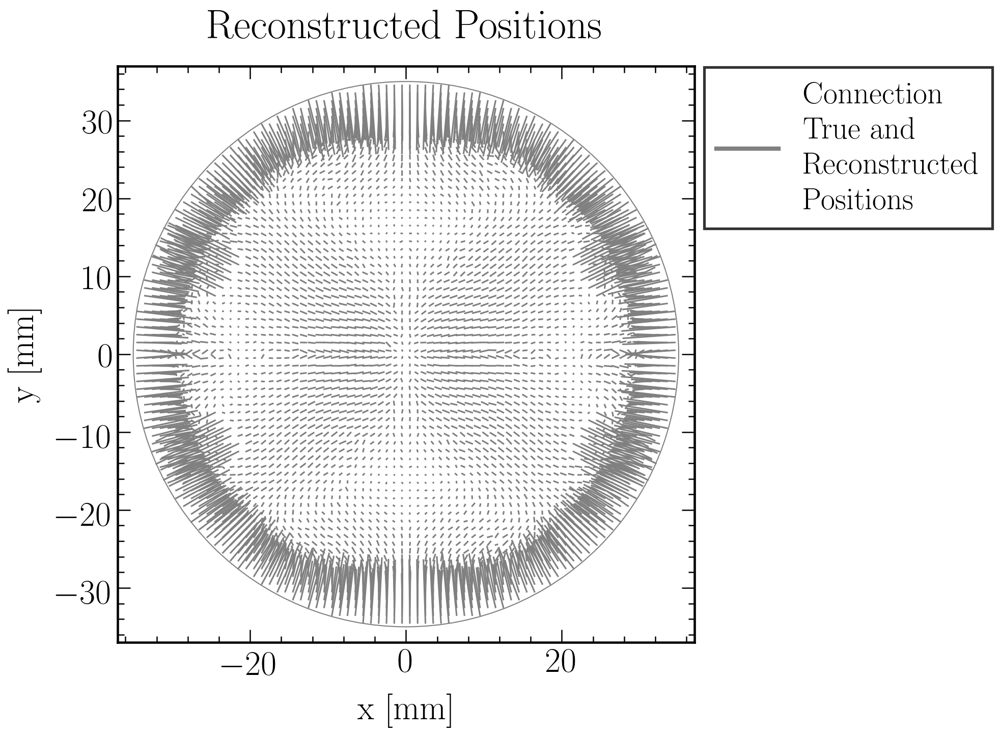

In [86]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][0], X_reconstructed[f_polar_R(X, Y) < 35][0]],[Y[f_polar_R(X, Y) < 35][0], Y_reconstructed[f_polar_R(X, Y) < 35][0]], 'grey', label = 'Connection\nTrue and\nReconstructed\nPositions')
for i in range(1, len(X[f_polar_R(X, Y) < 35])):
    plt.plot([X[f_polar_R(X, Y) < 35][i], X_reconstructed[f_polar_R(X, Y) < 35][i]],[Y[f_polar_R(X, Y) < 35][i], Y_reconstructed[f_polar_R(X, Y) < 35][i]], 'grey')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnections_"+modelstring_save+".png", bbox_inches = "tight")

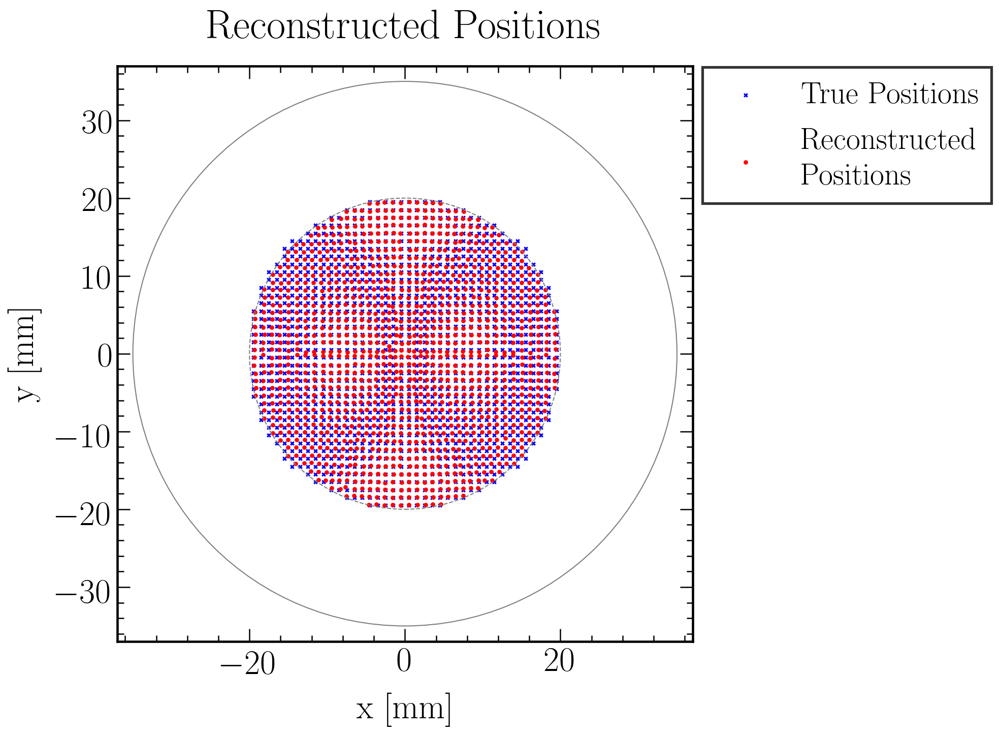

In [87]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
cnf = 20 #25
plt.scatter(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
circle2 = plt.Circle((0., 0.), cnf, color='gray', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConfined"+str(cnf)+"_"+modelstring_save+".png", bbox_inches = "tight")

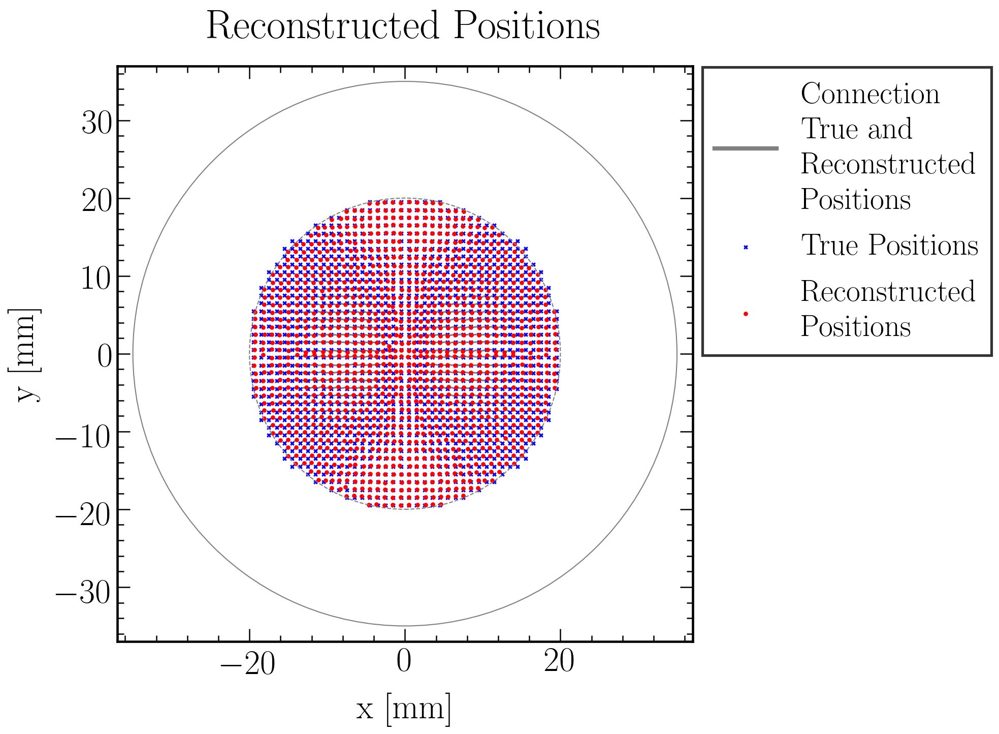

In [88]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0], X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0]],[Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0]], 'grey', label = 'Connection\nTrue and\nReconstructed\nPositions', zorder=0)
for i in range(1, len(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])):
    plt.plot([X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i], X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i]],[Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i]], 'grey', zorder=0)

# Data plot
cnf = 20 #20
plt.scatter(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
circle2 = plt.Circle((0., 0.), cnf, color='gray', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConfinedConnected"+str(cnf)+"_"+modelstring_save+".png", bbox_inches = "tight")

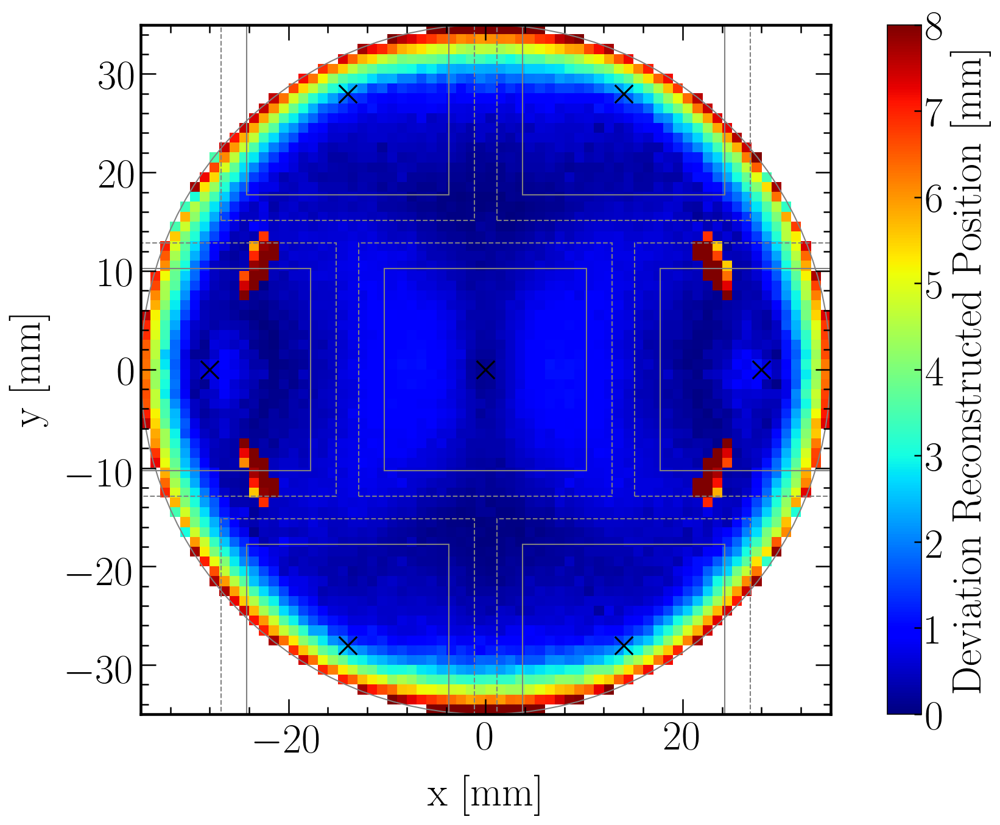

In [89]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(f_polar_R(X_reconstructed - X, Y_reconstructed - Y), interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Deviation Reconstructed Position [mm]', fontsize=label_size)
plt.clim(0, 8)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_Deviations_"+modelstring_save+".png", bbox_inches = "tight")

In [90]:
fid_list = np.array([np.inf, 35, 30, 25, 20, 15])
fid_list

array([inf, 35., 30., 25., 20., 15.])

inf
sigma_x = 1.8179119770988934 mm
sigma_y = 1.8042416653131224 mm


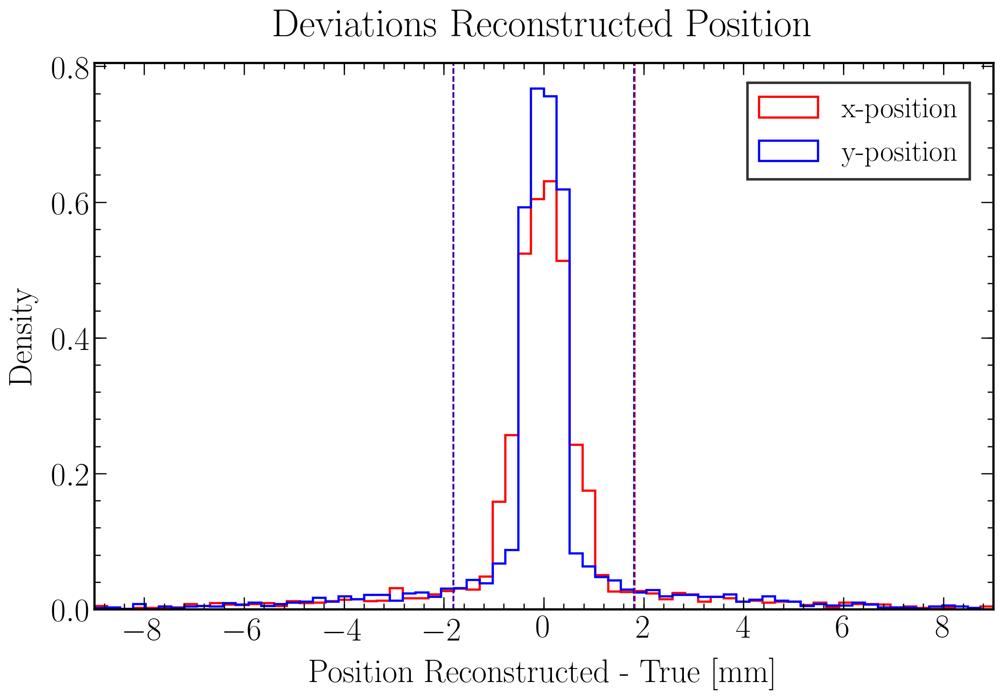

35.0
sigma_x = 1.7668564259241784 mm
sigma_y = 1.7938683930960864 mm


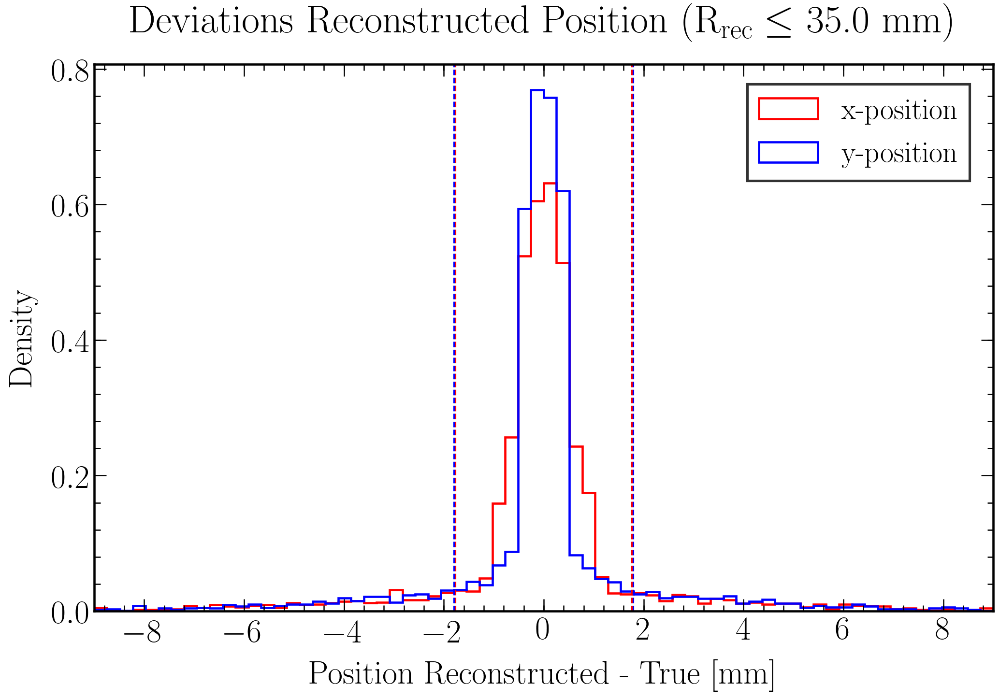

30.0
sigma_x = 1.5523413842168652 mm
sigma_y = 1.756245640921417 mm


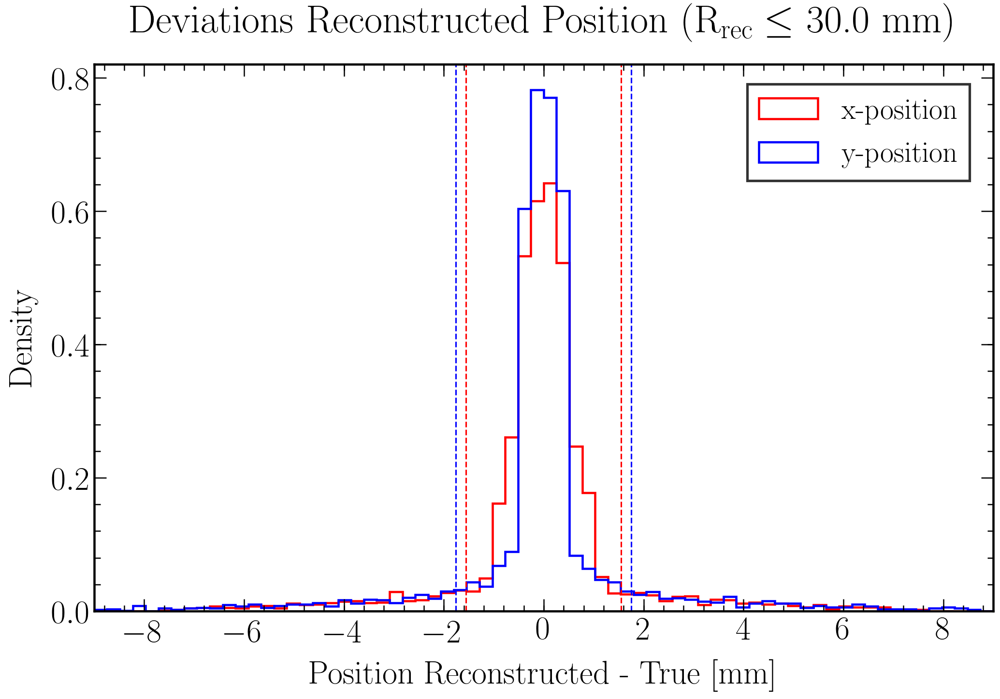

25.0
sigma_x = 0.4875637490307285 mm
sigma_y = 0.2553770061523197 mm


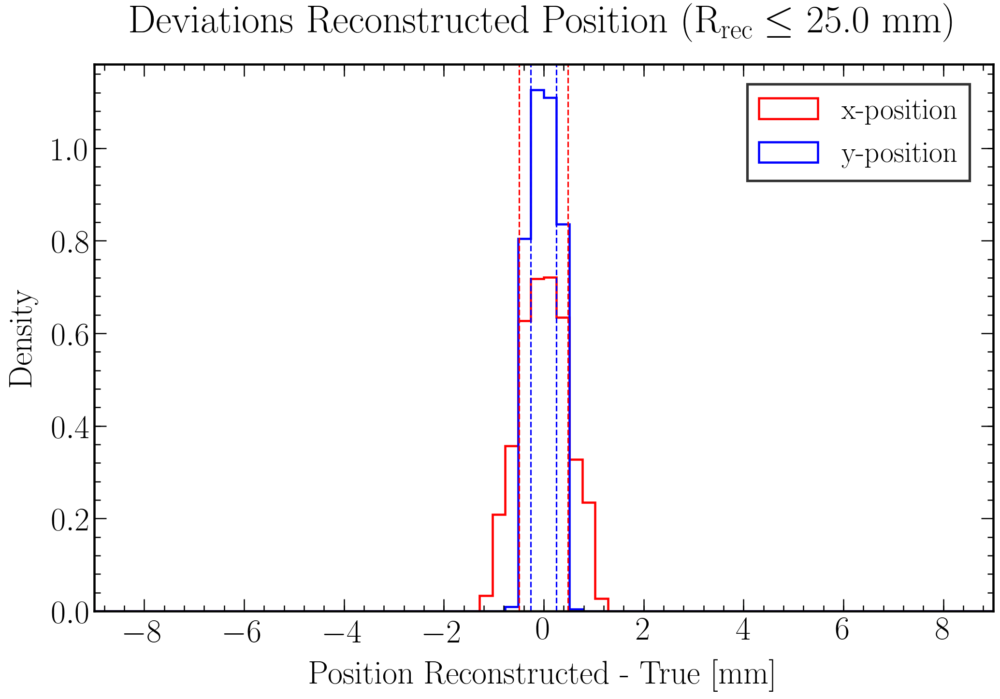

20.0
sigma_x = 0.5622108783051475 mm
sigma_y = 0.25277917660969335 mm


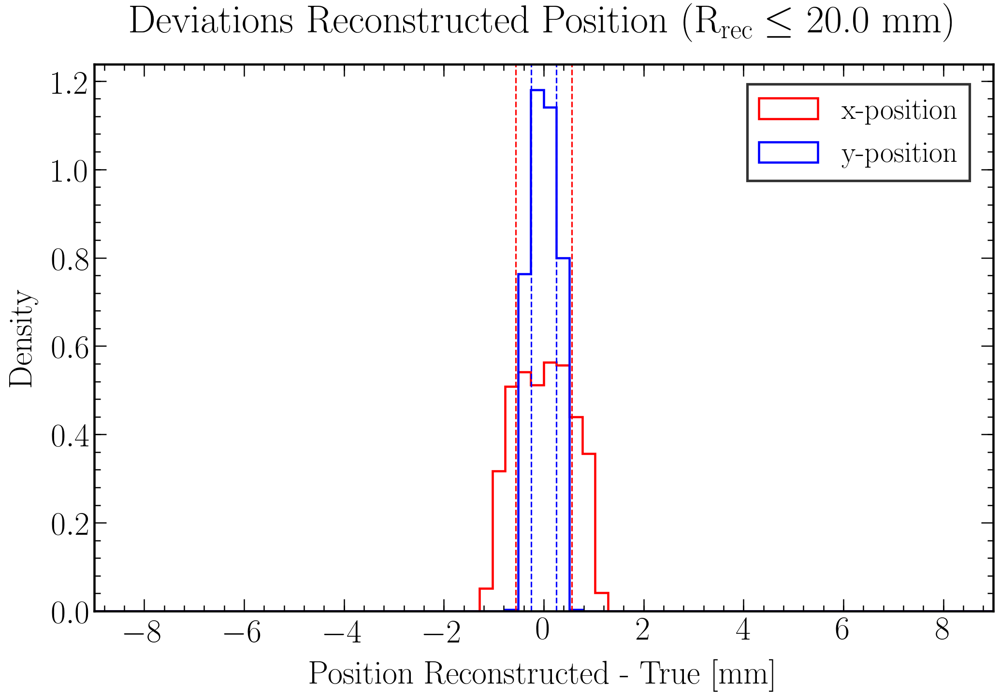

15.0
sigma_x = 0.6653810924565439 mm
sigma_y = 0.24986122026080068 mm


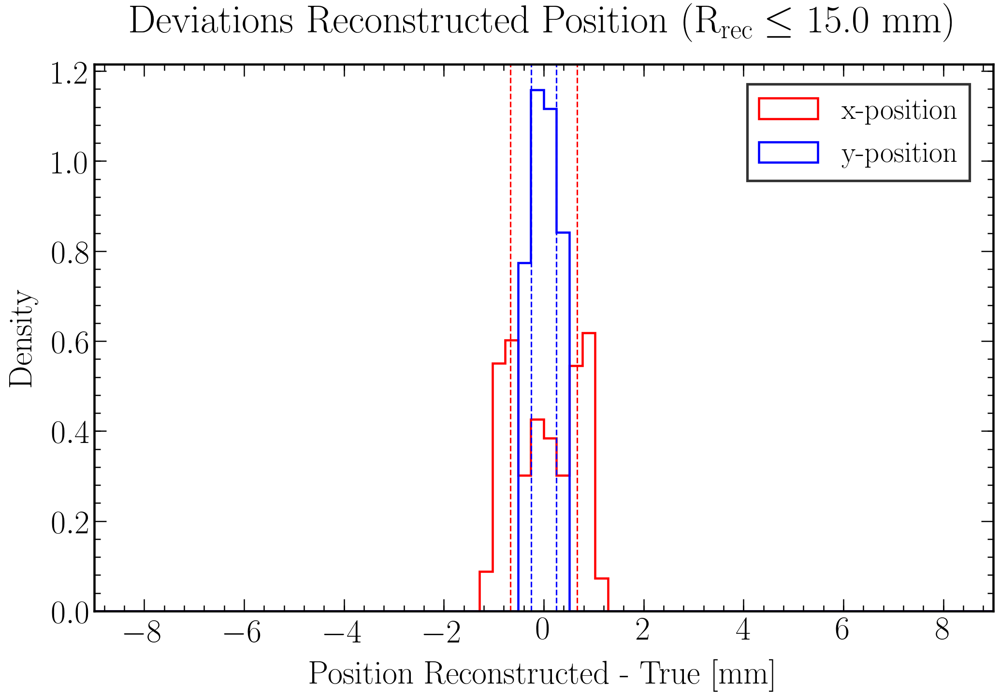

In [91]:
for fid in fid_list:
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    # Grid
    #plt.grid(True)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    fid = fid
    print(fid)

    rng = (-9, 9)
    delta_x_list = ((X_reconstructed - X)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) <= fid]
    delta_y_list = ((Y_reconstructed - Y)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) <= fid]
    plt.hist(delta_x_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
    plt.hist(delta_y_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

    plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
    if fid > 35:
        plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)
    else:
        plt.title('Deviations Reconstructed Position ($\mathrm{R}_{\mathrm{rec}} \leq$ '+str(fid)+' mm)', fontsize = title_size, pad = title_pad)

    plt.xlim(-9,9)

    sigma_x = np.sqrt(np.var(delta_x_list))
    sigma_y = np.sqrt(np.var(delta_y_list))
    plt.axvline(x=sigma_x, color='red', linestyle='dashed')
    plt.axvline(x=-sigma_x, color='red', linestyle='dashed')
    print('sigma_x = '+str(sigma_x)+' mm')
    plt.axvline(x=sigma_y, color='blue', linestyle='dashed')
    plt.axvline(x=-sigma_y, color='blue', linestyle='dashed')
    print('sigma_y = '+str(sigma_y)+' mm')

    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistConfined"+str(fid)+"_"+modelstring_save+".png", bbox_inches = "tight")
    plt.show()

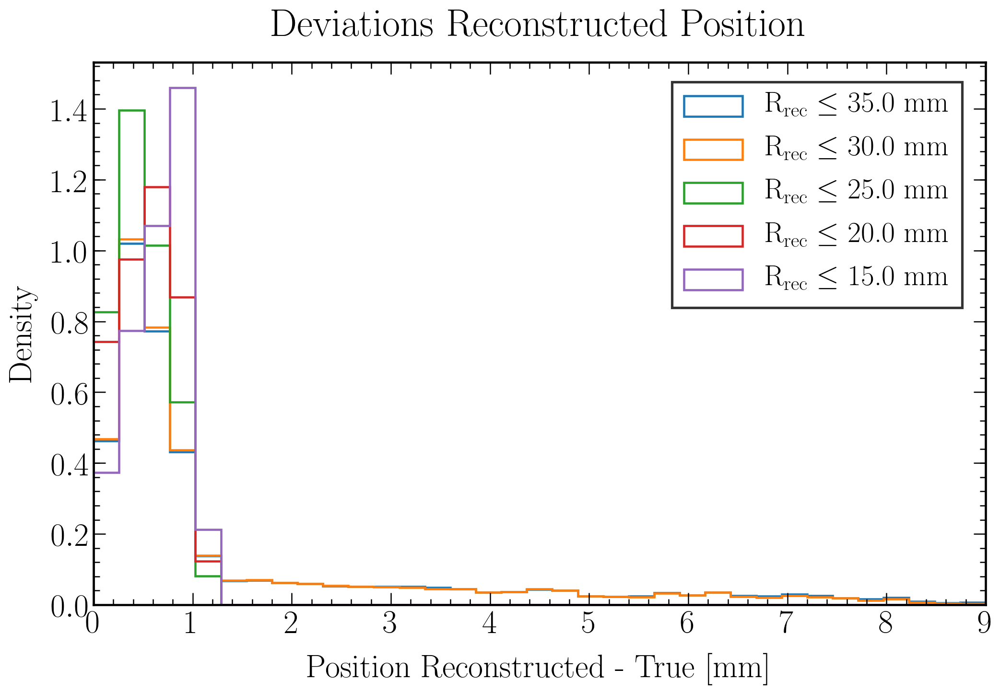

,fid,sigma_x,sigma_y,delta_mean,delta_68.27_percentile,delta_95_percentile,delta_95.45_percentile,delta_99.73_percentile
0,35.0,1.766856,1.793868,1.539253,1.006790,6.447181,6.638841,9.543778
1,30.0,1.552341,1.756246,1.444039,0.963179,6.121466,6.239361,8.282874
2,25.0,0.487564,0.255377,0.484918,0.602666,0.945967,0.951279,1.109471
3,20.0,0.562211,0.252779,0.548215,0.723923,0.976929,0.993658,1.117694
4,15.0,0.665381,0.249861,0.657239,0.833975,1.031828,1.034261,1.121524


In [92]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.xlim(0,9)
rng = (0, 9)

ReconstructedPosition_Deviations = pd.DataFrame(data={'fid': [], 'sigma_x': [], 'sigma_y': [], 'delta_mean': [], 'delta_68.27_percentile': [], 'delta_95_percentile': [], 'delta_95.45_percentile': [], 'delta_99.73_percentile': []})

for fid in fid_list[1:]:
    delta_x_list = ((X_reconstructed - X)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) <= fid]
    delta_y_list = ((Y_reconstructed - Y)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) <= fid]
    sigma_x = np.sqrt(np.var(delta_x_list))
    sigma_y = np.sqrt(np.var(delta_y_list))
    delta_list = np.sqrt(delta_x_list**2 + delta_y_list**2)
    plt.hist(delta_list, bins = round(numberbins/2), density=True, range=rng, histtype = 'step', linewidth = 2.2, label = '$\mathrm{R}_{\mathrm{rec}} \leq$ '+str(fid)+' mm')
    ReconstructedPosition_Deviations = ReconstructedPosition_Deviations.append(pd.DataFrame(data={
        'fid': [fid], 'sigma_x': [sigma_x], 'sigma_y': [sigma_y], 'delta_mean': [delta_list.mean()], 
        'delta_68.27_percentile': [np.percentile(delta_list, 68.27)], 
        'delta_95_percentile': [np.percentile(delta_list, 95)], 
        'delta_95.45_percentile': [np.percentile(delta_list, 95.45)], 
        'delta_99.73_percentile': [np.percentile(delta_list, 99.73)]}), ignore_index=True)
    
plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistR_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

ReconstructedPosition_Deviations.to_pickle(filenameprefix+"_ReconstructedPosition_Deviations_"+modelstring_save+".pkl")
ReconstructedPosition_Deviations

In [93]:
for cnf in [35, 40 , 45, 50]:
    print(model(cnf, *eval("fit_parameters_"+modelstring)[1-1]))
    
print('')
    
for cnf in [35, 40 , 45, 50]:
    print(model(cnf, *eval("fit_parameters_"+modelstring)[2-1]))

0.06004658846453015
0.045454277771578275
0.037010978353736845
0.031978148434468

0.06699140728613859
0.05147003153045148
0.0425383128641358
0.037264306670389505


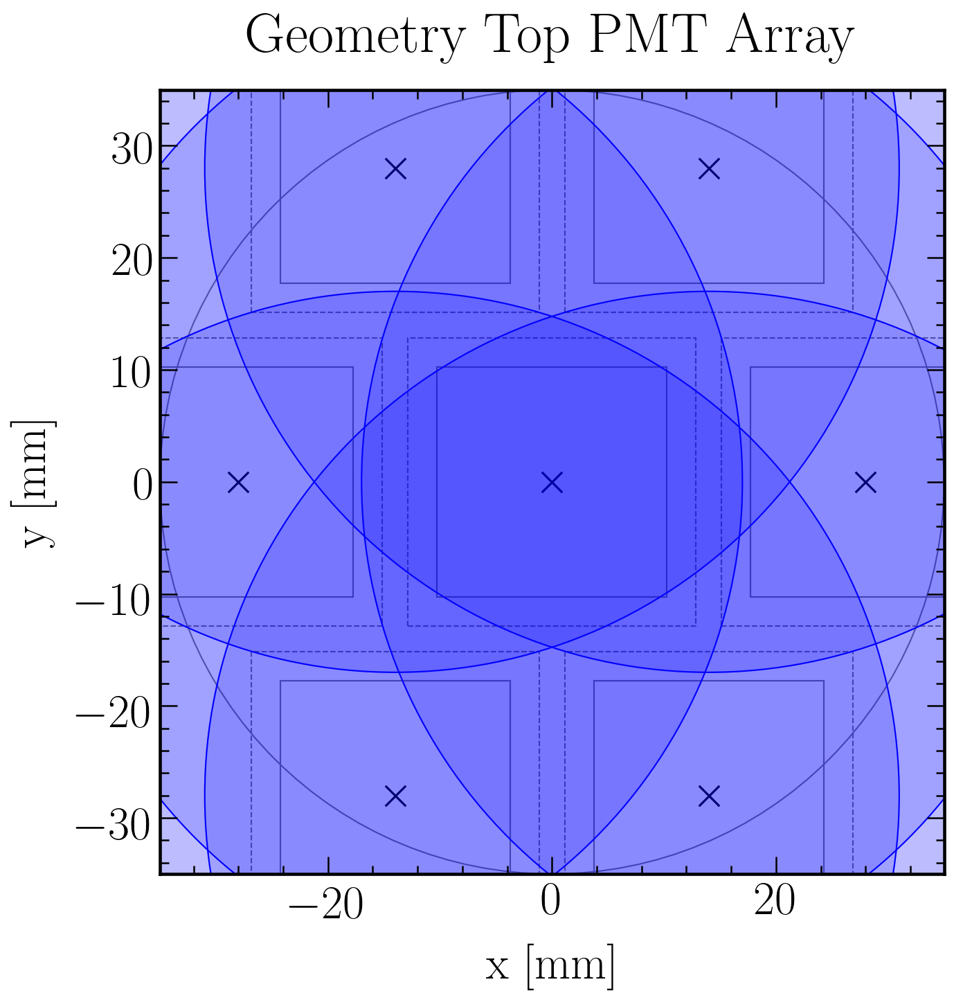

In [94]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Geometry Top PMT Array', fontsize = title_size, pad = title_pad)

plt.xlim(-35,35)
plt.ylim(-35,35)
plt.gca().set_aspect('equal', adjustable='box')

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

'''
cnf0 = 20

pos_x = 0
pos_y = 0
color = 'k'
circle = plt.Circle((pos_x, pos_y), cnf0, color=color, linestyle = '--', fill=False)
plt.scatter(pos_x, pos_y, marker = "x", color = color, s = 100)
currentAxis.add_artist(circle)
'''

cnf = 45 # min 35
c = 'blue'

#color=iter(cm.rainbow(np.linspace(0,1,7)))
for i in range(1,8):
    #c=next(color)
    circle = plt.Circle((PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i]), cnf, linestyle = '-', alpha = 1/7, color = c)
    currentAxis.add_artist(circle)
    
#color=iter(cm.rainbow(np.linspace(0,1,7)))
for i in range(1,8):
    #c=next(color)
    circle = plt.Circle((PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i]), cnf, linestyle = '-', fill = False, color = c)
    currentAxis.add_artist(circle)

plt.show()

### Iterative reconstruciton

In [95]:
print(np.sqrt(2)*(R8520_photocathode_width-2*R8520_photocathode_cornerradius)/2+R8520_photocathode_cornerradius)
print(np.sqrt(2)*(R8520_photocathode_width)/2)

14.08147545195113
14.495689014324226


In [96]:
#### General settings

## Maximum number of iterations
iterations = 5

## Fiducial radial cuts in mm
rfiducial = 20          # fiducial cut on radial position in TPC, default: 20
rfiducial_under = 15    # fiducial cut on radial distance from center individual PMT, default: 15

## Fiducial radial cut central PMT in mm 
rfiducial_central = 32  # fiducial cut on radial position in TPC, default: 34 / 30

## Fiducial radial cut 0th iteration in mm
rfiducial0 = 34         # default: 34
rfiducial0_under = -1   # default: -1, set to -1 to make inactive
rfiducial0_central = 34 # default: 34

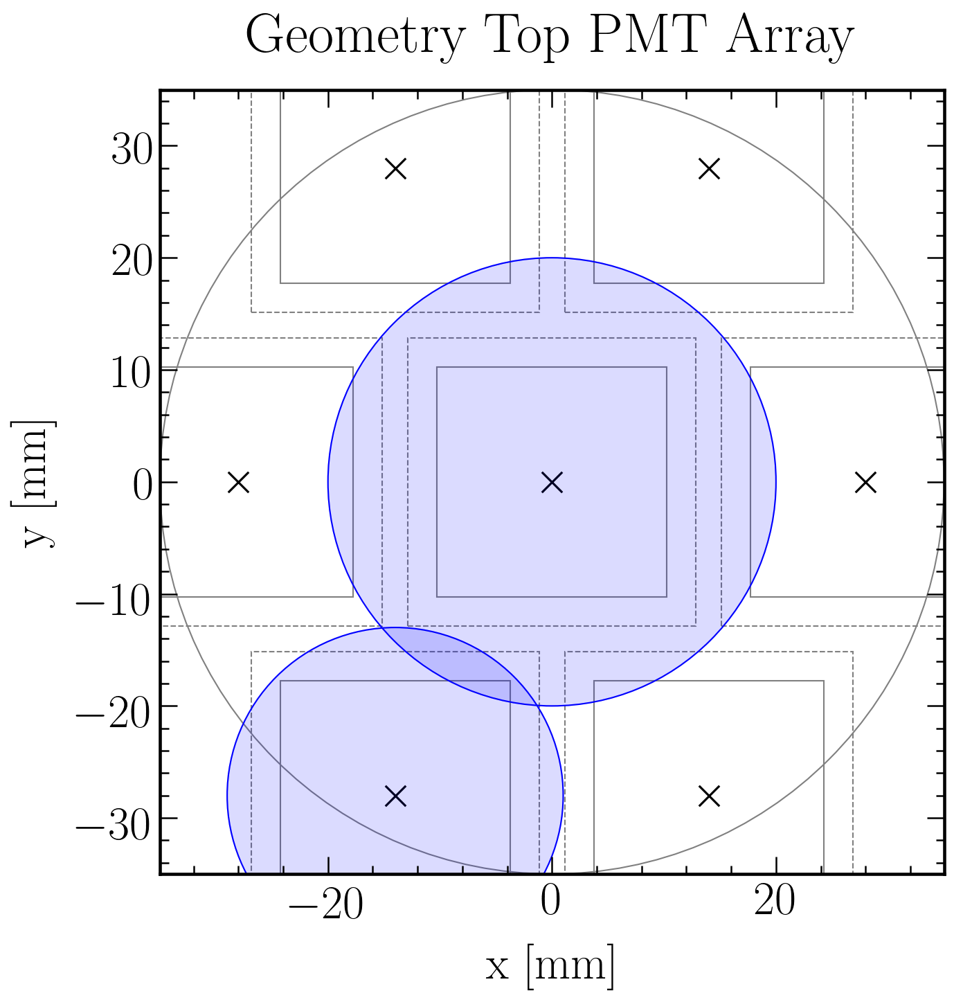

In [97]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Geometry Top PMT Array', fontsize = title_size, pad = title_pad)

plt.xlim(-35,35)
plt.ylim(-35,35)
plt.gca().set_aspect('equal', adjustable='box')

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

cnf = rfiducial_under # min 35
c = 'blue'
if cnf > 0:
    circle = plt.Circle((PMT_positions['PMT_position_x'][1], PMT_positions['PMT_position_y'][1]), cnf, linestyle = '-', alpha = 1/7, color = c)
    currentAxis.add_artist(circle)
    circle = plt.Circle((PMT_positions['PMT_position_x'][1], PMT_positions['PMT_position_y'][1]), cnf, linestyle = '-', fill = False, color = c)
    currentAxis.add_artist(circle)

cnf = rfiducial # min 35
c = 'blue'
if cnf > 0:
    circle = plt.Circle((PMT_positions['PMT_position_x'][7], PMT_positions['PMT_position_y'][7]), cnf, linestyle = '-', alpha = 1/7, color = c)
    currentAxis.add_artist(circle)
    circle = plt.Circle((PMT_positions['PMT_position_x'][7], PMT_positions['PMT_position_y'][7]), cnf, linestyle = '-', fill = False, color = c)
    currentAxis.add_artist(circle)

plt.show()

In [98]:
#### Prepare empty pandas data frame for outputs from iterative fitting

## Indices
## 0 = fitted as below starting from exact positions
## >= 1 = fitted with positions reconstructed in iteration before
ind = [str(i) for i in range(0,iterations +1)]

## Data frame
d = {'rfiducial': [None]*len(ind), 'rfiducial_under': [None]*len(ind), 'rfiducial_central': [None]*len(ind), 'HF': [None]*len(ind), 'HF_binned': [None]*len(ind), 'x_pos': [None]*len(ind), 'y_pos': [None]*len(ind), 'R_pos': [None]*len(ind), 'r_pos': [[None]*7]*len(ind), 'r_pos_binned': [[None]*7]*len(ind), 'fit_parameter': [[None]*7]*len(ind)}
Iterative_Reconstruciton = pd.DataFrame(data=d, index = ind)

## Fill generalities
Iterative_Reconstruciton['rfiducial'] = [rfiducial0]+[rfiducial]*iterations
Iterative_Reconstruciton['rfiducial_under'] = [rfiducial0_under]+[rfiducial_under]*iterations
Iterative_Reconstruciton['rfiducial_central'] = [rfiducial0_central]+[rfiducial_central]*iterations

In [99]:
## Hits fractions
## Import hist2d data, flatten and remove nans

HF_list_full = np.array([flatten_tuples(HF_x_y_hist2d_perPMT['histT'].loc[i]) for i in range(1,8)])

HF_list_intermediate = np.array([None]*HF_list_full.shape[0])
for i in range(0,HF_list_intermediate.shape[0]):
    HF_list_intermediate[i] = np.array(HF_list_full[i][~np.isnan(HF_list_full[i])])

Iterative_Reconstruciton['HF'] = [HF_list_intermediate]*len(ind)

In [100]:
## Real positions = positions in iteration 0
## Import hist2d data, flatten and remove nans

x_pos_list_full = np.array(flatten_tuples(Reconstructed_Positions['X_position'].loc['true']))
y_pos_list_full = np.array(flatten_tuples(Reconstructed_Positions['Y_position'].loc['true']))

x_pos_list_intermediate = x_pos_list_full[~np.isnan(HF_list_full[0])]
y_pos_list_intermediate = y_pos_list_full[~np.isnan(HF_list_full[0])]

iteration = '0'
Iterative_Reconstruciton.at[iteration, 'x_pos'] = x_pos_list_intermediate
Iterative_Reconstruciton.at[iteration, 'y_pos'] = y_pos_list_intermediate

In [101]:
## Cut corner bins with center outside inside_TPC

inside_TPC = 35

x_pos_list = x_pos_list_intermediate[f_polar_R(x_pos_list_intermediate, y_pos_list_intermediate)<inside_TPC]
y_pos_list = y_pos_list_intermediate[f_polar_R(x_pos_list_intermediate, y_pos_list_intermediate)<inside_TPC]

HF_list = np.array([None]*HF_list_intermediate.shape[0])
for i in range(0,HF_list.shape[0]):
    HF_list[i] = HF_list_intermediate[i][f_polar_R(x_pos_list_intermediate, y_pos_list_intermediate)<inside_TPC]

iteration = '0'
Iterative_Reconstruciton.at[iteration, 'x_pos'] = x_pos_list
Iterative_Reconstruciton.at[iteration, 'y_pos'] = y_pos_list
Iterative_Reconstruciton['HF'] = [HF_list]*len(ind)

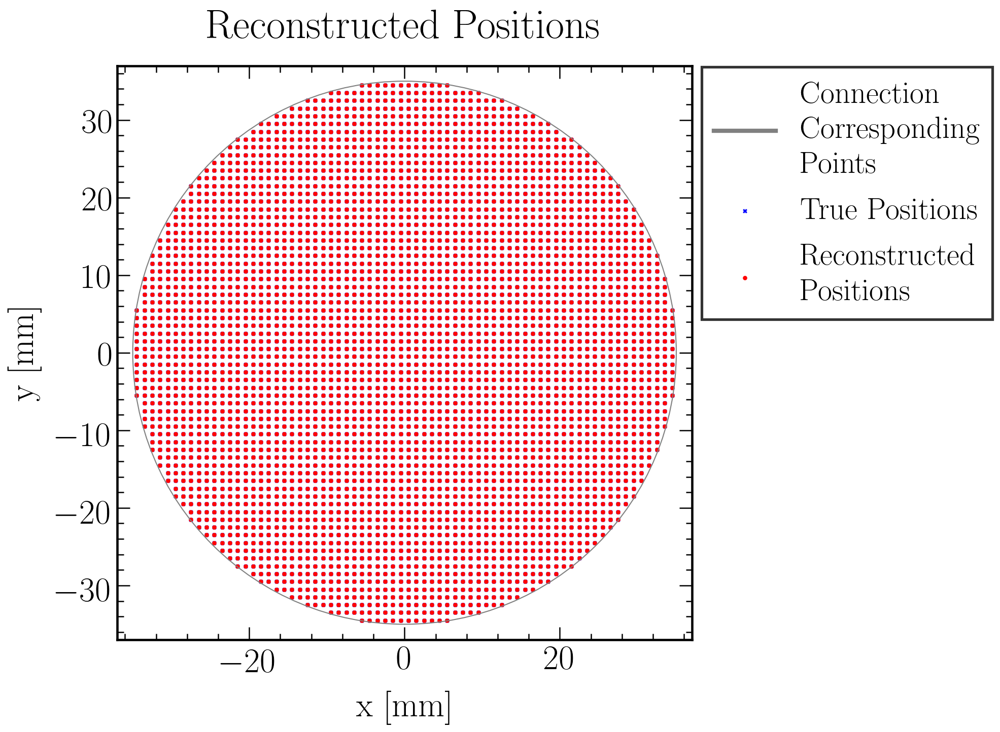

'optPhot_S2_1.0e+06_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_nop_1.0e+04_ReconstructedPositionConnected__Iterative_Reconstruciton_iteration_0_rfiducial_34_rfiducial_under_-1_eta_v2_overSum_Chi2_normalization_to_sum_True.png'

In [102]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([Iterative_Reconstruciton['x_pos'][0][0], x_pos_list[0]],[Iterative_Reconstruciton['y_pos'][0][0], y_pos_list[0]], 'grey', label = 'Connection\nCorresponding\nPoints', zorder=0)
for i in range(1, len(X[f_polar_R(X, Y) < 35])):
    plt.plot([Iterative_Reconstruciton['x_pos'][0][i], x_pos_list[i]],[Iterative_Reconstruciton['y_pos'][0][i], y_pos_list[i]], 'grey', zorder=0)

# Data plot
plt.scatter(Iterative_Reconstruciton['x_pos'][0], Iterative_Reconstruciton['y_pos'][0], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(x_pos_list, y_pos_list, color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnected_"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
filenameprefix+"_ReconstructedPositionConnected_"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png"

/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in power
  if __name__ == '__main__':


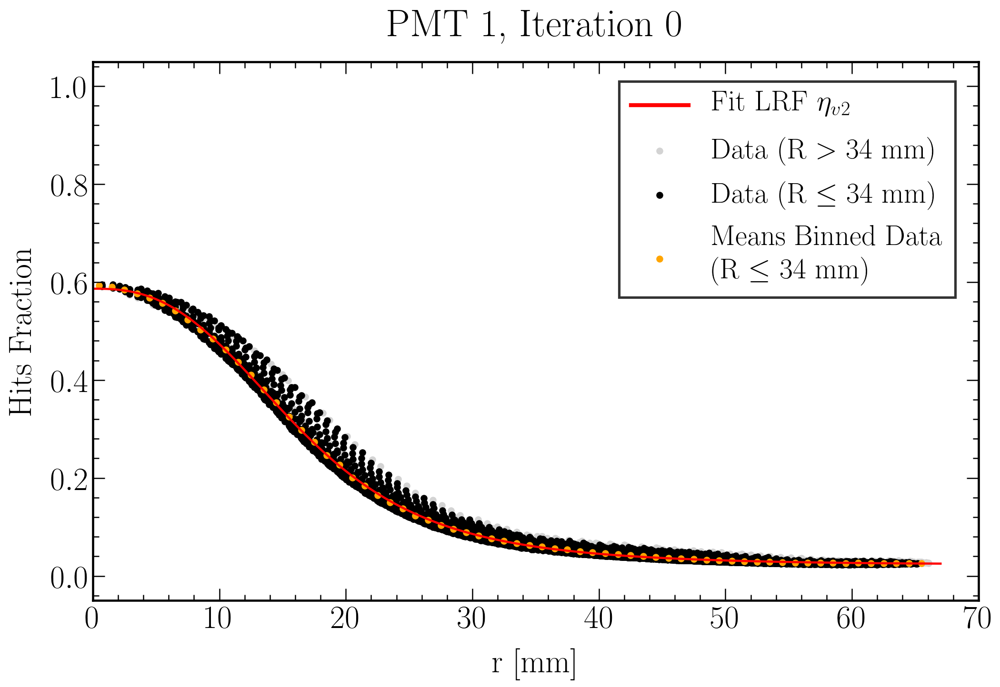

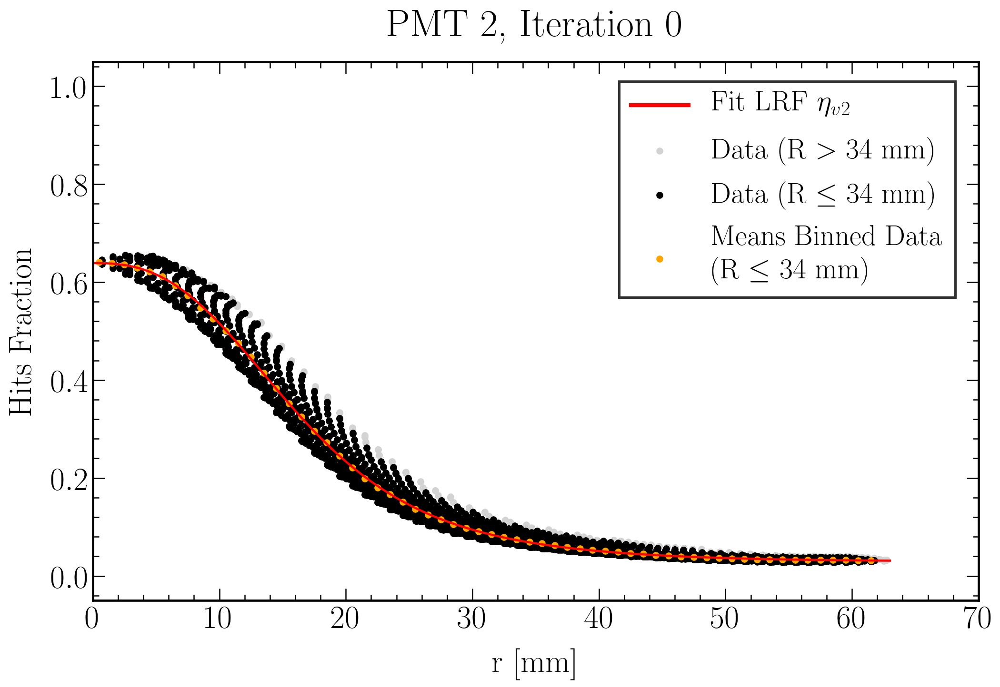

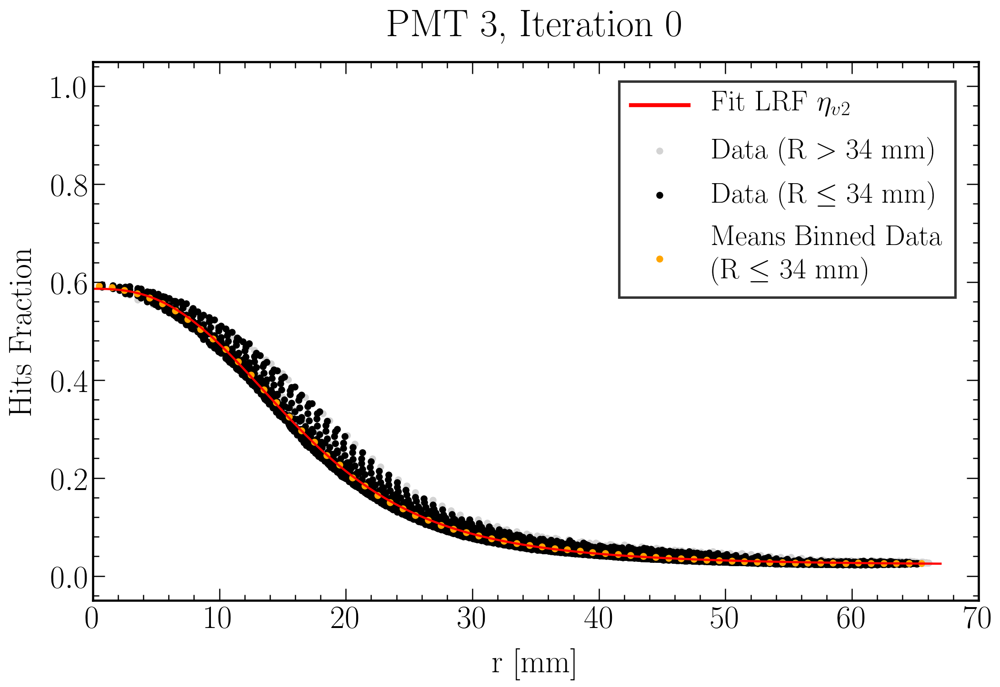

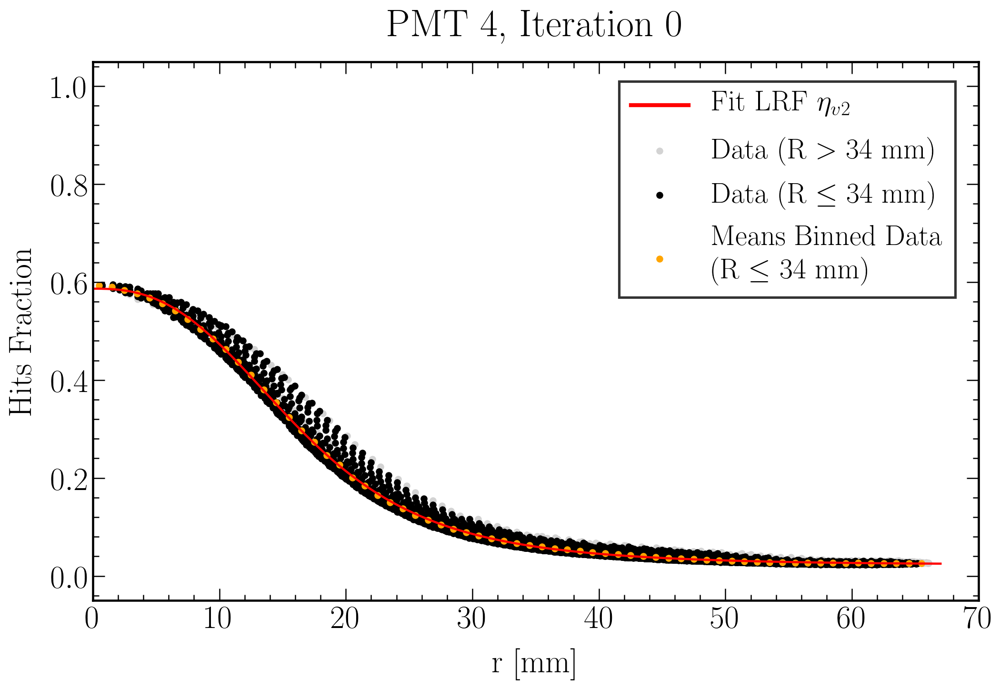

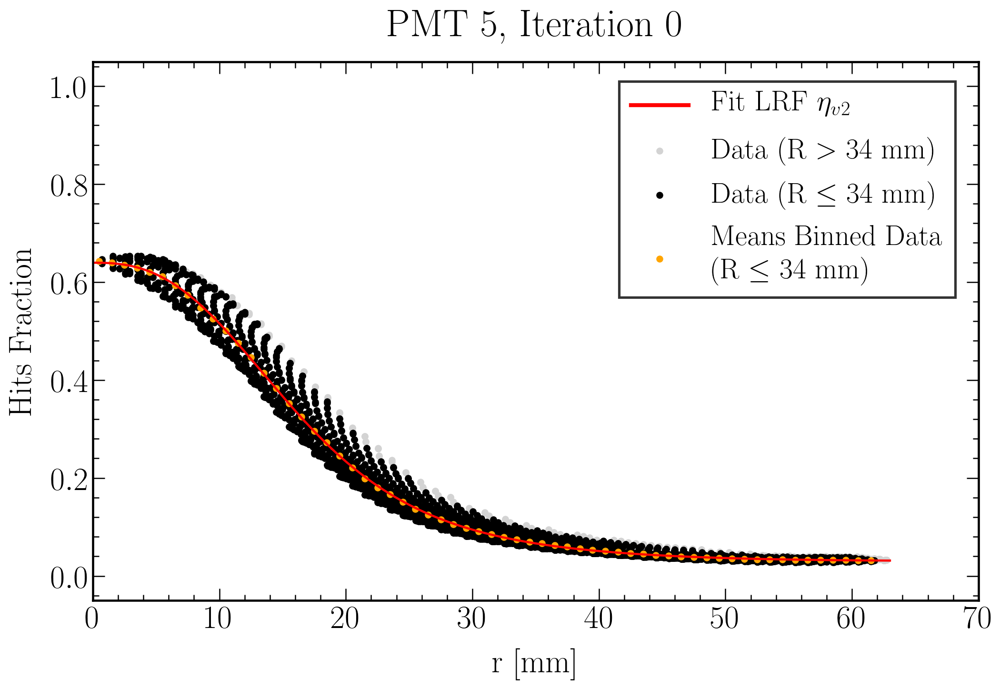

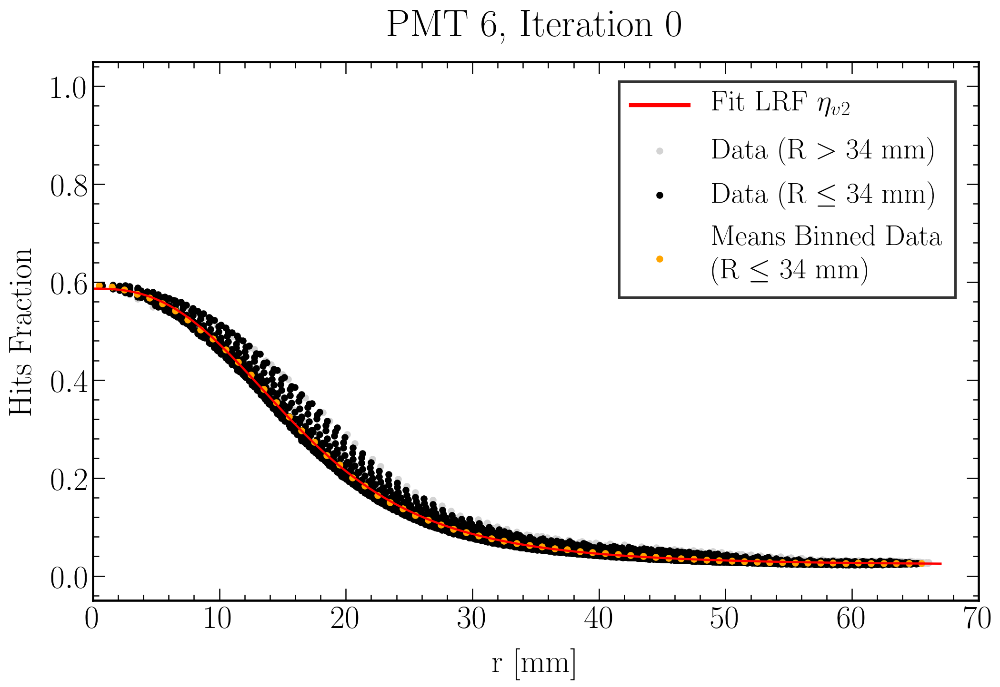

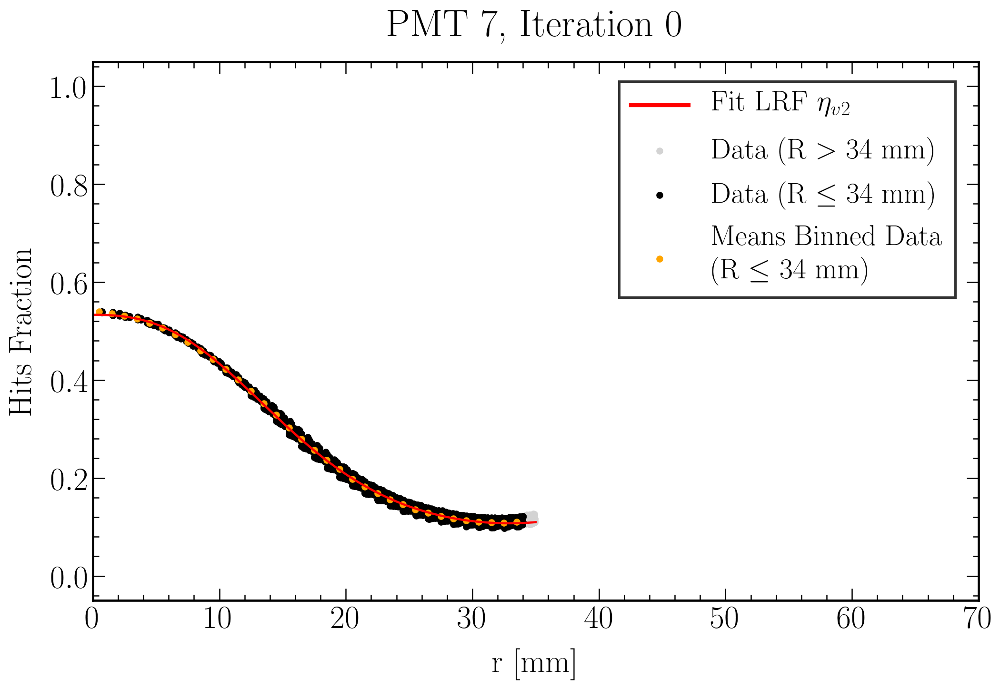

In [103]:
########################
iteration = '0'
########################

## Calculate radial positions
R_pos_list = np.array(f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'], Iterative_Reconstruciton.at[iteration, 'y_pos']))
Iterative_Reconstruciton.at[iteration, 'R_pos'] = R_pos_list
r_pos_list = np.array([f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'] - PMT_positions['PMT_position_x'][i], Iterative_Reconstruciton.at[iteration, 'y_pos'] - PMT_positions['PMT_position_y'][i]) for i in range(1,8)])
Iterative_Reconstruciton.at[iteration, 'r_pos'] = r_pos_list

## Fit LRF to radial plots
fit_parameters = np.array([None]*7)
r_pos_binned = np.array([None]*7)
HF_binned = np.array([None]*7)

for i in range(1,8):

    if i == 7:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial_central']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    else:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    HF = Iterative_Reconstruciton.at[iteration, 'HF'][i-1]
    R = Iterative_Reconstruciton.at[iteration, 'R_pos']
    r = Iterative_Reconstruciton.at[iteration, 'r_pos'][i-1]

    ## Fiducialise
    r_fiducial = r[(R <= rfiducial) | (r <= rfiducial_under)]
    HF_fiducial = HF[(R <= rfiducial) | (r <= rfiducial_under)]
    r_fiducial_complementary = r[(R > rfiducial) & (r > rfiducial_under)]
    HF_fiducial_complementary = HF[(R > rfiducial) & (r > rfiducial_under)]

    ## Bin to account for different arc lengths
    statistic, bin_edges, binnumber = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='mean', bins=(70), range=(0,70))
    bin_center = (bin_edges[:-1]+bin_edges[1:])/2
    statistic_isnan = statistic[~np.isnan(statistic)]
    bin_center_isnan = bin_center[~np.isnan(statistic)]

    r_pos_binned[i-1] = bin_center_isnan
    HF_binned[i-1] = statistic_isnan

    ## Fit
    try: 
        if (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)<0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1<1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan, bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan)
            fit_parameters[i-1] = popt
        elif (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)>=0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1<1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[1:], statistic_isnan[1:], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[1:], statistic_isnan[1:])
            fit_parameters[i-1] = popt
        elif (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)<0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1>=1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[:-1], statistic_isnan[:-1], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[:-1], statistic_isnan[:-1])
            fit_parameters[i-1] = popt
        else:
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1])
            fit_parameters[i-1] = popt
    except:
        if modelstring == 'eta_v2':
            bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
            popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1], bounds = bnds)
        else:
            popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1])
        fit_parameters[i-1] = popt

    ##################################################################################################
    #### Plot

    fig=plt.figure(figsize=(16, 10), dpi=150)

    ## Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    ## Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    ## Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    ## Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    ## Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    ## Grid
    #plt.grid(True)

    if rfiducial_under > 0:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm $\land$ r $>$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial_complementary, HF_fiducial_complementary, color = 'lightgray', label = lbl)
    if rfiducial_under > 0:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial, HF_fiducial, color = 'black', label = lbl)
    if rfiducial_under > 0:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(bin_center_isnan, statistic_isnan, color = 'orange', label = lbl)

    if int(modelstring[-1]) == 1:
        label = 'Fit LRF $\eta_{v1}$'
    elif int(modelstring[-1]) == 2:
        label = 'Fit LRF $\eta_{v2}$'
    elif int(modelstring[-1]) == 3:
        label = 'Fit LRF $\eta_{v3}$'
    elif int(modelstring[-1]) == 4:
        label = 'Fit LRF $\eta_{v4}$'
    else:
        label = 'Fit LRF'
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *eval("fit_parameters")[i-1]), color = 'r', linewidth = 2.2, label = label)
    
    plt.xlim(0.,35.*2)
    plt.ylim(-0.05, 1.05)
    
    # Axes Label 
    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('PMT '+str(i)+', Iteration '+str(iteration), fontsize = title_size, pad = title_pad)
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+"_PMT_"+str(i)+".png")
    plt.show()
    #################################################################################################

    ## Write to dataframe
    Iterative_Reconstruciton.at[iteration, 'r_pos_binned'] = r_pos_binned
    Iterative_Reconstruciton.at[iteration, 'HF_binned'] = HF_binned
    
Iterative_Reconstruciton.at[iteration, 'fit_parameter'] = fit_parameters

/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in power
  if __name__ == '__main__':


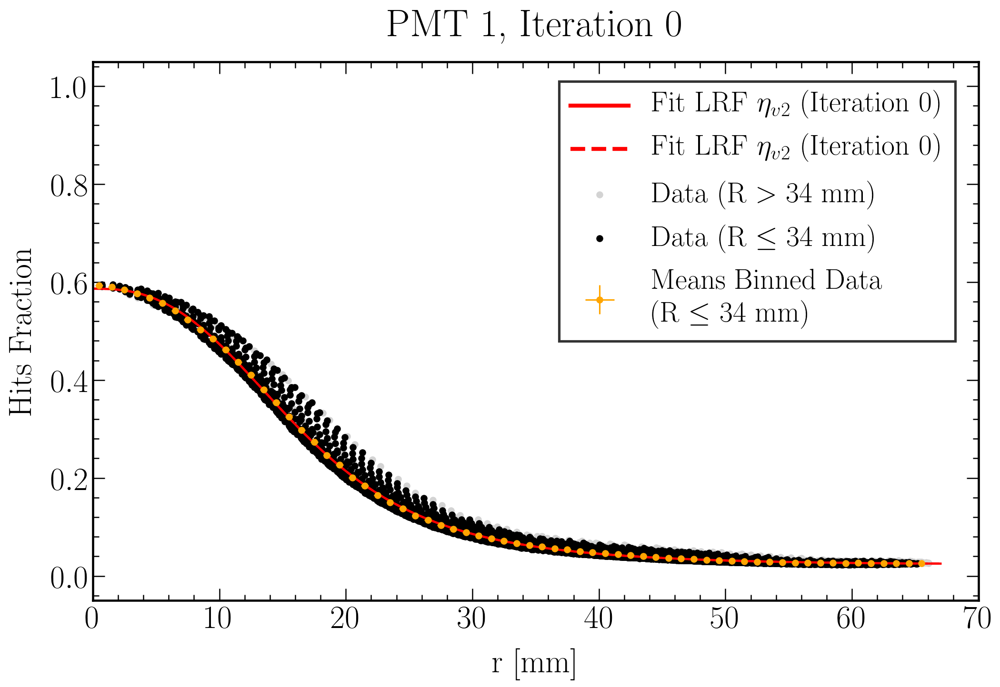

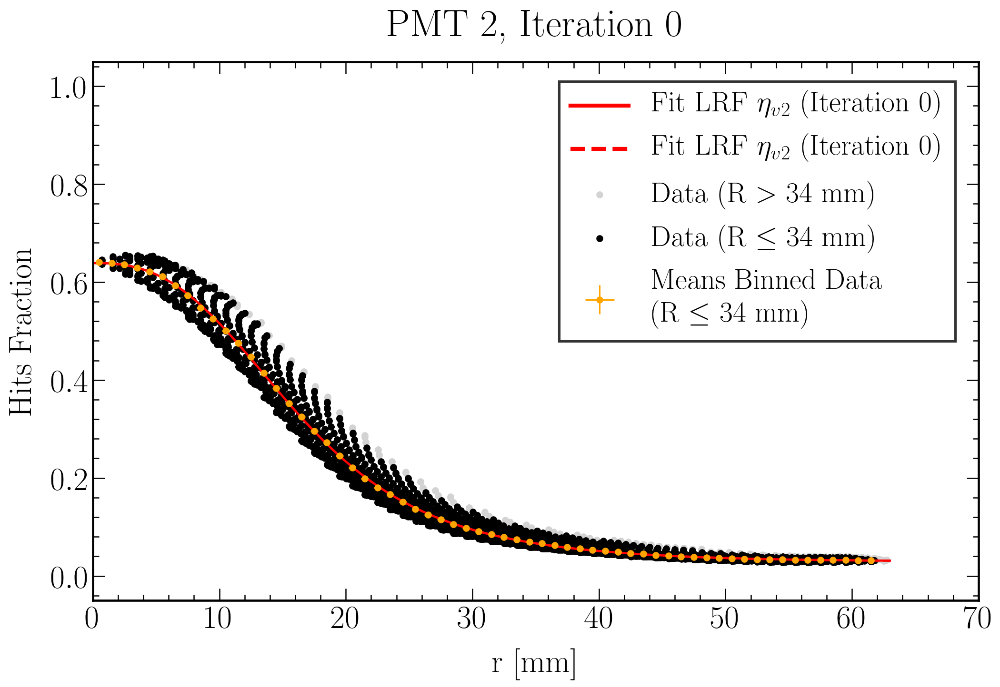

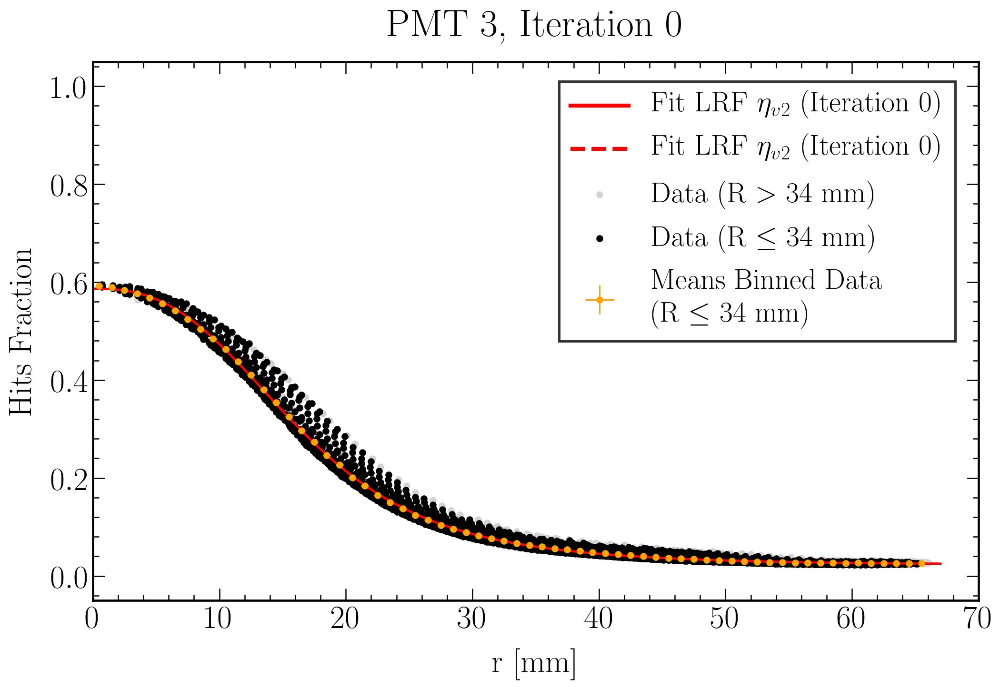

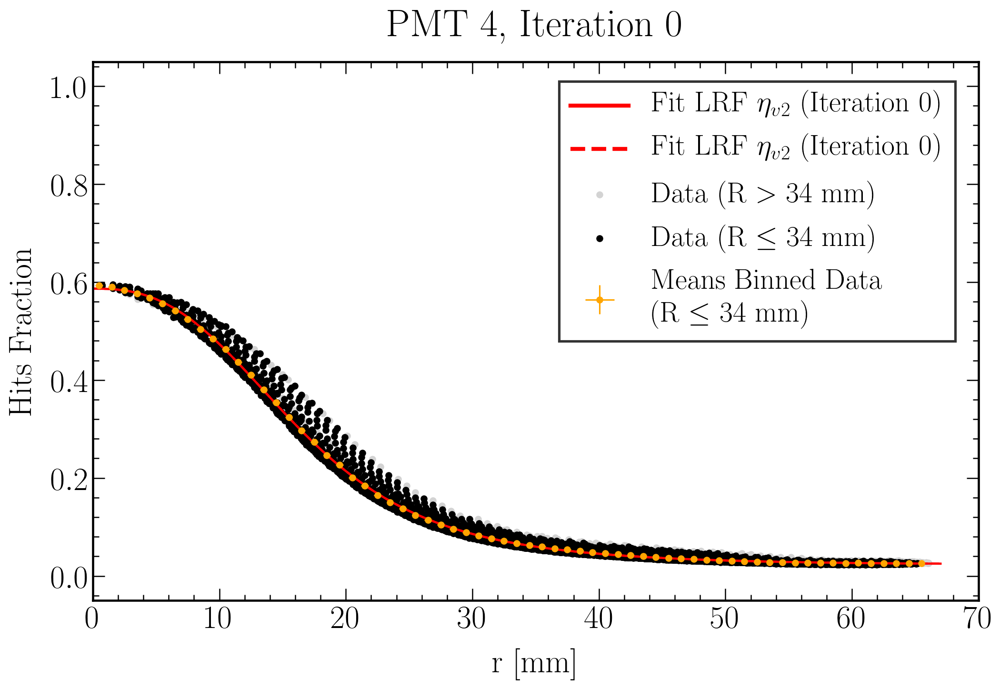

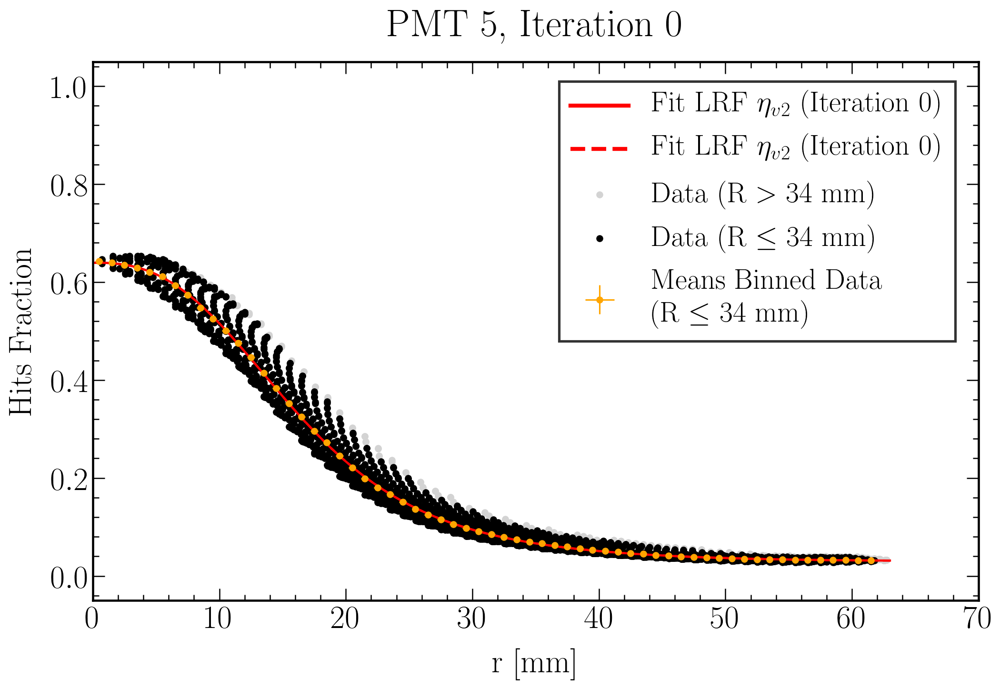

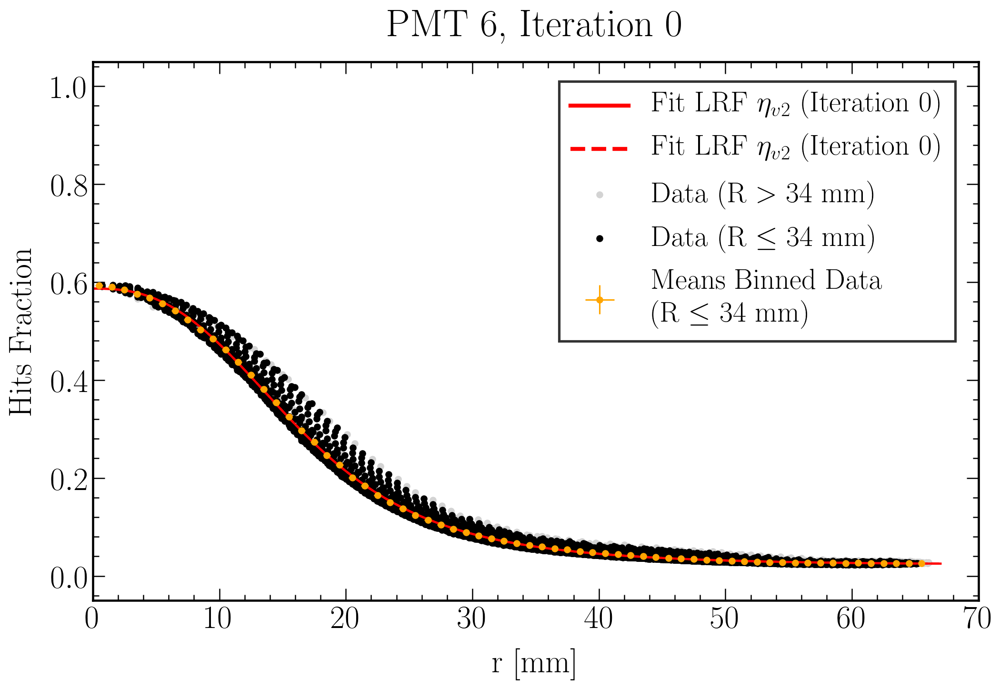

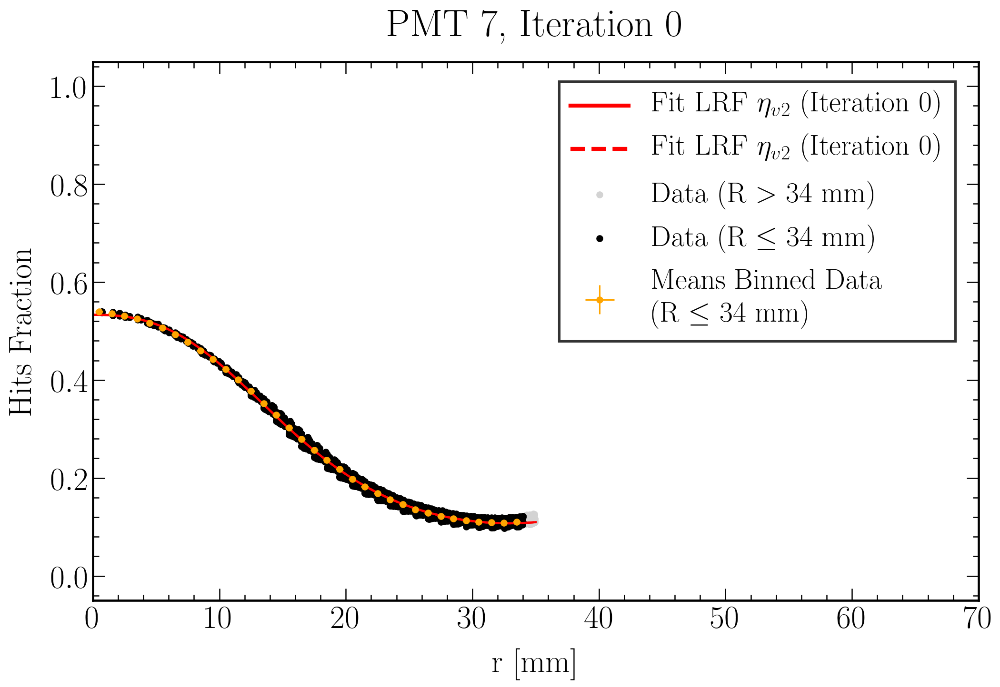

In [104]:
## Calculate radial positions
R_pos_list = Iterative_Reconstruciton.at[iteration, 'R_pos']
r_pos_list = Iterative_Reconstruciton.at[iteration, 'r_pos']

## Fit LRF to radial plots
fit_parameters = Iterative_Reconstruciton.at[iteration, 'fit_parameter']
r_pos_binned = Iterative_Reconstruciton.at[iteration, 'r_pos_binned']
HF_binned = Iterative_Reconstruciton.at[iteration, 'HF_binned']

for i in range(1,8):

    if i == 7:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial_central']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    else:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    HF = Iterative_Reconstruciton.at[iteration, 'HF'][i-1]
    R = Iterative_Reconstruciton.at[iteration, 'R_pos']
    r = Iterative_Reconstruciton.at[iteration, 'r_pos'][i-1]
    
    ## Fiducialise
    r_fiducial = r[(R <= rfiducial) | (r <= rfiducial_under)]
    HF_fiducial = HF[(R <= rfiducial) | (r <= rfiducial_under)]
    r_fiducial_complementary = r[(R > rfiducial) & (r > rfiducial_under)]
    HF_fiducial_complementary = HF[(R > rfiducial) & (r > rfiducial_under)]
    
    ## Bin to account for different arc lengths
    statistic, bin_edges, binnumber = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='mean', bins=(70), range=(0,70))
    bin_center = (bin_edges[:-1]+bin_edges[1:])/2
    statistic_isnan = statistic[~np.isnan(statistic)]
    bin_center_isnan = bin_center[~np.isnan(statistic)]
    
    statistic_std, _, _ = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='std', bins=(70), range=(0,70))
    statistic_std_isnan = statistic_std[~np.isnan(statistic)]
    
    statistic_count, _, _ = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='count', bins=(70), range=(0,70))
    statistic_count_isnan = statistic_count[~np.isnan(statistic)]

    ##################################################################################################
    #### Plot

    fig=plt.figure(figsize=(16, 10), dpi=150)

    ## Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    ## Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    ## Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    ## Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    ## Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    ## Grid
    #plt.grid(True)

    if rfiducial_under > 0:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm $\land$ r $>$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial_complementary, HF_fiducial_complementary, color = 'lightgray', label = lbl)
    if rfiducial_under > 0:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial, HF_fiducial, color = 'black', label = lbl)
    if rfiducial_under > 0:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm)"
    plt.errorbar(bin_center_isnan, statistic_isnan, yerr=statistic_std_isnan/np.sqrt(statistic_count_isnan), xerr = (70/numberbins)/np.sqrt(12), fmt='o', color = 'orange', label = lbl)    
    if int(modelstring[-1]) == 1:
        label = 'Fit LRF $\eta_{v1}$'
    elif int(modelstring[-1]) == 2:
        label = 'Fit LRF $\eta_{v2}$'
    elif int(modelstring[-1]) == 3:
        label = 'Fit LRF $\eta_{v3}$'
    elif int(modelstring[-1]) == 4:
        label = 'Fit LRF $\eta_{v4}$'
    else:
        label = 'Fit LRF'
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *eval("fit_parameters")[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration '+str(iteration)+')')
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *np.array(Iterative_Reconstruciton["fit_parameter"]["0"].tolist())[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration 0)', linestyle = 'dashed')
    
    plt.xlim(0.,35.*2)
    plt.ylim(-0.05, 1.05)
    
    # Axes Label 
    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('PMT '+str(i)+', Iteration '+str(iteration), fontsize = title_size, pad = title_pad)
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+"_PMT_"+str(i)+"_errorbars.png")
    plt.show()

In [105]:
Iterative_Reconstruciton.to_pickle(filenameprefix+"_Iterative_Reconstruciton_"+modelstring_save+".pkl")
Iterative_Reconstruciton.head(3)

,rfiducial,rfiducial_under,rfiducial_central,HF,HF_binned,x_pos,y_pos,R_pos,r_pos,r_pos_binned,fit_parameter
0,34,-1,34,"[[0.4700769435406306, 0.45129910462594025, 0.4...","[[0.5926318417130005, 0.5898681111037369, 0.58...","[-5.5, -4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5,...","[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -34...","[34.935655139126844, 34.792240514229604, 34.67...","[[10.700467279516348, 11.510864433221338, 12.3...","[[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5,...","[[0.5864174307982968, 29.991633172454918, -0.3..."
1,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
2,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"


In [106]:
Iterative_Reconstruciton['fit_parameter']['0']

array([array([ 0.58641743, 29.99163317, -0.31060678,  4.15467298,  2.58496435]),
       array([ 0.63873105, 29.94167858, -0.41763045,  4.23152266,  2.58549467]),
       array([ 0.58626053, 29.85301615, -0.28636122,  4.10796438,  2.59248907]),
       array([ 0.58646239, 29.94149202, -0.29940996,  4.13508842,  2.58653024]),
       array([ 0.63945566, 30.15490893, -0.45774671,  4.30688999,  2.57220331]),
       array([ 0.58659366, 29.99691876, -0.31021921,  4.15576589,  2.58329956]),
       array([  0.53314625,  39.34124752, -16.68394756,  19.46496794,
         2.24547392])], dtype=object)

#### Iterations >= 1

In [107]:
########################
iteration = '1'
########################

iteration_previous = str(int(iteration)-1)

try:
    if Iterative_Reconstruciton['fit_parameter'][iteration_previous][0] is not None:
        Iterative_Reconstruciton['fit_parameter'][iteration_previous]
    else:
        print('Previous iteration '+iteration_previous+' is not yet processed, will therefore set iteration to 1!')
        iteration = '1'     
except:
    print('Failed to set iteration to '+iteration+', will therefore set it to 1!')
    iteration = '1'

iteration_previous = str(int(iteration)-1)

print('current iteration  = '+iteration)
print('previous iteration = '+iteration_previous)

current iteration  = 1
previous iteration = 0


In [108]:
# Define input values

fit_parameters = Iterative_Reconstruciton['fit_parameter'][iteration_previous]
HF_list = Iterative_Reconstruciton['HF'][iteration]

In [109]:
fit_parameters

array([array([ 0.58641743, 29.99163317, -0.31060678,  4.15467298,  2.58496435]),
       array([ 0.63873105, 29.94167858, -0.41763045,  4.23152266,  2.58549467]),
       array([ 0.58626053, 29.85301615, -0.28636122,  4.10796438,  2.59248907]),
       array([ 0.58646239, 29.94149202, -0.29940996,  4.13508842,  2.58653024]),
       array([ 0.63945566, 30.15490893, -0.45774671,  4.30688999,  2.57220331]),
       array([ 0.58659366, 29.99691876, -0.31021921,  4.15576589,  2.58329956]),
       array([  0.53314625,  39.34124752, -16.68394756,  19.46496794,
         2.24547392])], dtype=object)

In [110]:
# Reconstruct position

rng = HF_list[0].shape[0]
x_list = np.array([None]*(rng))
y_list = np.array([None]*(rng))

printlevel = 0
for i in  range(0, rng):
    HF = [HF_list[j][i] for j in range(0,7)]
    pos = reconstructed(HF, fit_parameters).x
    x_list[i] = pos[0]
    y_list[i] = pos[1]
    
    if i / rng >= printlevel:
        print(str(100 * round(printlevel, 1))+' %', end = ' ')
        printlevel += 0.1
print('100 %', end = ' ')
    
Iterative_Reconstruciton.at[iteration, 'x_pos'] = np.array(x_list.tolist())
Iterative_Reconstruciton.at[iteration, 'y_pos'] = np.array(y_list.tolist())

0 % 10.0 % 20.0 % 30.0 % 40.0 % 50.0 % 60.0 % 

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: divide by zero encountered in true_divide


70.0 % 80.0 % 90.0 % 100 % 

In [111]:
print(x_list.dtype)
print(np.array(x_list.tolist()).dtype)
print(Iterative_Reconstruciton.at[iteration, 'x_pos'].dtype)

object
float64
float64


In [112]:
Iterative_Reconstruciton.to_pickle(filenameprefix+"_Iterative_Reconstruciton_"+modelstring_save+".pkl")
Iterative_Reconstruciton

,rfiducial,rfiducial_under,rfiducial_central,HF,HF_binned,x_pos,y_pos,R_pos,r_pos,r_pos_binned,fit_parameter
0,34,-1,34,"[[0.4700769435406306, 0.45129910462594025, 0.4...","[[0.5926318417130005, 0.5898681111037369, 0.58...","[-5.5, -4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5,...","[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -34...","[34.935655139126844, 34.792240514229604, 34.67...","[[10.700467279516348, 11.510864433221338, 12.3...","[[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5,...","[[0.5864174307982968, 29.991633172454918, -0.3..."
1,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,"[-4.830116043237841, -3.8957402110046604, -3.0...","[-25.76971424360738, -26.13297249968791, -26.1...",None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
2,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
3,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
4,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
5,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"


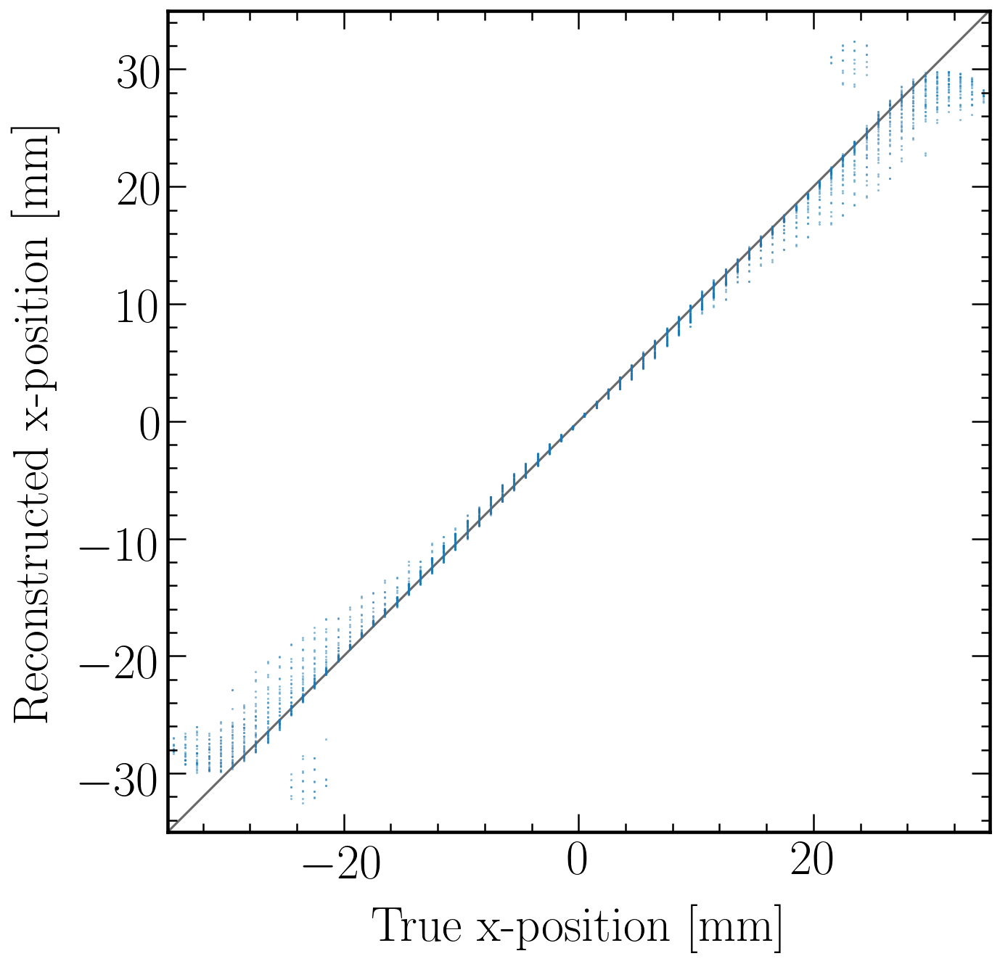

In [113]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(Iterative_Reconstruciton['x_pos'][0], 
            Iterative_Reconstruciton['x_pos'][iteration],
            marker='.',
            s=1,
            c='C0',
            alpha = 0.5,
           )

plt.plot([-35, 35], [-35, 35], 'dimgray', zorder = 0)


plt.xlabel('True x-position [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Reconstructed x-position [mm]', fontsize = label_size, labelpad = label_pad)
#plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-35.,35.)
plt.ylim(-35.,35.)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionCorrelationX"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")

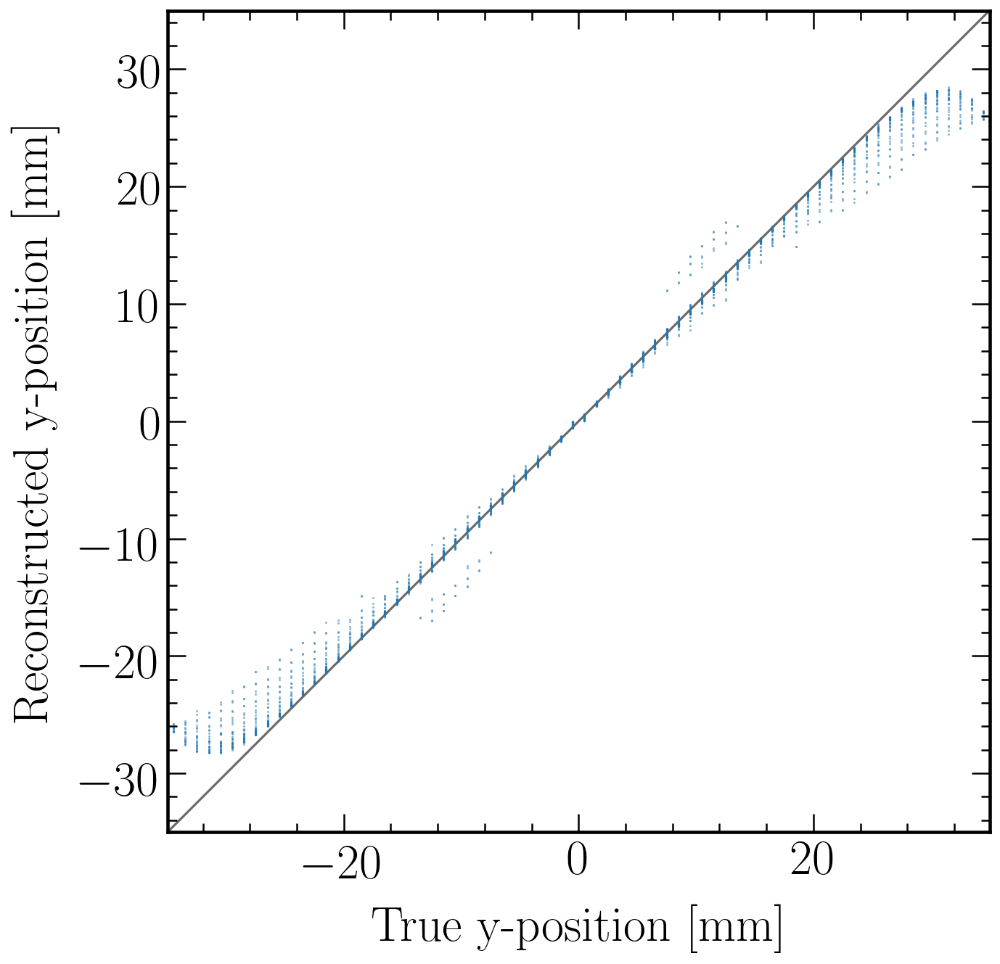

In [114]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(Iterative_Reconstruciton['y_pos'][0], 
            Iterative_Reconstruciton['y_pos'][iteration],
            marker='.',
            s=1,
            c='C0',
            alpha = 0.5,
           )

plt.plot([-35, 35], [-35, 35], 'dimgray', zorder = 0)


plt.xlabel('True y-position [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Reconstructed y-position [mm]', fontsize = label_size, labelpad = label_pad)
#plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-35.,35.)
plt.ylim(-35.,35.)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionCorrelationY"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")

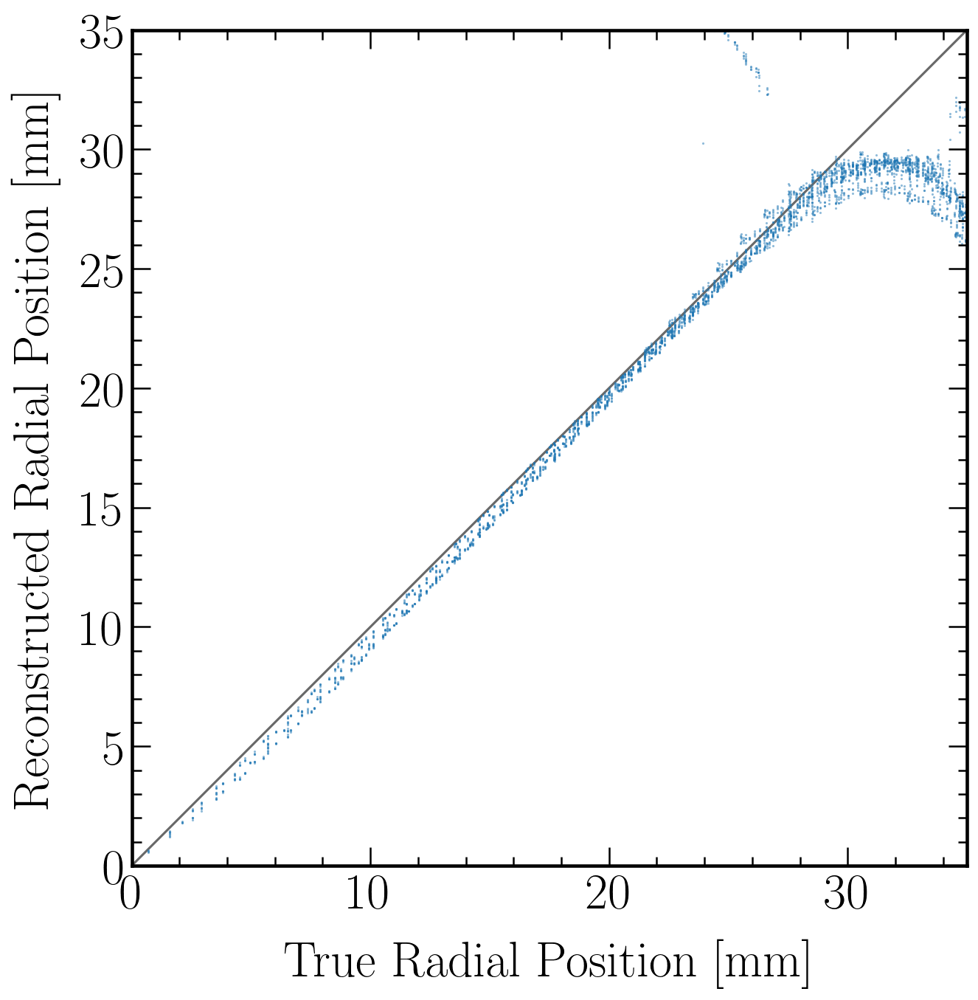

In [115]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
plt.scatter(f_polar_R(Iterative_Reconstruciton['x_pos'][0] ,Iterative_Reconstruciton['y_pos'][0]), 
            f_polar_R(Iterative_Reconstruciton['x_pos'][iteration] ,Iterative_Reconstruciton['y_pos'][iteration]),
            marker='.',
            s=1,
            c='C0',
            alpha = 0.5,
           )

plt.plot([0, 35], [0, 35], 'dimgray', zorder = 0)


plt.xlabel('True Radial Position [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Reconstructed Radial Position [mm]', fontsize = label_size, labelpad = label_pad)
#plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0.,35.)
plt.ylim(0,35.)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionCorrelationR"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")

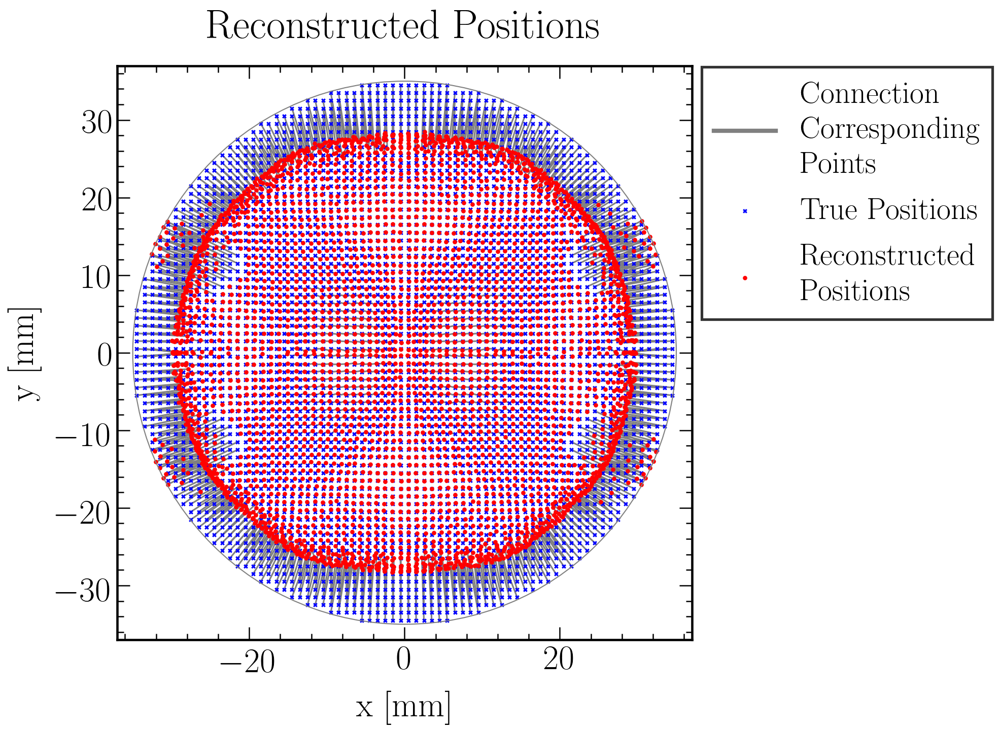

In [116]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([Iterative_Reconstruciton['x_pos'][0][0], x_list[0]],[Iterative_Reconstruciton['y_pos'][0][0], y_list[0]], 'grey', label = 'Connection\nCorresponding\nPoints', zorder=0)
for i in range(1, len(Iterative_Reconstruciton['x_pos'][0])):
    plt.plot([Iterative_Reconstruciton['x_pos'][0][i], x_list[i]],[Iterative_Reconstruciton['y_pos'][0][i], y_list[i]], 'grey', zorder=0)

# Data plot
plt.scatter(Iterative_Reconstruciton['x_pos'][0], Iterative_Reconstruciton['y_pos'][0], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(x_list, y_list, color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnected_"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")

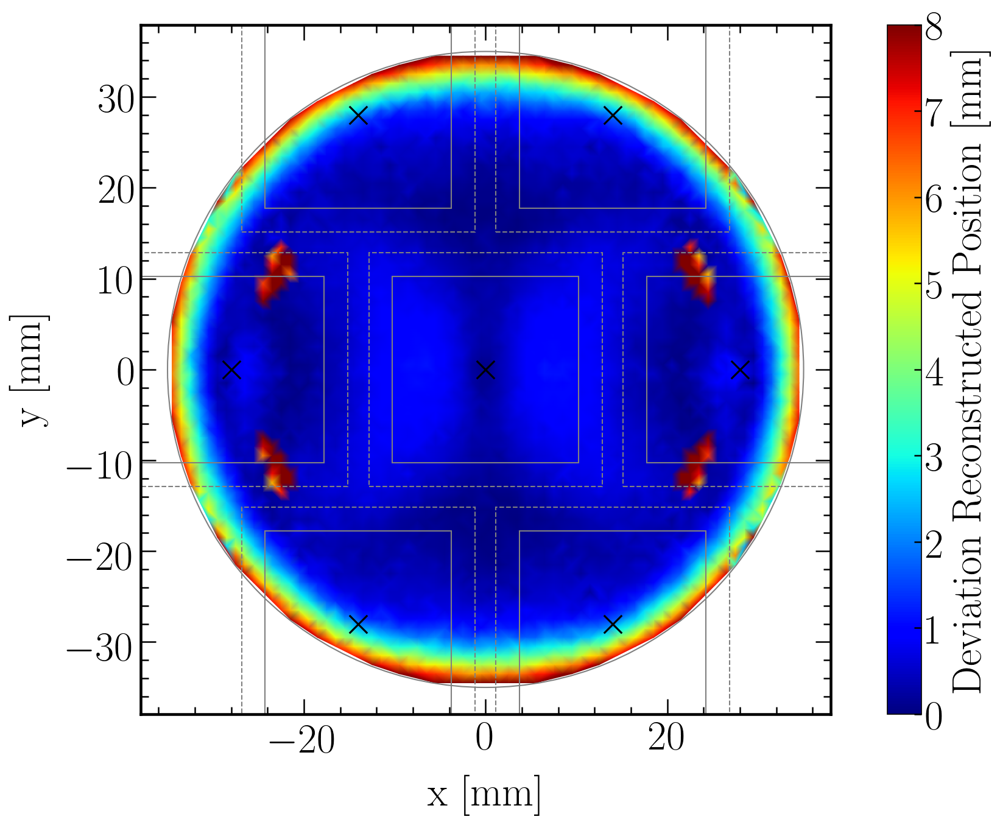

In [117]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
x = Iterative_Reconstruciton['x_pos'][0]
y = Iterative_Reconstruciton['y_pos'][0]
z = f_polar_R(Iterative_Reconstruciton['x_pos'][iteration]-Iterative_Reconstruciton['x_pos'][0], Iterative_Reconstruciton['y_pos'][iteration]-Iterative_Reconstruciton['y_pos'][0])
plt.tripcolor(x,y,z, cmap = 'jet', shading='gouraud')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Deviation Reconstructed Position [mm]', fontsize=label_size)
plt.clim(0, 8)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

fig.savefig(filenameprefix+"_ReconstructedPosition_Deviations_"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+"_smooth.png", bbox_inches = "tight")
plt.show()

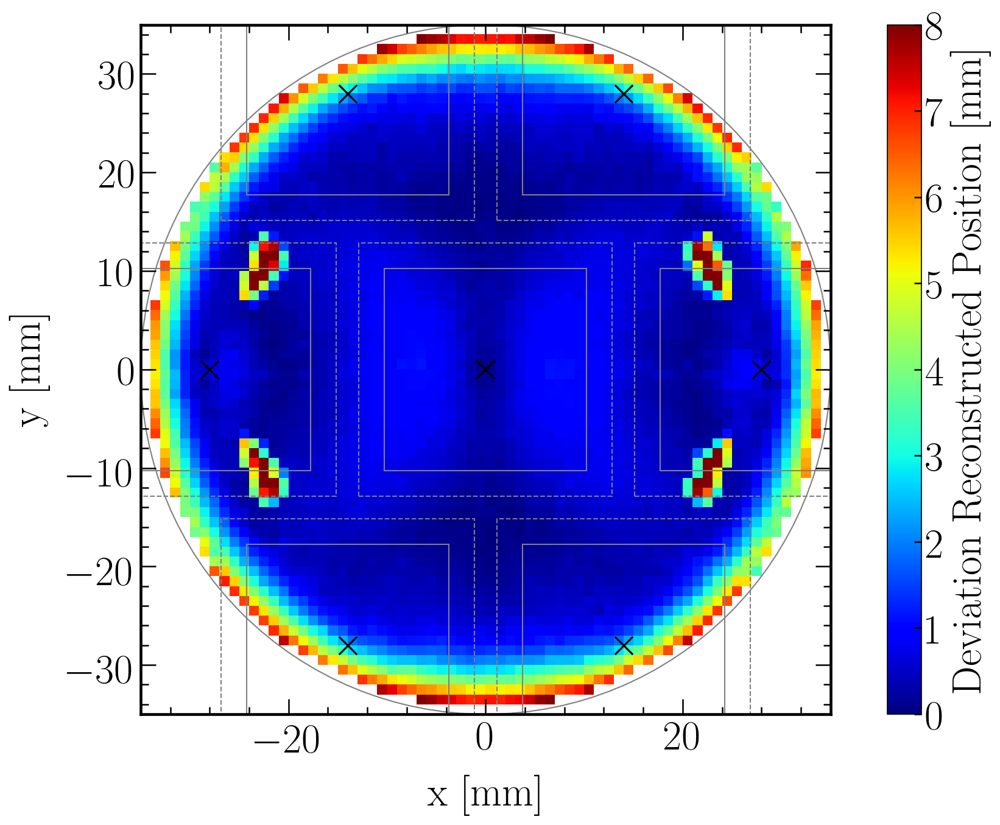

In [118]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
grid_x, grid_y = np.mgrid[-35:35:70j, -35:35:70j]
x = Iterative_Reconstruciton['x_pos'][0]
y = Iterative_Reconstruciton['y_pos'][0]
points = [np.array(pair)for pair in zip(x, y)]
values = f_polar_R(x-Iterative_Reconstruciton['x_pos'][iteration], y-Iterative_Reconstruciton['y_pos'][iteration])
#grid_z0 = griddata(points, values, (grid_x, grid_y), method='nearest')
grid_z1 = griddata(points, values, (grid_x, grid_y), method='linear')
#grid_z2 = griddata(points, values, (grid_x, grid_y), method='cubic')

plt.imshow(grid_z1.T, extent=(-35,35,-35,35), origin='lower', cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Deviation Reconstructed Position [mm]', fontsize=label_size)
plt.clim(0, 8)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_Deviations_"+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")

inf
sigma_x = 1.770749138547475 mm
sigma_y = 1.8010960418354176 mm


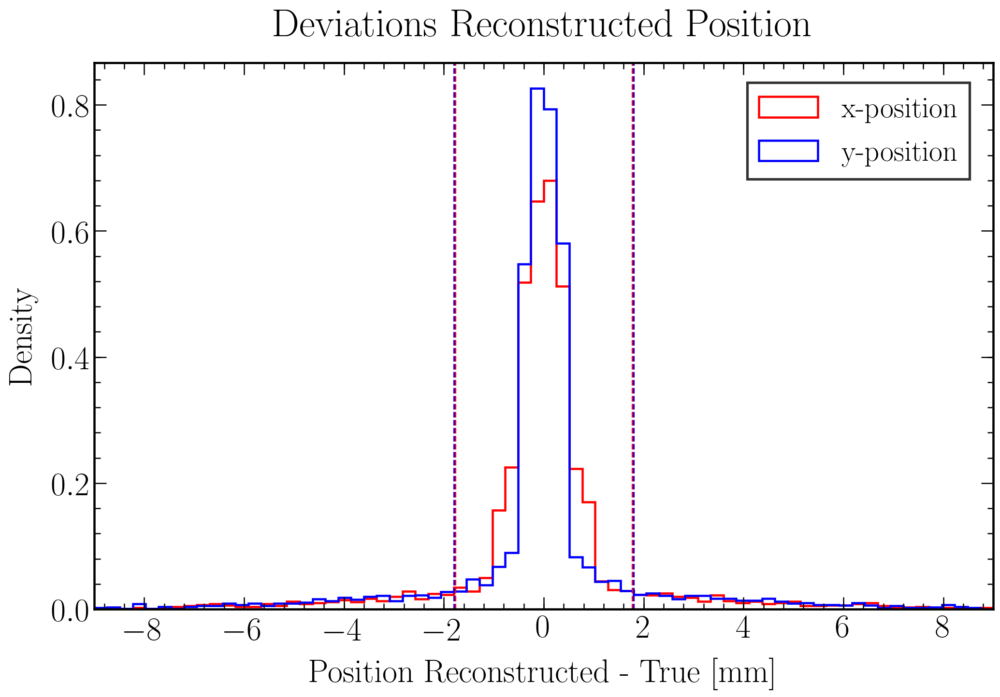

35.0
sigma_x = 1.7182067148900515 mm
sigma_y = 1.79068236137878 mm


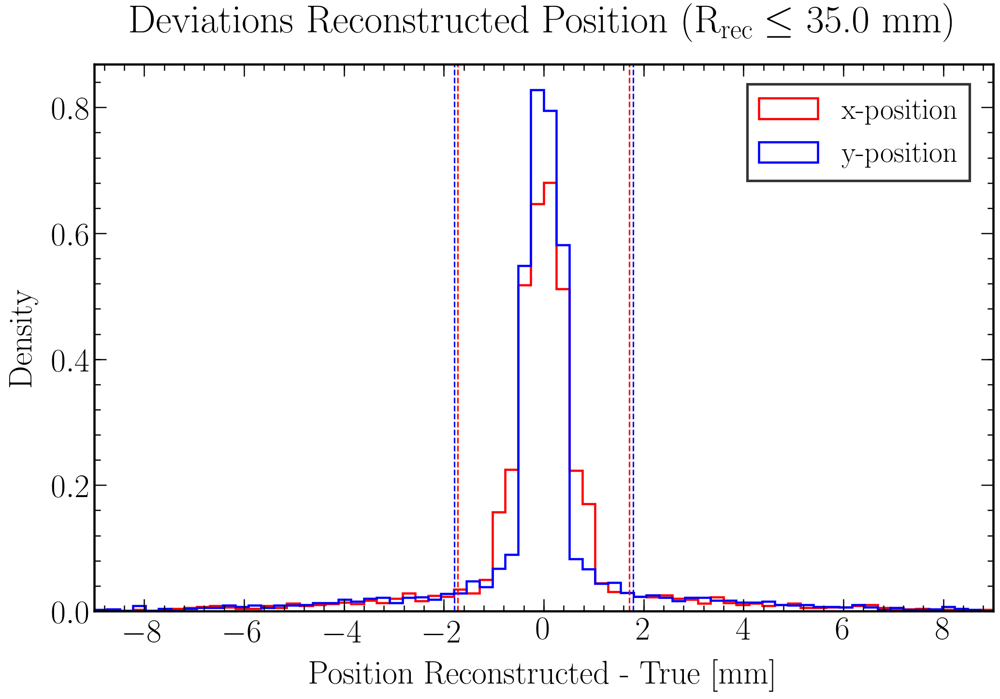

30.0
sigma_x = 1.4803657711512008 mm
sigma_y = 1.7516055136165143 mm


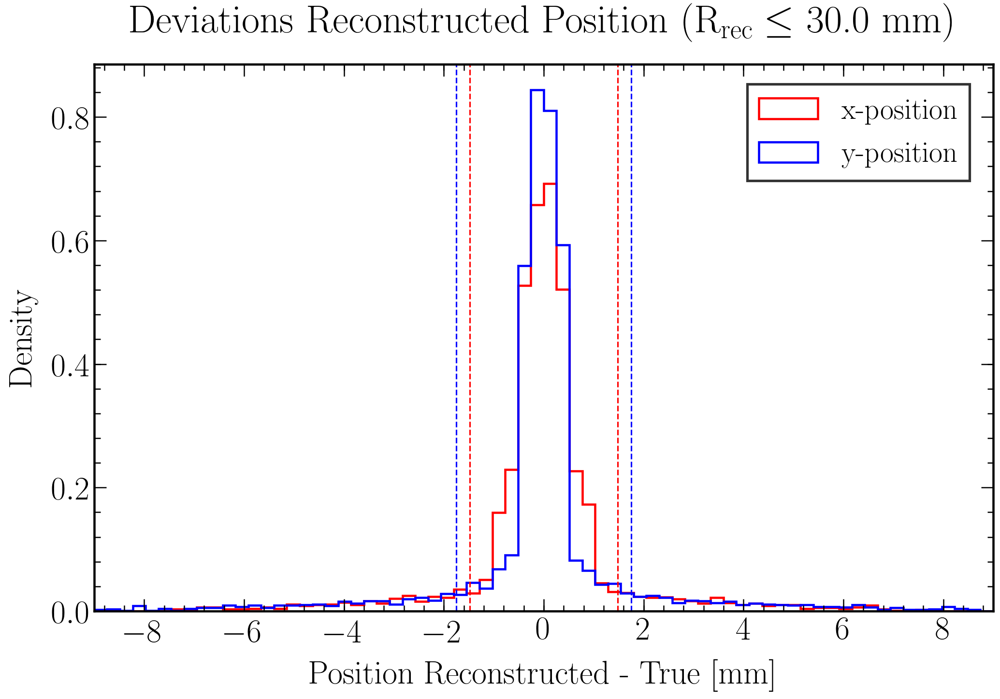

25.0
sigma_x = 0.47664067535878624 mm
sigma_y = 0.2424958694769379 mm


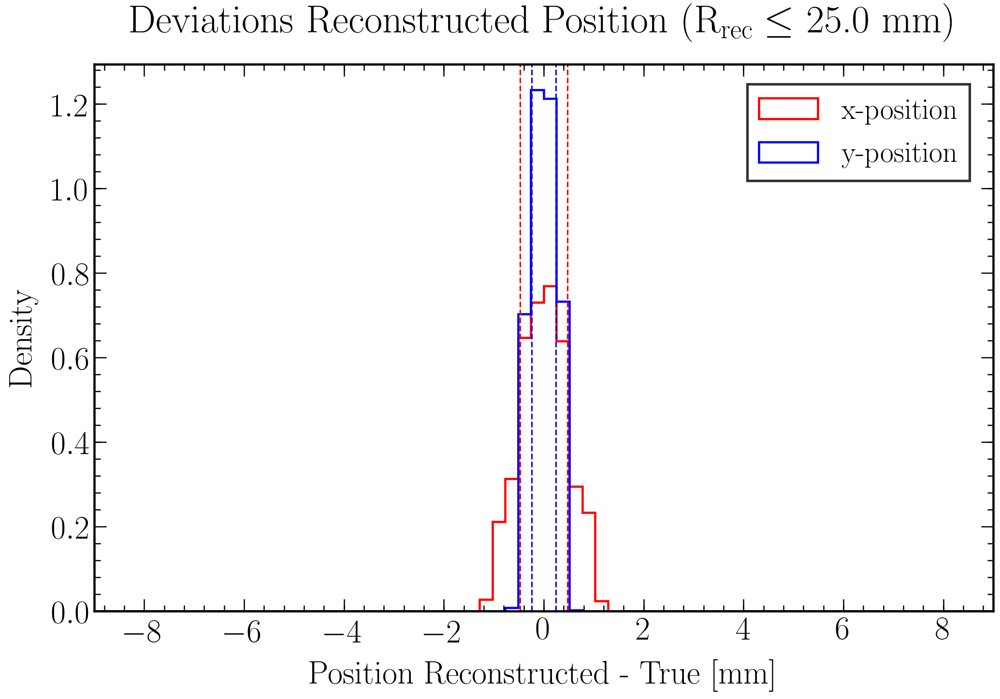

20.0
sigma_x = 0.5558256594943584 mm
sigma_y = 0.2410096248552194 mm


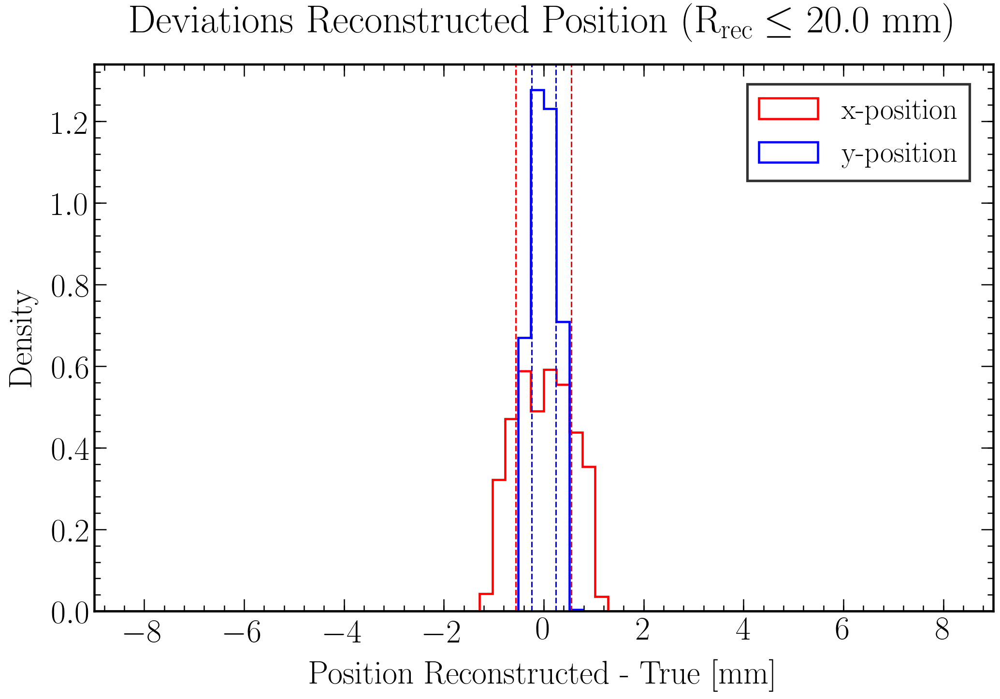

15.0
sigma_x = 0.6626762535141764 mm
sigma_y = 0.23693839705710606 mm


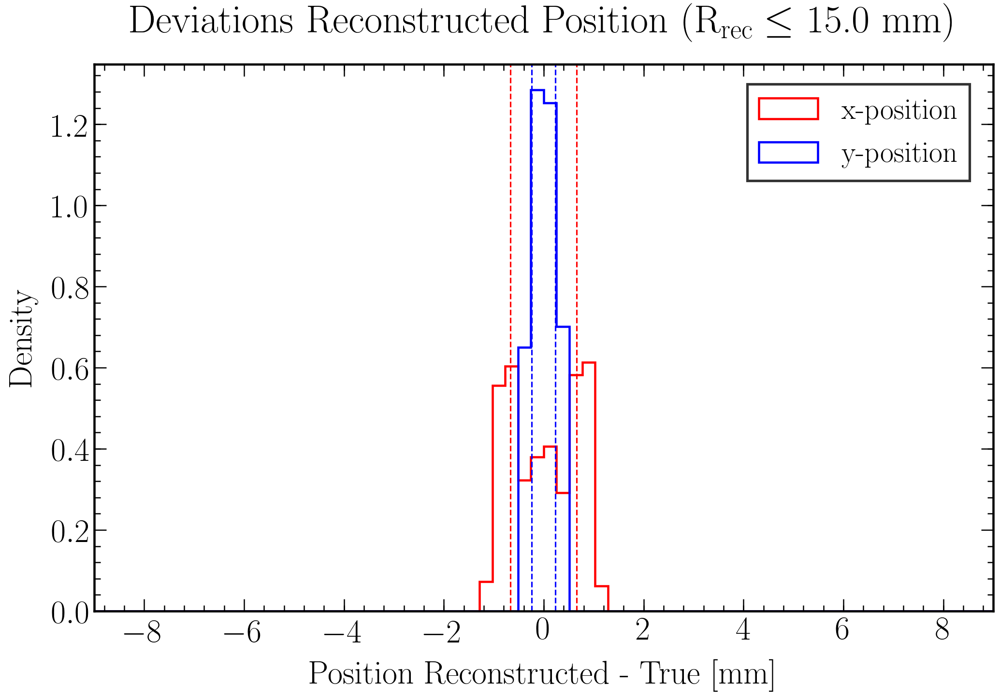

In [119]:
for fid in fid_list:
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    # Grid
    #plt.grid(True)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    fid = fid
    print(fid)

    rng = (-9, 9)
    fid_mask = np.sqrt(Iterative_Reconstruciton['x_pos'][iteration]**2 + Iterative_Reconstruciton['y_pos'][iteration]**2) <= fid
    delta_x_list = (Iterative_Reconstruciton['x_pos'][iteration]-Iterative_Reconstruciton['x_pos'][0])[fid_mask]
    delta_y_list = (Iterative_Reconstruciton['y_pos'][iteration]-Iterative_Reconstruciton['y_pos'][0])[fid_mask]
    plt.hist(delta_x_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
    plt.hist(delta_y_list, bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

    plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
    if fid > 35:
        plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)
    else:
        plt.title('Deviations Reconstructed Position ($\mathrm{R}_{\mathrm{rec}} \leq$ '+str(fid)+' mm)', fontsize = title_size, pad = title_pad)

    plt.xlim(-9,9)

    sigma_x = np.sqrt(np.var(delta_x_list))
    sigma_y = np.sqrt(np.var(delta_y_list))
    plt.axvline(x=sigma_x, color='red', linestyle='dashed')
    plt.axvline(x=-sigma_x, color='red', linestyle='dashed')
    print('sigma_x = '+str(sigma_x)+' mm')
    plt.axvline(x=sigma_y, color='blue', linestyle='dashed')
    plt.axvline(x=-sigma_y, color='blue', linestyle='dashed')
    print('sigma_y = '+str(sigma_y)+' mm')

    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    #fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistConfined"+str(fid)+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
    fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistConfined"+str(fid)+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_"+modelstring_save+".png", bbox_inches = "tight")
    plt.show()

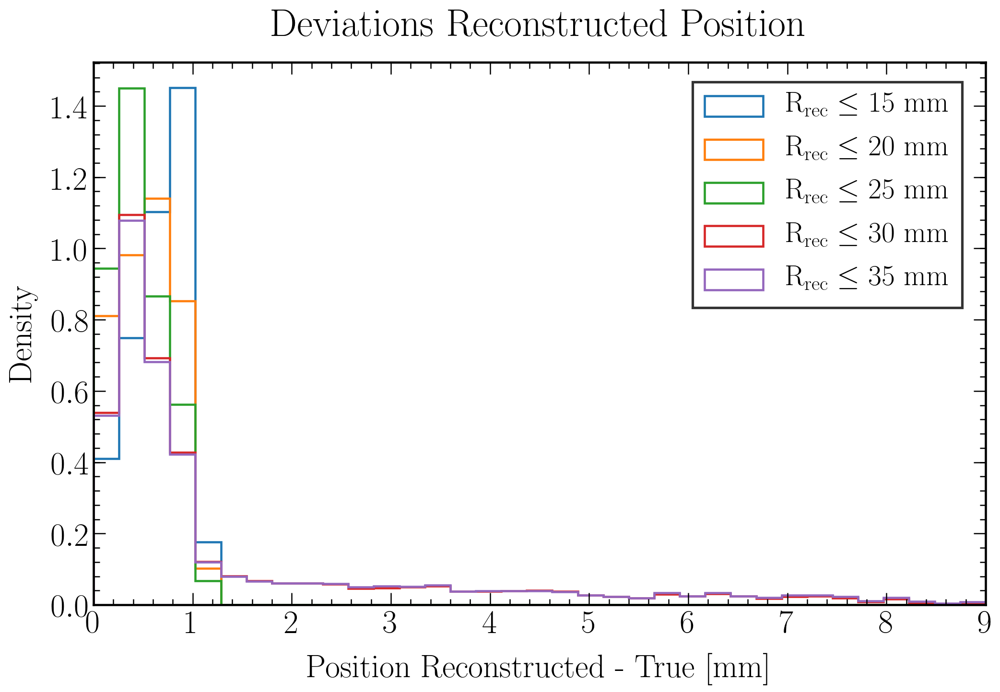

,fid,sigma_x,sigma_y,delta_mean,delta_50_percentile,delta_68.27_percentile,delta_95_percentile,delta_95.45_percentile,delta_99.73_percentile
0,10.0,0.718057,0.219635,0.697235,0.756095,0.913229,1.049610,1.052538,1.131810
1,12.5,0.700457,0.224861,0.683744,0.765111,0.880908,1.036635,1.037352,1.130707
2,15.0,0.662676,0.236938,0.649315,0.713912,0.824683,1.024408,1.027624,1.129766
3,17.5,0.609395,0.241052,0.593088,0.627525,0.773804,1.009213,1.012127,1.119724
4,20.0,0.555826,0.241010,0.535360,0.550139,0.710301,0.971242,0.989502,1.111325
5,22.5,0.509906,0.238740,0.490601,0.475752,0.632897,0.951946,0.961184,1.105612
6,25.0,0.476641,0.242496,0.466296,0.432620,0.578738,0.937806,0.943703,1.102491
7,27.5,0.778452,1.412128,0.767498,0.463846,0.611454,1.079586,1.145046,8.502990
8,30.0,1.480366,1.751606,1.398628,0.611789,0.940476,5.989357,6.173962,8.286132
9,32.5,1.500620,1.751945,1.413029,0.616395,0.952653,5.996159,6.184586,8.285010


In [120]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.xlim(0,9)
rng = (0, 9)

ReconstructedPosition_Deviations = pd.DataFrame(data={'fid': [], 'sigma_x': [], 'sigma_y': [], 'delta_mean': [], 'delta_50_percentile': [], 'delta_68.27_percentile': [], 'delta_95_percentile': [], 'delta_95.45_percentile': [], 'delta_99.73_percentile': []})
fid_list_more = [10, 12.5, 15, 17.5, 20, 22.5, 25, 27.5, 30, 32.5, 35]

for fid in fid_list_more:
    fid_mask = np.sqrt(Iterative_Reconstruciton['x_pos'][iteration]**2 + Iterative_Reconstruciton['y_pos'][iteration]**2) <= fid
    delta_x_list = (Iterative_Reconstruciton['x_pos'][iteration]-Iterative_Reconstruciton['x_pos'][0])[fid_mask]
    delta_y_list = (Iterative_Reconstruciton['y_pos'][iteration]-Iterative_Reconstruciton['y_pos'][0])[fid_mask]
    sigma_x = np.sqrt(np.var(delta_x_list))
    sigma_y = np.sqrt(np.var(delta_y_list))
    delta_list = np.sqrt(delta_x_list**2 + delta_y_list**2)
    if fid in fid_list[1:]:
        plt.hist(delta_list, bins = round(numberbins/2), density=True, range=rng, histtype = 'step', linewidth = 2.2, label = '$\mathrm{R}_{\mathrm{rec}} \leq$ '+str(fid)+' mm')
    ReconstructedPosition_Deviations = ReconstructedPosition_Deviations.append(pd.DataFrame(data={
        'fid': [fid], 'sigma_x': [sigma_x], 'sigma_y': [sigma_y], 'delta_mean': [delta_list.mean()], 
        'delta_50_percentile': [np.percentile(delta_list, 50)], 
        'delta_68.27_percentile': [np.percentile(delta_list, 68.27)], 
        'delta_95_percentile': [np.percentile(delta_list, 95)], 
        'delta_95.45_percentile': [np.percentile(delta_list, 95.45)], 
        'delta_99.73_percentile': [np.percentile(delta_list, 99.73)]}), ignore_index=True)
    
plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistR_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

ReconstructedPosition_Deviations.to_pickle(filenameprefix+"_ReconstructedPosition_Deviations_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".pkl")
ReconstructedPosition_Deviations

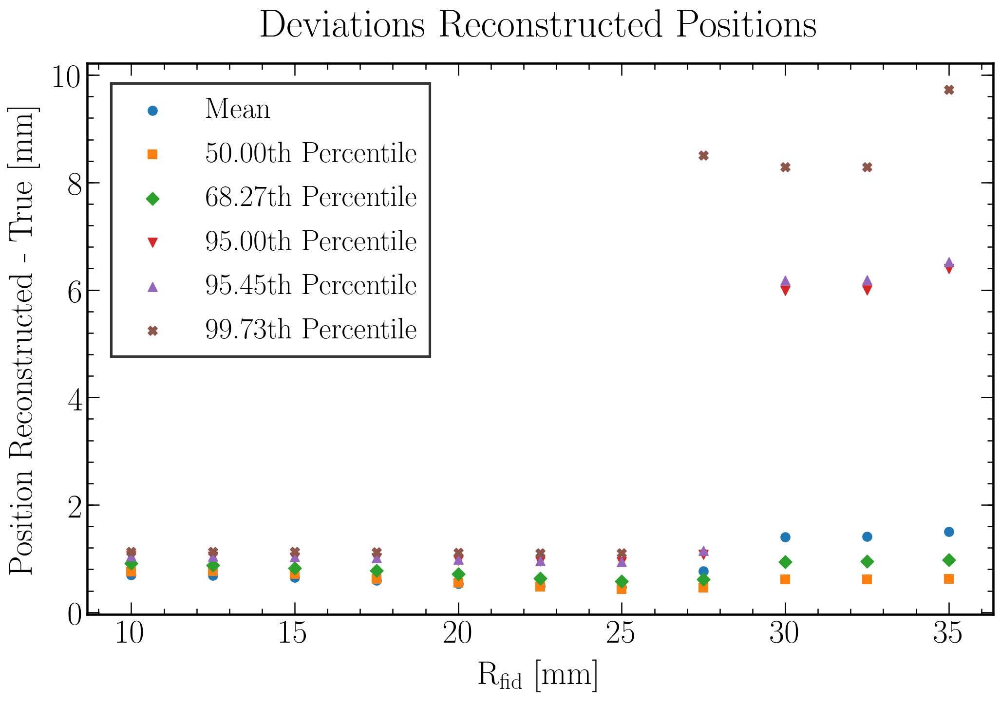

In [121]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_mean']
plt.scatter(x, y, label = 'Mean', color = 'C0', marker = 'o', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C0')'''

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_50_percentile']
plt.scatter(x, y, label = '50.00th Percentile', color = 'C1', marker = 's', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C1')'''

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_68.27_percentile']
plt.scatter(x, y, label = '68.27th Percentile', color = 'C2', marker = 'D', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C2')'''

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_95_percentile']
plt.scatter(x, y, label = '95.00th Percentile', color = 'C3', marker = 'v', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C3')'''

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_95.45_percentile']
plt.scatter(x, y, label = '95.45th Percentile', color = 'C4', marker = '^', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C4')'''

x = ReconstructedPosition_Deviations['fid']
y = ReconstructedPosition_Deviations['delta_99.73_percentile']
plt.scatter(x, y, label = '99.73th Percentile', color = 'C5', marker = 'X', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=2)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'C5')'''
    
plt.ylabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.xlabel('$\mathrm{R}_{\mathrm{fid}}$ [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Reconstructed Positions', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.01,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsPercentiles_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

In [122]:
fid_list_more = [10, 12.5, 15, 17.5, 20, 22.5, 25, 27.5, 30, 32.5, 35]
Goodness_fiducialisation = pd.DataFrame(data={'fid': [], 'true_negative': [], 'false_negative': [], 'true_positive': [], 'false_positive': [], 'total': [], 'true_inside': [], 'true_outside': []})

r_reco = f_polar_R(Iterative_Reconstruciton['x_pos'][iteration], Iterative_Reconstruciton['y_pos'][iteration])
r_real = f_polar_R(Iterative_Reconstruciton['x_pos'][0], Iterative_Reconstruciton['y_pos'][0])

for fid in fid_list_more:
    true_negative = r_reco[(r_reco > fid) & (r_real > fid)].shape[0]
    false_negative = r_reco[(r_reco > fid) & (r_real <= fid)].shape[0]
    true_positive = r_reco[(r_reco <= fid) & (r_real <= fid)].shape[0]
    false_positive = r_reco[(r_reco <= fid) & (r_real > fid)].shape[0]
    total = r_reco.shape[0]
    true_inside = r_reco[(r_real <= fid)].shape[0]
    true_outside = r_reco[(r_real > fid)].shape[0]
    Goodness_fiducialisation = Goodness_fiducialisation.append(pd.DataFrame(data={
        'fid': [fid], 'true_negative': [true_negative], 'false_negative': [false_negative], 
        'true_positive': [true_positive], 'false_positive': [false_positive], 
        'total': [total], 'true_inside': [true_inside], 'true_outside': [true_outside]}), ignore_index=True)

Goodness_fiducialisation.to_pickle(filenameprefix+"_Goodness_fiducialisation_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".pkl")
Goodness_fiducialisation

,fid,true_negative,false_negative,true_positive,false_positive,total,true_inside,true_outside
0,10.0,3496.0,0.0,316.0,40.0,3852.0,316.0,3536.0
1,12.5,3312.0,0.0,484.0,56.0,3852.0,484.0,3368.0
2,15.0,3104.0,0.0,716.0,32.0,3852.0,716.0,3136.0
3,17.5,2855.0,0.0,952.0,45.0,3852.0,952.0,2900.0
4,20.0,2557.0,0.0,1264.0,31.0,3852.0,1264.0,2588.0
5,22.5,2227.0,0.0,1576.0,49.0,3852.0,1576.0,2276.0
6,25.0,1855.0,31.0,1945.0,21.0,3852.0,1976.0,1876.0
7,27.5,1319.0,69.0,2279.0,185.0,3852.0,2348.0,1504.0
8,30.0,19.0,62.0,2766.0,1005.0,3852.0,2828.0,1024.0
9,32.5,0.0,57.0,3243.0,552.0,3852.0,3300.0,552.0


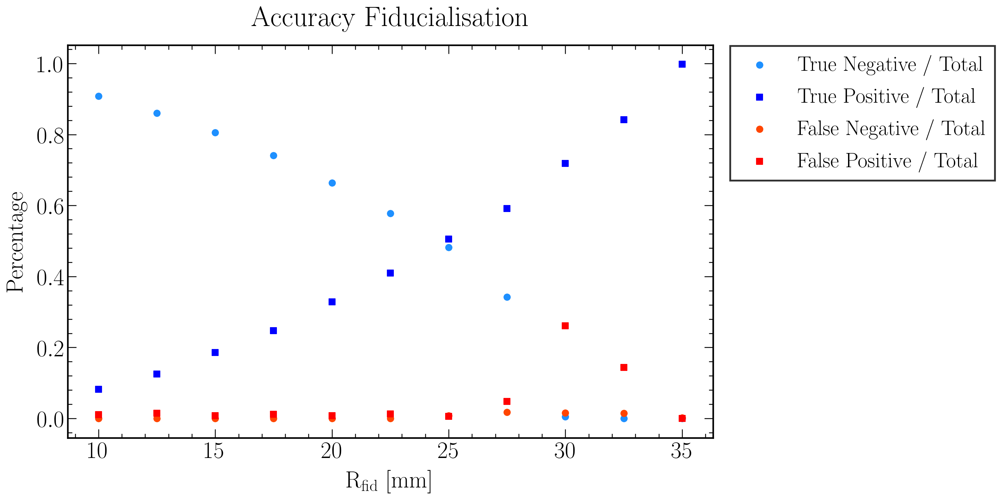

In [123]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
x = Goodness_fiducialisation['fid']

y = Goodness_fiducialisation['true_negative']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'True Negative / Total', color = 'dodgerblue', marker = 'o', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'dodgerblue')'''

y = Goodness_fiducialisation['true_positive']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'True Positive / Total', color = 'blue', marker = 's', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'blue')'''

y = Goodness_fiducialisation['false_negative']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'False Negative / Total', color = 'orangered', marker = 'o', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'orangered')'''

y = Goodness_fiducialisation['false_positive']/Goodness_fiducialisation['total']
plt.scatter(x, y, label = 'False Positive / Total', color = 'red', marker = 's', s = 80)
'''xnew = np.linspace(min(x), max(x), 300)
spl = make_interp_spline(sorted(x), [X for Y, X in sorted(zip(x, y))], k=3)
ynew = spl(xnew)
plt.plot(xnew, ynew, linewidth = 2.2, zorder=0, color = 'red')'''

plt.ylabel('Percentage', fontsize = label_size, labelpad = label_pad)
plt.xlabel('$\mathrm{R}_{\mathrm{fid}}$ [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Accuracy Fiducialisation', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Goodness_fiducialisation_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

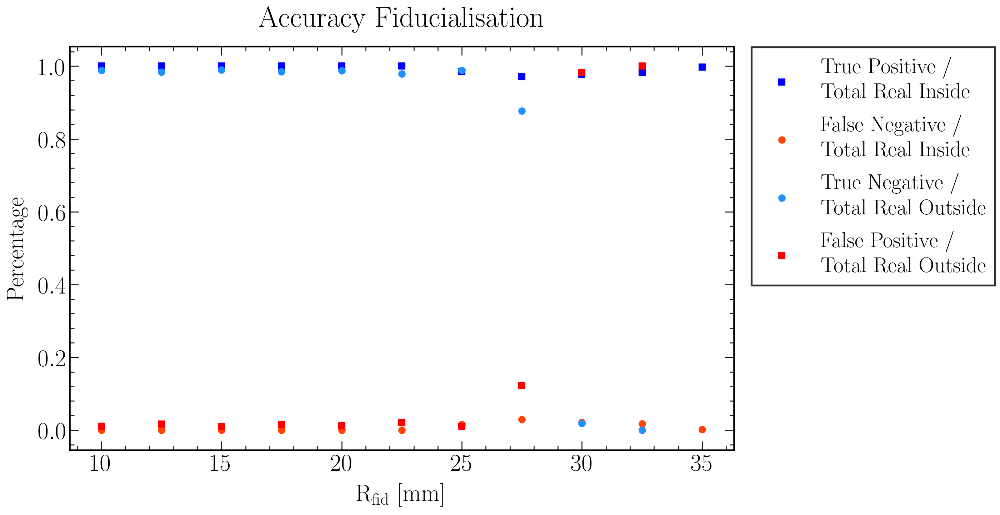

In [124]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot
x = Goodness_fiducialisation['fid']
plt.scatter(x, Goodness_fiducialisation['true_positive']/Goodness_fiducialisation['true_inside'], label = 'True Positive /\nTotal Real Inside', color = 'blue', marker = 's', s = 80)
plt.scatter(x, Goodness_fiducialisation['false_negative']/Goodness_fiducialisation['true_inside'], label = 'False Negative /\nTotal Real Inside', color = 'orangered', marker = 'o', s = 80)
plt.scatter(x, Goodness_fiducialisation['true_negative']/Goodness_fiducialisation['true_outside'], label = 'True Negative /\nTotal Real Outside', color = 'dodgerblue', marker = 'o', s = 80)
plt.scatter(x, Goodness_fiducialisation['false_positive']/Goodness_fiducialisation['true_outside'], label = 'False Positive /\nTotal Real Outside', color = 'red', marker = 's', s = 80)

plt.ylabel('Percentage', fontsize = label_size, labelpad = label_pad)
plt.xlabel('$\mathrm{R}_{\mathrm{fid}}$ [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Accuracy Fiducialisation', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(1.01,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Goodness_fiducialisation_normed_"+"Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in power
  if __name__ == '__main__':


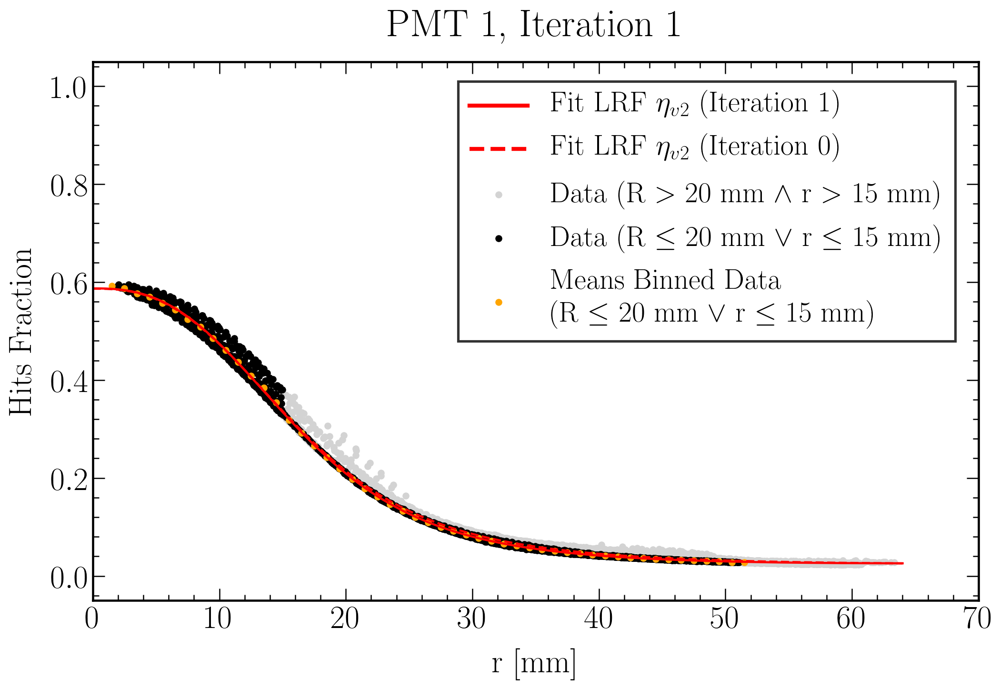

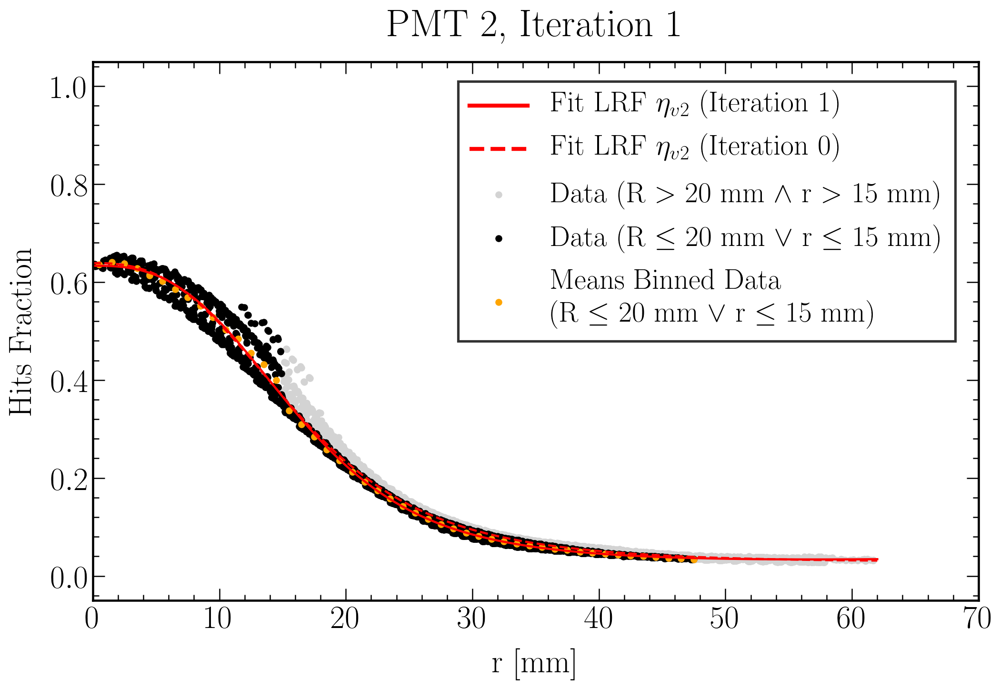

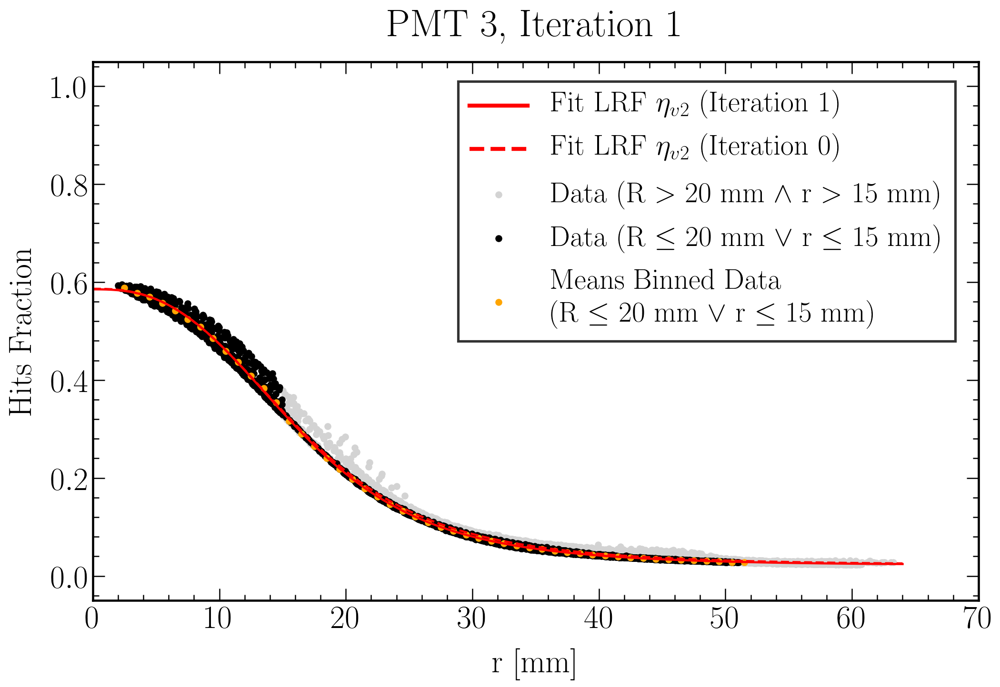

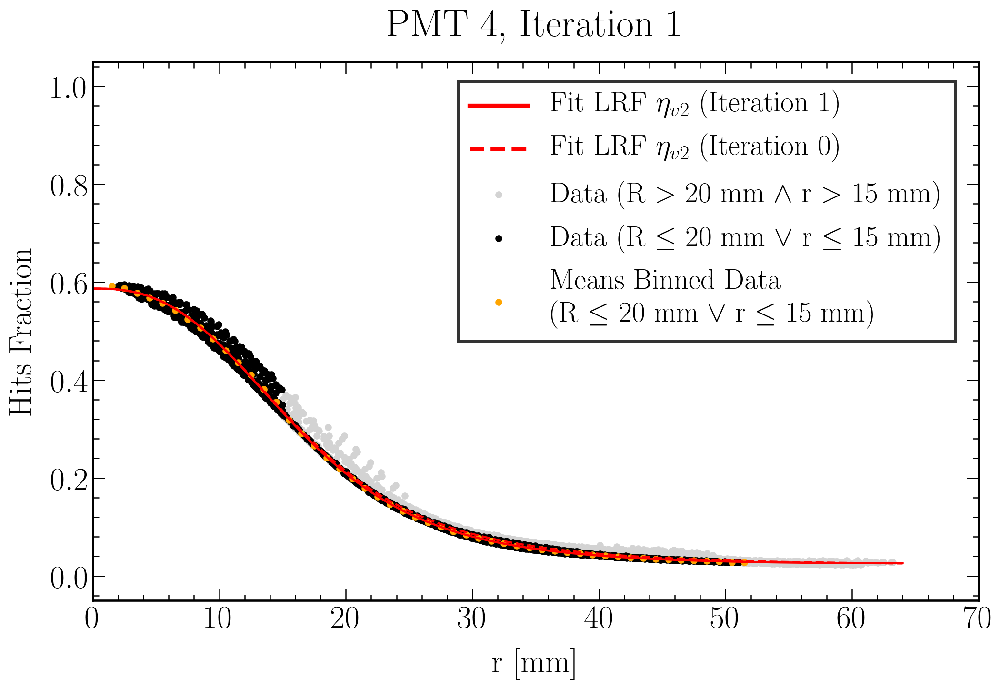

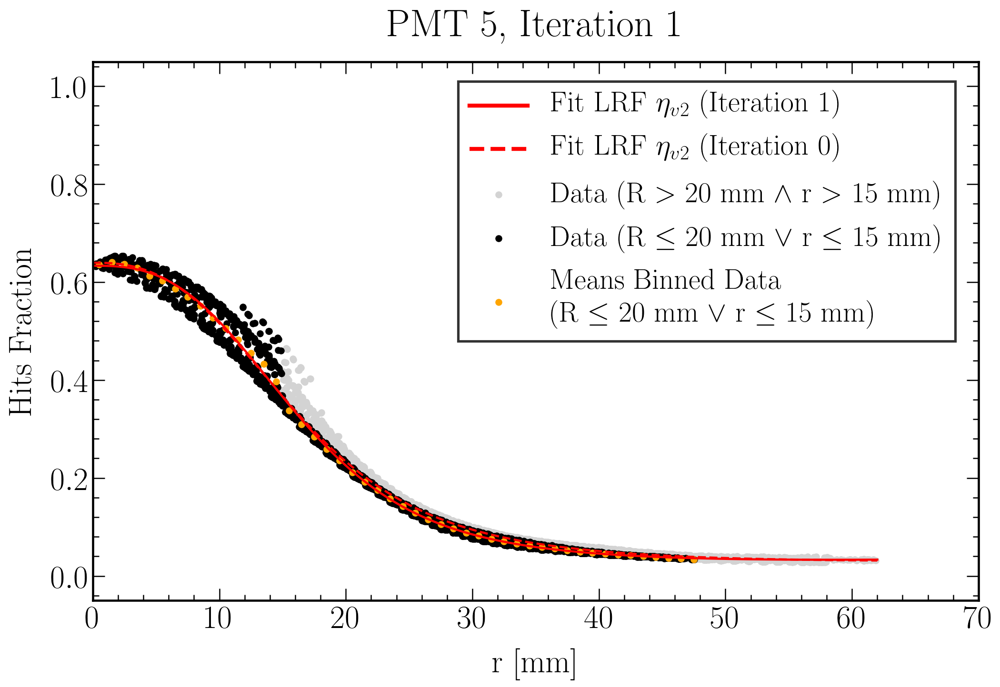

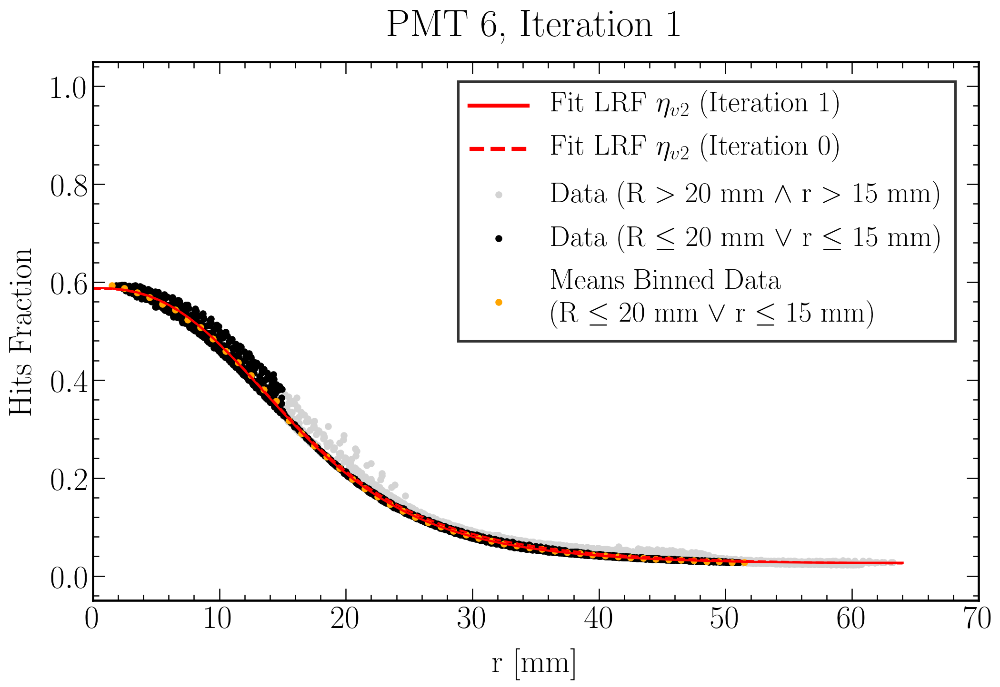

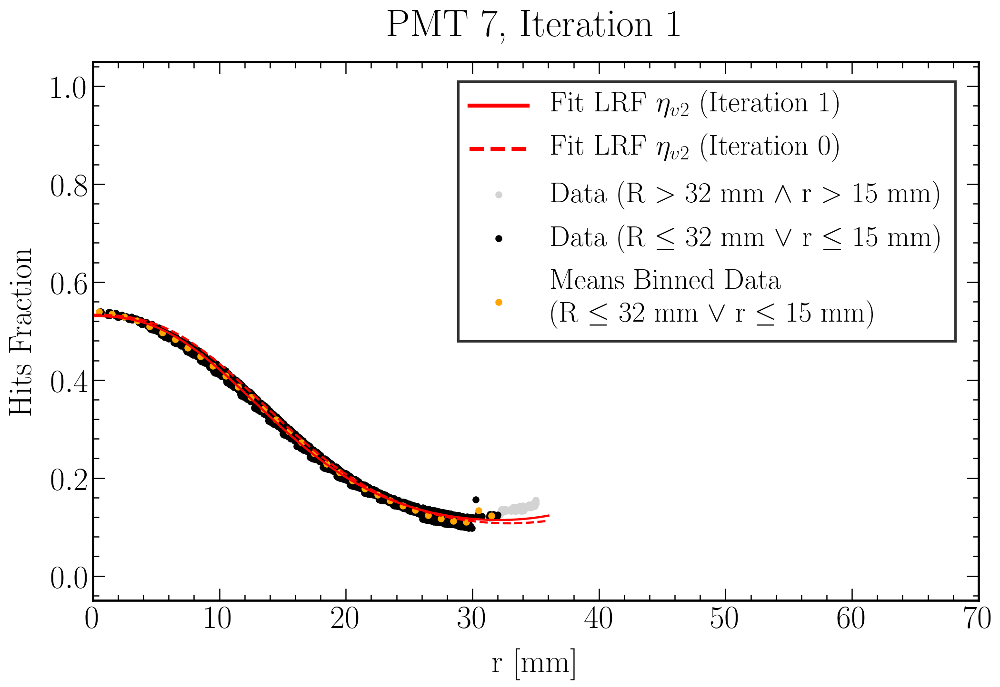

In [125]:
## Calculate radial positions
R_pos_list = np.array(f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'], Iterative_Reconstruciton.at[iteration, 'y_pos']))
Iterative_Reconstruciton.at[iteration, 'R_pos'] = R_pos_list
r_pos_list = np.array([f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'] - PMT_positions['PMT_position_x'][i], Iterative_Reconstruciton.at[iteration, 'y_pos'] - PMT_positions['PMT_position_y'][i]) for i in range(1,8)])
Iterative_Reconstruciton.at[iteration, 'r_pos'] = r_pos_list

## Fit LRF to radial plots
fit_parameters = np.array([None]*7)
r_pos_binned = np.array([None]*7)
HF_binned = np.array([None]*7)

for i in range(1,8):

    if i == 7:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial_central']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    else:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    HF = Iterative_Reconstruciton.at[iteration, 'HF'][i-1]
    R = Iterative_Reconstruciton.at[iteration, 'R_pos']
    r = Iterative_Reconstruciton.at[iteration, 'r_pos'][i-1]

    ## Fiducialise
    r_fiducial = r[(R <= rfiducial) | (r <= rfiducial_under)]
    HF_fiducial = HF[(R <= rfiducial) | (r <= rfiducial_under)]
    r_fiducial_complementary = r[(R > rfiducial) & (r > rfiducial_under)]
    HF_fiducial_complementary = HF[(R > rfiducial) & (r > rfiducial_under)]

    ## Bin to account for different arc lengths
    statistic, bin_edges, binnumber = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='mean', bins=(70), range=(0,70))
    bin_center = (bin_edges[:-1]+bin_edges[1:])/2
    statistic_isnan = statistic[~np.isnan(statistic)]
    bin_center_isnan = bin_center[~np.isnan(statistic)]

    r_pos_binned[i-1] = bin_center_isnan
    HF_binned[i-1] = statistic_isnan

    '''## Fit
    if modelstring == 'eta_v2':
        bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
        popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan, bounds = bnds)
    else:
        popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan)
    fit_parameters[i-1] = popt
    '''
    
    try: 
        if (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)<0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1<1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan, bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan)
            fit_parameters[i-1] = popt
        elif (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)>=0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1<1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[1:], statistic_isnan[1:], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[1:], statistic_isnan[1:])
            fit_parameters[i-1] = popt
        elif (np.abs((statistic_isnan[0]/statistic_isnan[1])-1)<0.1) & ((statistic_isnan[-2]/statistic_isnan[-1])-1>=1):   
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[:-1], statistic_isnan[:-1], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[:-1], statistic_isnan[:-1])
            fit_parameters[i-1] = popt
        else:
            if modelstring == 'eta_v2':
                bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
                popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1], bounds = bnds)
            else:
                popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1])
            fit_parameters[i-1] = popt
    except:
        if modelstring == 'eta_v2':
            bnds=((0, 0, -np.inf, 0, 0), (np.inf, np.inf, 0, np.inf, np.inf))
            popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1], bounds = bnds)
        else:
            popt, pcov = curve_fit(model, bin_center_isnan[1:-1], statistic_isnan[1:-1])
        fit_parameters[i-1] = popt
    
    ##################################################################################################
    #### Plot

    fig=plt.figure(figsize=(16, 10), dpi=150)

    ## Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    ## Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    ## Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    ## Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    ## Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    ## Grid
    #plt.grid(True)

    if rfiducial_under > 0:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm $\land$ r $>$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial_complementary, HF_fiducial_complementary, color = 'lightgray', label = lbl)
    if rfiducial_under > 0:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial, HF_fiducial, color = 'black', label = lbl)
    if rfiducial_under > 0:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(bin_center_isnan, statistic_isnan, color = 'orange', label = lbl)
    
    if int(modelstring[-1]) == 1:
        label = 'Fit LRF $\eta_{v1}$'
    elif int(modelstring[-1]) == 2:
        label = 'Fit LRF $\eta_{v2}$'
    elif int(modelstring[-1]) == 3:
        label = 'Fit LRF $\eta_{v3}$'
    elif int(modelstring[-1]) == 4:
        label = 'Fit LRF $\eta_{v4}$'
    else:
        label = 'Fit LRF'
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *eval("fit_parameters")[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration '+str(iteration)+')')
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *np.array(Iterative_Reconstruciton["fit_parameter"]["0"].tolist())[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration 0)', linestyle = 'dashed')
    
    plt.xlim(0.,35.*2)
    plt.ylim(-0.05, 1.05)
    
    # Axes Label 
    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('PMT '+str(i)+', Iteration '+str(iteration), fontsize = title_size, pad = title_pad)
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+"_PMT_"+str(i)+".png")
    plt.show()
    #################################################################################################

    ## Write to dataframe
    Iterative_Reconstruciton.at[iteration, 'r_pos_binned'] = r_pos_binned
    Iterative_Reconstruciton.at[iteration, 'HF_binned'] = HF_binned
    
Iterative_Reconstruciton.at[iteration, 'fit_parameter'] = fit_parameters

/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in power
  if __name__ == '__main__':


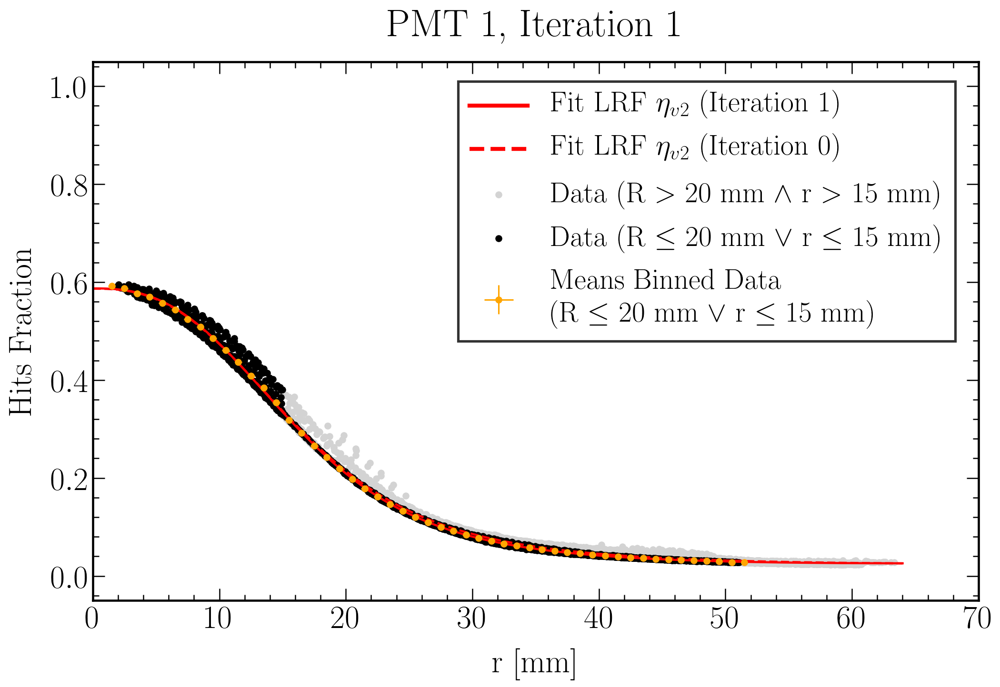

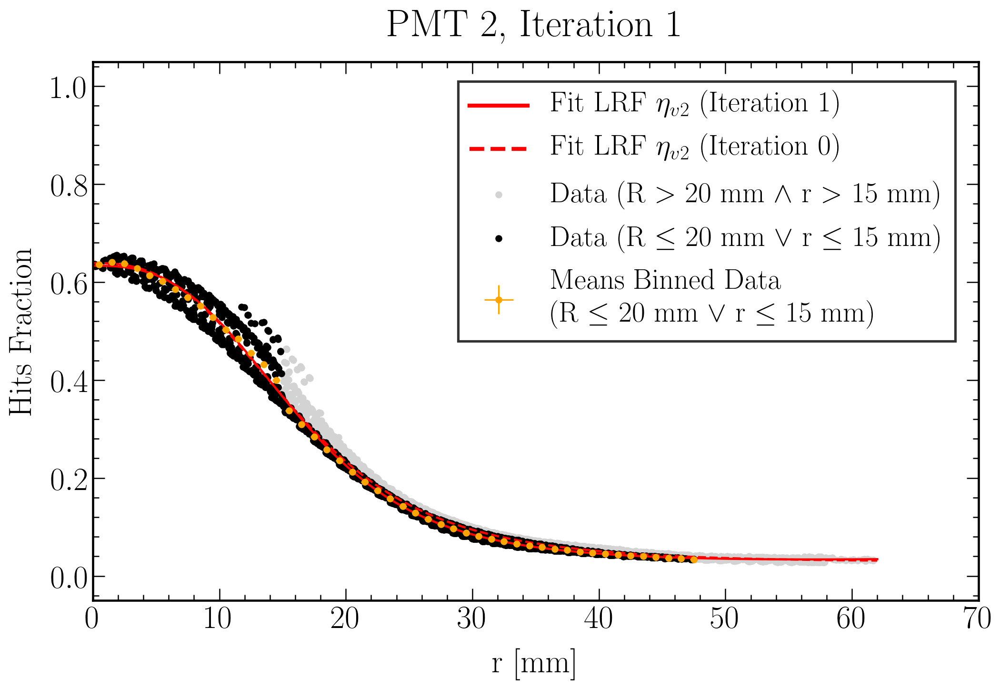

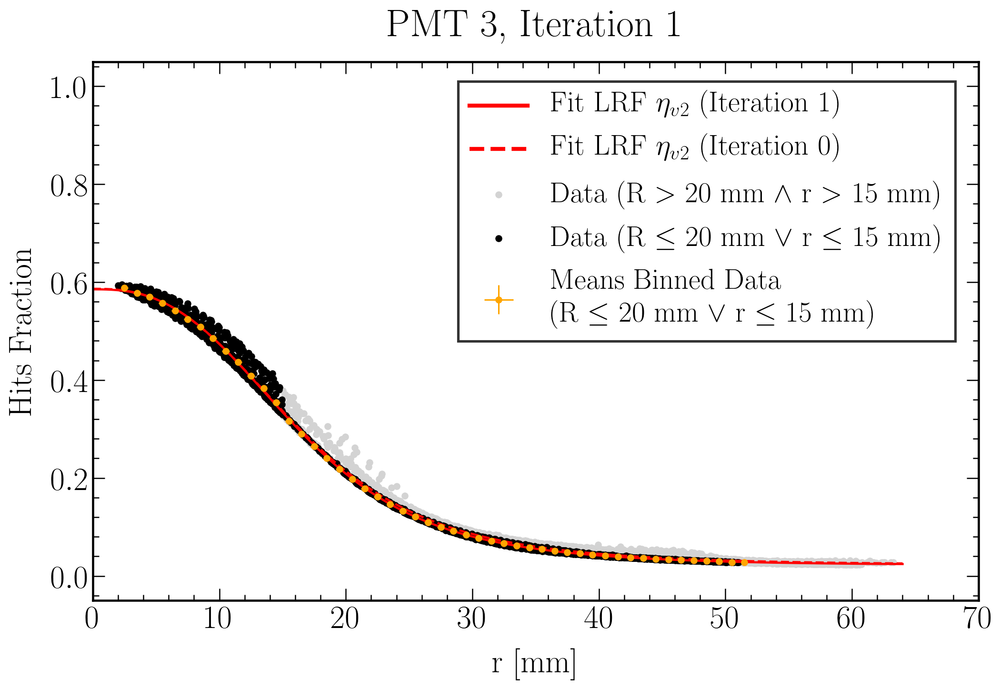

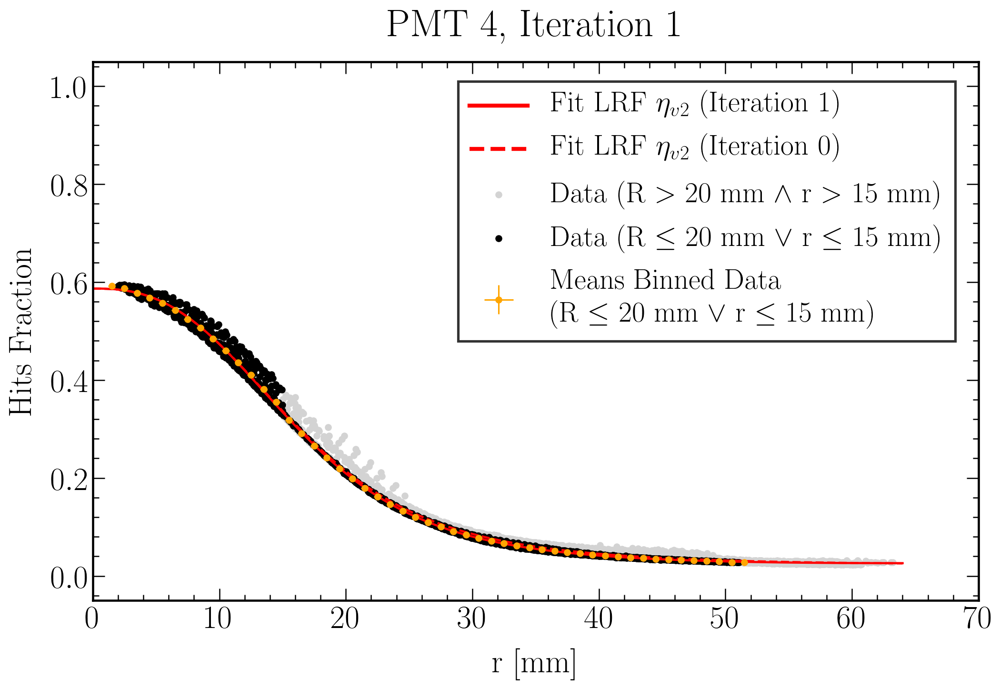

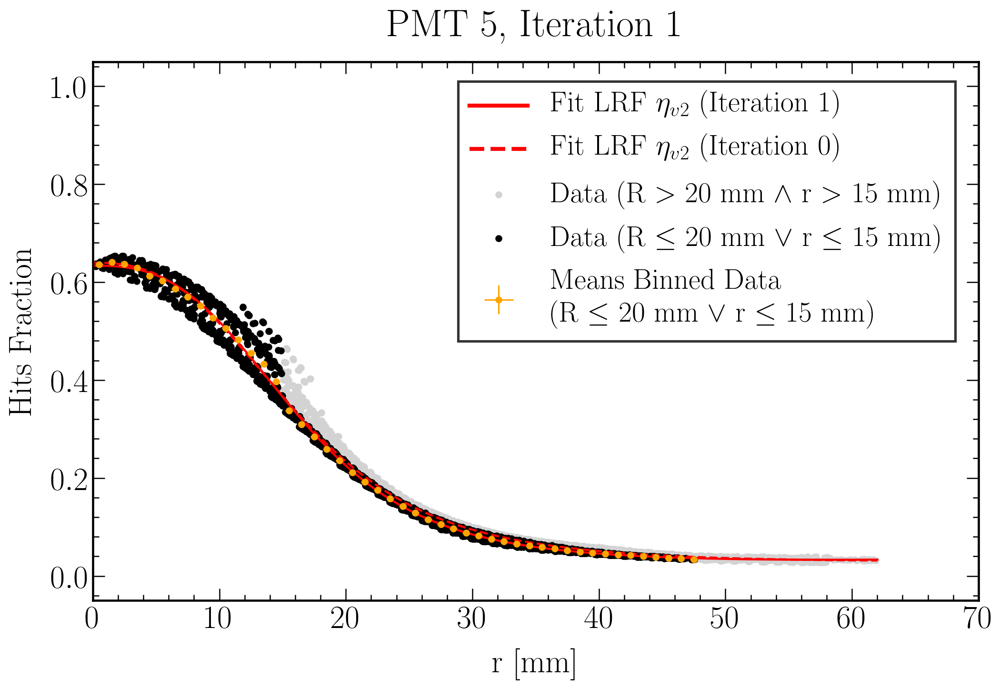

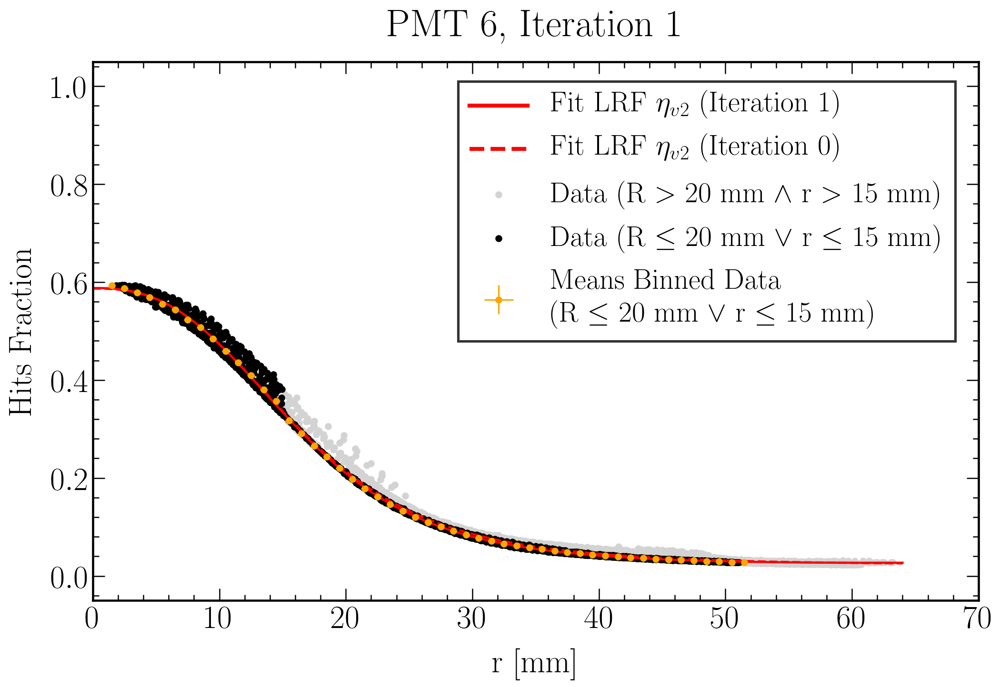

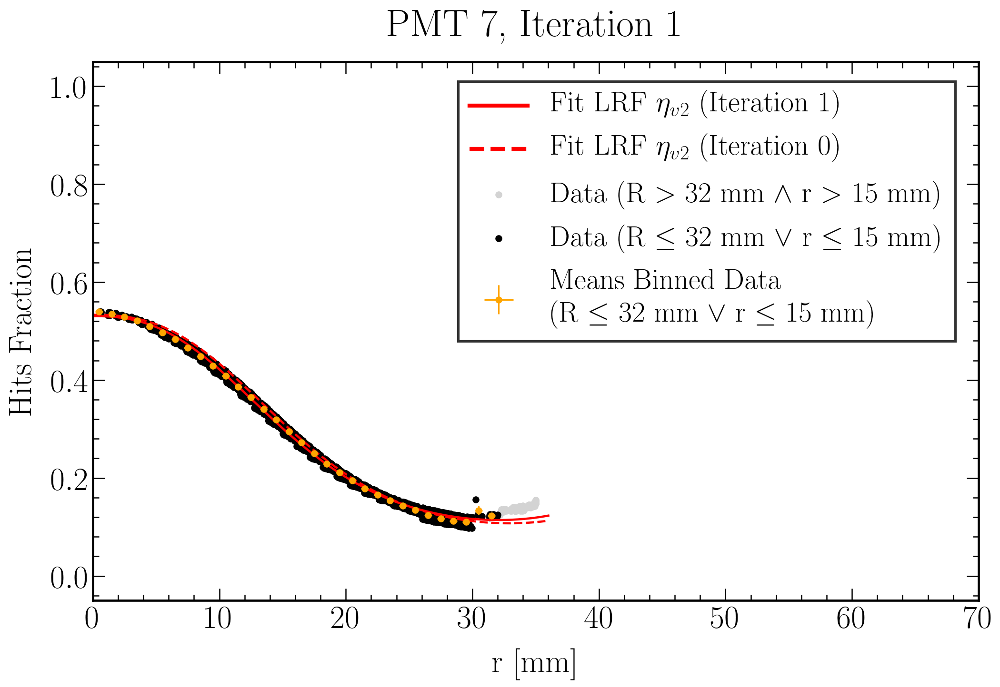

In [126]:
## Calculate radial positions
R_pos_list = Iterative_Reconstruciton.at[iteration, 'R_pos']
r_pos_list = Iterative_Reconstruciton.at[iteration, 'r_pos']

## Fit LRF to radial plots
fit_parameters = Iterative_Reconstruciton.at[iteration, 'fit_parameter']
r_pos_binned = Iterative_Reconstruciton.at[iteration, 'r_pos_binned']
HF_binned = Iterative_Reconstruciton.at[iteration, 'HF_binned']

for i in range(1,8):

    if i == 7:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial_central']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    else:
        rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial']
        rfiducial_under = Iterative_Reconstruciton.at[iteration, 'rfiducial_under']
    HF = Iterative_Reconstruciton.at[iteration, 'HF'][i-1]
    R = Iterative_Reconstruciton.at[iteration, 'R_pos']
    r = Iterative_Reconstruciton.at[iteration, 'r_pos'][i-1]
    
    ## Fiducialise
    r_fiducial = r[(R <= rfiducial) | (r <= rfiducial_under)]
    HF_fiducial = HF[(R <= rfiducial) | (r <= rfiducial_under)]
    r_fiducial_complementary = r[(R > rfiducial) & (r > rfiducial_under)]
    HF_fiducial_complementary = HF[(R > rfiducial) & (r > rfiducial_under)]
    
    ## Bin to account for different arc lengths
    statistic, bin_edges, binnumber = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='mean', bins=(70), range=(0,70))
    bin_center = (bin_edges[:-1]+bin_edges[1:])/2
    statistic_isnan = statistic[~np.isnan(statistic)]
    bin_center_isnan = bin_center[~np.isnan(statistic)]
    
    statistic_std, _, _ = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='std', bins=(70), range=(0,70))
    statistic_std_isnan = statistic_std[~np.isnan(statistic)]
    
    statistic_count, _, _ = stats.binned_statistic(r_fiducial, HF_fiducial, statistic='count', bins=(70), range=(0,70))
    statistic_count_isnan = statistic_count[~np.isnan(statistic)]

    ##################################################################################################
    #### Plot

    fig=plt.figure(figsize=(16, 10), dpi=150)

    ## Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    ## Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    ## Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    ## Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    ## Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    ## Grid
    #plt.grid(True)

    if rfiducial_under > 0:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm $\land$ r $>$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $>$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial_complementary, HF_fiducial_complementary, color = 'lightgray', label = lbl)
    if rfiducial_under > 0:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Data (R $\leq$ "+str(rfiducial)+" mm)"
    plt.scatter(r_fiducial, HF_fiducial, color = 'black', label = lbl)
    if rfiducial_under > 0:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm $\lor$ r $\leq$ "+str(rfiducial_under)+" mm)"
    else:
        lbl = "Means Binned Data\n(R $\leq$ "+str(rfiducial)+" mm)"
    plt.errorbar(bin_center_isnan, statistic_isnan, yerr=statistic_std_isnan/np.sqrt(statistic_count_isnan), xerr = (70/70)/np.sqrt(12), fmt='o', color = 'orange', label = lbl)    
    if int(modelstring[-1]) == 1:
        label = 'Fit LRF $\eta_{v1}$'
    elif int(modelstring[-1]) == 2:
        label = 'Fit LRF $\eta_{v2}$'
    elif int(modelstring[-1]) == 3:
        label = 'Fit LRF $\eta_{v3}$'
    elif int(modelstring[-1]) == 4:
        label = 'Fit LRF $\eta_{v4}$'
    else:
        label = 'Fit LRF'
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *eval("fit_parameters")[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration '+str(iteration)+')')
    plt.plot(np.linspace(0, math.ceil(np.max(r)), 300), model(np.linspace(0, math.ceil(np.max(r)), 300), *np.array(Iterative_Reconstruciton["fit_parameter"]["0"].tolist())[i-1]), color = 'r', linewidth = 2.2, label = label+' (Iteration 0)', linestyle = 'dashed')
    
    plt.xlim(0.,35.*2)
    plt.ylim(-0.05, 1.05)
    
    # Axes Label 
    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('PMT '+str(i)+', Iteration '+str(iteration), fontsize = title_size, pad = title_pad)
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_rfiducial_"+str(Iterative_Reconstruciton['rfiducial'][iteration])+"_rfiducial_under_"+str(Iterative_Reconstruciton['rfiducial_under'][iteration])+"_"+modelstring_save+"_PMT_"+str(i)+"_errorbars.png")
    plt.show()

In [127]:
Iterative_Reconstruciton.to_pickle(filenameprefix+"_Iterative_Reconstruciton_"+modelstring_save+".pkl")
Iterative_Reconstruciton

,rfiducial,rfiducial_under,rfiducial_central,HF,HF_binned,x_pos,y_pos,R_pos,r_pos,r_pos_binned,fit_parameter
0,34,-1,34,"[[0.4700769435406306, 0.45129910462594025, 0.4...","[[0.5926318417130005, 0.5898681111037369, 0.58...","[-5.5, -4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5,...","[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -34...","[34.935655139126844, 34.792240514229604, 34.67...","[[10.700467279516348, 11.510864433221338, 12.3...","[[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5,...","[[0.5864174307982968, 29.991633172454918, -0.3..."
1,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...","[[0.591860389959361, 0.5871957775321418, 0.576...","[-4.830116043237841, -3.8957402110046604, -3.0...","[-25.76971424360738, -26.13297249968791, -26.1...","[26.218470458597018, 26.421753224589075, 26.36...","[[9.437210728581398, 10.275303283622812, 11.07...","[[1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5,...","[[0.5870067026809073, 30.46301474699595, -0.56..."
2,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
3,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
4,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
5,20,15,32,"[[0.4700769435406306, 0.45129910462594025, 0.4...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
